# Deciphering Airbnb's Price Terrain and making predictions

###### New York Airbnb

New York City is a bustling metropolis located in the northeastern region of the United States. It is often referred to as the "City That Never Sleeps" due to its vibrant nightlife and round-the-clock activity. The city is home to a diverse population of over 8 million people, making it one of the most densely populated areas in the country.

Airbnb is a popular online platform that allows travelers to book unique accommodations directly from local hosts. In New York City, Airbnb offers a wide range of options, including apartments, lofts, and private rooms. Many of these listings are located in trendy neighborhoods, providing visitors with a local experience that is different from staying in a traditional hotel

### Importing all the required libraries


In [1]:
import numpy as np
import pandas as pd
from sklearn.impute import SimpleImputer
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import squarify
from wordcloud import WordCloud
import matplotlib.cm as cm
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from boruta import BorutaPy
import pickle

import warnings
warnings.filterwarnings("ignore")
#model building
from sklearn.model_selection import train_test_split
from sklearn import metrics
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from xgboost import XGBRegressor
from catboost import CatBoostRegressor, Pool, cv
from sklearn.model_selection import cross_val_score, RandomizedSearchCV,KFold

### Loading the dataset

In [2]:
# to view all the columns in the head 
pd.set_option('display.max_columns', None)

In [3]:
df = pd.read_csv('newyork_airbnb_data.csv',
                parse_dates=['first_review', 'last_review', 'host_since'])

In [4]:
df

,id,name,description,host_id,host_name,host_since,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_identity_verified,neighbourhood,neighbourhood_group,latitude,longitude,property_type,room_type,accommodates,bathrooms_text,bedrooms,beds,amenities,price,minimum_nights,maximum_nights,has_availability,availability_365,number_of_reviews,first_review,last_review,instant_bookable,calculated_host_listings_count
0,8.020000e+17,A home away from home,The whole group will be comfortable in this sp...,495455523,Michael,2023-01-10,NaN,NaN,NaN,f,f,Canarsie,Brooklyn,40.640403,-73.888535,Private room in home,Private room,2,1 bath,1.0,1.0,"[""50\"" TV"", ""Bathtub"", ""Microwave"", ""Free driv...",143,2,30,t,364,0,NaT,NaT,f,1
1,7.660000e+17,Brooklyn Refuge,Take a break and unwind at this peaceful oasis.,488760226,Eric,2022-11-22,within an hour,1.00,1.00,f,t,Canarsie,Brooklyn,40.648510,-73.894330,Private room in rental unit,Private room,1,1 shared bath,1.0,1.0,"[""Free parking on premises"", ""Carbon monoxide ...",30,2,1125,t,41,13,2022-12-06,2023-02-19,t,2
2,6.360000e+17,Villa Masino.,Close to beach Peaceful walk to park & beach...,461263600,Tommaso,2022-05-27,NaN,NaN,NaN,f,f,Tottenville,Staten Island,40.507114,-74.251907,Entire villa,Entire home/apt,6,2 baths,2.0,2.0,"[""BBQ grill"", ""Security cameras on property"", ...",157,1,365,t,364,0,NaT,NaT,f,1
3,7.680000e+17,1-Bedroom Private Room with King Size Bed,Private room with king size bedroom near Sheep...,475699129,Suliman,2022-08-18,within an hour,0.99,0.98,t,t,Sheepshead Bay,Brooklyn,40.583490,-73.959880,Private room in home,Private room,2,2 baths,3.0,1.0,"[""Security cameras on property"", ""Keypad"", ""Ca...",89,1,20,t,364,15,2022-12-10,2023-02-07,t,7
4,4.924826e+07,Get the best of both worlds in Riverdale!,Welcome to the greatest location if you desire...,397288055,Katherine,2021-04-16,within an hour,0.75,0.68,f,t,North Riverdale,Bronx,40.903260,-73.907090,Entire rental unit,Entire home/apt,3,1 bath,2.0,2.0,"[""Hangers"", ""Clothing storage: closet"", ""Secur...",125,3,21,t,46,25,2021-04-30,2022-11-13,f,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
42926,4.034290e+07,Cozy room in prime area,NaN,90429772,Hanna,2016-08-17,NaN,NaN,NaN,f,t,East Village,Manhattan,40.726110,-73.988010,Private room in rental unit,Private room,1,1 shared bath,1.0,1.0,"[""Hangers"", ""Kitchen"", ""Dishes and silverware""...",85,30,1125,f,0,0,NaT,NaT,f,2
42927,3.525770e+07,Hell's Kitchen /Times Sq - Comfortable 2 BDR Flat,"Location Location. Hell's Kitchen, Times Squar...",264962468,Mili,2019-05-29,within an hour,1.00,1.00,f,t,Hell's Kitchen,Manhattan,40.762150,-73.990270,Entire rental unit,Entire home/apt,6,1 bath,2.0,3.0,"[""Hangers"", ""Microwave"", ""Dishwasher"", ""Dishes...",208,2,1125,t,23,217,2019-06-18,2023-02-16,f,1
42928,5.249152e+07,Cozy 3 bedroom apt in the heart of Lower East ...,This comfortable apartment in the heart of Low...,305489297,Stavros,2019-10-30,within an hour,1.00,0.70,f,t,Lower East Side,Manhattan,40.717330,-73.991110,Entire rental unit,Entire home/apt,3,1 bath,3.0,3.0,"[""Hangers"", ""Dishes and silverware"", ""Lockbox""...",125,30,1125,t,191,7,2021-11-05,2022-12-18,f,6
42929,4.815880e+07,Spacious Loft Space / Photo studio in Bushwick,Looking for a two month subleter. LGBTQ+ and a...,6600525,Quentin,2013-05-27,NaN,NaN,NaN,f,t,Bushwick,Brooklyn,40.687350,-73.917660,Private room in loft,Private room,1,2 shared baths,6.0,1.0,"[""Lock on bedroom door"", ""Fire extinguisher"", ...",50,25,30,t,0,0,NaT,NaT,f,1


In [5]:
df.shape

(42931, 32)

In [6]:
df.columns

Index(['id', 'name', 'description', 'host_id', 'host_name', 'host_since',
       'host_response_time', 'host_response_rate', 'host_acceptance_rate',
       'host_is_superhost', 'host_identity_verified', 'neighbourhood',
       'neighbourhood_group', 'latitude', 'longitude', 'property_type',
       'room_type', 'accommodates', 'bathrooms_text', 'bedrooms', 'beds',
       'amenities', 'price', 'minimum_nights', 'maximum_nights',
       'has_availability', 'availability_365', 'number_of_reviews',
       'first_review', 'last_review', 'instant_bookable',
       'calculated_host_listings_count'],
      dtype='object')

In [7]:
df.dtypes

id                                       float64
name                                      object
description                               object
host_id                                    int64
host_name                                 object
host_since                        datetime64[ns]
host_response_time                        object
host_response_rate                       float64
host_acceptance_rate                     float64
host_is_superhost                         object
host_identity_verified                    object
neighbourhood                             object
neighbourhood_group                       object
latitude                                 float64
longitude                                float64
property_type                             object
room_type                                 object
accommodates                               int64
bathrooms_text                            object
bedrooms                                 float64
beds                

In [8]:
## removing the id columns before we proceed futher
df.drop(['id','host_id','description'],axis=1,inplace=True)

### Analysing and treating missing values

In [6]:
df.isnull().sum()

name                                 12
host_name                             5
host_since                            5
host_response_time                14532
host_response_rate                14532
host_acceptance_rate              12564
host_is_superhost                    25
host_identity_verified                5
neighbourhood                         0
neighbourhood_group                   0
latitude                              0
longitude                             0
property_type                         0
room_type                             0
accommodates                          0
bathrooms_text                       75
bedrooms                           3874
beds                                929
amenities                             0
price                                 0
minimum_nights                        0
maximum_nights                        0
has_availability                      0
availability_365                      0
number_of_reviews                     0


In [5]:
## missing values in the dataframe
# percentage of values that are missing
total_null = df.isnull().sum().sort_values(ascending=False)
percentage_of_null = (total_null / df.shape[0]) * 100
table = pd.concat([total_null, percentage_of_null], axis=1, keys=['Total Null values', 'Percentage of Null values'])
table

,Total Null values,Percentage of Null values
host_response_time,14532,33.849666
host_response_rate,14532,33.849666
host_acceptance_rate,12564,29.265566
last_review,10304,24.001304
first_review,10304,24.001304
bedrooms,3874,9.023782
beds,929,2.163937
bathrooms_text,75,0.174699
host_is_superhost,25,0.058233
name,12,0.027952


1. The columns host response time, response rate and acceptance rate contain the most missing values. 
2. We shall treat bedrooms and beds as objects and impute the most frequent value. 
3. Upon manual investigation, it was found that the date columns are missing where the number of reviews is zero, so it only makes sense to impute them with zero too.
4. The other columns like name,host name contain only a very few missing values, so we choose to drop them
###### We will impute the values using central tendency measures

In [9]:
df.dropna(subset=['host_since','name','host_is_superhost','host_name','host_identity_verified'], inplace=True)

In [10]:
df['beds'] = df['beds'].astype('object')
df['bedrooms'] = df['bedrooms'].astype('object')

Imputation using Simple Imputer

In [11]:
num_cols = df.select_dtypes(include=np.number).columns
cat_cols = df.select_dtypes(include='object').columns

# Create the imputers
num_imputer = SimpleImputer(strategy='median') 
cat_imputer = SimpleImputer(strategy='most_frequent')  
# Perform the imputations
df[num_cols] = num_imputer.fit_transform(df[num_cols])
df[cat_cols] = cat_imputer.fit_transform(df[cat_cols])

In [12]:
df['listing_life'] = (df['last_review'] - df['host_since']).dt.days/365
# Extracting the day out of the last review date column
df['day_of_review']=df['last_review'].dt.day_name()

In [13]:
df['first_review'].fillna(0,inplace = True)
df['last_review'].fillna(0,inplace = True)
df['listing_life'].fillna(0,inplace= True)
df['day_of_review'].fillna(0,inplace= True)

In [14]:
df.isnull().sum()

name                              0
host_name                         0
host_since                        0
host_response_time                0
host_response_rate                0
host_acceptance_rate              0
host_is_superhost                 0
host_identity_verified            0
neighbourhood                     0
neighbourhood_group               0
latitude                          0
longitude                         0
property_type                     0
room_type                         0
accommodates                      0
bathrooms_text                    0
bedrooms                          0
beds                              0
amenities                         0
price                             0
minimum_nights                    0
maximum_nights                    0
has_availability                  0
availability_365                  0
number_of_reviews                 0
first_review                      0
last_review                       0
instant_bookable            

#### We now have our null values treated

## Feature engineering

In [15]:
# New York Airport gps coordinates
airport_latitude = 40.641766
airport_longitude = -73.780968

In [16]:
# Times Square - heart of the city- gps coordinates
times_square_lat = 40.758896
times_square_lon = -73.985130

In [17]:
# Calculating the distance to Airport from each Airbnb using Haversine distance
import math

def haversine_distance(lat1, lon1, lat2, lon2):
    """
    Calculate the haversine distance between two points
    on the Earth (specified in decimal degrees)
    """
    # Convert decimal degrees to radians
    lat1, lon1, lat2, lon2 = map(math.radians, [lat1, lon1, lat2, lon2])

    # Haversine formula
    dlat = lat2 - lat1
    dlon = lon2 - lon1
    a = math.sin(dlat/2) ** 2 + math.cos(lat1) * math.cos(lat2) * math.sin(dlon/2) ** 2
    c = 2 * math.atan2(math.sqrt(a), math.sqrt(1-a))
    radius_of_earth = 6371  # Radius of the Earth in kilometers. Use 3956 for miles.
    distance = radius_of_earth * c

    return distance

In [18]:
df['distance_to_airport'] = df.apply(lambda row: haversine_distance(row['latitude'], row['longitude'], airport_latitude, airport_longitude), axis=1)

df['distance_to_timessquare'] = df.apply(lambda row: haversine_distance(row['latitude'], row['longitude'], times_square_lat, times_square_lon), axis=1)

In [19]:
df['distance_to_airport'] = df['distance_to_airport'].round(2)
df['distance_to_timessquare'] = df['distance_to_timessquare'].round(2)

In [20]:
df['listing_life'] = df['listing_life'].round().astype(int)

### Host experience duration

In [21]:
from datetime import datetime

df['host_since'] = pd.to_datetime(df['host_since'])

# Calculate the current date
current_date = pd.to_datetime('today')

# Calculate the Host Experience Duration in years
df['host_experience_years'] = (current_date - df['host_since']).dt.days / 365.25

In [22]:
df['host_experience_years'] = df['host_experience_years'].round().astype(int)


# Host rating

In [23]:
df['host_response_rate'] = df['host_response_rate'].astype('float')

In [24]:
df['host_response_rate'].describe()

count    42889.000000
mean         0.963025
std          0.133810
min          0.000000
25%          1.000000
50%          1.000000
75%          1.000000
max          1.000000
Name: host_response_rate, dtype: float64

In [25]:
def calculate_host_rating(row):
    response_rate = row['host_response_rate']
   
    if response_rate <= 0.10:
        return 1
    elif 0.10 < response_rate <= 0.30 :
        return 2
    elif 0.30 < response_rate <= 0.50:
        return 3
    elif 0.50 < response_rate <= 0.70 :
        return 4
    else:
        return 5

df['host_rating'] = df.apply(calculate_host_rating, axis=1)


### Guest capacity

In [26]:
df['accommodates'].describe()

count    42889.000000
mean         2.974772
std          2.122939
min          0.000000
25%          2.000000
50%          2.000000
75%          4.000000
max         16.000000
Name: accommodates, dtype: float64

In [27]:
guest_capacity = []
for accommodates in df['accommodates']:
    if accommodates <= 4:
        guest_capacity.append('Small')
    elif 5 <= accommodates < 10:
        guest_capacity.append('Medium')
    else:
        guest_capacity.append('Large')


df['guest_capacity'] = guest_capacity


# price level

In [28]:
price_level = []
for price in df['price']:
    if price <= 150:
        price_level.append('Economy')
    elif 151 <= price < 400:
        price_level.append('Standard')
    else:
        price_level.append('Luxury')


df['price_level'] = price_level


### Target variable analysis

In [26]:
df['price'].describe()

count    42889.000000
mean       200.453426
std        895.505262
min          0.000000
25%         75.000000
50%        125.000000
75%        200.000000
max      99000.000000
Name: price, dtype: float64

<AxesSubplot:xlabel='price', ylabel='Count'>

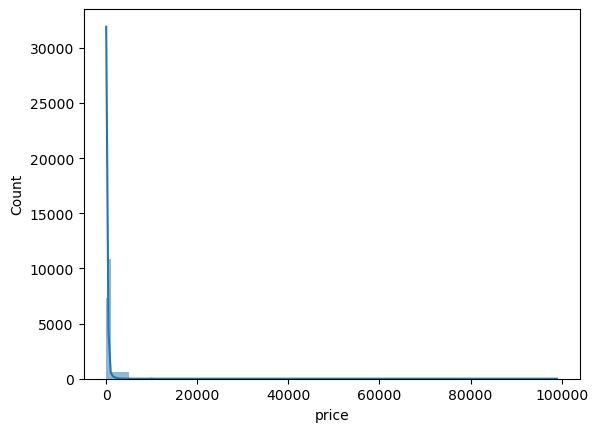

In [27]:
sns.histplot(data=df,x='price',bins=[50,80,100,200,1000,5000,99000],kde=True)

### It can be seen that the price of the Airbnbs vary from 0 to 85100 USD per night. Having price of 0 could be an error as no host will list the property for free. We will treat that and we can also see the average price is only 200 USD but the maximum price goes upto 85100. It is quite uncommon for any body to pay 85100 USD per night.The distribution is heavily right skewed, let us find out the outliers and analyse them

In [28]:
df[df['price']==0]

,name,host_name,host_since,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_identity_verified,neighbourhood,neighbourhood_group,latitude,longitude,property_type,room_type,accommodates,bathrooms_text,bedrooms,beds,amenities,price,minimum_nights,maximum_nights,has_availability,availability_365,number_of_reviews,first_review,last_review,instant_bookable,calculated_host_listings_count,listing_life,day_of_review,distance_to_airport,distance_to_timessquare,host_experience_years,host_rating,guest_capacity,price_level
6412,Condor Hotel,The Condor Hotel,2019-05-10,within an hour,1.0,0.00,f,t,Bedford-Stuyvesant,Brooklyn,40.696787,-73.958005,Room in hotel,Hotel room,0.0,1 bath,1.0,1.0,"[""Hangers"", ""Bathtub"", ""TV"", ""Kitchen"", ""Refri...",0.0,1.0,365.0,t,0.0,0.0,0,0,f,6.0,0,0,16.14,7.27,4,5,Small,Economy
14292,The Wall Street Inn,The Wall Street Inn,2019-12-03,within an hour,1.0,0.93,f,t,Financial District,Manhattan,40.704620,-74.010270,Room in hotel,Hotel room,5.0,1 bath,1.0,1.0,"[""Hangers"", ""Fire extinguisher"", ""First aid ki...",0.0,1.0,25.0,t,0.0,51.0,2020-07-19 00:00:00,2023-02-19 00:00:00,f,9.0,3,Sunday,20.56,6.40,4,5,Medium,Economy


In [29]:
df = df[df['price'] != 0]

In [30]:
df.reset_index(drop=True, inplace=True)

In [45]:
df['price'].describe()

count    34307.000000
mean       196.604687
std        684.211407
min         10.000000
25%         75.000000
50%        125.000000
75%        200.000000
max      85100.000000
Name: price, dtype: float64

In [24]:
def univariate_outliers(data,col):
    q1 = data[col].quantile(0.25)
    q2 = data[col].quantile(0.50)
    q3 = data[col].quantile(0.75)
    iqr = q3-q1
    inner = q1 - 1.5*iqr
    outer = q3 + 1.5*iqr
    outlier_index = []
    for index,value in data[col].iteritems():           #univariate outliers detection
        if inner < value < outer :
            pass
        else:
            outlier_index.append(index)
    outliers = data[col][outlier_index]
    return outliers

In [29]:
outliers = univariate_outliers(data=df,col='price')

In [30]:
outliers_df = df[df['price'].isin(outliers)] 
outliers_df

,name,host_name,host_since,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_identity_verified,neighbourhood,neighbourhood_group,latitude,longitude,property_type,room_type,accommodates,bathrooms_text,bedrooms,beds,amenities,price,minimum_nights,maximum_nights,has_availability,availability_365,number_of_reviews,first_review,last_review,instant_bookable,calculated_host_listings_count,listing_life,day_of_review,distance_to_airport,distance_to_timessquare,host_experience_years,host_rating,guest_capacity,price_level
10,nice home by the beach.,Zaid,2020-04-08,within an hour,1.0,1.00,f,t,Belle Harbor,Queens,40.577120,-73.847220,Shared room in home,Shared room,2.0,1 shared bath,1.0,1.0,"[""Hot tub""]",975.0,1.0,365.0,t,364.0,0.0,0,0,t,1.0,0,0,9.11,23.32,3,5,Small,Luxury
61,New Boho Modern 3Bd Entire Unit -20 Min- Manha...,Billy,2021-08-12,within an hour,0.9,0.93,f,t,Bayside,Queens,40.770130,-73.769920,Entire home,Entire home/apt,8.0,1 bath,3.0,4.0,"[""Hangers"", ""BBQ grill"", ""Security cameras on ...",418.0,3.0,1125.0,t,345.0,23.0,2021-10-10 00:00:00,2022-11-23 00:00:00,t,3.0,1,Wednesday,14.30,18.17,2,5,Medium,Luxury
73,Chic Spacious Beachfront House,Antoinette,2016-04-02,within an hour,1.0,0.96,f,f,Arverne,Queens,40.588930,-73.800640,Entire home,Entire home/apt,6.0,2.5 baths,3.0,4.0,"[""Air conditioning"", ""Kitchen"", ""Free parking ...",414.0,30.0,730.0,t,305.0,12.0,2018-06-19 00:00:00,2021-09-06 00:00:00,f,2.0,5,Monday,6.11,24.48,7,5,Medium,Luxury
147,UIA x Ubl,Steven,2017-10-17,within an hour,1.0,0.96,f,t,Mill Basin,Brooklyn,40.609324,-73.919090,Boat,Entire home/apt,4.0,Half-bath,1.0,1.0,"[""BBQ grill"", ""Security cameras on property"", ...",444.0,1.0,365.0,t,365.0,0.0,0,0,t,1.0,0,0,12.20,17.54,6,5,Small,Luxury
181,Think of us as your home Away from home.,Sandra,2017-01-07,within an hour,1.0,0.96,f,f,New Brighton,Staten Island,40.638000,-74.087680,Entire townhouse,Entire home/apt,5.0,3 baths,3.0,4.0,"[""Hangers"", ""Air conditioning"", ""Free parking ...",1200.0,30.0,1125.0,t,90.0,0.0,0,0,t,1.0,0,0,25.88,15.98,7,5,Medium,Luxury
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
42855,Prime Location! Sunny unique 1bedroom loft dup...,Mar,2022-02-11,within an hour,1.0,0.79,f,t,Midtown,Manhattan,40.746160,-73.989640,Entire rental unit,Entire home/apt,2.0,2 baths,1.0,1.0,"[""Hangers"", ""Shared gym in building"", ""Bathtub...",600.0,3.0,10.0,t,8.0,6.0,2022-02-21 00:00:00,2023-02-04 00:00:00,f,1.0,1,Saturday,21.08,1.47,1,5,Small,Luxury
42859,Lovely 3 bedroom Apt with Patio and laundry,Camille,2018-05-16,within an hour,1.0,0.67,f,f,Civic Center,Manhattan,40.713650,-74.004910,Entire condo,Entire home/apt,6.0,2 baths,3.0,4.0,"[""Hangers"", ""TV"", ""Dishes and silverware"", ""Ki...",450.0,30.0,365.0,f,0.0,0.0,0,0,f,2.0,0,0,20.51,5.30,5,5,Medium,Luxury
42869,Grand Concourse Gem,Adriana,2019-08-21,within an hour,1.0,0.96,f,t,Norwood,Bronx,40.875940,-73.884040,Private room in rental unit,Private room,1.0,1 shared bath,1.0,1.0,"[""Hangers"", ""Security cameras on property"", ""B...",650.0,1.0,365.0,f,0.0,0.0,0,0,f,1.0,0,0,27.45,15.55,4,5,Small,Luxury
42876,Lovely 4 Bedroom/3 Bathroom/Garden. Central Park.,Theresa,2018-07-16,within an hour,1.0,0.99,t,f,Upper West Side,Manhattan,40.778103,-73.985179,Entire guesthouse,Entire home/apt,12.0,3 baths,4.0,9.0,"[""Hangers"", ""Security cameras on property"", ""G...",857.0,4.0,365.0,t,214.0,47.0,2021-07-03 00:00:00,2023-02-18 00:00:00,f,1.0,5,Saturday,22.94,2.14,5,5,Large,Luxury


In [38]:
outliers_df.describe()

,host_response_rate,host_acceptance_rate,latitude,longitude,accommodates,price,minimum_nights,maximum_nights,availability_365,number_of_reviews,calculated_host_listings_count,listing_life,distance_to_airport,distance_to_timessquare,host_experience_years,host_rating
count,3293.000000,3293.000000,3293.000000,3293.000000,3293.000000,3293.000000,3293.000000,3293.000000,3293.000000,3293.000000,3293.000000,3293.000000,3293.000000,3293.000000,3293.000000,3293.000000
mean,0.957662,0.866207,40.735390,-73.971603,5.956575,977.555724,13.202247,535.931370,180.838445,14.112056,53.670817,2.834497,19.706165,4.671880,6.067112,4.888855
std,0.151571,0.235549,0.041676,0.041400,3.907372,3116.913625,26.367803,445.519256,143.543631,38.440102,128.090969,3.637626,3.471310,4.466268,3.566167,0.569933
min,0.000000,0.000000,40.508630,-74.241350,1.000000,388.000000,1.000000,1.000000,0.000000,0.000000,1.000000,-3.000000,3.060000,0.050000,0.000000,1.000000
25%,1.000000,0.880000,40.715590,-73.993299,3.000000,450.000000,1.000000,90.000000,15.000000,0.000000,1.000000,0.000000,18.640000,1.300000,3.000000,5.000000
50%,1.000000,0.960000,40.743440,-73.981825,5.000000,581.000000,3.000000,365.000000,179.000000,1.000000,2.000000,1.000000,20.630000,3.590000,7.000000,5.000000
75%,1.000000,1.000000,40.760761,-73.960900,8.000000,900.000000,30.000000,1125.000000,336.000000,10.000000,13.000000,6.000000,21.560000,6.170000,9.000000,5.000000
max,1.000000,1.000000,40.899320,-73.721602,16.000000,99000.000000,500.000000,1125.000000,365.000000,798.000000,526.000000,14.000000,41.610000,35.240000,15.000000,5.000000


In [39]:
outliers_df.describe(include = 'object')

,name,host_name,host_response_time,host_is_superhost,host_identity_verified,neighbourhood,neighbourhood_group,property_type,room_type,bathrooms_text,bedrooms,beds,amenities,has_availability,first_review,last_review,instant_bookable,day_of_review,guest_capacity,price_level
count,3293,3293,3293,3293,3293,3293,3293,3293,3293,3293,3293.0,3293.0,3293,3293,3293,3293,3293,3293,3293,3293
unique,3208,1368,4,2,2,144,5,45,4,25,12.0,18.0,2562,2,1111,682,2,8,3,2
top,Midtown 45 Resort - Hotel,RoomPicks,within an hour,f,t,Midtown,Manhattan,Entire rental unit,Entire home/apt,1 bath,1.0,1.0,"[""Fire extinguisher"", ""Backyard"", ""Patio or ba...",t,0,0,f,0,Small,Luxury
freq,8,255,2586,2677,2858,594,2374,1290,2655,1232,1262.0,920.0,57,2956,1493,1493,2124,1493,1570,3066


##### 1. As we can see most number of expensive listings are from Midtown, Manhattan. Manhattan is the most luxurious or expensive neighbourhood to stay in. This could be because of high demand as it is heart of the city having amazing touristic places to visit with Times Square topping the list. 
##### 2. It is also obvious that prices are high for an entire apt/home as compared to private or shared rooms
##### 3. There are no further patterns that could be found as the spread of data is not specific to any range but includes all values in the original dataframe. 

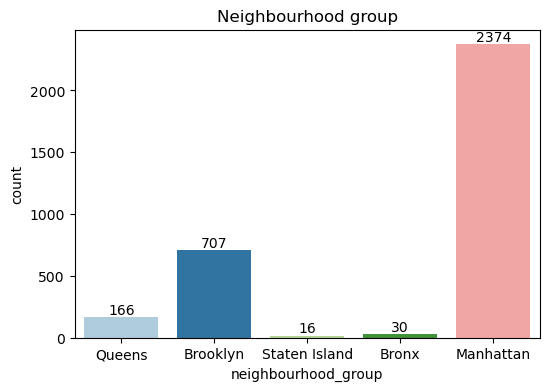

In [31]:
# Countplot
plt.figure(figsize=(6,4))

ax = sns.countplot(data=outliers_df,x='neighbourhood_group',palette="Paired")
plt.title('Neighbourhood group')
for p in ax.patches:
    ax.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()),
                 ha = 'center', va = 'center', xytext = (0, 5), textcoords = 'offset points')

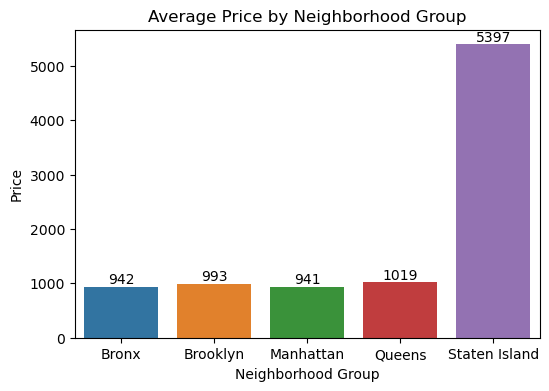

In [41]:
group_prices = outliers_df.groupby('neighbourhood_group')['price'].mean() 

# Create a bar plot
plt.figure(figsize=(6, 4))
ax = sns.barplot(data = outliers_df, x=group_prices.index, y=group_prices.values)
for p in ax.patches:
    ax.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()),
                 ha = 'center', va = 'center', xytext = (0, 5), textcoords = 'offset points')
plt.xlabel('Neighborhood Group')
plt.ylabel('Price')
plt.title('Average Price by Neighborhood Group')
plt.show()

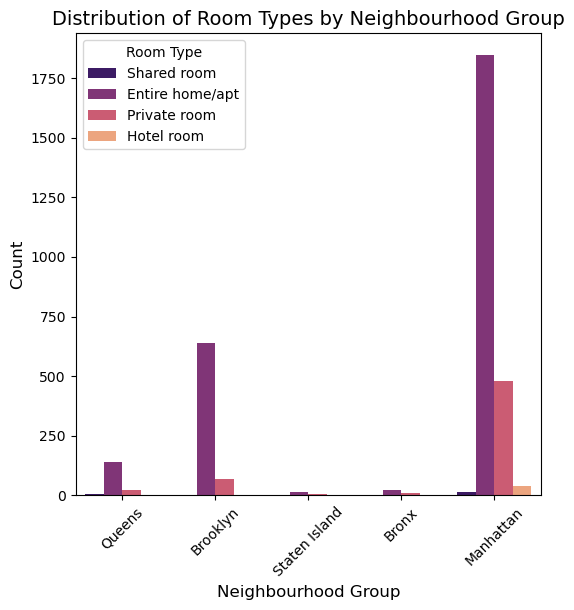

In [42]:
plt.figure(figsize=(6, 6))

ax = sns.countplot(x='neighbourhood_group', hue='room_type', data=outliers_df, palette='magma')

# Customize the plot
ax.set_xlabel('Neighbourhood Group', fontsize=12)
ax.set_ylabel('Count', fontsize=12)
ax.set_title('Distribution of Room Types by Neighbourhood Group', fontsize=14)

# Set the legend title and font size
ax.legend(title='Room Type', fontsize=10)

# Rotate x-axis labels if necessary
plt.xticks(rotation=45)

# Show the plot
plt.show()

1. Although most number of listings are coming from Manhattan, here we can see that the highest average priced listing is coming from Staten Island. The possible reasons for this could be that Manhattan has more number of listings which could further divide the prices. It could also be that Manhattan has more of private rooms because of an already over-crowded city that it is leading to lower prices. 
2. On the other hand, Staten Island might have less tourist demand and therefore fewer but more expensive listings. It is a more suburban and residential area and may have more of entire apartments in them leading to higher average price. Staten Island offers a different experience than Manhattan with its beaches, parks, and museums. Some tourists might prefer this quiet, laid-back environment to the hustle and bustle of Manhattan, and be willing to pay a premium for it.

We want to retain some properties of the outliers_df but we also know that not many variables have an impact on the outlier values. So we could cape the values upto 0.99 quantile and proceed further

In [43]:
df['price'].quantile(0.99)

1262.4199999999983

###### EDA on the input variables

In [31]:
df.skew()

host_response_rate                 -5.191035
host_acceptance_rate               -2.549164
latitude                            0.218029
longitude                           1.146765
accommodates                        2.626482
bedrooms                            2.864931
beds                                3.965824
price                              81.416828
minimum_nights                     12.425035
maximum_nights                    207.038227
availability_365                    0.440118
number_of_reviews                   5.730952
calculated_host_listings_count      4.614125
listing_life                        0.565040
distance_to_airport                -0.424877
distance_to_timessquare             0.913175
host_experience_years              -0.173951
host_rating                        -6.447509
dtype: float64

### Let us fix the skewness of minimum and maximum nights

<AxesSubplot:xlabel='minimum_nights', ylabel='Density'>

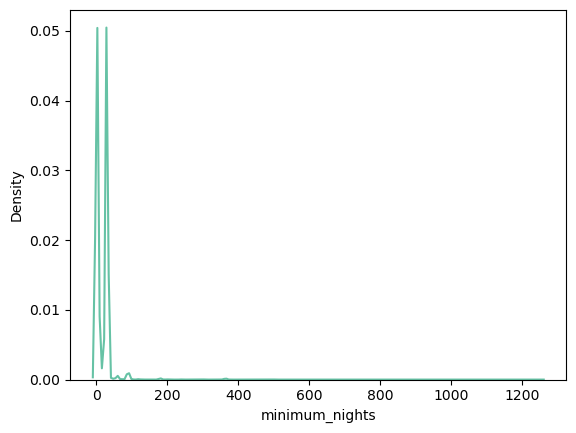

In [157]:
sns.kdeplot(df['minimum_nights'])

In [158]:
df['minimum_nights'].describe()

count    34305.000000
mean        18.098324
std         27.518803
min          1.000000
25%          2.000000
50%          7.000000
75%         30.000000
max       1250.000000
Name: minimum_nights, dtype: float64

In [159]:
# Let us identify the outliers in this
outliers_min = univariate_outliers(data=df,col='minimum_nights')

In [160]:
outliers_min.describe()

count     613.000000
mean      147.003263
std       120.922827
min        75.000000
25%        90.000000
50%        90.000000
75%       180.000000
max      1250.000000
Name: minimum_nights, dtype: float64

In [161]:
df[df['minimum_nights']>350]            

,name,host_name,host_since,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_identity_verified,neighbourhood,neighbourhood_group,latitude,longitude,property_type,room_type,accommodates,bathrooms_text,bedrooms,beds,amenities,minimum_nights,maximum_nights,has_availability,availability_365,number_of_reviews,first_review,last_review,instant_bookable,calculated_host_listings_count,price,listing_life,day_of_review,distance_to_airport,distance_to_timessquare,host_experience_years,host_rating,guest_capacity,price_level
150,Heart of the City,Alexander M,2018-02-14,within an hour,1.00,0.67,f,f,Midtown,Manhattan,40.758420,-73.971800,Entire rental unit,Entire home/apt,3.0,1 bath,1.0,2.0,"[""Hangers"", ""BBQ grill"", ""Bathtub"", ""Microwave...",365.0,1125.0,t,364.0,7.0,2018-05-20 00:00:00,2018-08-30 00:00:00,t,2.0,199.0,1,Thursday,20.67,1.12,5,5,Small,Standard
826,Twin size bed 2 blocks away L&M train to Manha...,Serdar,2015-11-13,within an hour,1.00,0.96,f,f,Ridgewood,Queens,40.701840,-73.909570,Private room in rental unit,Private room,1.0,1 shared bath,1.0,1.0,"[""Hangers"", ""Air conditioning"", ""Kitchen"", ""Ba...",365.0,1125.0,t,269.0,29.0,2016-10-01 00:00:00,2021-03-31 00:00:00,f,2.0,30.0,5,Wednesday,12.74,8.99,8,5,Small,Economy
1126,CHELSEA 1 Bdrm Plus Sleeping Loft!!,Andrea,2011-11-01,within an hour,1.00,0.96,f,t,Chelsea,Manhattan,40.746420,-74.004110,Entire rental unit,Entire home/apt,3.0,1 bath,2.0,2.0,"[""Hangers"", ""Air conditioning"", ""Fire extingui...",365.0,365.0,t,0.0,10.0,2012-11-25 00:00:00,2014-10-26 00:00:00,f,1.0,195.0,3,Sunday,22.12,2.12,12,5,Small,Standard
1432,"A Clean, Quite, Great room for NY visit.",Yenpo,2016-09-19,within an hour,1.00,1.00,f,t,Forest Hills,Queens,40.716940,-73.853690,Private room in townhouse,Private room,1.0,1.5 shared baths,1.0,1.0,"[""Hangers"", ""TV"", ""Kitchen"", ""Fire extinguishe...",365.0,1125.0,t,0.0,9.0,2016-10-02 00:00:00,2017-02-19 00:00:00,f,1.0,69.0,0,Sunday,10.37,12.02,7,5,Small,Economy
1597,"UNFURNISHED!!!.STUNNING 1661SFT, SOHO/TRIBECA ...",Marcelo,2014-07-13,within an hour,1.00,0.96,f,t,Tribeca,Manhattan,40.724420,-74.009980,Other,Entire home/apt,4.0,1.5 baths,2.0,2.0,"[""Air conditioning"", ""Dryer"", ""Crib"", ""Bathtub...",360.0,1125.0,t,364.0,5.0,2015-11-27 00:00:00,2018-05-02 00:00:00,f,1.0,399.0,4,Wednesday,21.39,4.37,9,5,Small,Standard
3204,Furnished luxury 2bed/2bath condo w/balcony,Sathi,2014-04-15,within an hour,1.00,0.88,f,t,Woodside,Queens,40.744090,-73.894140,Entire condo,Entire home/apt,4.0,2 baths,2.0,2.0,"[""Hangers"", ""BBQ grill"", ""Shared gym in buildi...",365.0,730.0,t,365.0,0.0,0,0,f,1.0,149.0,0,Sunday,14.85,7.84,9,5,Small,Economy
3253,Beautiful Single Bedroom 30 min to Manhattan.,Devika,2012-08-04,within an hour,1.00,1.00,f,t,Long Island City,Queens,40.735230,-73.925680,Private room in townhouse,Private room,1.0,1.5 shared baths,1.0,2.0,"[""Hangers"", ""Breakfast"", ""Microwave"", ""Cleanin...",365.0,365.0,t,358.0,11.0,2019-03-12 00:00:00,2020-03-28 00:00:00,f,3.0,200.0,8,Saturday,16.03,5.66,11,5,Small,Standard
3534,Gorgeous 2 Bedroom apartment,Iveta,2015-08-18,within an hour,1.00,0.96,f,t,Forest Hills,Queens,40.719310,-73.836980,Entire rental unit,Entire home/apt,6.0,1 bath,2.0,2.0,[],365.0,1125.0,f,0.0,0.0,0,0,f,1.0,2350.0,0,Sunday,9.83,13.24,8,5,Medium,Luxury
4222,Gramercy Luxurious 2 BD condominium,Manhattan,2014-05-18,within an hour,1.00,0.96,f,t,Gramercy,Manhattan,40.737530,-73.980130,Entire condo,Entire home/apt,4.0,2 baths,2.0,1.0,"[""Air conditioning"", ""Fire extinguisher"", ""Dry...",360.0,1125.0,t,365.0,0.0,0,0,f,1.0,5143.0,0,Sunday,19.88,2.41,9,5,Small,Luxury
4579,Steps to Central Park,Ron & Hila,2012-06-10,within a few hours,1.00,0.83,f,t,Upper East Side,Manhattan,40.781150,-73.958660,Entire rental unit,Entire home/apt,2.0,1 bath,1.0,1.0,"[""Hangers"", ""Air conditioning"", ""Refrigerator""...",400.0,1125.0,t,278.0,1.0,2022-07-27 00:00:00,2022-07-27 00:00:00,t,1.0,200.0,10,Wednesday,21.55,3.33,11,5,Small,

In [162]:
# we want to retain some impact so let us the cap the values beyond 350 as 350 

In [31]:
df.loc[df['minimum_nights'] > 350, 'minimum_nights'] = 350

<AxesSubplot:xlabel='minimum_nights', ylabel='Density'>

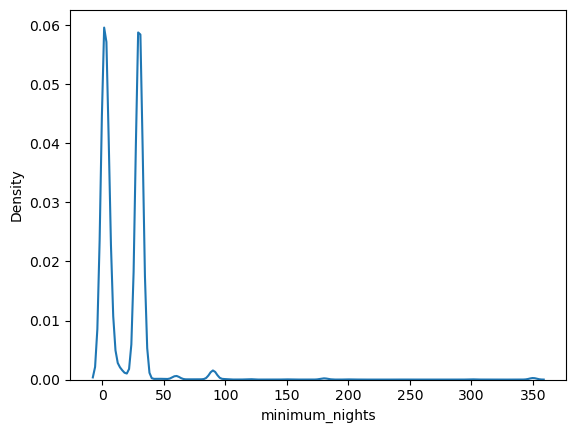

In [33]:
sns.kdeplot(df['minimum_nights'])

In [165]:
df['maximum_nights'].describe()

count    3.430500e+04
mean     6.433608e+04
std      1.159547e+07
min      1.000000e+00
25%      6.000000e+01
50%      3.650000e+02
75%      1.125000e+03
max      2.147484e+09
Name: maximum_nights, dtype: float64

<AxesSubplot:xlabel='maximum_nights', ylabel='Density'>

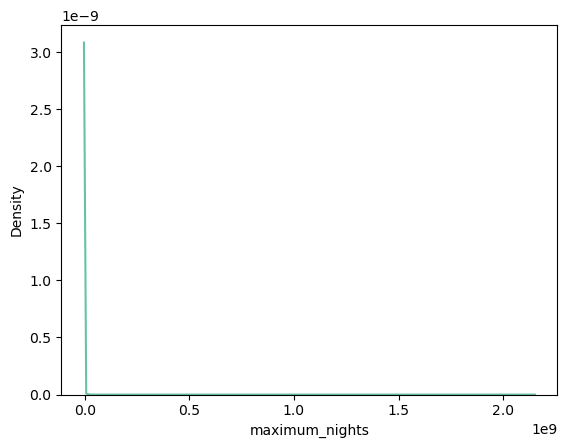

In [167]:
sns.kdeplot(df['maximum_nights'])

In [125]:
df.groupby('neighbourhood_group')['maximum_nights'].describe()

,count,mean,std,min,25%,50%,75%,max
neighbourhood_group,,,,,,,,
Bronx,1687.0,489.289864,4.734688e+02,1.0,30.0,365.0,1125.0,1.125000e+03
Brooklyn,16226.0,3014.857821,2.220317e+05,1.0,40.0,365.0,1125.0,2.000000e+07
Manhattan,17627.0,122431.688603,1.617486e+07,1.0,120.0,365.0,1125.0,2.147484e+09
Queens,6916.0,547.975419,4.893775e+02,1.0,30.0,365.0,1125.0,1.125000e+03
Staten Island,429.0,536.384615,4.806730e+02,3.0,45.0,365.0,1125.0,1.125000e+03


In [169]:
df[df['maximum_nights']>2000]

,name,host_name,host_since,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_identity_verified,neighbourhood,neighbourhood_group,latitude,longitude,property_type,room_type,accommodates,bathrooms_text,bedrooms,beds,amenities,minimum_nights,maximum_nights,has_availability,availability_365,number_of_reviews,first_review,last_review,instant_bookable,calculated_host_listings_count,price,listing_life,day_of_review,distance_to_airport,distance_to_timessquare,host_experience_years,host_rating,guest_capacity,price_level
2550,The Belvedere - A Luxury One Bedroom with Loft,Rick,2017-08-17,within an hour,1.0,0.96,f,t,Williamsburg,Brooklyn,40.71159,-73.94895,Entire rental unit,Entire home/apt,3.0,1 bath,1.0,1.0,"[""Air conditioning"", ""Dryer"", ""Oven"", ""Shampoo...",30.0,9.999000e+03,t,0.0,3.0,2018-08-06 00:00:00,2018-12-23 00:00:00,f,1.0,175.0,1,Sunday,16.15,6.08,6,5,Small,Standard
10384,The Prince - A Nolita One Bedroom Apartment,Bruce,2017-08-25,within an hour,1.0,0.96,f,t,Nolita,Manhattan,40.72377,-73.99518,Entire rental unit,Entire home/apt,4.0,1 bath,1.0,1.0,"[""Air conditioning"", ""Kitchen"", ""Refrigerator""...",30.0,9.999000e+03,t,0.0,0.0,0,0,f,1.0,250.0,0,Sunday,20.23,4.00,6,5,Small,Standard
15126,Shared Apartment to share,Ingrid,2015-08-03,within an hour,1.0,0.96,f,f,East Flatbush,Brooklyn,40.64743,-73.94962,Private room in rental unit,Private room,1.0,1 bath,1.0,1.0,"[""Heating"", ""Carbon monoxide alarm"", ""Wifi"", ""...",30.0,2.000000e+07,t,365.0,2.0,2015-12-03 00:00:00,2016-01-05 00:00:00,t,1.0,143.0,0,Tuesday,14.24,12.75,8,5,Small,Economy
17697,Apartment with skylight in bedroom,Cherry-Ann,2012-07-18,within an hour,1.0,0.96,f,t,Bedford-Stuyvesant,Brooklyn,40.67915,-73.92254,Private room in rental unit,Private room,3.0,2 baths,1.0,1.0,"[""Heating"", ""Wifi"", ""Kitchen"", ""TV with standa...",30.0,1.000000e+04,t,365.0,3.0,2014-12-02 00:00:00,2016-01-15 00:00:00,f,1.0,200.0,3,Friday,12.64,10.32,11,5,Small,Standard
23478,Beautiful Boerum Hill 2 Bedroom,Thomas,2010-12-04,within an hour,1.0,0.96,f,t,Boerum Hill,Brooklyn,40.68484,-73.97906,Entire rental unit,Entire home/apt,3.0,1 bath,2.0,1.0,"[""Air conditioning"", ""Fire extinguisher"", ""Dry...",30.0,2.000000e+07,t,0.0,1.0,2015-08-31 00:00:00,2015-08-31 00:00:00,f,1.0,175.0,5,Monday,17.38,8.25,13,5,Small,Standard
24431,Great UWS Studio Apartment,Gino,2014-07-23,within an hour,1.0,0.96,f,t,Upper West Side,Manhattan,40.79159,-73.97809,Entire rental unit,Entire home/apt,1.0,1 bath,1.0,1.0,"[""Heating"", ""Wifi"", ""Kitchen"", ""TV with standa...",30.0,2.147484e+09,f,0.0,3.0,2015-05-23 00:00:00,2015-05-29 00:00:00,f,1.0,130.0,1,Friday,23.53,3.68,9,5,Small,Economy
26032,Large private 1BR with backyard - Williamsburg,Isabelle,2012-05-31,within an hour,1.0,0.96,f,t,Williamsburg,Brooklyn,40.71512,-73.95499,Entire rental unit,Entire home/apt,2.0,1 bath,1.0,1.0,"[""Air conditioning"", ""Heating"", ""Hair dryer"", ...",7.0,1.000000e+04,f,0.0,7.0,2013-10-30 00:00:00,2017-01-07 00:00:00,f,1.0,98.0,5,Saturday,16.79,5.49,11,5,Small,Economy
28377,Big Beautiful Room in Quiet Area with Private ...,Monica & Robin,2016-01-18,within an hour,1.0,0.00,f,t,Flatbush,Brooklyn,40.64874,-73.96679,Private room in rental unit,Private room,2.0,1 private bath,1.0,1.0,"[""Hangers"", ""Kitchen"", ""Free parking on premis...",30.0,3.000000e+03,t,278.0,12.0,2017-04-18 00:00:00,2017-10-03 00:00:00,f,1.0,65.0,2,Tuesday,15.70,12.35,8,5,Small,Economy
31838,Wonderful Large 1 bedroom,John,2013-12-19,within an hour,1.0,0.96,f,t,Harlem,Manhattan,40.82044,-73.95624,Entire rental unit,Entire home/apt,2.0,1 bath,1.0,1.0,"[""Air conditioning"", ""Heating"", ""Pets allowed""...",350.0,6.000000e+03,f,0.0,0.0,0,0,f,1.0,75.0,0,Sunday,24.76,7.26,10,5,Small,Economy
32481,Moore St. Bushwick Loft,Halliday,2017-05-15,within an hour,1.0,0.96,f,t,Williamsburg,Brooklyn,40.70573,-73.93297,Entire loft,Entire home/apt,6.0,1 bath,2.0,3.0,"[""Air conditioning"", ""Kitchen"", ""Oven"", ""Shamp...",30.0,9.

### If we look at the dataframe above we can see that some values are extremely high and appear just once in the dataframe.

In [32]:
df = df[df['maximum_nights'] <= 2000]

In [33]:
df.reset_index(drop=True, inplace=True)

<AxesSubplot:xlabel='maximum_nights', ylabel='Density'>

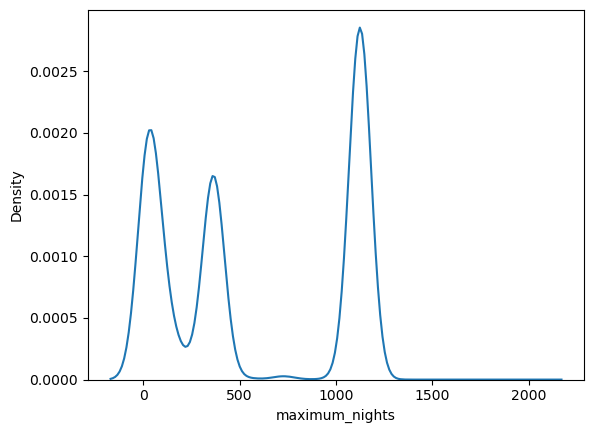

In [36]:
sns.kdeplot(df['maximum_nights'])

In [129]:
# investigating listing life

In [37]:
df.loc[:,['listing_life','neighbourhood_group']].groupby('neighbourhood_group').describe()

listing_life                                              
                           count      mean       std  min  25%  50%  75%   max
neighbourhood_group                                                           
Bronx                     1688.0  3.396327  3.288883  0.0  0.0  3.0  6.0  13.0
Brooklyn                 16220.0  4.370284  3.758970  0.0  0.0  4.0  7.0  15.0
Manhattan                17624.0  3.367453  3.482973 -3.0  0.0  2.0  6.0  14.0
Queens                    6916.0  3.423077  3.132967  0.0  0.0  3.0  6.0  14.0
Staten Island              429.0  4.226107  3.273751  0.0  1.0  4.0  7.0  12.0

In [131]:
df[df['listing_life']<0]

,name,host_name,host_since,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_identity_verified,neighbourhood,neighbourhood_group,latitude,longitude,property_type,room_type,accommodates,bathrooms_text,bedrooms,beds,amenities,price,minimum_nights,maximum_nights,has_availability,availability_365,number_of_reviews,first_review,last_review,instant_bookable,calculated_host_listings_count,listing_life,day_of_review,distance_to_airport,distance_to_timessquare,host_experience_years,host_rating,guest_capacity,price_level
13909,Midtown 45 Resort - Hotel,Brianna,2022-08-18,within an hour,1.0,0.93,f,f,Midtown,Manhattan,40.752668,-73.972484,Other,Private room,2.0,1 private bath,1.0,1.0,"[""Hangers"", ""Bathtub"", ""Hot water"", ""TV"", ""Dis...",593.0,1.0,1125.0,t,335.0,1.0,2020-01-01 00:00:00,2020-01-01 00:00:00,t,17.0,-3,Wednesday,20.32,1.27,1,5,Small,Luxury
15644,Midtown 45 Resort - Hotel,Brianna,2022-08-18,within an hour,1.0,0.93,f,f,Midtown,Manhattan,40.752668,-73.972484,Other,Private room,2.0,1 private bath,1.0,1.0,"[""Hangers"", ""Bathtub"", ""Hot water"", ""TV"", ""Dis...",593.0,1.0,1125.0,t,0.0,1.0,2019-12-23 00:00:00,2019-12-23 00:00:00,t,17.0,-3,Monday,20.32,1.27,1,5,Small,Luxury
17179,Midtown 45 Resort - Hotel,Brianna,2022-08-18,within an hour,1.0,0.93,f,f,Midtown,Manhattan,40.752668,-73.972484,Other,Private room,2.0,1 private bath,1.0,1.0,"[""Hangers"", ""Bathtub"", ""Hot water"", ""TV"", ""Dis...",593.0,1.0,1125.0,t,335.0,3.0,2019-10-23 00:00:00,2019-12-12 00:00:00,t,17.0,-3,Thursday,20.32,1.27,1,5,Small,Luxury
18798,Midtown 45 Resort - 1 Bedroom Suite,Brianna,2022-08-18,within an hour,1.0,0.93,f,f,Midtown,Manhattan,40.752668,-73.972484,Other,Private room,4.0,1 private bath,1.0,2.0,"[""Hangers"", ""Bathtub"", ""Hot water"", ""TV"", ""Dis...",742.0,1.0,1125.0,t,0.0,1.0,2019-12-10 00:00:00,2019-12-10 00:00:00,t,17.0,-3,Tuesday,20.32,1.27,1,5,Small,Luxury
18881,Midtown 45 Resort - Hotel,Brianna,2022-08-18,within an hour,1.0,0.93,f,f,Midtown,Manhattan,40.752668,-73.972484,Other,Private room,2.0,1 private bath,1.0,1.0,"[""Hangers"", ""Bathtub"", ""Hot water"", ""TV"", ""Dis...",593.0,1.0,1125.0,t,335.0,1.0,2020-01-01 00:00:00,2020-01-01 00:00:00,t,17.0,-3,Wednesday,20.32,1.27,1,5,Small,Luxury
20836,Midtown 45 Resort - 1 Bedroom Suite,Brianna,2022-08-18,within an hour,1.0,0.93,f,f,Midtown,Manhattan,40.752668,-73.972484,Other,Private room,4.0,1 private bath,1.0,2.0,"[""Hangers"", ""Bathtub"", ""Hot water"", ""TV"", ""Dis...",742.0,1.0,1125.0,t,0.0,2.0,2019-09-20 00:00:00,2019-10-13 00:00:00,t,17.0,-3,Sunday,20.32,1.27,1,5,Small,Luxury


In [53]:
# Assuming these to be some error in records

In [34]:
df = df[df['listing_life']>=0]

### Visualising and analysing the input variables

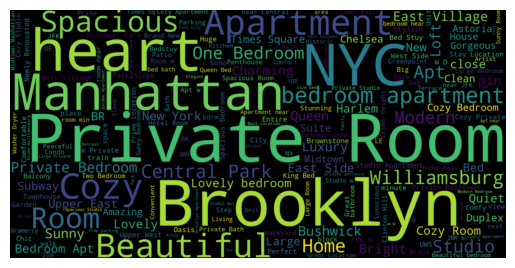

In [44]:
text = ' '.join(df['name'])
wordcloud = WordCloud(width=2000, height=1000).generate(text)
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()


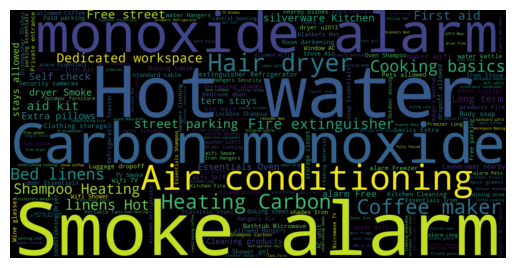

In [45]:
text = ' '.join(df['amenities'])
wordcloud = WordCloud(width=2000, height=1000).generate(text)
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()


Visualising the listings using a map plot

In [35]:
fig = px.scatter_mapbox(df, lat='latitude', lon='longitude', color='neighbourhood_group',
                        hover_name='name', hover_data=['price', 'room_type'],
                        zoom=10, height=500,
                        color_discrete_map={'Manhattan': 'green', 'Brooklyn': 'lightcoral', 'Queens': 'maroon',
                                            'Bronx': 'orange', 'Staten Island': 'mediumpurple'})
fig.update_layout(mapbox_style='open-street-map')
fig.show()

In [36]:
df['neighbourhood_group'].value_counts(normalize=True) * 100

Manhattan        41.095379
Brooklyn         37.834434
Queens           16.132117
Bronx             3.937394
Staten Island     1.000676
Name: neighbourhood_group, dtype: float64

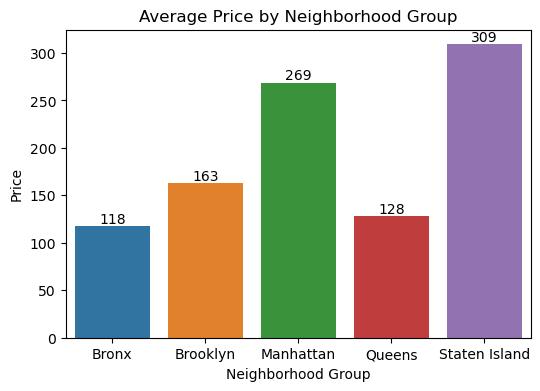

In [47]:
group_prices = df.groupby('neighbourhood_group')['price'].mean() 

plt.figure(figsize=(6, 4))
ax = sns.barplot(data = df, x=group_prices.index, y=group_prices.values)
for p in ax.patches:
    ax.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()),
                 ha = 'center', va = 'center', xytext = (0, 5), textcoords = 'offset points')
plt.xlabel('Neighborhood Group')
plt.ylabel('Price')
plt.title('Average Price by Neighborhood Group')
plt.show()

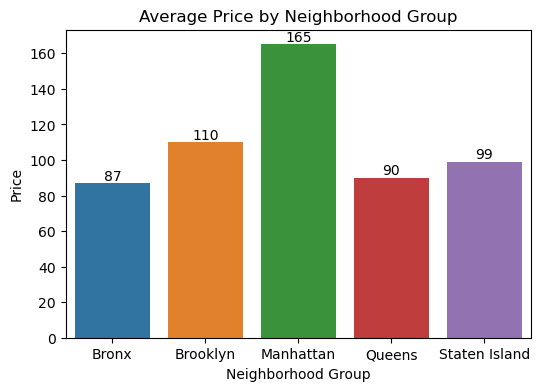

In [48]:
group_prices = df.groupby('neighbourhood_group')['price'].median() 

plt.figure(figsize=(6, 4))
ax = sns.barplot(data = df, x=group_prices.index, y=group_prices.values)
for p in ax.patches:
    ax.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()),
                 ha = 'center', va = 'center', xytext = (0, 5), textcoords = 'offset points')
plt.xlabel('Neighborhood Group')
plt.ylabel('Price')
plt.title('Average Price by Neighborhood Group')
plt.show()

### Staten Island has few but expensive listings. Manhattan has the most numbe of listings but has a spread of values from low to high

### Lets find some insights about the hosts

### Lets take a look at the Top 10 hosts with most number of lisitings in New York. 

In [49]:
top_10_hosts = df['host_name'].value_counts().head(10)
top_10_hosts

Blueground    526
Eugene        400
RoomPicks     381
Michael       322
David         306
June          232
Hiroki        207
Daniel        204
Shogo         192
Jeniffer      181
Name: host_name, dtype: int64

(0.0, 100.0, 0.0, 100.0)

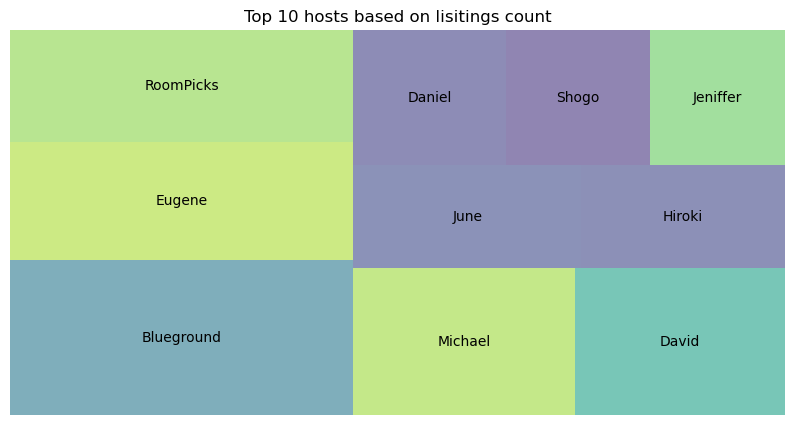

In [50]:
fig = plt.figure(figsize=(10, 5))
squarify.plot(sizes=top_10_hosts, label=top_10_hosts.index, alpha=0.6)
plt.title('Top 10 hosts based on lisitings count')
plt.axis('off')

### Most experienced host

In [51]:
df['host_experience_years'].unique()

array([ 1,  2,  5,  7,  8,  9,  3,  4,  6,  0, 11, 10, 12, 13, 14, 15])

In [52]:
df['host_experience_years'].describe()

count    42887.000000
mean         6.745704
std          3.297993
min          0.000000
25%          4.000000
50%          7.000000
75%          9.000000
max         15.000000
Name: host_experience_years, dtype: float64

In [53]:
most_experienced_host = df[df['host_experience_years']==15]
most_experienced_host

,name,host_name,host_since,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_identity_verified,neighbourhood,neighbourhood_group,latitude,longitude,property_type,room_type,accommodates,bathrooms_text,bedrooms,beds,amenities,price,minimum_nights,maximum_nights,has_availability,availability_365,number_of_reviews,first_review,last_review,instant_bookable,calculated_host_listings_count,listing_life,day_of_review,distance_to_airport,distance_to_timessquare,host_experience_years,host_rating,guest_capacity,price_level
1762,BlissArtsSpace!,Garon,2009-02-03,within a day,1.00,0.82,t,t,Bedford-Stuyvesant,Brooklyn,40.685350,-73.955120,Private room in rental unit,Private room,2.0,1 bath,1.0,1.0,"[""Air conditioning"", ""Wifi"", ""Heating"", ""Kitch...",60.0,30.0,730.0,t,365.0,50.0,2009-05-28 00:00:00,2019-12-02 00:00:00,f,2.0,11,Monday,15.47,8.56,15,5,Small,Economy
5148,"Sunny 2 BR, 15 mins to Manhattan",Jennifer And Grace,2009-02-05,within an hour,1.00,1.00,t,t,Astoria,Queens,40.759928,-73.923433,Entire home,Entire home/apt,4.0,1 bath,2.0,2.0,"[""Hangers"", ""Microwave"", ""Dishwasher"", ""Dishes...",185.0,2.0,60.0,t,159.0,14.0,2022-11-17 00:00:00,2023-02-20 00:00:00,t,1.0,14,Monday,17.80,5.20,15,5,Small,Standard
5582,Sunny Tribeca penthouse loft,Ipek,2008-10-21,within an hour,1.00,0.96,f,t,SoHo,Manhattan,40.720330,-74.002700,Entire loft,Entire home/apt,2.0,1.5 baths,1.0,1.0,"[""Hangers"", ""Air conditioning"", ""Fire extingui...",600.0,10.0,60.0,t,0.0,0.0,0,0,f,1.0,0,0,20.64,4.54,15,5,Small,Luxury
7691,Real Brooklyn Experience?,Vee,2009-02-03,within an hour,1.00,0.20,f,t,Crown Heights,Brooklyn,40.668400,-73.929050,Private room in rental unit,Private room,1.0,1 shared bath,1.0,1.0,"[""Hangers"", ""Cleaning products"", ""Clothing sto...",50.0,22.0,1125.0,t,179.0,3.0,2021-02-25 00:00:00,2022-08-10 00:00:00,f,2.0,14,Wednesday,12.84,11.12,15,5,Small,Economy
9250,Grand Brooklyn Experience!,Vee,2009-02-03,within an hour,1.00,0.20,f,t,Crown Heights,Brooklyn,40.666620,-73.928520,Private room in rental unit,Private room,2.0,1 shared bath,1.0,2.0,"[""Hangers"", ""Air conditioning"", ""Security came...",40.0,21.0,1125.0,t,0.0,1.0,2021-01-28 00:00:00,2021-01-28 00:00:00,f,2.0,12,Thursday,12.75,11.32,15,5,Small,Economy
9879,Riomaggiore Queen Rm. Superfast Wi-Fi Clean Q...,John,2008-09-07,within an hour,1.00,0.89,f,t,Bensonhurst,Brooklyn,40.609660,-73.976450,Private room in townhouse,Private room,2.0,1 shared bath,1.0,1.0,"[""Hangers"", ""Security cameras on property"", ""F...",199.0,1.0,365.0,t,180.0,42.0,2016-02-08 00:00:00,2023-01-14 00:00:00,f,7.0,14,Saturday,16.88,16.61,15,5,Small,Standard
12270,Quality Cozy Studio Next to Subway,R,2008-10-14,within a few hours,1.00,0.00,f,t,Elmhurst,Queens,40.734470,-73.880540,Entire rental unit,Entire home/apt,2.0,1 bath,1.0,1.0,"[""Hangers"", ""Microwave"", ""TV"", ""Dishes and sil...",169.0,5.0,90.0,t,365.0,73.0,2011-11-02 00:00:00,2020-01-01 00:00:00,f,1.0,11,Wednesday,13.29,9.22,15,5,Small,Standard
12498,Private Bliss Art Space 2,Garon,2009-02-03,within a day,1.00,0.82,t,t,Bedford-Stuyvesant,Brooklyn,40.687770,-73.949760,Private room in rental unit,Private room,2.0,1 shared bath,1.0,1.0,"[""Air conditioning"", ""Kitchen"", ""Heating"", ""Ha...",70.0,30.0,730.0,t,363.0,60.0,2010-04-04 00:00:00,2022-06-01 00:00:00,f,2.0,13,Wednesday,15.13,8.45,15,5,Small,Economy
12802,"Large Sunny Brooklyn Duplex, Patio + Garden",Rebecca,2009-02-03,within an hour,1.00,0.50,f,t,Sunset Park,Brooklyn,40.662650,-73.994540,Entire rental unit,Entire home/apt,4.0,1.5 baths,2.0,2.0,"[""Air conditioning"", ""Refrigerator"", ""Outdoor ...",275.0,60.0,1125.0,t,181.0,3.0,2014-01-02 00:00:00,2022-08-10 00:00:00,f,1.0,14,Wednesday,18.17,10.73,15,5,Small,Standard
14431,Gorgeous city oasis & sanctuary,Avriel,2008-10-29,within an hour,1.00,0.96,f,t,Upper West Side,Manhattan,40.782021,-73.979901,Entire rental unit,Entire home/apt,3.0,1 bath,2.0,2.0,"[""Air conditioning"", ""Piano"", ""Fire extinguish...",194.0,30

In [54]:
experienced_hosts = df[df['host_experience_years'] == 15]['host_name'].unique()
experienced_hosts.tolist()

['Garon',
 'Jennifer And Grace',
 'Ipek',
 'Vee',
 'John',
 'R',
 'Rebecca',
 'Avriel',
 'Casey',
 'Subhana',
 'Saeko',
 'Letha M.',
 'Jorge',
 'Mary',
 'Micah',
 'Tasos',
 'Adam',
 'Miranda',
 'MaryEllen',
 'Jennifer',
 'Teedo',
 'Matthew']

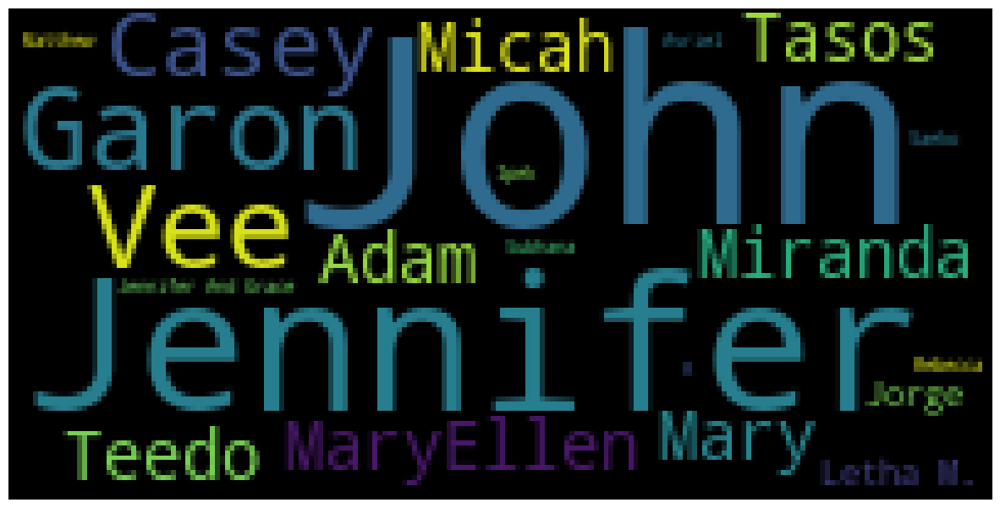

In [55]:
experienced_hosts_df = df[df['host_experience_years'] == 15]

host_freq = experienced_hosts_df['host_name'].value_counts().to_dict()

wordcloud = WordCloud(width = 200, height = 100).generate_from_frequencies(host_freq)

plt.figure(figsize=(15,8))
plt.imshow(wordcloud)
plt.axis("off")
plt.show()


In [56]:
df[df['host_experience_years'] == 15].groupby('neighbourhood_group')['host_name'].nunique()

neighbourhood_group
Brooklyn         10
Manhattan         8
Queens            3
Staten Island     1
Name: host_name, dtype: int64

### Average Host response rate and acceptance rate per neighbourhood

In [57]:
df.loc[:,['neighbourhood_group','host_acceptance_rate']].groupby('neighbourhood_group').mean().sort_values(by='host_acceptance_rate', ascending=False)

,host_acceptance_rate
neighbourhood_group,
Staten Island,0.918718
Bronx,0.898945
Queens,0.893768
Manhattan,0.873211
Brooklyn,0.858852


In [58]:
df.loc[:,['neighbourhood_group','host_response_time']].groupby('neighbourhood_group').describe()

host_response_time                              
                                 count unique             top   freq
neighbourhood_group                                                 
Bronx                             1688      4  within an hour   1339
Brooklyn                         16227      4  within an hour  12494
Manhattan                        17627      4  within an hour  13484
Queens                            6916      4  within an hour   5279
Staten Island                      429      4  within an hour    342

In [59]:
df.loc[:,['neighbourhood_group','host_response_rate']].groupby('neighbourhood_group').mean().sort_values(by='host_response_rate', ascending=False)

,host_response_rate
neighbourhood_group,
Queens,0.967848
Brooklyn,0.967223
Bronx,0.958507
Manhattan,0.957856
Staten Island,0.956457


#### As we can see the hosts,  on an average, take an hour to respond through out all the neighbourhood groups.
#### The response rate and acceptance rates are also quite good in all neighbourhood groups.
#### We can notice that although not bad, but the acceptance rates in Brooklyn and Manhattan are low as compared to other neighbourhood groups. The possible reason could be the demand and popularity of these neighbourhood groups

In [70]:
df['host_response_time'].unique()

array(['within an hour', 'within a few hours', 'a few days or more',
       'within a day'], dtype=object)

In [60]:
df_counts = df.groupby(['room_type','host_response_time'])['neighbourhood_group'].value_counts()
df_counts

room_type        host_response_time  neighbourhood_group
Entire home/apt  a few days or more  Manhattan               175
                                     Brooklyn                125
                                     Queens                   41
                                     Bronx                    14
                                     Staten Island             4
                 within a day        Manhattan               994
                                     Brooklyn                785
                                     Queens                  138
                                     Bronx                    50
                                     Staten Island            10
                 within a few hours  Manhattan              1619
                                     Brooklyn               1094
                                     Queens                  394
                                     Bronx                    83
                                 

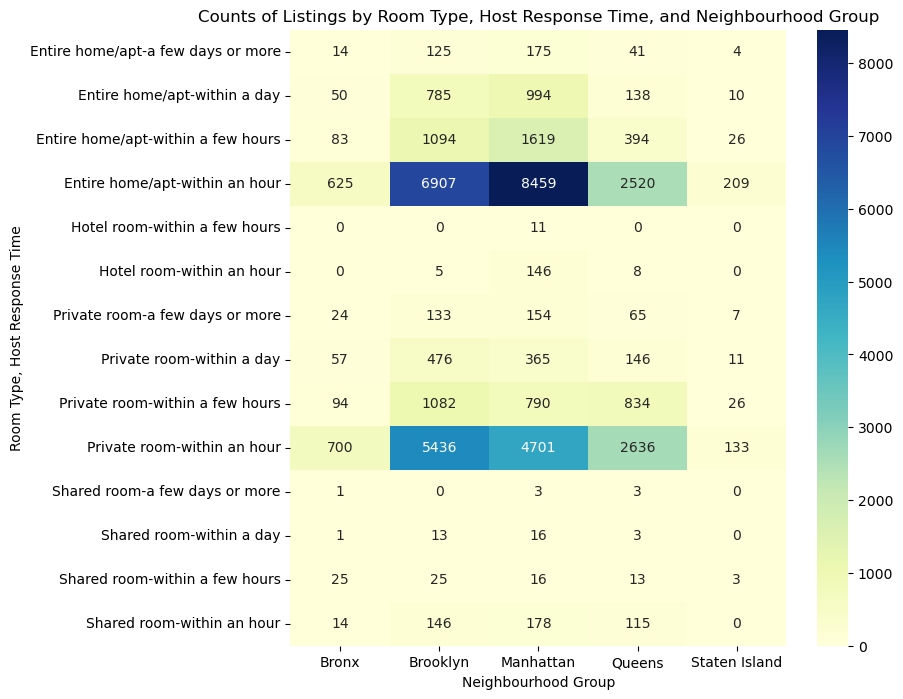

In [61]:
df_counts = df.groupby(['room_type', 'host_response_time', 'neighbourhood_group']).size().reset_index(name='counts')
pivot_df = df_counts.pivot_table(index=['room_type', 'host_response_time'], columns='neighbourhood_group', values='counts', fill_value=0)


plt.figure(figsize=(8,8))
sns.heatmap(pivot_df, cmap="YlGnBu", annot=True, fmt=".0f")
plt.title('Counts of Listings by Room Type, Host Response Time, and Neighbourhood Group')
plt.xlabel('Neighbourhood Group')
plt.ylabel('Room Type, Host Response Time')
plt.show()


#### The insights say that if you are looking to book a stay in Manhattan, its best preferred to contact the hosts in advance as it has the highest number of listings were the hosts take some days to respond,especially when booking an Entire home

### Let us find out more details about the hosts in terms of superhost and identity verification

In [62]:
df.groupby(['neighbourhood_group','host_identity_verified'])['host_is_superhost'].size()

neighbourhood_group  host_identity_verified
Bronx                f                           342
                     t                          1346
Brooklyn             f                          2298
                     t                         13929
Manhattan            f                          2300
                     t                         15327
Queens               f                          1184
                     t                          5732
Staten Island        f                           124
                     t                           305
Name: host_is_superhost, dtype: int64

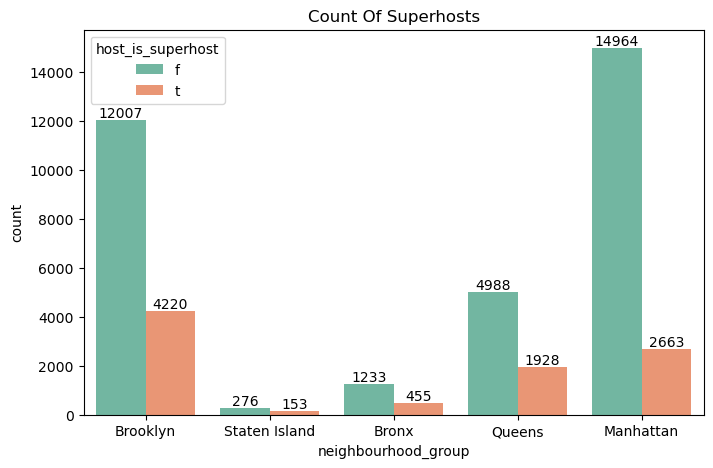

In [63]:
plt.figure(figsize=(8,5)) 

ax = sns.countplot(data=df, x='neighbourhood_group', hue='host_is_superhost',palette='Set2')
for p in ax.patches:
    ax.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()),
                 ha = 'center', va = 'center', xytext = (0, 5), textcoords = 'offset points')
plt.title('Count Of Superhosts')
plt.show()


#### More than 70%(approximately) of the hosts are Super Hosts and most numbers come from Brooklyn and Manhattan.

<AxesSubplot:xlabel='neighbourhood_group'>

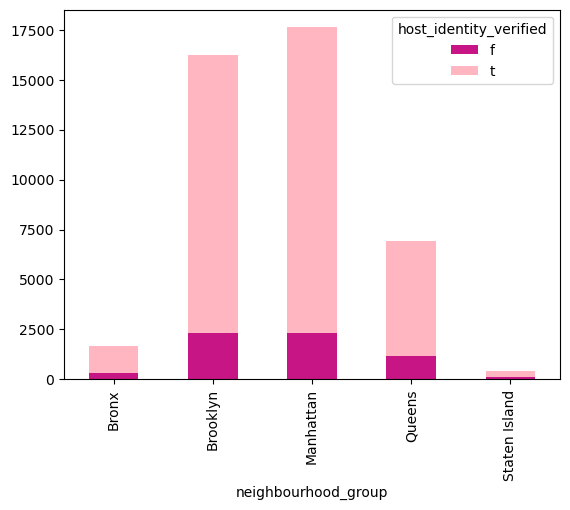

In [64]:
df.groupby(['neighbourhood_group','host_identity_verified'])['host_is_superhost'].size().unstack().plot(kind='bar',stacked=True,color=["#C71585","#FFB6C1"])

#### Amongst the Superhosts more than 80%(approximately) of the hosts have verified identity. This indicates that there is some presence of illegal hosting (but the proportions are low)

## Neighbourhood_groups 

### Lets have a look at the count of lisitngs in the different neighbourhood groups

In [65]:
df['neighbourhood_group'].value_counts()

Manhattan        17627
Brooklyn         16227
Queens            6916
Bronx             1688
Staten Island      429
Name: neighbourhood_group, dtype: int64

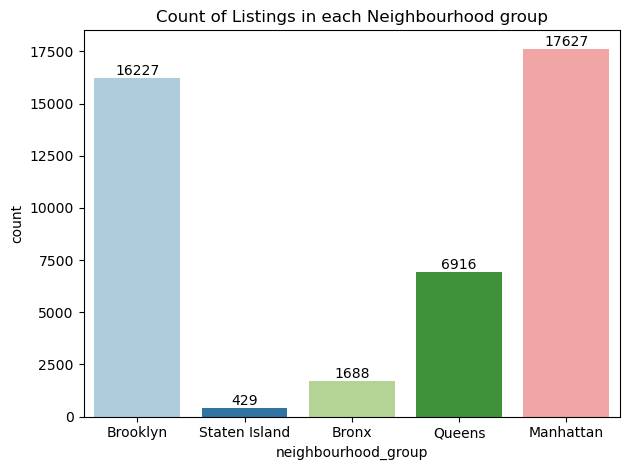

In [66]:
ax = sns.countplot(data=df, x='neighbourhood_group', palette="Paired")
ax.set_title('Count of Listings in each Neighbourhood group')
for p in ax.patches:
    ax.annotate(format(p.get_height(), '.0f'), 
                (p.get_x() + p.get_width() / 2., p.get_height()),
                ha = 'center', va = 'center', xytext = (0, 5), textcoords = 'offset points')

plt.tight_layout()
plt.show()


   #### It can be observed that New York has most number of Airbnbs in Manhattan and Brooklyn and the least count of listings coming fromStaten Island. Manhattan and Brooklyn are on the top and the obvious reason for this could be that there are most number of tourist places here. Manhattan is the heart of New York city. Listing an Airbnb in Manhattan could help the hosts benefit from making a good money as tourists visit here in huge numbers.
   #### Hosts could also list properties in other neighbourhoods as there is less avaialbility and competition in Bronx and Staten Island

#### The reason for low listings could also be due to data collection issues, it can be possible that less data was collected fromStaten Island and Bronx. This could probably create some bias in the data set

### Let us explore which particular neighbourhood is the most popular with the highest number of hostings

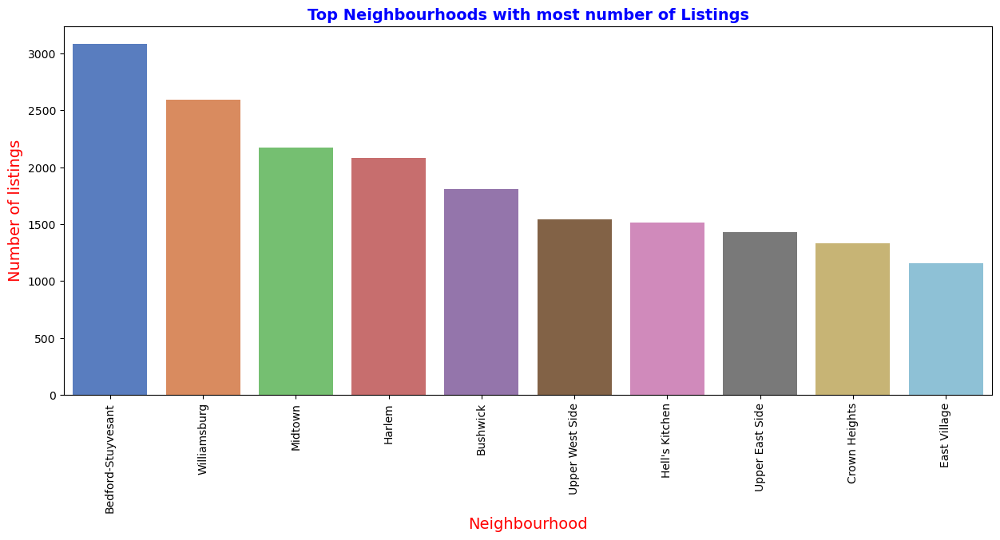

In [67]:
top_neighbourhood = df['neighbourhood'].value_counts()[:10]
plt.figure(figsize=[15,6])
sns.barplot(x=top_neighbourhood.index, y=top_neighbourhood.values, palette='muted')
plt.title('Top Neighbourhoods with most number of Listings', color='b', fontsize=14, fontweight='bold')
plt.ylabel('Number of listings', color='r', fontsize=14)
plt.xlabel('Neighbourhood', color='r', fontsize=14)
plt.xticks(rotation=90)  
plt.show()



 Bedford-Stuyvesant tops the list followed by Williamsburg and Midtown

### Let us take a look at the neighbourhoods of the popular groups - Manhattan and Brooklyn

In [68]:
top_5 = df[df['neighbourhood_group']=='Manhattan']['neighbourhood'].value_counts().head()
top_5

Midtown            2175
Harlem             2079
Upper West Side    1539
Hell's Kitchen     1517
Upper East Side    1431
Name: neighbourhood, dtype: int64

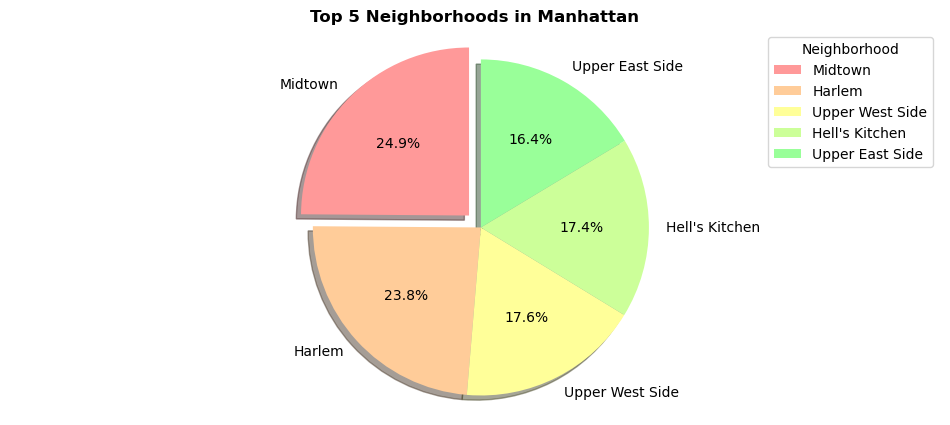

In [69]:
plt.figure(figsize=(12, 5))
colors = ['#FF9999', '#FFCC99', '#FFFF99', '#CCFF99', '#99FF99'] 
explode = (0.1, 0, 0, 0, 0)  # Explode the first slice

plt.pie(top_5, labels=top_5.index, colors=colors,
        explode=explode, autopct='%1.1f%%', startangle=90, shadow=True)

plt.axis('equal')
plt.title('Top 5 Neighborhoods in Manhattan', fontweight='bold')
plt.legend(title='Neighborhood', loc='best')
plt.show()

In [71]:
top_5_brooklyn = df[df['neighbourhood_group']=='Brooklyn']['neighbourhood'].value_counts().head()
top_5_brooklyn

Bedford-Stuyvesant    3085
Williamsburg          2592
Bushwick              1809
Crown Heights         1329
Greenpoint             751
Name: neighbourhood, dtype: int64

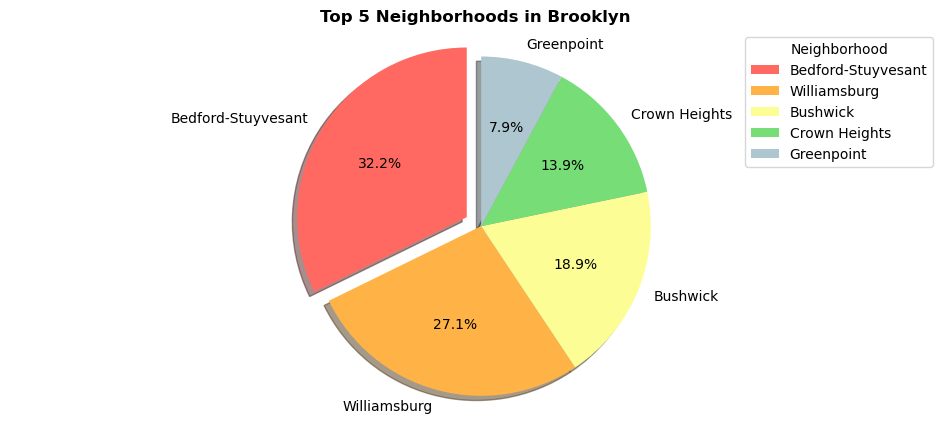

In [72]:
plt.figure(figsize=(12, 5))
colors = ['#FF6961', '#FFB347', '#FDFD96', '#77DD77', '#AEC6CF']
explode = (0.1, 0, 0, 0, 0)  

plt.pie(top_5_brooklyn, labels=top_5_brooklyn.index, colors=colors,
        explode=explode, autopct='%1.1f%%', startangle=90, shadow=True)

plt.axis('equal')
plt.title('Top 5 Neighborhoods in Brooklyn', fontweight='bold')
plt.legend(title='Neighborhood', loc='best')
plt.show()

Midtown from Manhattan and Bedford-Stuyvesant from Brooklyn are the neighbourhoods with the most number of Airbnbs available for the obvious reasons that these are quite famous and are the most famous tourist attractions

## Property type

In [85]:
df['property_type'].unique()

array(['Entire townhouse', 'Entire rental unit',
       'Private room in rental unit', 'Private room in home',
       'Entire loft', 'Entire home', 'Entire villa',
       'Entire serviced apartment', 'Private room in resort',
       'Room in hotel', 'Private room in condo', 'Entire condo',
       'Private room in townhouse', 'Entire guest suite',
       'Private room in casa particular', 'Shared room in rental unit',
       'Private room in serviced apartment', 'Private room',
       'Entire place', 'Room in boutique hotel', 'Private room in hostel',
       'Entire vacation home', 'Private room in loft',
       'Shared room in home', 'Private room in guest suite',
       'Entire guesthouse', 'Barn', 'Shared room in loft',
       'Private room in bed and breakfast', 'Tiny home',
       'Entire home/apt', 'Shared room in condo', 'Camper/RV',
       'Private room in vacation home', 'Room in aparthotel',
       'Private room in tiny home', 'Boat', 'Private room in villa',
       'Private r

In [86]:
df['property_type'].nunique()

70

#### The property types are detailed description or sub categories coming from Room Type column.

In [73]:
pd.set_option('display.max_rows', None)


In [74]:
property_counts = df['property_type'].value_counts().reset_index()
property_counts.columns = ['property_type', 'count']
print(property_counts)

                         property_type  count
0                   Entire rental unit  18003
1          Private room in rental unit  11484
2                 Private room in home   2396
3                          Entire home   1727
4                         Entire condo   1645
5            Private room in townhouse   1107
6                        Room in hotel    866
7                          Entire loft    729
8            Entire serviced apartment    717
9                     Entire townhouse    665
10               Private room in condo    597
11              Room in boutique hotel    422
12          Shared room in rental unit    411
13                  Entire guest suite    375
14  Private room in serviced apartment    336
15                Private room in loft    250
16         Private room in guest suite    134
17     Private room in casa particular     93
18                   Entire guesthouse     86
19                        Entire place     83
20   Private room in bed and break

In [37]:
top15 = df['property_type'].value_counts()[:15].index
df.loc[~df['property_type'].isin(top15), 'property_type'] = 'Other'

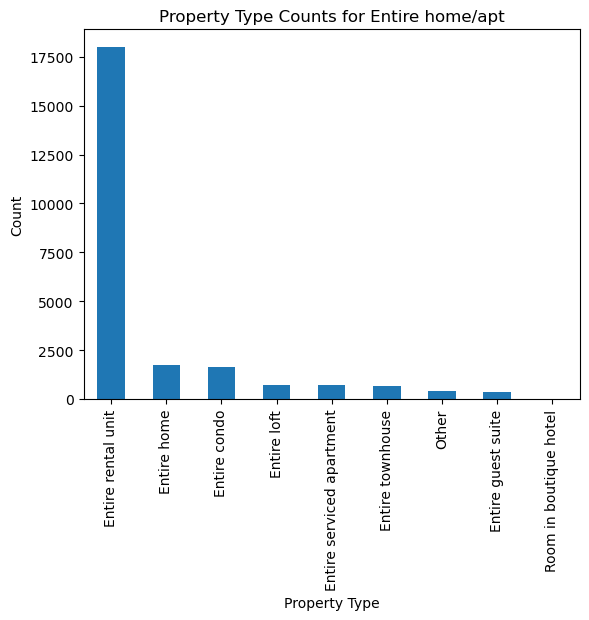

In [76]:
property_counts = df.groupby('room_type')['property_type'].value_counts()
property_counts
room_type = 'Entire home/apt'
property_counts_for_room_type = property_counts.loc[room_type]

property_counts_for_room_type.plot(kind='bar')
plt.title(f'Property Type Counts for {room_type}')
plt.xlabel('Property Type')
plt.ylabel('Count')
plt.show()


In [77]:
df[df['property_type']=='Other']

,name,host_name,host_since,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_identity_verified,neighbourhood,neighbourhood_group,latitude,longitude,property_type,room_type,accommodates,bathrooms_text,bedrooms,beds,amenities,price,minimum_nights,maximum_nights,has_availability,availability_365,number_of_reviews,first_review,last_review,instant_bookable,calculated_host_listings_count,listing_life,day_of_review,distance_to_airport,distance_to_timessquare,host_experience_years,host_rating,guest_capacity,price_level
2,Villa Masino.,Tommaso,2022-05-27,within an hour,1.00,0.96,f,f,Tottenville,Staten Island,40.507114,-74.251907,Other,Entire home/apt,6.0,2 baths,2.0,2.0,"[""BBQ grill"", ""Security cameras on property"", ...",157.0,1.0,365.0,t,364.0,0.0,0,0,f,1.0,0,0,42.50,35.93,1,5,Medium,Standard
10,nice home by the beach.,Zaid,2020-04-08,within an hour,1.00,1.00,f,t,Belle Harbor,Queens,40.577120,-73.847220,Other,Shared room,2.0,1 shared bath,1.0,1.0,"[""Hot tub""]",975.0,1.0,365.0,t,364.0,0.0,0,0,t,1.0,0,0,9.11,23.32,3,5,Small,Luxury
16,"Walking distance to train,bus and no cleaning ...",Dung,2021-07-17,within an hour,1.00,1.00,f,t,Dongan Hills,Staten Island,40.580130,-74.100320,Other,Entire home/apt,7.0,1.5 baths,3.0,4.0,"[""Hangers"", ""Clothing storage: closet"", ""Dove ...",175.0,2.0,1125.0,t,131.0,77.0,2021-08-13 00:00:00,2023-02-12 00:00:00,f,1.0,2,Sunday,27.82,22.12,2,5,Medium,Standard
18,New2BR/PreWar building EASY access to NYC!!,Frits,2019-10-14,a few days or more,0.00,0.96,f,f,Kingsbridge,Bronx,40.874180,-73.904390,Other,Shared room,1.0,3 shared baths,1.0,4.0,"[""Hangers"", ""Air conditioning"", ""Fire extingui...",301.0,30.0,1125.0,t,82.0,0.0,0,0,t,1.0,0,0,27.86,14.51,4,1,Small,Standard
20,welcome home to college point,Anna,2017-10-17,within a day,1.00,0.00,f,f,College Point,Queens,40.775302,-73.842974,Other,Private room,1.0,1 shared bath,1.0,1.0,"[""Wifi"", ""Kitchen"", ""Dedicated workspace""]",41.0,1.0,365.0,t,364.0,0.0,0,0,f,1.0,0,0,15.74,12.11,6,5,Small,Economy
46,lovely 2 bedroom apt for rent in brooklyn,Hamada,2018-04-11,within an hour,1.00,0.50,f,t,Sheepshead Bay,Brooklyn,40.593800,-73.948860,Other,Entire home/apt,4.0,1 bath,2.0,2.0,"[""Refrigerator"", ""Coffee maker"", ""Wifi"", ""Smok...",101.0,50.0,70.0,t,364.0,0.0,0,0,f,1.0,0,0,15.14,18.61,5,5,Small,Economy
58,Private Master Bedroom with balcony,Charlie,2016-01-12,within a few hours,1.00,1.00,t,t,Bayside,Queens,40.773750,-73.777760,Other,Private room,2.0,1 private bath,1.0,1.0,"[""Hangers"", ""Security cameras on property"", ""M...",89.0,30.0,365.0,t,179.0,3.0,2021-07-10 00:00:00,2022-09-02 00:00:00,f,3.0,7,Friday,14.68,17.54,8,5,Small,Economy
101,Cozy 1 BR walking distance from JFK AirTrain,Tisha,2016-09-07,within an hour,1.00,1.00,t,t,Howard Beach,Queens,40.655607,-73.828937,Other,Private room,2.0,1 private bath,1.0,1.0,"[""Hangers"", ""Security cameras on property"", ""B...",99.0,2.0,28.0,t,316.0,2.0,2022-08-09 00:00:00,2022-08-17 00:00:00,t,2.0,6,Wednesday,4.33,17.47,7,5,Small,Economy
123,RV/ Camper in the heart of NY.,Samanta,2018-03-19,a few days or more,0.29,0.00,f,t,Ditmars Steinway,Queens,40.775339,-73.897806,Other,Entire home/apt,3.0,1 bath,1.0,1.0,"[""Kitchen"", ""TV""]",70.0,1.0,15.0,t,364.0,0.0,0,0,f,1.0,0,0,17.82,7.58,5,2,Small,Economy
147,UIA x Ubl,Steven,2017-10-17,within an hour,1.00,0.96,f,t,Mill Basin,Brooklyn,40.609324,-73.919090,Other,Entire home/apt,4.0,Half-bath,1.0,1.0,"[""BBQ grill"", ""Security cameras on property"", ...",444.0,1.0,365.0,t,365.0,0.0,0,0,t,1.0,0,0,12.20,17.54,6,5,Small,Luxury


In [78]:
# Identify the most common property type for each room type
most_common_property = df.groupby('room_type')['property_type'].agg(lambda x: x.value_counts().idxmax())

In [79]:
most_common_property

room_type
Entire home/apt             Entire rental unit
Hotel room              Room in boutique hotel
Private room       Private room in rental unit
Shared room         Shared room in rental unit
Name: property_type, dtype: object

In [80]:
average_prices = []

for room_type, property_type in most_common_property.items():
    avg_price = df[(df['room_type'] == room_type) & 
                    (df['property_type'] == property_type)]['price'].mean()
    average_prices.append([room_type, property_type, avg_price])

average_prices_df = pd.DataFrame(average_prices, columns=['room_type', 'property_type', 'average_price'])


In [81]:
average_prices_df

,room_type,property_type,average_price
0,Entire home/apt,Entire rental unit,214.484641
1,Hotel room,Room in boutique hotel,343.428571
2,Private room,Private room in rental unit,108.554336
3,Shared room,Shared room in rental unit,110.070560


## Room type

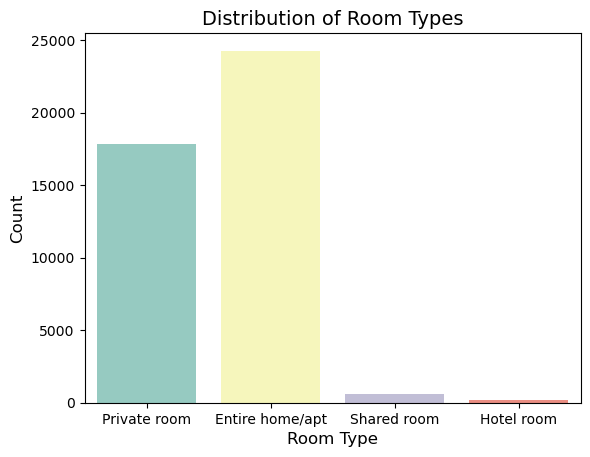

In [82]:
sns.set_palette("Set3")

# Create the countplot
ax = sns.countplot(data=df, x='room_type')

# Customize the plot
ax.set_xlabel('Room Type', fontsize=12)
ax.set_ylabel('Count', fontsize=12)
ax.set_title('Distribution of Room Types', fontsize=14)

plt.show()

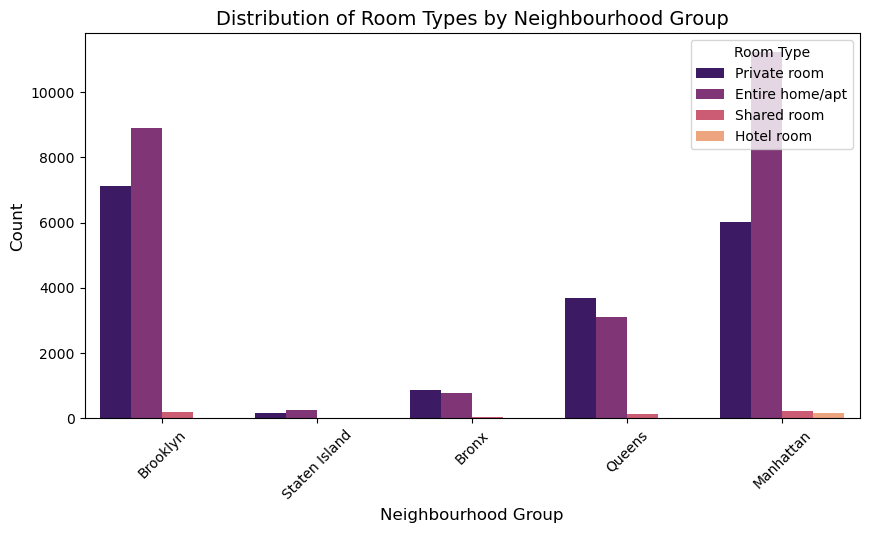

In [83]:
plt.figure(figsize=(10, 5))

ax = sns.countplot(x='neighbourhood_group', hue='room_type', data=df, palette='magma')

# Customize the plot
ax.set_xlabel('Neighbourhood Group', fontsize=12)
ax.set_ylabel('Count', fontsize=12)
ax.set_title('Distribution of Room Types by Neighbourhood Group', fontsize=14)

# Set the legend title and font size
ax.legend(title='Room Type', fontsize=10)

# Rotate x-axis labels if necessary
plt.xticks(rotation=45)

# Show the plot
plt.show()

####  It can be seen that Staten Island doesnt have any hotel rooms or shared rooms

## Accommodates - number of people allowed

In [101]:
df['accommodates'].describe()

count    34307.000000
mean         2.970997
std          2.121438
min          1.000000
25%          2.000000
50%          2.000000
75%          4.000000
max         16.000000
Name: accommodates, dtype: float64

In [84]:
np.sort(df['accommodates'].unique())

array([ 1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10., 11., 12., 13.,
       14., 15., 16.])

Text(0.5, 1.0, 'Maximum Guest capacity of Airbnb in different Neighbourhood Groups')

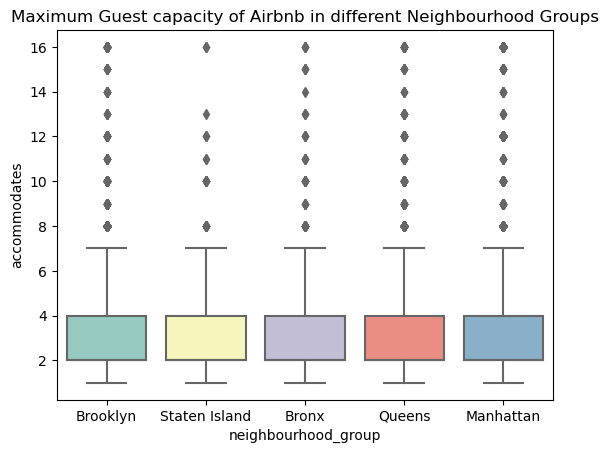

In [85]:
accomm = sns.boxplot(data=df,x="neighbourhood_group",y='accommodates')
accomm.set_title("Maximum Guest capacity of Airbnb in different Neighbourhood Groups")

#### Most of the Airbnb listings have a spread between 2-6 accommodates. 

<AxesSubplot:xlabel='accommodates', ylabel='price'>

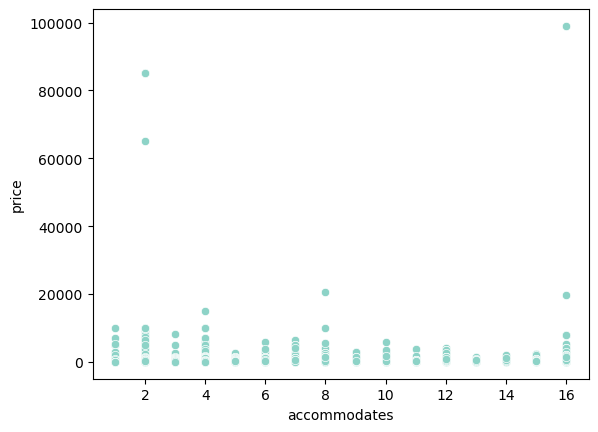

In [86]:
sns.scatterplot(data=df,x='accommodates',y='price')

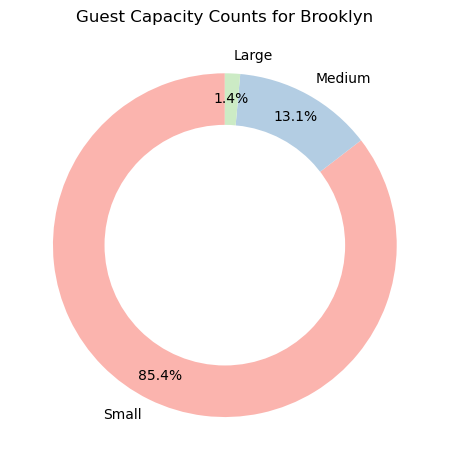

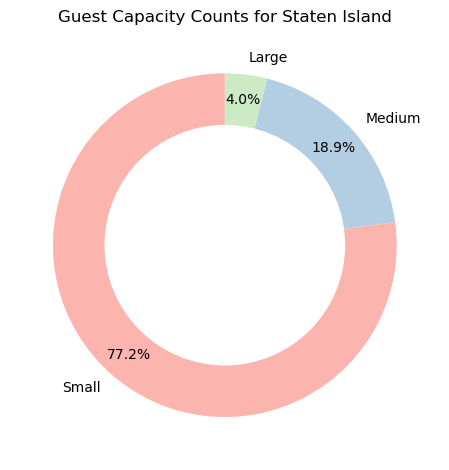

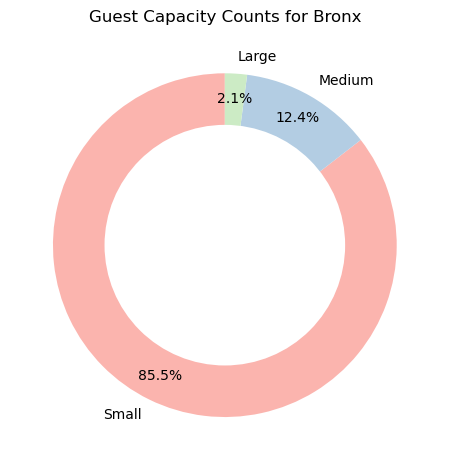

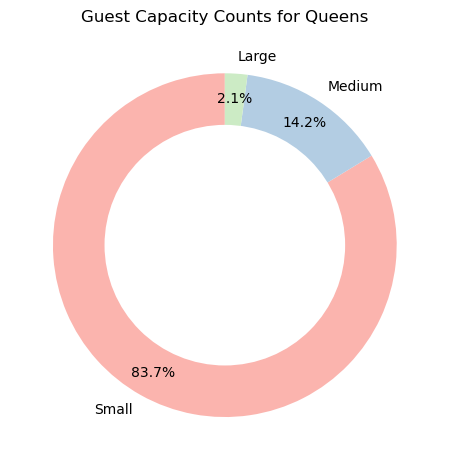

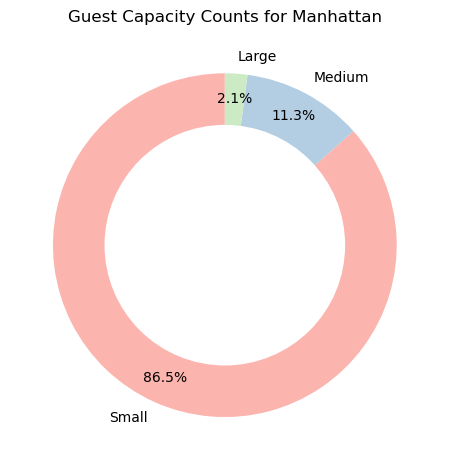

In [87]:
# Iterate over each neighbourhood group
for group in df['neighbourhood_group'].unique():
    df_group = df[df['neighbourhood_group'] == group]
    
    # Get the counts of each 'guest_capacity' category
    guest_capacity_counts = df_group['guest_capacity'].value_counts()

    colors = {'Small': '#fbb4ae', 'Medium': '#b3cde3', 'Large': '#ccebc5'}

    # Get the colors for the current categories
    guest_capacity_colors = [colors[cat] for cat in guest_capacity_counts.index]

    # Create a donut chart
    plt.pie(guest_capacity_counts, labels=guest_capacity_counts.index, colors=guest_capacity_colors, autopct='%1.1f%%', startangle=90, pctdistance=0.85)
    # Draw a circle at the center to turn the pie into a donut
    centre_circle = plt.Circle((0,0),0.70,fc='white')
    fig = plt.gcf()
    fig.gca().add_artist(centre_circle)

    plt.title(f'Guest Capacity Counts for {group}')
    plt.tight_layout()
    plt.show()


#### We can observe that Staten Island has the most number of listings that could accommodate a larger group. The guests could book an Airbnb accordingly. Manhattan and Brooklyn being the most in demand neighbourhood_groups have comparatively low options

### Let us take a look at the average prices for each capacity group type in all neighbourhood_groups

In [88]:
df.loc[:,['neighbourhood_group','guest_capacity','price']].groupby('guest_capacity').mean()

,price
guest_capacity,
Large,1056.374065
Medium,331.682037
Small,162.435655


### We can notice that the larger the group, the higher is the price

In [89]:
df.loc[:,['neighbourhood_group','guest_capacity','price']].groupby(['neighbourhood_group', 'guest_capacity']).mean()

price
neighbourhood_group guest_capacity             
Bronx               Large            363.171429
                    Medium           185.561905
                    Small            101.797644
Brooklyn            Large           1077.642241
                    Medium           278.122066
                    Small            129.803823
Manhattan           Large           1390.419355
                    Medium           468.412706
                    Small            215.253802
Queens              Large            410.226027
                    Medium           211.591837
                    Small            106.942314
Staten Island       Large            432.882353
                    Medium           197.506173
                    Small            329.969789

#### The cheapest neighbourhood for a large group is Bronx and the most expensive one is Manhattan.
#### The most expensive neighbourhood group for a small group is Manhattan, as obvious, and all other neighbourhoods are comparitivley cheaper

## Beds ,Bedrooms and Bathrooms

In [90]:
df['bedrooms'].describe()

count     42887.0
unique       12.0
top           1.0
freq      32565.0
Name: bedrooms, dtype: float64

In [91]:
average_prices = df.groupby(['neighbourhood_group', 'bedrooms'])['price'].mean().reset_index()

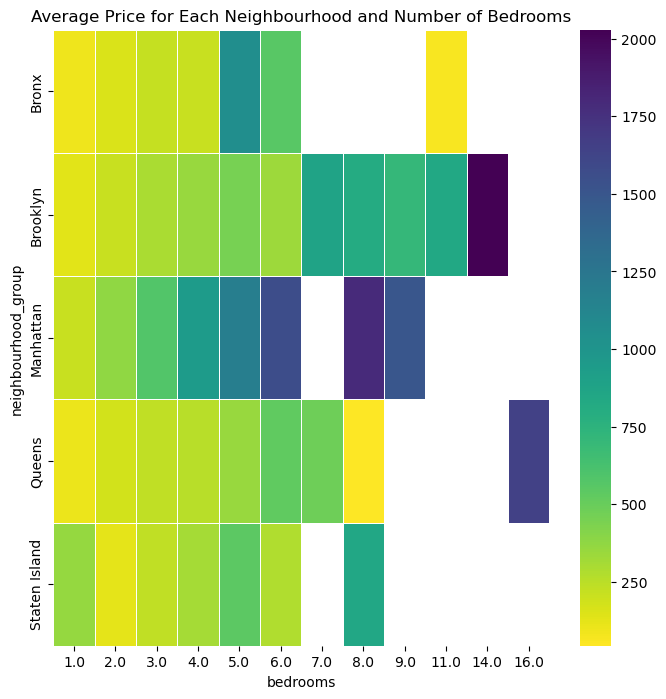

In [92]:
# Pivot the DataFrame to the right format
pivot = average_prices.pivot(index='neighbourhood_group', columns='bedrooms', values='price')

# Create the heat map
plt.figure(figsize=(8, 8))
sns.heatmap(pivot, cmap='viridis_r', linewidths=0.5)
plt.title('Average Price for Each Neighbourhood and Number of Bedrooms')
plt.show()

#### The visualisation above clearly indicates that the price increases as the number of bedrooms increase. But we can also see that Bronx has a listing with 11 bedrooms for a very low price

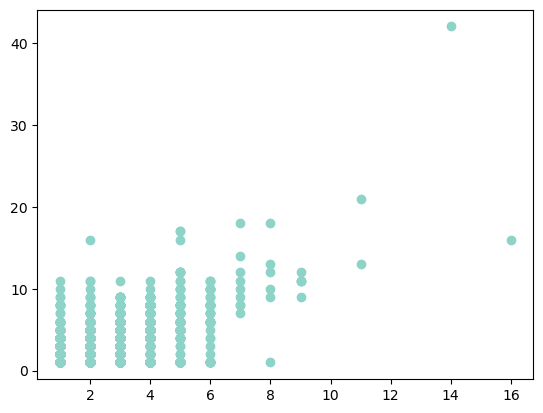

In [93]:
plt.scatter(data = df , x ='bedrooms', y = 'beds')
plt.show()

In [94]:
df['beds'].value_counts()

1.0     27253
2.0      9182
3.0      3632
4.0      1633
5.0       528
6.0       337
8.0       133
7.0       107
9.0        33
10.0       15
11.0       14
12.0        8
16.0        3
13.0        2
18.0        2
17.0        2
21.0        1
14.0        1
42.0        1
Name: beds, dtype: int64

In [95]:
average_prices_beds = df.groupby(['neighbourhood_group', 'beds'])['price'].mean().reset_index()

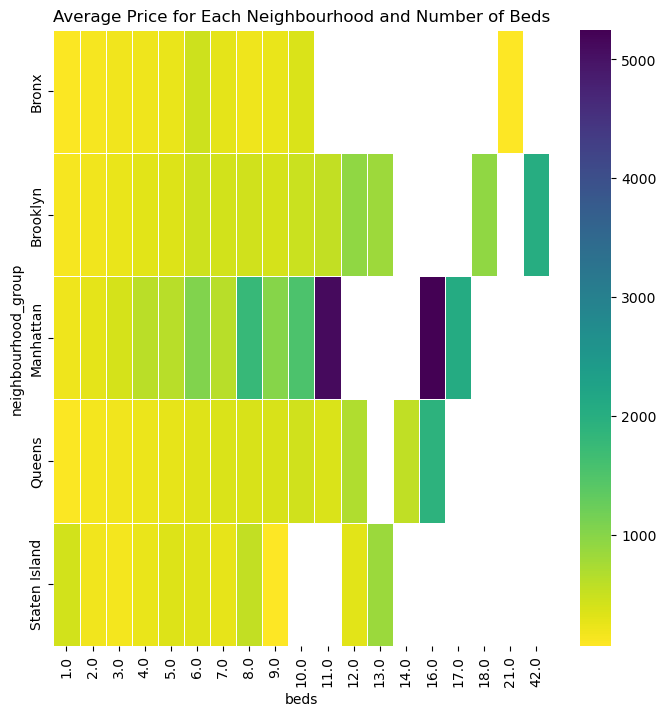

In [96]:
# Pivot the DataFrame to the right format
pivot = average_prices_beds.pivot(index='neighbourhood_group', columns='beds', values='price')

# Create the heat map
plt.figure(figsize=(8, 8))
sns.heatmap(pivot, cmap='viridis_r', linewidths=0.5)
plt.title('Average Price for Each Neighbourhood and Number of Beds')
plt.show()


<AxesSubplot:xlabel='beds', ylabel='price'>

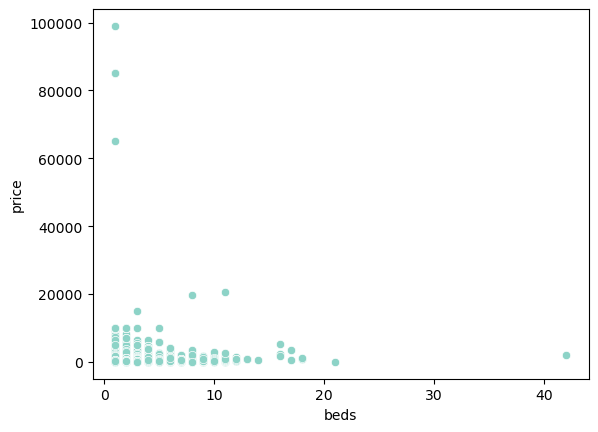

In [97]:
sns.scatterplot(data=df,x='beds',y='price')

##### we can see that one value has number of beds as 20 but the price is too low. We could remove it

In [38]:
df['beds'] = df['beds'].astype('float')
df = df[df['beds'] <= 20]

### BATHROOMS TEXT

In [99]:
df['bathrooms_text'].describe()

count      42885
unique        29
top       1 bath
freq       22276
Name: bathrooms_text, dtype: object

In [100]:
df.groupby('bathrooms_text')['price'].mean().sort_values(ascending=False)

bathrooms_text
5.5 baths            3090.100000
Half-bath            2509.130435
6.5 baths            2281.333333
7 baths              1792.000000
4.5 baths            1703.896552
5 baths              1606.454545
6 baths              1599.600000
8.5 baths            1588.000000
4 baths              1355.659420
4.5 shared baths     1002.500000
3.5 baths             993.250000
3 baths               918.654971
2.5 baths             500.587654
2 baths               395.290311
1.5 baths             236.373474
1 bath                194.724906
4 shared baths        183.250000
1 private bath        181.962207
Private half-bath     152.833333
0 baths               124.441176
6 shared baths        117.500000
0 shared baths        106.637631
Shared half-bath      105.857143
1 shared bath         103.286407
3.5 shared baths       92.500000
1.5 shared baths       87.462069
2 shared baths         85.476402
3 shared baths         62.201835
2.5 shared baths       58.988506
Name: price, dtype: float64

### Are the Airbnbs instantly bookable?


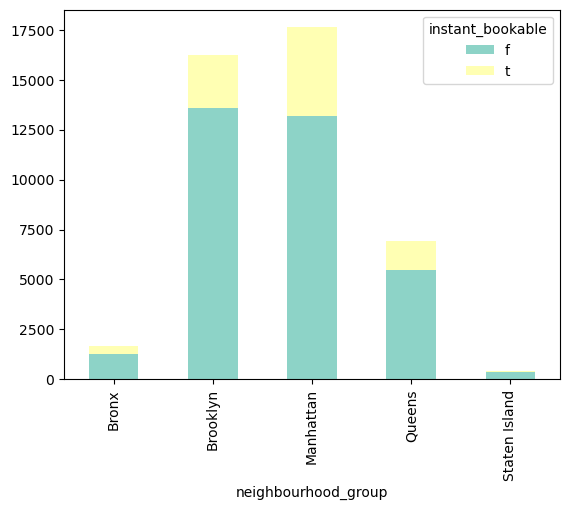

In [101]:
df.groupby('neighbourhood_group')['instant_bookable'].value_counts().unstack().plot(kind='bar', stacked=True)
plt.show()

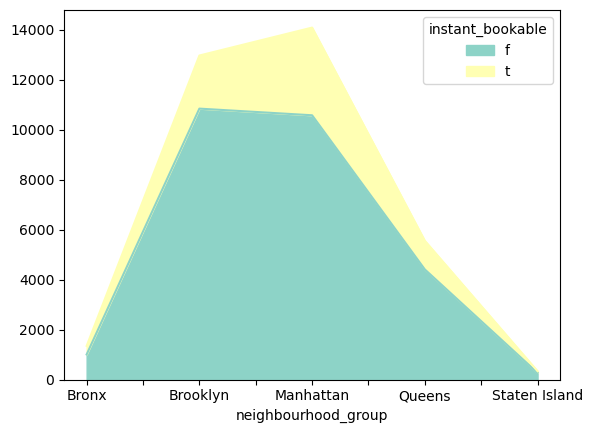

In [126]:
df.groupby('neighbourhood_group')['instant_bookable'].value_counts().unstack().plot(kind='area', stacked=True)
plt.show()

#### Properties are mostly bookable on spot in Brooklyn and Manhattan, possible reasons could be highest number of footfall in these two neighbourhood_groups. Hosts clearly dont want to miss good opportunities of business
#### Staten Island and Bronx have the least instant booking options which could mean that advance planning is required before visiting these places

## Availability of Airbnbs

In [103]:
avail_count = df['has_availability'].value_counts()
avail_count

t    36629
f     6256
Name: has_availability, dtype: int64

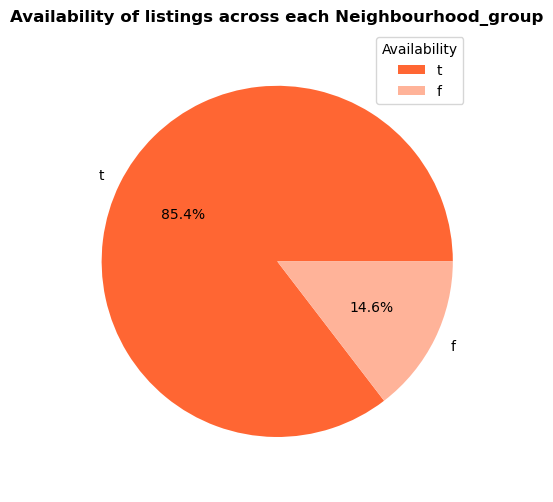

In [105]:
plt.figure(figsize=(5, 6))
plt.pie(avail_count,labels = avail_count.index, 
       autopct='%1.1f%%', colors = ['#FF6633', '#FFB399'])
plt.axis('equal')
plt.title('Availability of listings across each Neighbourhood_group', fontweight='bold')
plt.legend(title='Availability', loc='best')
plt.show()

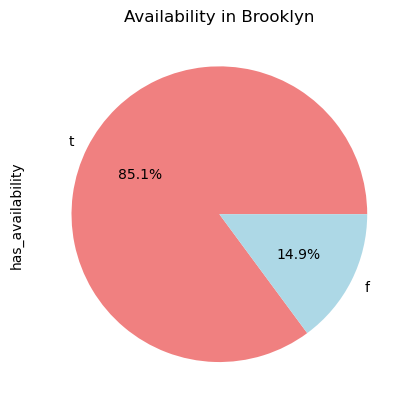

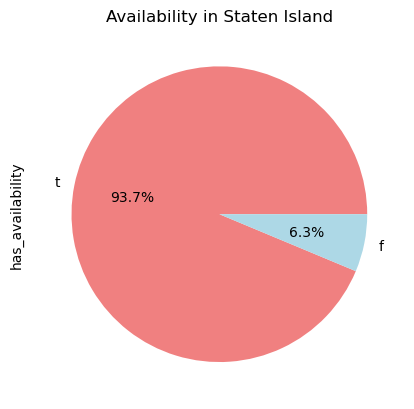

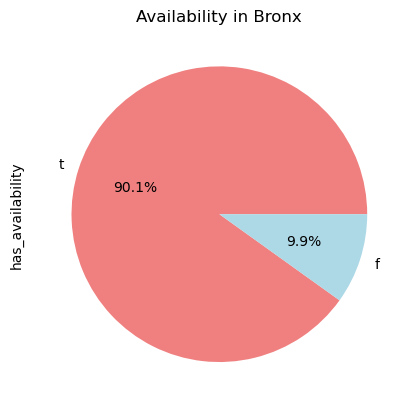

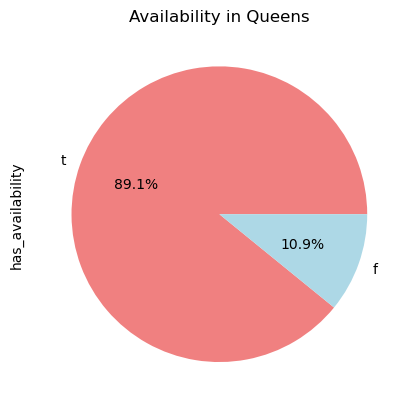

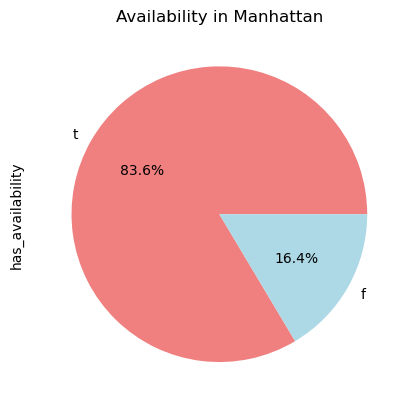

In [106]:
neighbourhoods = df['neighbourhood_group'].unique()

for neighbourhood in neighbourhoods:
    df[df['neighbourhood_group'] == neighbourhood]['has_availability'].value_counts().plot(kind='pie', autopct='%1.1f%%',colors = ['#f08080', '#add8e6'])
    plt.title(f'Availability in {neighbourhood}')
    plt.show()


#### As per our guess, Manhattan and Brooklyn have higher proportions of unavailable properties as compared to other neighbourhood_groups owing to the high demands

## Availability_365 

<AxesSubplot:xlabel='neighbourhood_group', ylabel='availability_365'>

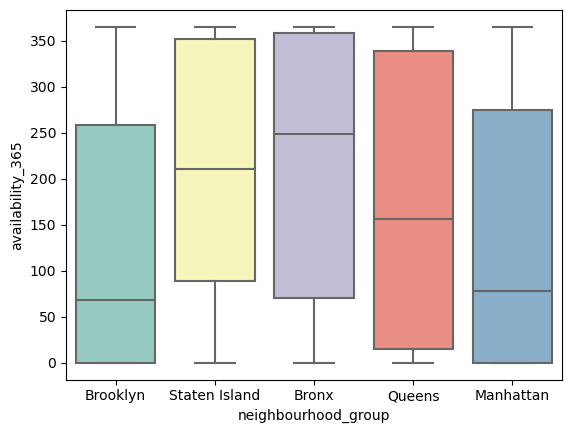

In [107]:
sns.boxplot(data=df,x="neighbourhood_group",y='availability_365')

## Host listing counts

In [109]:
df['calculated_host_listings_count'].max()

526.0

In [110]:
df[df['calculated_host_listings_count']==526]['host_name'].unique()

array(['Blueground'], dtype=object)

<AxesSubplot:xlabel='calculated_host_listings_count', ylabel='price'>

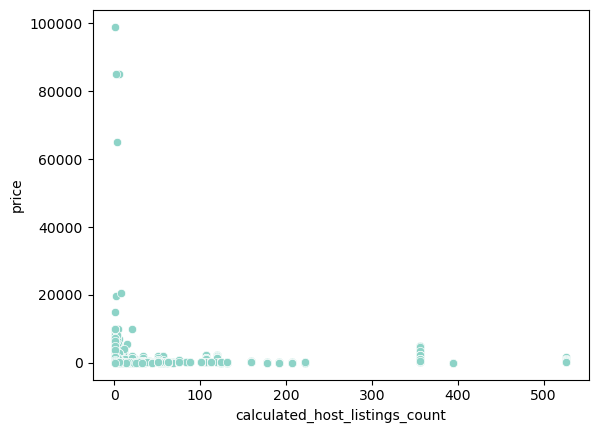

In [108]:
sns.scatterplot(data=df,
               x='calculated_host_listings_count',
               y= 'price')

## Number of reviews

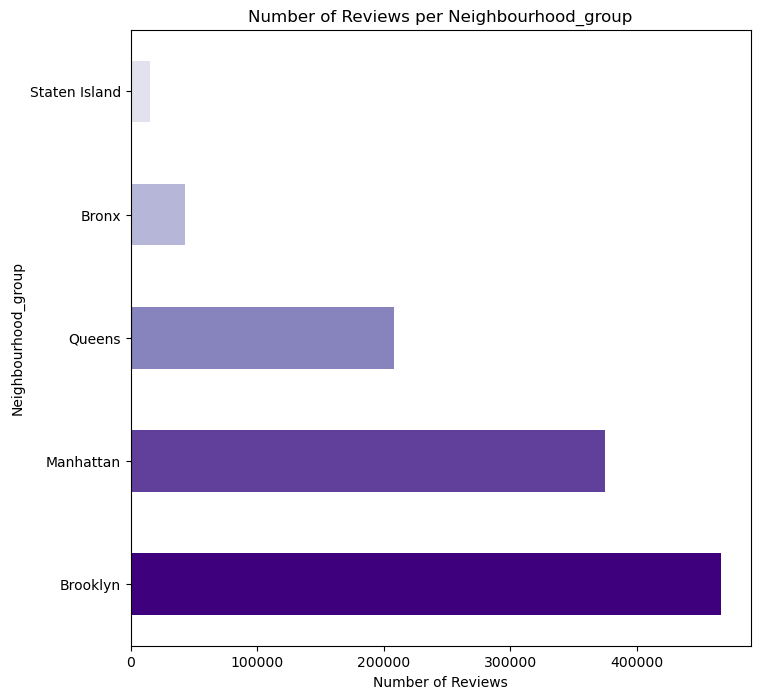

In [111]:
reviews_per_neighbourhood = df.groupby('neighbourhood_group')['number_of_reviews'].sum().sort_values(ascending=False)

cmap = cm.get_cmap('Purples')  
colors = cmap(np.linspace(1, 0.2 , len(reviews_per_neighbourhood)))

fig, ax = plt.subplots(figsize=(10,8))

# Create horizontal bar plot
bars = reviews_per_neighbourhood.plot(kind='barh', figsize=(8,8), color=colors)

# Set plot title and labels
plt.title('Number of Reviews per Neighbourhood_group')
plt.ylabel('Neighbourhood_group')
plt.xlabel('Number of Reviews')

# Display the plot
plt.show()


### Brooklyn and Manhattan being the most popular neighbourhoods with highest number of reviews

#### Total number of reviews in each neighbourhood group

In [112]:
reviews_per_neighbourhood

neighbourhood_group
Brooklyn         466537.0
Manhattan        374990.0
Queens           208344.0
Bronx             43018.0
Staten Island     15209.0
Name: number_of_reviews, dtype: float64

### Top 10 Hosts with most  number of reviews 

In [113]:
top_10_hosts = df.groupby('host_name')['number_of_reviews'].sum().sort_values(ascending=False).head(10)
top_10_hosts


host_name
Michael         9506.0
Sonder (NYC)    6697.0
David           6065.0
Justin          5632.0
Chris           5326.0
Michelle        4763.0
Daniel          4523.0
Henry           4498.0
John            4381.0
Jason           4131.0
Name: number_of_reviews, dtype: float64

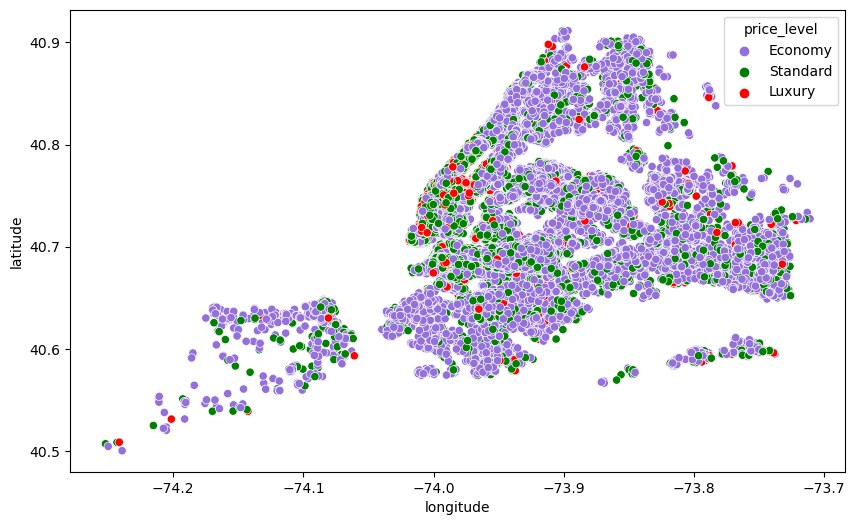

In [114]:

palette = {'Economy': 'mediumpurple', 'Standard': 'green', 'Luxury': 'red'}

plt.figure(figsize=(10,6))
sns.scatterplot(df.longitude, df.latitude, hue=df.price_level, palette=palette)
plt.show()


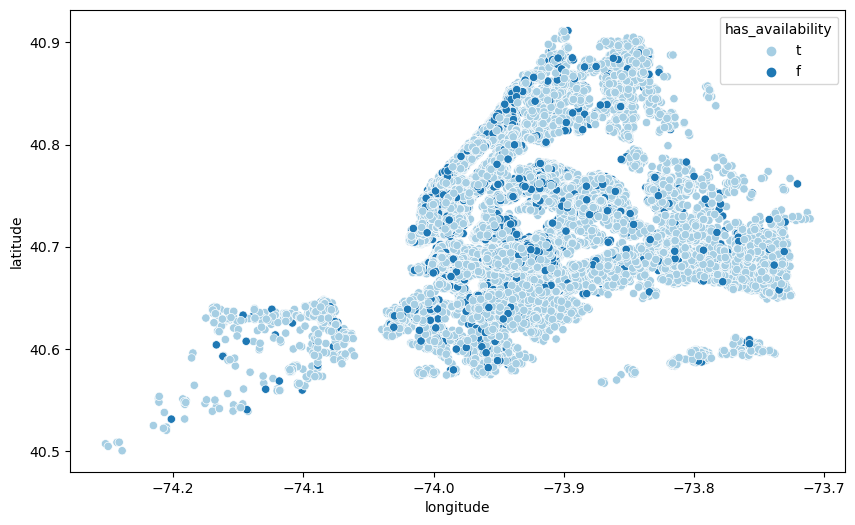

In [115]:
plt.figure(figsize=(10,6))
sns.scatterplot(df.longitude, df.latitude, hue=df.has_availability, palette='Paired')
plt.show()


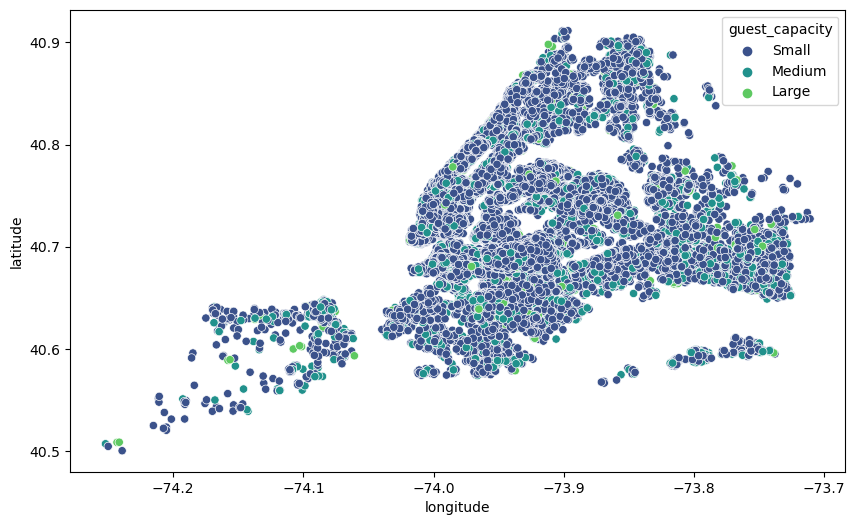

In [116]:
plt.figure(figsize=(10,6))
sns.scatterplot(df.longitude, df.latitude, hue=df.guest_capacity,palette='viridis')
plt.show()

### Relation between price with distance to airport and timessquare

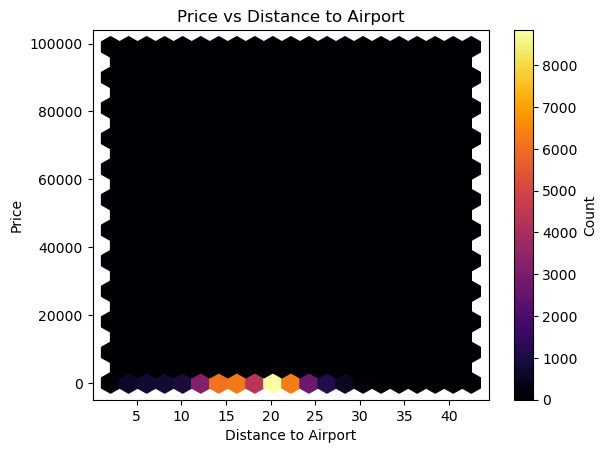

In [117]:
plt.hexbin(data=df, x='distance_to_airport', y='price', gridsize=20, cmap='inferno')
plt.xlabel('Distance to Airport')
plt.ylabel('Price')
plt.title('Price vs Distance to Airport')
plt.colorbar(label='Count')
plt.show()

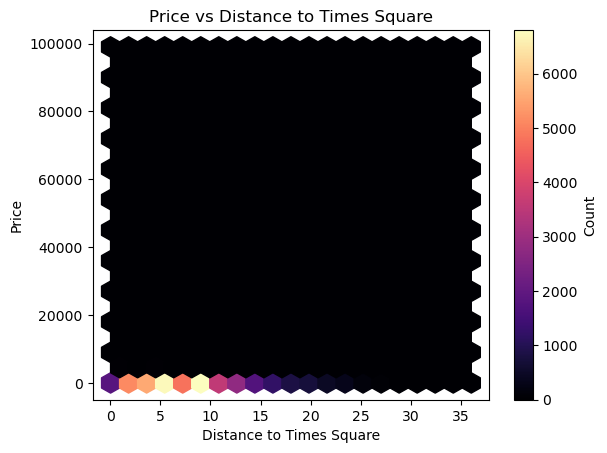

In [118]:
plt.hexbin(data=df, x='distance_to_timessquare', y='price', gridsize=20, cmap='magma')
plt.xlabel('Distance to Times Square')
plt.ylabel('Price')
plt.title('Price vs Distance to Times Square')
plt.colorbar(label='Count')
plt.show()

## Lisitng life

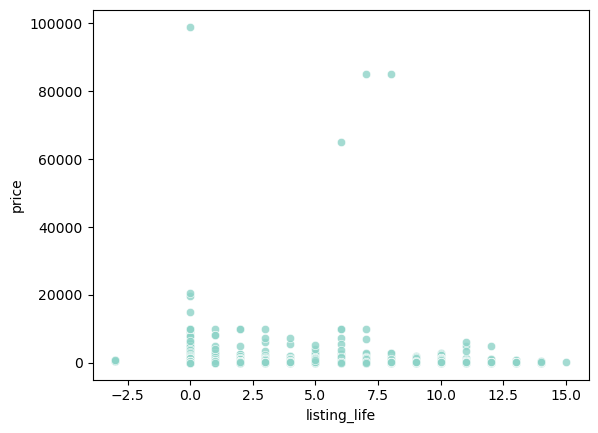

In [119]:
sns.scatterplot(data=df, x='listing_life', y='price', alpha=0.8)
plt.show()

### Which day of the week is the busiest ?

In [40]:
df.loc[:,['day_of_review','neighbourhood_group']].groupby('neighbourhood_group').describe()

day_of_review                     
                            count unique     top  freq
neighbourhood_group                                   
Bronx                        1687      7  Sunday   666
Brooklyn                    16219      7  Sunday  6641
Manhattan                   17618      7  Sunday  8117
Queens                       6916      7  Sunday  2890
Staten Island                 429      7  Sunday   180

In [39]:
df.loc[df['day_of_review'] == 0, 'day_of_review'] = 'Sunday'

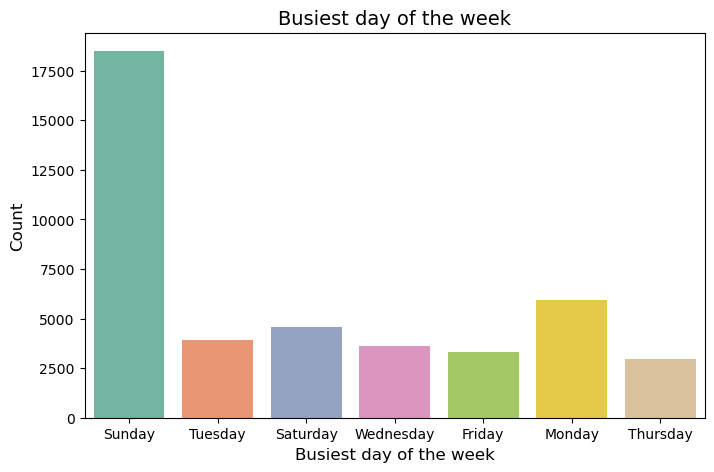

In [34]:
sns.set_palette("Set2")

plt.figure(figsize=(8, 5))
# Create the countplot
ax = sns.countplot(data=df, x='day_of_review')

# Customize the plot
ax.set_xlabel('Busiest day of the week', fontsize=12)
ax.set_ylabel('Count', fontsize=12)
ax.set_title('Busiest day of the week', fontsize=14)

plt.show()

#### Analysing the data with three different dataframes : capping the outliers, without the outliers , log transformation of target variable

1. df1 = capping the outliers
2. df2 = without the outliers
3. df3 = log tranformed target variable

In [40]:
df1 = df.copy()
df1 = df[df['price']<1290]

In [41]:
df1.shape

(42449, 37)

In [42]:
df2 = df[df['price']<380]

In [43]:
df3 = df.copy()
df3['price'] = np.log(df3['price'])

Text(0.5, 1.0, 'df3')

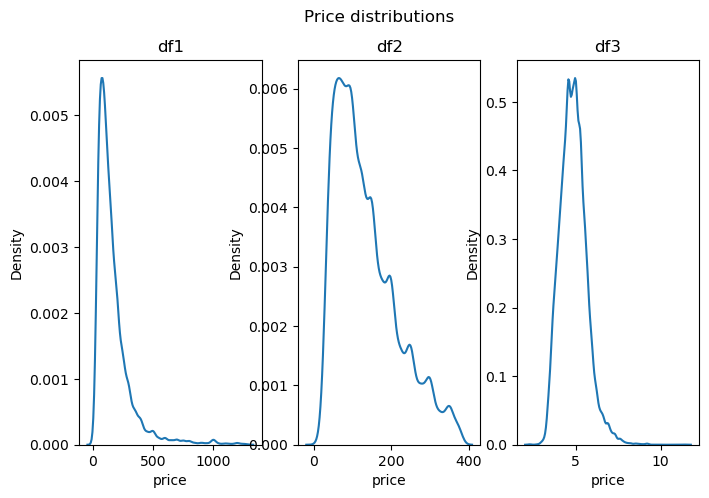

In [36]:
fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize=(8,5))
sns.kdeplot(df1['price'],ax=ax1)
sns.kdeplot(df2['price'],ax=ax2)
sns.kdeplot(df3['price'],ax=ax3)
plt.suptitle('Price distributions')
ax1.set_title('df1')
ax2.set_title('df2')
ax3.set_title('df3')

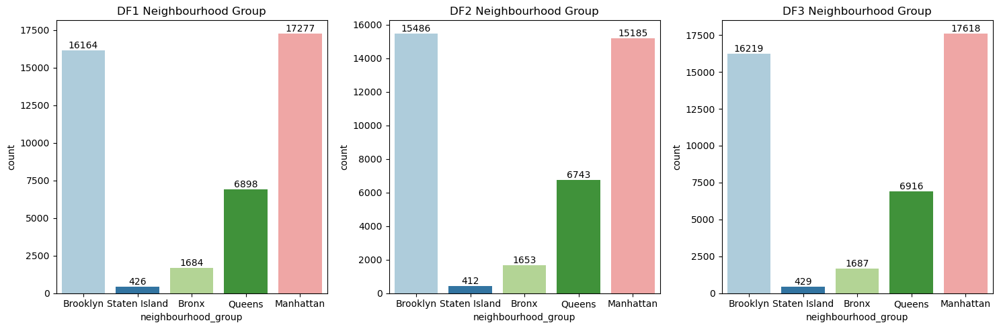

In [139]:
def neighbourhood_grp_counts(df, ax, title):
    sns.countplot(data=df, x='neighbourhood_group', palette="Paired", ax=ax)
    ax.set_title(title)
    for p in ax.patches:
        ax.annotate(format(p.get_height(), '.0f'), 
                    (p.get_x() + p.get_width() / 2., p.get_height()),
                    ha = 'center', va = 'center', xytext = (0, 5), textcoords = 'offset points')

fig, axes = plt.subplots(1, 3, figsize=(15, 5)) # 1 row, 3 columns
neighbourhood_grp_counts(df1, axes[0], 'DF1 Neighbourhood Group')
neighbourhood_grp_counts(df2, axes[1], 'DF2 Neighbourhood Group')
neighbourhood_grp_counts(df3, axes[2], 'DF3 Neighbourhood Group')
plt.tight_layout()  # Adjust spaces between the plots
plt.show()


   #### It can be observed that New York has most number of Airbnbs in Manhattan and Brooklyn and the least count of listings coming fromStaten Island. Manhattan and Brooklyn are on the top and the obvious reason for this could be that there are most number of tourist places here. Manhattan is the heart of New York city. Listing an Airbnb in Manhattan could help the hosts benefit from making a good money as tourists visit here in huge numbers.
   #### Hosts could also list properties in other neighbourhoods as there is less avaialbility and competition in Bronx and Staten Island

#### The reason for low listings could also be due to data collection issues, it can be possible that less data was collected fromStaten Island and Bronx. This could probably create some bias in the data set

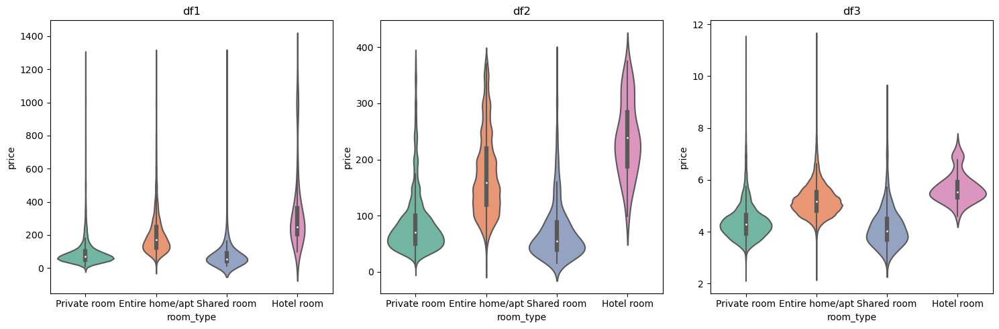

In [140]:
fig, axs = plt.subplots(1, 3, figsize=(15, 5))

sns.violinplot(x="room_type", y="price", data=df1, ax=axs[0])
axs[0].set_title('df1')

sns.violinplot(x="room_type", y="price", data=df2, ax=axs[1])
axs[1].set_title('df2')

sns.violinplot(x="room_type", y="price", data=df3, ax=axs[2])
axs[2].set_title('df3')

plt.tight_layout()
plt.show()

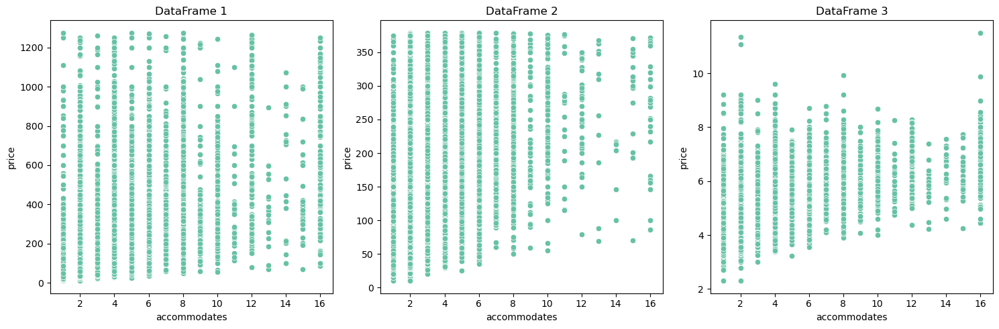

In [141]:
plt.figure(figsize=(15, 5))

plt.subplot(1, 3, 1) # 1 row, 3 columns, plot number 1
sns.scatterplot(data=df1, x='accommodates', y='price')
plt.title('DataFrame 1')

plt.subplot(1, 3, 2) # 1 row, 3 columns, plot number 2
sns.scatterplot(data=df2, x='accommodates', y='price')
plt.title('DataFrame 2')

plt.subplot(1, 3, 3) # 1 row, 3 columns, plot number 3
sns.scatterplot(data=df3, x='accommodates', y='price')
plt.title('DataFrame 3')

plt.tight_layout()  
plt.show()

## Beds ,Bedrooms and Bathrooms

In [142]:
df1['bedrooms'].describe()

count     42449.0
unique       10.0
top           1.0
freq      32414.0
Name: bedrooms, dtype: float64

In [143]:
average_prices = df1.groupby(['neighbourhood_group', 'bedrooms'])['price'].mean().reset_index()

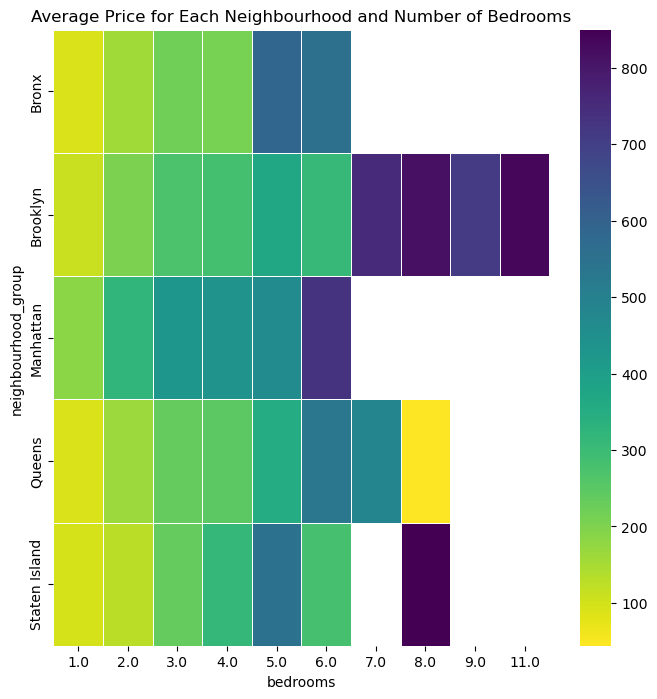

In [144]:
# Pivot the DataFrame to the right format
pivot = average_prices.pivot(index='neighbourhood_group', columns='bedrooms', values='price')

# Create the heat map
plt.figure(figsize=(8, 8))
sns.heatmap(pivot, cmap='viridis_r', linewidths=0.5)
plt.title('Average Price for Each Neighbourhood and Number of Bedrooms')
plt.show()


#### The visualisation above clearly indicates that the price increases as the number of bedrooms increase. But we can also see that Bronx has a listing with 11 bedrooms for a very low price

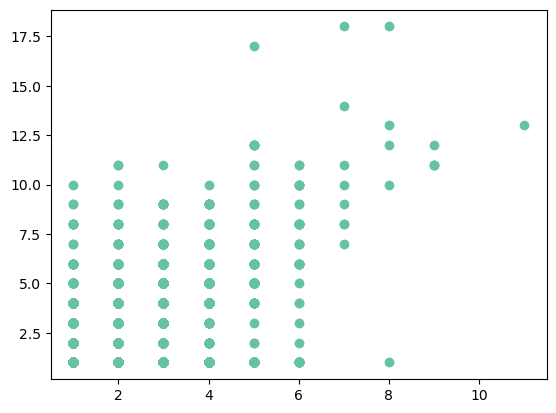

In [145]:
plt.scatter(data = df1 , x ='bedrooms', y = 'beds')
plt.show()

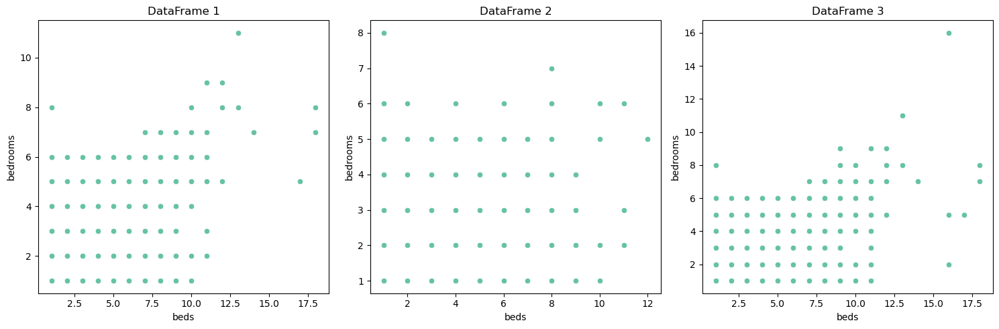

In [147]:
plt.figure(figsize=(15, 5))

plt.subplot(1, 3, 1) # 1 row, 3 columns, plot number 1
sns.scatterplot(data=df1, x='beds', y='bedrooms')
plt.title('DataFrame 1')

plt.subplot(1, 3, 2) # 1 row, 3 columns, plot number 2
sns.scatterplot(data=df2, x='beds', y='bedrooms')
plt.title('DataFrame 2')

plt.subplot(1, 3, 3) # 1 row, 3 columns, plot number 3
sns.scatterplot(data=df3, x='beds', y='bedrooms')
plt.title('DataFrame 3')

plt.tight_layout() 
plt.show()


In [148]:
df1['beds'].value_counts()

1.0     27123
2.0      9124
3.0      3574
4.0      1571
5.0       518
6.0       288
7.0       104
8.0        80
9.0        30
10.0       13
11.0       11
12.0        7
13.0        2
18.0        2
17.0        1
14.0        1
Name: beds, dtype: int64

In [149]:
average_prices_beds = df1.groupby(['neighbourhood_group', 'beds'])['price'].mean().reset_index()

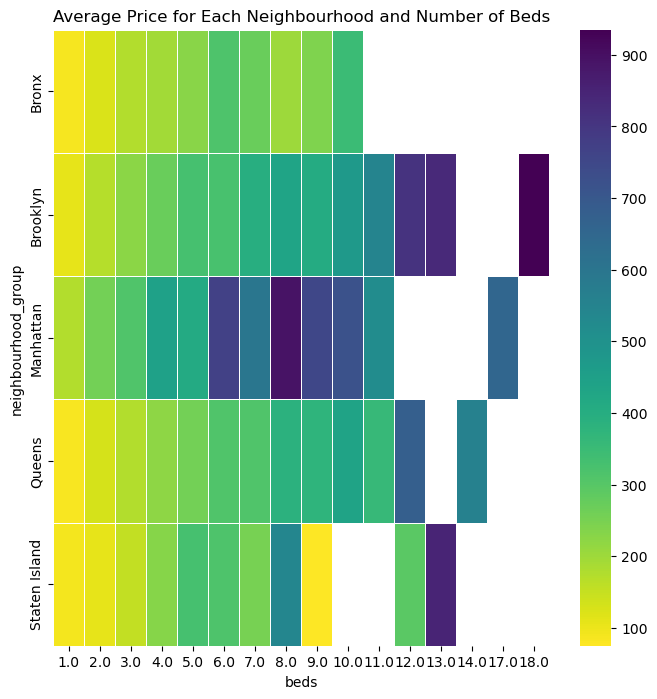

In [150]:
# Pivot the DataFrame to the right format
pivot = average_prices_beds.pivot(index='neighbourhood_group', columns='beds', values='price')

# Create the heat map
plt.figure(figsize=(8, 8))
sns.heatmap(pivot, cmap='viridis_r', linewidths=0.5)
plt.title('Average Price for Each Neighbourhood and Number of Beds')
plt.show()


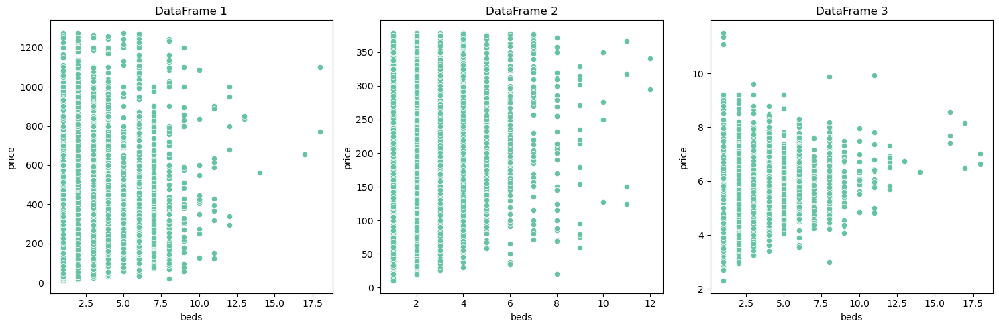

In [151]:
plt.figure(figsize=(15, 5))

plt.subplot(1, 3, 1) 
sns.scatterplot(data=df1, x='beds', y='price')
plt.title('DataFrame 1')

plt.subplot(1, 3, 2) 
sns.scatterplot(data=df2, x='beds', y='price')
plt.title('DataFrame 2')

plt.subplot(1, 3, 3)
sns.scatterplot(data=df3, x='beds', y='price')
plt.title('DataFrame 3')

plt.tight_layout()  
plt.show()


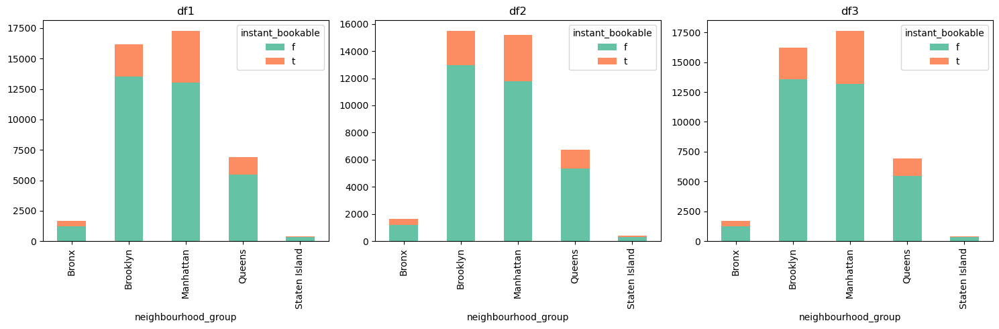

In [156]:
fig, axs = plt.subplots(1, 3, figsize=(15, 5))

df1.groupby('neighbourhood_group')['instant_bookable'].value_counts().unstack().plot(kind='bar', stacked=True, ax=axs[0])
axs[0].set_title('df1')

df2.groupby('neighbourhood_group')['instant_bookable'].value_counts().unstack().plot(kind='bar', stacked=True, ax=axs[1])
axs[1].set_title('df2')

df3.groupby('neighbourhood_group')['instant_bookable'].value_counts().unstack().plot(kind='bar', stacked=True, ax=axs[2])
axs[2].set_title('df3')

plt.tight_layout()
plt.show()


## Availability_365 

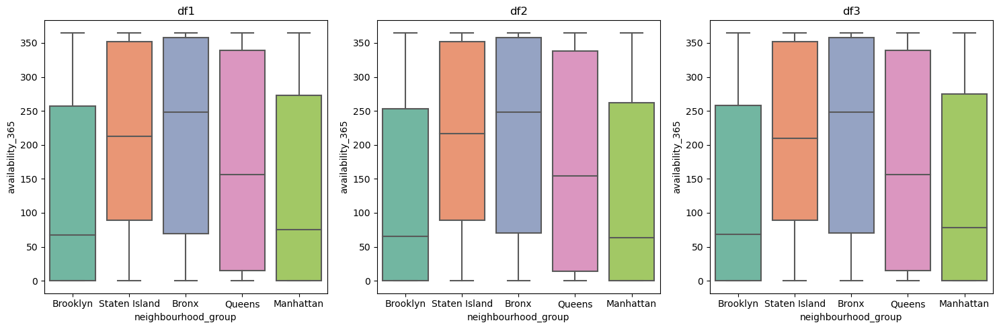

In [157]:
fig, axs = plt.subplots(1, 3, figsize=(15, 5))

sns.boxplot(data=df1,x="neighbourhood_group",y='availability_365', ax=axs[0])
axs[0].set_title('df1')

sns.boxplot(data=df2,x="neighbourhood_group",y='availability_365', ax=axs[1])
axs[1].set_title('df2')

sns.boxplot(data=df3,x="neighbourhood_group",y='availability_365', ax=axs[2])
axs[2].set_title('df3')

plt.tight_layout()
plt.show()


## Host listing counts

In [218]:
df1['calculated_host_listings_count'].max()

526.0

In [219]:
df1[df1['calculated_host_listings_count']==526]['host_name'].unique()

array(['Blueground'], dtype=object)

<AxesSubplot:xlabel='calculated_host_listings_count', ylabel='price'>

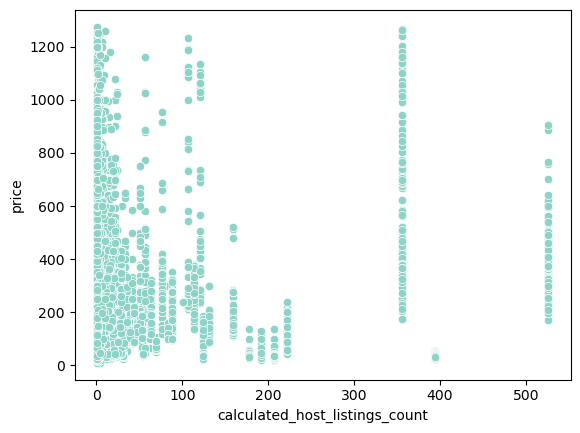

In [223]:
sns.scatterplot(data=df1,
               x='calculated_host_listings_count',
               y= 'price')

### Relation between price with distance to airport and timessquare

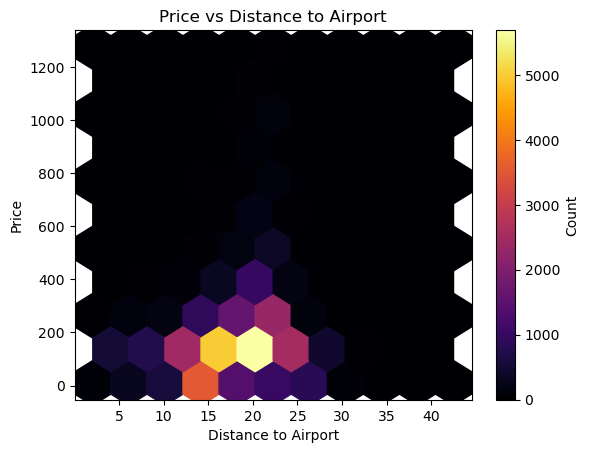

In [231]:
plt.hexbin(data=df1, x='distance_to_airport', y='price', gridsize=10, cmap='inferno')
plt.xlabel('Distance to Airport')
plt.ylabel('Price')
plt.title('Price vs Distance to Airport')
plt.colorbar(label='Count')
plt.show()

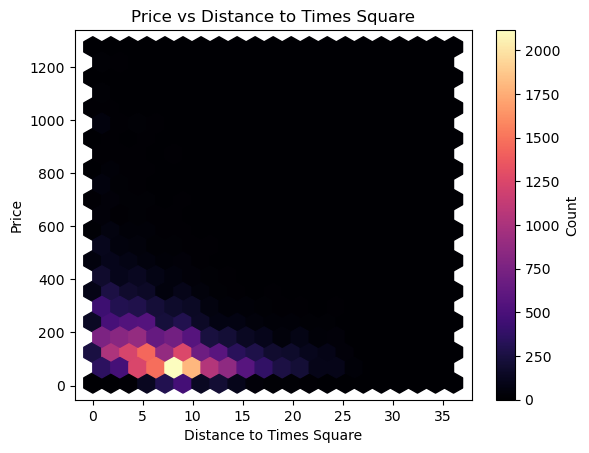

In [232]:
plt.hexbin(data=df1, x='distance_to_timessquare', y='price', gridsize=20, cmap='magma')
plt.xlabel('Distance to Times Square')
plt.ylabel('Price')
plt.title('Price vs Distance to Times Square')
plt.colorbar(label='Count')
plt.show()

## Manual encoding

In [160]:
df1['host_response_time'].unique()

array(['within an hour', 'a few days or more', 'within a few hours',
       'within a day'], dtype=object)

In [53]:
def encode_cols(df, col):
    df[col] = df[col].replace({'within an hour': 0, 'within a few hours': 1, 'within a day': 2,'a few days or more' : 3})
    return df

# Usage:
df1 = encode_cols(df1, 'host_response_time')
df2 = encode_cols(df2, 'host_response_time')
df3 = encode_cols(df3, 'host_response_time')

In [162]:
df1['room_type'].unique()

array(['Private room', 'Entire home/apt', 'Shared room', 'Hotel room'],
      dtype=object)

In [54]:
def encode_cols(df, col):
    df[col] = df[col].replace({'Shared room':0,'Hotel room':1,'Private room':2, 'Entire home/apt':3})
    return df

# Usage:
df1 = encode_cols(df1, 'room_type')
df2 = encode_cols(df2, 'room_type')
df3 = encode_cols(df3, 'room_type')

In [55]:
def encode_cols(df, col):
    df[col] = df[col].replace({'Small':0, 'Medium':1, 'Large':2})
    return df

# Usage:
df1 = encode_cols(df1, 'guest_capacity')
df2 = encode_cols(df2, 'guest_capacity')
df3 = encode_cols(df3, 'guest_capacity')

In [49]:
df1['price_level'].unique()

array(['Economy', 'Standard', 'Luxury'], dtype=object)

In [56]:
def encode_cols(df, col):
    df[col] = df[col].replace({'Economy':0, 'Standard':1, 'Luxury':2})
    return df

# Usage:
df1 = encode_cols(df1, 'price_level')
df2 = encode_cols(df2, 'price_level')
df3 = encode_cols(df3, 'price_level')

### Encoding the remaining variables

In [57]:
cat_cols = ['host_is_superhost','host_identity_verified','neighbourhood','neighbourhood_group','bathrooms_text','has_availability','instant_bookable','property_type']

In [58]:
from sklearn.preprocessing import LabelEncoder

def label_encode(df):
    le = LabelEncoder()
    for col in cat_cols:
        df[col] = le.fit_transform(df[col])
    return df


In [59]:
df1 = label_encode(df1)
df2 = label_encode(df2) 
df3 = label_encode(df3)


In [79]:
cols = ['host_response_time','host_is_superhost','host_identity_verified','neighbourhood','neighbourhood_group','property_type','room_type','bathrooms_text','has_availability','instant_bookable','guest_capacity','price_level','host_response_rate', 'host_acceptance_rate','accommodates', 'beds','bedrooms','minimum_nights','maximum_nights', 'availability_365', 'number_of_reviews','calculated_host_listings_count', 'distance_to_airport','distance_to_timessquare', 'host_experience_years','host_rating','listing_life']

In [80]:
from scipy.stats import pointbiserialr

for col in df1[cols]:
    correlation, p_value = pointbiserialr(df1[col], df1['price'])
    print(f"Point Biserial correlation coefficient of {col} with Price is {correlation}")  


Point Biserial correlation coefficient of host_response_time with Price is -0.008613715581963716
Point Biserial correlation coefficient of host_is_superhost with Price is 0.00038330231181567427
Point Biserial correlation coefficient of host_identity_verified with Price is 0.03182469747767508
Point Biserial correlation coefficient of neighbourhood with Price is 0.09919628045451631
Point Biserial correlation coefficient of neighbourhood_group with Price is 0.03775251106615993
Point Biserial correlation coefficient of property_type with Price is -0.29615098465644096
Point Biserial correlation coefficient of room_type with Price is 0.3254401324197611
Point Biserial correlation coefficient of bathrooms_text with Price is 0.18610924213503438
Point Biserial correlation coefficient of has_availability with Price is 0.07565553341656146
Point Biserial correlation coefficient of instant_bookable with Price is 0.11632652959455131
Point Biserial correlation coefficient of guest_capacity with Price 

<AxesSubplot:ylabel='Feature'>

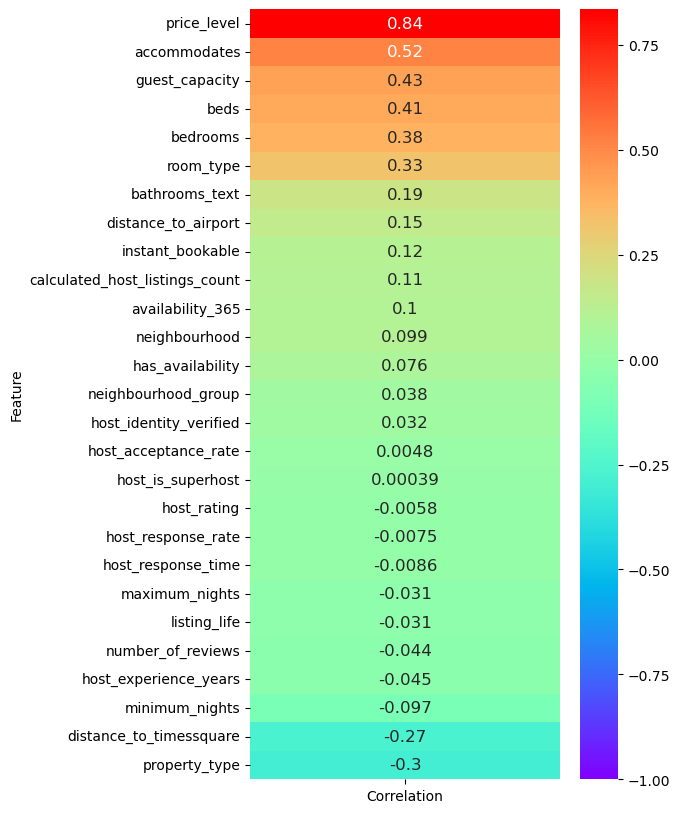

In [56]:
corr_list = []

for col in cols:
        corr, _ = pointbiserialr(df1[col], df1['price'])
        corr_list.append((col, corr))

top_features = pd.DataFrame(corr_list, columns=['Feature', 'Correlation']).sort_values(by='Correlation', ascending=False)

# Display heatmap
plt.figure(figsize=(5,10))
sns.heatmap(top_features.set_index('Feature'), cmap='rainbow', annot=True, annot_kws={"size": 12}, vmin=-1)


<AxesSubplot:ylabel='Feature'>

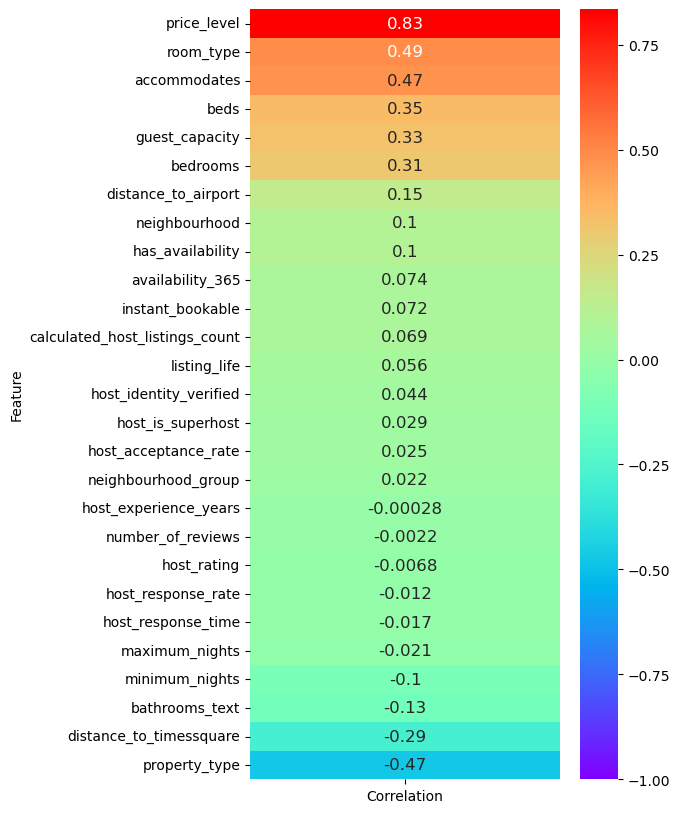

In [57]:
corr_list = []

for col in cols:
        corr, _ = pointbiserialr(df2[col], df2['price'])
        corr_list.append((col, corr))

top_features = pd.DataFrame(corr_list, columns=['Feature', 'Correlation']).sort_values(by='Correlation', ascending=False)

# Display heatmap
plt.figure(figsize=(5,10))
sns.heatmap(top_features.set_index('Feature'), cmap='rainbow', annot=True, annot_kws={"size": 12}, vmin=-1)

<AxesSubplot:ylabel='Feature'>

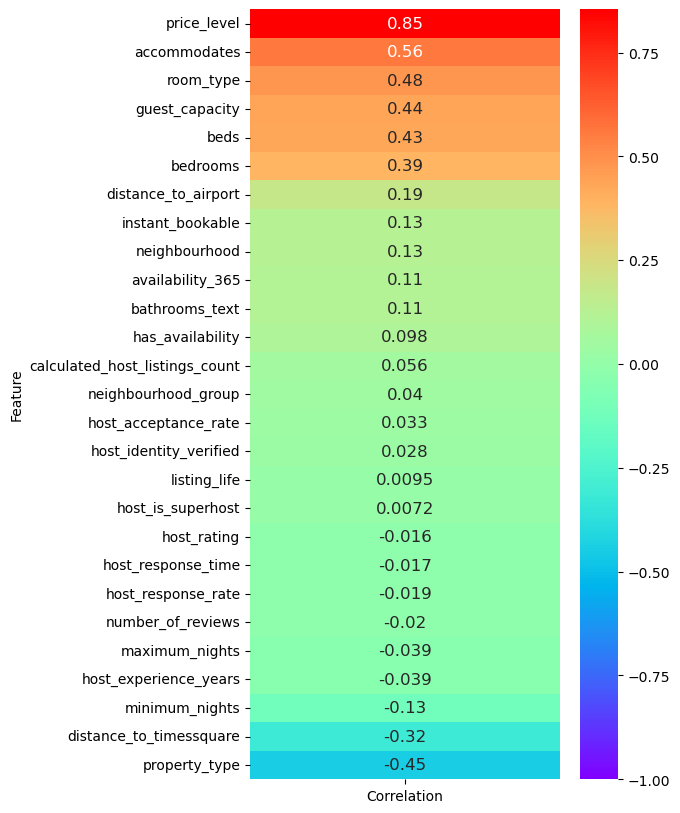

In [58]:
corr_list = []

for col in cols:
        corr, _ = pointbiserialr(df3[col], df3['price'])
        corr_list.append((col, corr))

top_features = pd.DataFrame(corr_list, columns=['Feature', 'Correlation']).sort_values(by='Correlation', ascending=False)

# Display heatmap
plt.figure(figsize=(5,10))
sns.heatmap(top_features.set_index('Feature'), cmap='rainbow', annot=True, annot_kws={"size": 12}, vmin=-1)

# Feature selection

In [250]:
!pip install Boruta

In [251]:
df1.columns

Index(['name', 'host_name', 'host_since', 'host_response_time',
       'host_response_rate', 'host_acceptance_rate', 'host_is_superhost',
       'host_identity_verified', 'neighbourhood', 'neighbourhood_group',
       'latitude', 'longitude', 'property_type', 'room_type', 'accommodates',
       'bathrooms_text', 'bedrooms', 'beds', 'amenities', 'minimum_nights',
       'maximum_nights', 'has_availability', 'availability_365',
       'number_of_reviews', 'first_review', 'last_review', 'instant_bookable',
       'calculated_host_listings_count', 'price', 'listing_life',
       'day_of_review', 'distance_to_airport', 'distance_to_timessquare',
       'host_experience_years', 'host_rating', 'guest_capacity',
       'price_level'],
      dtype='object')

 Let us the remove the unwanted columns before we start feature selection using Boruta

In [60]:
X = df1.drop(['name', 'host_name','amenities','first_review', 'last_review','host_since','price'],axis=1)
y = df1['price']

In [61]:
X1 = df2.drop(['name', 'host_name','amenities','first_review', 'last_review','host_since','price'],axis=1)
y1 = df2['price']

In [62]:
X2 = df3.drop(['name', 'host_name','amenities','first_review', 'last_review','host_since','price'],axis=1)
y2 = df3['price']

In [259]:
# initialize Random Forest Regressor
rf = RandomForestRegressor(n_jobs=-1, max_depth=5)

# initialize Boruta
boruta = BorutaPy(estimator=rf, n_estimators='auto', verbose=2, random_state=1)

# fit Boruta (it accepts np.array, not pd.DataFrame)
boruta.fit(np.array(X), np.array(y))

# check selected features
print("Selected Features: ", boruta.support_)

# check ranking of features
print("Ranking: ", boruta.ranking_)


Iteration: 	1 / 100
Confirmed: 	0
Tentative: 	30
Rejected: 	0
Iteration: 	2 / 100
Confirmed: 	0
Tentative: 	30
Rejected: 	0
Iteration: 	3 / 100
Confirmed: 	0
Tentative: 	30
Rejected: 	0
Iteration: 	4 / 100
Confirmed: 	0
Tentative: 	30
Rejected: 	0
Iteration: 	5 / 100
Confirmed: 	0
Tentative: 	30
Rejected: 	0
Iteration: 	6 / 100
Confirmed: 	0
Tentative: 	30
Rejected: 	0
Iteration: 	7 / 100
Confirmed: 	0
Tentative: 	30
Rejected: 	0
Iteration: 	8 / 100
Confirmed: 	12
Tentative: 	6
Rejected: 	12
Iteration: 	9 / 100
Confirmed: 	12
Tentative: 	6
Rejected: 	12
Iteration: 	10 / 100
Confirmed: 	12
Tentative: 	6
Rejected: 	12
Iteration: 	11 / 100
Confirmed: 	12
Tentative: 	6
Rejected: 	12
Iteration: 	12 / 100
Confirmed: 	13
Tentative: 	5
Rejected: 	12
Iteration: 	13 / 100
Confirmed: 	13
Tentative: 	4
Rejected: 	13
Iteration: 	14 / 100
Confirmed: 	13
Tentative: 	4
Rejected: 	13
Iteration: 	15 / 100
Confirmed: 	13
Tentative: 	4
Rejected: 	13
Iteration: 	16 / 100
Confirmed: 	13
Tentative: 	3
Reject

In [260]:
feature_ranks = list(zip(X.columns, 
                         boruta.ranking_, 
                         boruta.support_))

# iterate through and print out the results
for feature in feature_ranks:
    print('Feature: {:<25} Rank: {},  Keep: {}'.format(feature[0], feature[1], feature[2]))

Feature: host_response_time        Rank: 13,  Keep: False
Feature: host_response_rate        Rank: 12,  Keep: False
Feature: host_acceptance_rate      Rank: 3,  Keep: False
Feature: host_is_superhost         Rank: 14,  Keep: False
Feature: host_identity_verified    Rank: 14,  Keep: False
Feature: neighbourhood             Rank: 1,  Keep: True
Feature: neighbourhood_group       Rank: 11,  Keep: False
Feature: latitude                  Rank: 4,  Keep: False
Feature: longitude                 Rank: 1,  Keep: True
Feature: property_type             Rank: 1,  Keep: True
Feature: room_type                 Rank: 1,  Keep: True
Feature: accommodates              Rank: 1,  Keep: True
Feature: bathrooms_text            Rank: 1,  Keep: True
Feature: bedrooms                  Rank: 2,  Keep: False
Feature: beds                      Rank: 1,  Keep: True
Feature: minimum_nights            Rank: 1,  Keep: True
Feature: maximum_nights            Rank: 5,  Keep: False
Feature: has_availability         

In [219]:
# initialize Random Forest Regressor
rf = RandomForestRegressor(n_jobs=-1, max_depth=5)

# initialize Boruta
boruta = BorutaPy(estimator=rf, n_estimators='auto', verbose=2, random_state=1)

# fit Boruta (it accepts np.array, not pd.DataFrame)
boruta.fit(np.array(X2), np.array(y2))

# check selected features
print("Selected Features: ", boruta.support_)

# check ranking of features
print("Ranking: ", boruta.ranking_)


Iteration: 	1 / 100
Confirmed: 	0
Tentative: 	31
Rejected: 	0
Iteration: 	2 / 100
Confirmed: 	0
Tentative: 	31
Rejected: 	0
Iteration: 	3 / 100
Confirmed: 	0
Tentative: 	31
Rejected: 	0
Iteration: 	4 / 100
Confirmed: 	0
Tentative: 	31
Rejected: 	0
Iteration: 	5 / 100
Confirmed: 	0
Tentative: 	31
Rejected: 	0
Iteration: 	6 / 100
Confirmed: 	0
Tentative: 	31
Rejected: 	0
Iteration: 	7 / 100
Confirmed: 	0
Tentative: 	31
Rejected: 	0
Iteration: 	8 / 100
Confirmed: 	14
Tentative: 	5
Rejected: 	12
Iteration: 	9 / 100
Confirmed: 	14
Tentative: 	5
Rejected: 	12
Iteration: 	10 / 100
Confirmed: 	14
Tentative: 	5
Rejected: 	12
Iteration: 	11 / 100
Confirmed: 	14
Tentative: 	5
Rejected: 	12
Iteration: 	12 / 100
Confirmed: 	15
Tentative: 	4
Rejected: 	12
Iteration: 	13 / 100
Confirmed: 	15
Tentative: 	4
Rejected: 	12
Iteration: 	14 / 100
Confirmed: 	15
Tentative: 	4
Rejected: 	12
Iteration: 	15 / 100
Confirmed: 	15
Tentative: 	4
Rejected: 	12
Iteration: 	16 / 100
Confirmed: 	15
Tentative: 	4
Reject

In [220]:
feature_ranks = list(zip(X.columns, 
                         boruta.ranking_, 
                         boruta.support_))

# iterate through and print out the results
for feature in feature_ranks:
    print('Feature: {:<25} Rank: {},  Keep: {}'.format(feature[0], feature[1], feature[2]))

Feature: name                      Rank: 12,  Keep: False
Feature: host_name                 Rank: 1,  Keep: True
Feature: host_since                Rank: 4,  Keep: False
Feature: host_response_time        Rank: 14,  Keep: False
Feature: host_response_rate        Rank: 15,  Keep: False
Feature: host_acceptance_rate      Rank: 5,  Keep: False
Feature: host_is_superhost         Rank: 9,  Keep: False
Feature: host_identity_verified    Rank: 1,  Keep: True
Feature: neighbourhood             Rank: 1,  Keep: True
Feature: neighbourhood_group       Rank: 1,  Keep: True
Feature: latitude                  Rank: 1,  Keep: True
Feature: longitude                 Rank: 1,  Keep: True
Feature: property_type             Rank: 1,  Keep: True
Feature: room_type                 Rank: 1,  Keep: True
Feature: accommodates              Rank: 1,  Keep: True
Feature: bathrooms_text            Rank: 1,  Keep: True
Feature: bedrooms                  Rank: 8,  Keep: False
Feature: beds                      Ran

In [221]:
# get features where keep is True
features_to_keep = [feature for feature in feature_ranks if feature[2]]

# print out the results
for feature in features_to_keep:
    print('Feature: {:<25} Rank: {},  Keep: {}'.format(feature[0], feature[1], feature[2]))


Feature: host_name                 Rank: 1,  Keep: True
Feature: host_identity_verified    Rank: 1,  Keep: True
Feature: neighbourhood             Rank: 1,  Keep: True
Feature: neighbourhood_group       Rank: 1,  Keep: True
Feature: latitude                  Rank: 1,  Keep: True
Feature: longitude                 Rank: 1,  Keep: True
Feature: property_type             Rank: 1,  Keep: True
Feature: room_type                 Rank: 1,  Keep: True
Feature: accommodates              Rank: 1,  Keep: True
Feature: bathrooms_text            Rank: 1,  Keep: True
Feature: amenities                 Rank: 1,  Keep: True
Feature: minimum_nights            Rank: 1,  Keep: True
Feature: has_availability          Rank: 1,  Keep: True
Feature: first_review              Rank: 1,  Keep: True
Feature: last_review               Rank: 1,  Keep: True
Feature: instant_bookable          Rank: 1,  Keep: True


### final features based on boruta and domain knowledge

In [63]:
final_df = X.drop(['host_response_rate','host_is_superhost', 'host_identity_verified','latitude', 'longitude','maximum_nights','has_availability','listing_life','day_of_review','host_experience_years','guest_capacity','price_level','host_rating','calculated_host_listings_count'],axis=1)

In [64]:
final_df1 = X1.drop(['host_response_rate','host_is_superhost', 'host_identity_verified','latitude', 'longitude','maximum_nights','has_availability','listing_life','day_of_review','host_experience_years','guest_capacity','price_level','host_rating','calculated_host_listings_count'],axis=1)

In [65]:
final_df2 = X2.drop(['host_response_rate','host_is_superhost', 'host_identity_verified','latitude', 'longitude','maximum_nights','has_availability','listing_life','day_of_review','host_experience_years','guest_capacity','price_level','host_rating','calculated_host_listings_count'],axis=1)

In [66]:
final_df.to_csv('final_df.csv',index=False)
final_df1.to_csv('final_df1.csv',index=False)
final_df2.to_csv('final_df2.csv',index=False)

In [67]:
final_df['beds'] = final_df['beds'].astype('float')
final_df['bedrooms'] = final_df['bedrooms'].astype('float')

final_df1['beds'] = final_df1['beds'].astype('float')
final_df1['bedrooms'] = final_df1['bedrooms'].astype('float')

final_df2['beds'] = final_df2['beds'].astype('float')
final_df2['bedrooms'] = final_df2['bedrooms'].astype('float')

# Model building

### Dataframe 1 - with capped values

In [66]:
final_df.head()

,host_response_time,host_acceptance_rate,neighbourhood,neighbourhood_group,property_type,room_type,accommodates,bathrooms_text,bedrooms,beds,minimum_nights,availability_365,number_of_reviews,instant_bookable,distance_to_airport,distance_to_timessquare
0,0,0.96,29,1,9,2,2.0,2,1.0,1.0,2.0,364.0,0.0,0,9.08,15.49
1,0,1.00,29,1,10,2,1.0,4,1.0,1.0,2.0,41.0,13.0,1,9.59,14.47
2,0,0.96,197,4,7,3,6.0,7,2.0,2.0,1.0,364.0,0.0,0,42.50,35.93
3,0,0.98,177,1,9,2,2.0,7,3.0,1.0,1.0,364.0,15.0,1,16.43,19.62
4,0,0.68,148,0,4,3,3.0,2,2.0,2.0,3.0,46.0,25.0,0,30.96,17.34


In [68]:
X = final_df
y= df1['price']

In [69]:
x_train, x_test, y_train, y_test = train_test_split(X,y,test_size=0.2,random_state=101)

In [70]:
lr = LinearRegression()

In [71]:
lr.fit(x_train,y_train)

LinearRegression()

In [92]:
y_pred_lr = lr.predict(x_test)

In [93]:
# Define MAPE function
def mean_absolute_percentage_error(y_true, y_pred): 
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

mape_lr = mean_absolute_percentage_error(y_test, y_pred_lr)

mae_lr = metrics.mean_absolute_error(y_test, y_pred_lr)
mse_lr = metrics.mean_squared_error(y_test, y_pred_lr)
rmse_lr = np.sqrt(metrics.mean_squared_error(y_test, y_pred_lr))
r2_lr = metrics.r2_score(y_test, y_pred_lr)


print('\nMean Absolute Percentage Error of Linear Regression : ', mape_lr)
print('\nMean Absolute Error of Linear Regression             : ', mae_lr)
print('\nMean Squared Error of Linear Regression              : ', mse_lr)
print('\nRoot Mean Squared Error of Linear Regression         : ', rmse_lr)
print('\nR2 Score of Linear Regression                        : ', r2_lr)



Mean Absolute Percentage Error of Linear Regression :  57.46512601230685

Mean Absolute Error of Linear Regression             :  74.07440185019699

Mean Squared Error of Linear Regression              :  14030.380082123722

Root Mean Squared Error of Linear Regression         :  118.44990536983862

R2 Score of Linear Regression                        :  0.4049135843968821


In [94]:
rf = RandomForestRegressor()

rf.fit(x_train,y_train)

y_pred_rf = rf.predict(x_test)

In [95]:
mape_rf = mean_absolute_percentage_error(y_test, y_pred_rf)
mae_rf = metrics.mean_absolute_error(y_test, y_pred_rf)
mse_rf = metrics.mean_squared_error(y_test, y_pred_rf)
rmse_rf = np.sqrt(metrics.mean_squared_error(y_test, y_pred_rf))
r2_rf = metrics.r2_score(y_test, y_pred_rf)

print('\nMean Absolute Percentage Error of Linear Regression : ', mape_rf)
print('\nMean Absolute Error of Random Forest Regressor     : ', mae_rf)
print('\nMean Squarred Error of Random Forest Regressor     : ', mse_rf)
print('\nRoot Mean Squarred Error of Random Forest Regressor: ', rmse_rf)
print('\nR2 Score of Random Forest Regressor                : ', r2_rf)


Mean Absolute Percentage Error of Linear Regression :  34.7592857956318

Mean Absolute Error of Random Forest Regressor     :  50.836460675023844

Mean Squarred Error of Random Forest Regressor     :  8734.46936699883

Root Mean Squarred Error of Random Forest Regressor:  93.4583830750288

R2 Score of Random Forest Regressor                :  0.6295350491306289


In [96]:
xgb = XGBRegressor(objective='reg:squarederror')

xgb.fit(x_train, y_train)

y_pred_xgb = xgb.predict(x_test)
y_pred_train_xgb = xgb.predict(x_train)

In [97]:
mape_xgb = mean_absolute_percentage_error(y_train,y_pred_train_xgb )
mae_xgb  = metrics.mean_absolute_error(y_train, y_pred_train_xgb)
mse_xgb  = metrics.mean_squared_error(y_train, y_pred_train_xgb)
rmse_xgb = np.sqrt(metrics.mean_squared_error(y_train, y_pred_train_xgb))
r2_xgb   = metrics.r2_score(y_train, y_pred_train_xgb)

print('\nMean Absolute Percentage Error of Linear Regression : ', mape_xgb)
print('\nMean Absolute Error of XGBoost Regressor     : ', mae_xgb)
print('\nMean Squarred Error of XGBoost Regressor     : ', mse_xgb)
print('\nRoot Mean Squarred Error of XGBoost Regressor: ', rmse_xgb)
print('\nR2 Score of XGBoost Regressor                : ', r2_xgb)


Mean Absolute Percentage Error of Linear Regression :  28.090993137234676

Mean Absolute Error of XGBoost Regressor     :  39.314189742109185

Mean Squarred Error of XGBoost Regressor     :  4272.619366406667

Root Mean Squarred Error of XGBoost Regressor:  65.36527645781564

R2 Score of XGBoost Regressor                :  0.8201472887343485


In [98]:
mape_xgb = mean_absolute_percentage_error(y_test, y_pred_xgb)
mae_xgb  = metrics.mean_absolute_error(y_test, y_pred_xgb)
mse_xgb  = metrics.mean_squared_error(y_test, y_pred_xgb)
rmse_xgb = np.sqrt(metrics.mean_squared_error(y_test, y_pred_xgb))
r2_xgb   = metrics.r2_score(y_test, y_pred_xgb)

print('\nMean Absolute Percentage Error of Linear Regression : ', mape_xgb)
print('\nMean Absolute Error of XGBoost Regressor     : ', mae_xgb)
print('\nMean Squarred Error of XGBoost Regressor     : ', mse_xgb)
print('\nRoot Mean Squarred Error of XGBoost Regressor: ', rmse_xgb)
print('\nR2 Score of XGBoost Regressor                : ', r2_xgb)



Mean Absolute Percentage Error of Linear Regression :  34.83451107878921

Mean Absolute Error of XGBoost Regressor     :  50.9425593242488

Mean Squarred Error of XGBoost Regressor     :  8444.205074097723

Root Mean Squarred Error of XGBoost Regressor:  91.89235590677673

R2 Score of XGBoost Regressor                :  0.6418463576361035


### Dataframe 2 - without outliers

In [88]:
final_df1.head()

,host_response_time,host_acceptance_rate,neighbourhood,neighbourhood_group,property_type,room_type,accommodates,bathrooms_text,bedrooms,beds,minimum_nights,availability_365,number_of_reviews,instant_bookable,distance_to_airport,distance_to_timessquare
0,0,0.96,29,1,9,2,2.0,2,1.0,1.0,2.0,364.0,0.0,0,9.08,15.49
1,0,1.00,29,1,10,2,1.0,4,1.0,1.0,2.0,41.0,13.0,1,9.59,14.47
2,0,0.96,196,4,7,3,6.0,7,2.0,2.0,1.0,364.0,0.0,0,42.50,35.93
3,0,0.98,176,1,9,2,2.0,7,3.0,1.0,1.0,364.0,15.0,1,16.43,19.62
4,0,0.68,147,0,4,3,3.0,2,2.0,2.0,3.0,46.0,25.0,0,30.96,17.34


In [99]:
X1 = final_df1
y1= df2['price']

In [100]:
x_train, x_test, y_train, y_test = train_test_split(X1,y1,test_size=0.2,random_state=101)

In [101]:
lr1 = LinearRegression()

In [102]:
lr1.fit(x_train,y_train)

LinearRegression()

In [103]:
y_pred_lr1 = lr1.predict(x_test)

In [104]:
# Define MAPE function
def mean_absolute_percentage_error(y_true, y_pred): 
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

mape_lr1 = mean_absolute_percentage_error(y_test, y_pred_lr1)

mae_lr1 = metrics.mean_absolute_error(y_test, y_pred_lr1)
mse_lr1 = metrics.mean_squared_error(y_test, y_pred_lr1)
rmse_lr1 = np.sqrt(metrics.mean_squared_error(y_test, y_pred_lr1))
r2_lr1 = metrics.r2_score(y_test, y_pred_lr1)


print('\nMean Absolute Percentage Error of Linear Regression : ', mape_lr1)
print('\nMean Absolute Error of Linear Regression             : ', mae_lr1)
print('\nMean Squared Error of Linear Regression              : ', mse_lr1)
print('\nRoot Mean Squared Error of Linear Regression         : ', rmse_lr1)
print('\nR2 Score of Linear Regression                        : ', r2_lr1)



Mean Absolute Percentage Error of Linear Regression :  41.64994775655914

Mean Absolute Error of Linear Regression             :  45.1265422845025

Mean Squared Error of Linear Regression              :  3567.4358693477716

Root Mean Squared Error of Linear Regression         :  59.728015782777945

R2 Score of Linear Regression                        :  0.4358421538529422


In [105]:
rf1 = RandomForestRegressor()

rf1.fit(x_train,y_train)

y_pred_rf1 = rf1.predict(x_test)


In [106]:
mape_rf1 = mean_absolute_percentage_error(y_test, y_pred_rf1)
mae_rf1 = metrics.mean_absolute_error(y_test, y_pred_rf1)
mse_rf1 = metrics.mean_squared_error(y_test, y_pred_rf1)
rmse_rf1 = np.sqrt(metrics.mean_squared_error(y_test, y_pred_rf1))
r2_rf1 = metrics.r2_score(y_test, y_pred_rf1)

print('\nMean Absolute Percentage Error of Linear Regression : ', mape_rf1)
print('\nMean Absolute Error of Random Forest Regressor     : ', mae_rf1)
print('\nMean Squarred Error of Random Forest Regressor     : ', mse_rf1)
print('\nRoot Mean Squarred Error of Random Forest Regressor: ', rmse_rf1)
print('\nR2 Score of Random Forest Regressor                : ', r2_rf1)


Mean Absolute Percentage Error of Linear Regression :  28.0165009462233

Mean Absolute Error of Random Forest Regressor     :  32.73490005186472

Mean Squarred Error of Random Forest Regressor     :  2233.226333672756

Root Mean Squarred Error of Random Forest Regressor:  47.257024172843934

R2 Score of Random Forest Regressor                :  0.6468353729385873


In [122]:
rf1_scores = (-cross_val_score(rf1, x_train, y_train,cv=10, scoring='neg_mean_absolute_error'))
rf1_scores.mean()

32.48542447247589

In [107]:
xgb1 = XGBRegressor(objective='reg:squarederror')

xgb1.fit(x_train, y_train)

y_pred_xgb1 = xgb1.predict(x_test)

In [108]:
mape_xgb1 = mean_absolute_percentage_error(y_test, y_pred_xgb1)
mae_xgb1  = metrics.mean_absolute_error(y_test, y_pred_xgb1)
mse_xgb1  = metrics.mean_squared_error(y_test, y_pred_xgb1)
rmse_xgb1 = np.sqrt(metrics.mean_squared_error(y_test, y_pred_xgb1))
r2_xgb1   = metrics.r2_score(y_test, y_pred_xgb1)

print('\nMean Absolute Percentage Error of Linear Regression : ', mape_xgb1)
print('\nMean Absolute Error of XGBoost Regressor     : ', mae_xgb1)
print('\nMean Squarred Error of XGBoost Regressor     : ', mse_xgb1)
print('\nRoot Mean Squarred Error of XGBoost Regressor: ', rmse_xgb1)
print('\nR2 Score of XGBoost Regressor                : ', r2_xgb1)



Mean Absolute Percentage Error of Linear Regression :  28.431485372994093

Mean Absolute Error of XGBoost Regressor     :  33.34420258199311

Mean Squarred Error of XGBoost Regressor     :  2245.1285988430045

Root Mean Squarred Error of XGBoost Regressor:  47.38278800200558

R2 Score of XGBoost Regressor                :  0.6449531369212804


In [121]:
xgb1_scores = (-cross_val_score(xgb1, x_train, y_train,cv=10, scoring='neg_mean_absolute_error'))
xgb1_scores.mean()

32.859446310627334

## Dataframe 3 - with log prices

In [72]:
X2 = final_df2
y2 = df3['price']

In [73]:
x_train, x_test, y_train, y_test = train_test_split(X2,y2,test_size=0.2,random_state=101)

In [111]:
lr2 = LinearRegression()

In [112]:
lr2.fit(x_train,y_train)

LinearRegression()

In [113]:
y_pred_lr2 = lr2.predict(x_test)

In [114]:
# Define MAPE function
def mean_absolute_percentage_error(y_true, y_pred): 
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

mape_lr2 = mean_absolute_percentage_error(y_test, y_pred_lr2)

mae_lr2 = metrics.mean_absolute_error(y_test, y_pred_lr2)
mse_lr2 = metrics.mean_squared_error(y_test, y_pred_lr2)
rmse_lr2 = np.sqrt(metrics.mean_squared_error(y_test, y_pred_lr2))
r2_lr2 = metrics.r2_score(y_test, y_pred_lr2)


print('\nMean Absolute Percentage Error of Linear Regression : ', mape_lr2)
print('\nMean Absolute Error of Linear Regression             : ', mae_lr2)
print('\nMean Squared Error of Linear Regression              : ', mse_lr2)
print('\nRoot Mean Squared Error of Linear Regression         : ', rmse_lr2)
print('\nR2 Score of Linear Regression                        : ', r2_lr2)



Mean Absolute Percentage Error of Linear Regression :  8.20147228769286

Mean Absolute Error of Linear Regression             :  0.3952601955867959

Mean Squared Error of Linear Regression              :  0.2779941277825002

Root Mean Squared Error of Linear Regression         :  0.5272514843815048

R2 Score of Linear Regression                        :  0.5388472464262765


In [115]:
rf2 = RandomForestRegressor()

rf2.fit(x_train,y_train)

y_pred_rf2 = rf2.predict(x_test)

In [117]:
def mean_absolute_percentage_error(y_true, y_pred): 
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

mape_rf2 = mean_absolute_percentage_error(y_test, y_pred_rf2)
mae_rf2 = metrics.mean_absolute_error(y_test, y_pred_rf2)
mse_rf2 = metrics.mean_squared_error(y_test, y_pred_rf2)
rmse_rf2 = np.sqrt(metrics.mean_squared_error(y_test, y_pred_rf2))
r2_rf2 = metrics.r2_score(y_test, y_pred_rf2)

print('\nMean Absolute Percentage Error of Linear Regression : ', mape_rf2)
print('\nMean Absolute Error of Random Forest Regressor     : ', mae_rf2)
print('\nMean Squarred Error of Random Forest Regressor     : ', mse_rf2)
print('\nRoot Mean Squarred Error of Random Forest Regressor: ', rmse_rf2)
print('\nR2 Score of Random Forest Regressor                : ', r2_rf2)


Mean Absolute Percentage Error of Linear Regression :  5.750440909523856

Mean Absolute Error of Random Forest Regressor     :  0.2793560846189073

Mean Squarred Error of Random Forest Regressor     :  0.17093674835730266

Root Mean Squarred Error of Random Forest Regressor:  0.41344497621485576

R2 Score of Random Forest Regressor                :  0.7164402254799318


In [118]:
rf2_scores = (-cross_val_score(rf2, x_train, y_train,cv=10, scoring='neg_mean_absolute_error'))
rf2_scores.mean()

0.28301404659851187

In [118]:
xgb2 = XGBRegressor(objective='reg:squarederror')

xgb2.fit(x_train, y_train)

y_pred_xgb2 = xgb2.predict(x_test)


In [119]:
mape_xgb2 = mean_absolute_percentage_error(y_test, y_pred_xgb2)
mae_xgb2  = metrics.mean_absolute_error(y_test, y_pred_xgb2)
mse_xgb2  = metrics.mean_squared_error(y_test, y_pred_xgb2)
rmse_xgb2 = np.sqrt(metrics.mean_squared_error(y_test, y_pred_xgb2))
r2_xgb2   = metrics.r2_score(y_test, y_pred_xgb2)

print('\nMean Absolute Percentage Error of Linear Regression : ', mape_xgb2)
print('\nMean Absolute Error of XGBoost Regressor     : ', mae_xgb2)
print('\nMean Squarred Error of XGBoost Regressor     : ', mse_xgb2)
print('\nRoot Mean Squarred Error of XGBoost Regressor: ', rmse_xgb2)
print('\nR2 Score of XGBoost Regressor                : ', r2_xgb2)


Mean Absolute Percentage Error of Linear Regression :  5.805150866974021

Mean Absolute Error of XGBoost Regressor     :  0.2810393897733067

Mean Squarred Error of XGBoost Regressor     :  0.16296888613291946

Root Mean Squarred Error of XGBoost Regressor:  0.40369405015793763

R2 Score of XGBoost Regressor                :  0.7296577766353475


In [ ]:
xgb2_scores = (-cross_val_score(xgb2, x_train, y_train,cv=10, scoring='neg_mean_absolute_error'))
xgb2_scores.mean()

In [120]:
data = [
    {"df": "df1", "model": "Linear Regression1", "mse": mse_lr, "mape": mape_lr, "mae": mae_lr, "rmse": rmse_lr, "r2": r2_lr},
    {"df": "df1", "model": "Random Forest1", "mse": mse_rf, "mape": mape_rf, "mae": mae_rf, "rmse": rmse_rf, "r2": r2_rf},
    {"df": "df1", "model": "XGBoost1", "mse": mse_xgb, "mape": mape_xgb, "mae": mae_xgb, "rmse": rmse_xgb, "r2": r2_xgb},
    {"df": "df2", "model": "Linear Regression2", "mse": mse_lr1, "mape": mape_lr1, "mae": mae_lr1, "rmse": rmse_lr1, "r2": r2_lr1},
    {"df": "df2", "model": "Random Forest2", "mse": mse_rf1, "mape": mape_rf1, "mae": mae_rf1, "rmse": rmse_rf1, "r2": r2_rf1},
    {"df": "df2", "model": "XGBoost2", "mse": mse_xgb1, "mape": mape_xgb1, "mae": mae_xgb1, "rmse": rmse_xgb1, "r2": r2_xgb1},
    {"df": "df3", "model": "Linear Regression3", "mse": mse_lr2, "mape": mape_lr2, "mae": mae_lr2, "rmse": rmse_lr2, "r2": r2_lr2},
    {"df": "df3", "model": "Random Forest3", "mse": mse_rf2, "mape": mape_rf2, "mae": mae_rf2, "rmse": rmse_rf2, "r2": r2_rf2},
    {"df": "df3", "model": "XGBoost3", "mse": mse_xgb2, "mape": mape_xgb2, "mae": mae_xgb2, "rmse": rmse_xgb2, "r2": r2_xgb2},
]

# Create DataFrame
df = pd.DataFrame(data)

# Create pivot table
pivot_df = pd.pivot_table(df, values=['mape', 'mae', 'mse', 'rmse', 'r2'], index=['df', 'model'])

pivot_df

mae       mape           mse        r2  \
df  model                                                              
df1 Linear Regression1  74.074402  57.465126  14030.380082  0.404914   
    Random Forest1      50.836461  34.759286   8734.469367  0.629535   
    XGBoost1            50.942559  34.834511   8444.205074  0.641846   
df2 Linear Regression2  45.126542  41.649948   3567.435869  0.435842   
    Random Forest2      32.734900  28.016501   2233.226334  0.646835   
    XGBoost2            33.344203  28.431485   2245.128599  0.644953   
df3 Linear Regression3   0.395260   8.201472      0.277994  0.538847   
    Random Forest3       0.279356   5.750441      0.170937  0.716440   
    XGBoost3             0.281039   5.805151      0.162969  0.729658   

                              rmse  
df  model                           
df1 Linear Regression1  118.449905  
    Random Forest1       93.458383  
    XGBoost1             91.892356  
df2 Linear Regression2   59.728016  
    Random Forest2       47.257024  
    XGBoost2             47.382788  
df3 Linear Regression3    0.527251  
    Random Forest3        0.413445  
    XGBoost3              0.403694

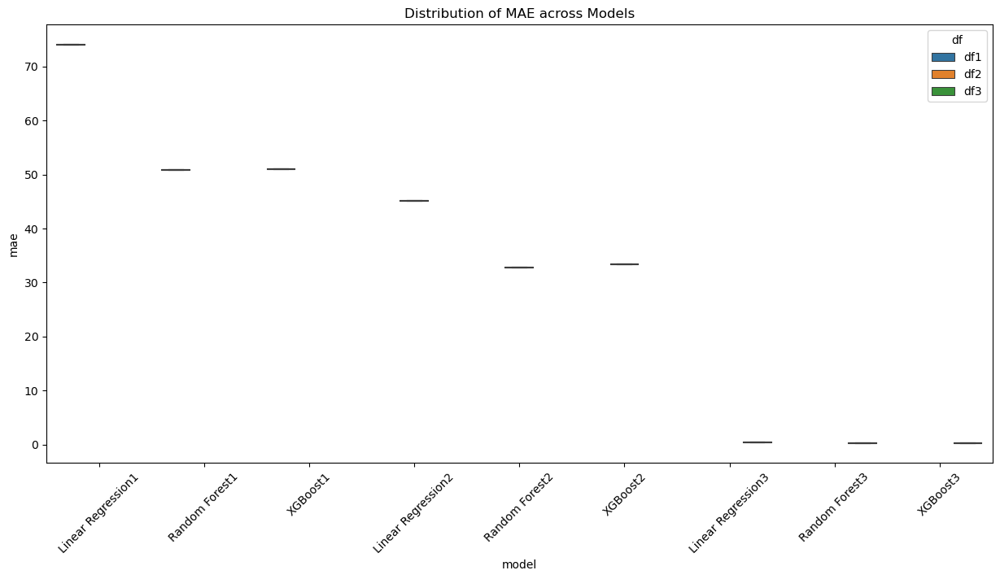

In [121]:
flat_df = pivot_df.reset_index()

# Create box plot for MAE
plt.figure(figsize=(15, 7))
sns.boxplot(x="model", y="mae", hue="df", data=flat_df)
plt.title("Distribution of MAE across Models")
plt.xticks(rotation=45)
plt.show()

### It is a tough call between Random Forest and Xgboost

## Hyper Parameter Tuning of the best performing model using Random search cv
1. XGboost Regressor

In [123]:
param_dist = {
    'max_depth': range(3,7),
    'learning_rate': np.linspace(0.01, 0.1, num=10),
    'min_child_weight': range(1,5),
    'gamma': np.linspace(0,0.5, num=10),
    'subsample': np.linspace(0.5,1.0, num=10),
    'colsample_bytree': np.linspace(0.5,1.0, num=10),
}

xgb = XGBRegressor(n_estimators=500, objective='reg:squaredlogerror')

rscv = RandomizedSearchCV(xgb, param_distributions=param_dist, n_iter=100, cv=3, verbose=2, n_jobs=-1)

rscv.fit(x_train, y_train)

print(rscv.best_params_)

Fitting 3 folds for each of 100 candidates, totalling 300 fits
{'subsample': 1.0, 'min_child_weight': 1, 'max_depth': 4, 'learning_rate': 0.09000000000000001, 'gamma': 0.1111111111111111, 'colsample_bytree': 0.7777777777777778}


In [74]:
xgb3 = XGBRegressor(
    objective='reg:squaredlogerror',
    subsample=1.0,
    min_child_weight=1,
    max_depth=4,
    learning_rate=0.09000000000000001,
    gamma=0.1111111111111111,
    colsample_bytree=0.7777777777777778,
)

xgb3.fit(x_train, y_train)

y_pred_xgb3 = xgb3.predict(x_test)

In [76]:
def mean_absolute_percentage_error(y_true, y_pred): 
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

mape_xgb3 = mean_absolute_percentage_error(y_test, y_pred_xgb3)
mae_xgb3  = metrics.mean_absolute_error(y_test, y_pred_xgb3)
mse_xgb3  = metrics.mean_squared_error(y_test, y_pred_xgb3)
rmse_xgb3 = np.sqrt(metrics.mean_squared_error(y_test, y_pred_xgb3))
r2_xgb3   = metrics.r2_score(y_test, y_pred_xgb3)

print('\nMean Absolute Percentage Error of Linear Regression : ', mape_xgb3)
print('\nMean Absolute Error of XGBoost Regressor     : ', mae_xgb3)
print('\nMean Squarred Error of XGBoost Regressor     : ', mse_xgb3)
print('\nRoot Mean Squarred Error of XGBoost Regressor: ', rmse_xgb3)
print('\nR2 Score of XGBoost Regressor                : ', r2_xgb3)


Mean Absolute Percentage Error of Linear Regression :  6.341641400701908

Mean Absolute Error of XGBoost Regressor     :  0.30988643579664826

Mean Squarred Error of XGBoost Regressor     :  0.18937074979442584

Root Mean Squarred Error of XGBoost Regressor:  0.4351674962522199

R2 Score of XGBoost Regressor                :  0.6858608366636243


In [132]:
param_dist = {
    'objective': ['reg:squarederror', 'reg:squaredlogerror'],
    'n_estimators': range(100, 501),
    'max_depth': range(3,10),
    'learning_rate': np.logspace(-3, -1, num=10),
    'min_child_weight': range(1,6),
    'gamma': np.linspace(0,0.5, num=10),
    'subsample': np.linspace(0.6,1.0, num=10),
    'colsample_bytree': np.linspace(0.6,1.0, num=10),
}

xgb = XGBRegressor(random_state=42)

rscv = RandomizedSearchCV(xgb, param_distributions=param_dist, n_iter=50, cv=3, verbose=2, n_jobs=-1, random_state=42)

rscv.fit(x_train, y_train)

print(rscv.best_params_)

Fitting 3 folds for each of 50 candidates, totalling 150 fits
{'subsample': 0.8222222222222222, 'objective': 'reg:squarederror', 'n_estimators': 447, 'min_child_weight': 3, 'max_depth': 8, 'learning_rate': 0.05994842503189409, 'gamma': 0.38888888888888884, 'colsample_bytree': 0.7333333333333333}


In [77]:
xgb4 = XGBRegressor(
    objective='reg:squarederror',
    subsample=0.8222222222222222,
    min_child_weight=8,
    max_depth=8,
    learning_rate=0.05994842503189409,
    gamma=0.38888888888888884,
    colsample_bytree=0.7333333333333333,
    n_estimators=447,
)

xgb4.fit(x_train, y_train)

y_pred_xgb4 = xgb4.predict(x_test)

In [78]:
mape_xgb4 = mean_absolute_percentage_error(y_test, y_pred_xgb4)
mae_xgb4  = metrics.mean_absolute_error(y_test, y_pred_xgb4)
mse_xgb4  = metrics.mean_squared_error(y_test, y_pred_xgb4)
rmse_xgb4 = np.sqrt(metrics.mean_squared_error(y_test, y_pred_xgb4))
r2_xgb4   = metrics.r2_score(y_test, y_pred_xgb4)

print('\nMean Absolute Percentage Error of Linear Regression : ', mape_xgb4)
print('\nMean Absolute Error of XGBoost Regressor     : ', mae_xgb4)
print('\nMean Squarred Error of XGBoost Regressor     : ', mse_xgb4)
print('\nRoot Mean Squarred Error of XGBoost Regressor: ', rmse_xgb4)
print('\nR2 Score of XGBoost Regressor                : ', r2_xgb4)


Mean Absolute Percentage Error of Linear Regression :  5.568078371511292

Mean Absolute Error of XGBoost Regressor     :  0.2696767266174801

Mean Squarred Error of XGBoost Regressor     :  0.1540605179778342

Root Mean Squarred Error of XGBoost Regressor:  0.3925054368767829

R2 Score of XGBoost Regressor                :  0.7444354934789932


2. Random Forest Regressor

In [139]:
param_dist = {
    'n_estimators': [100,500],
    'max_depth': [5, 10],
    'min_samples_split': [5, 10],
    'min_samples_leaf': [2, 4],
    'max_features': ['auto'],
    'bootstrap': [True, False]
}


In [142]:
rf3 = RandomForestRegressor()
rscv1 = RandomizedSearchCV(
    estimator = rf3, 
    param_distributions = param_dist, 
    n_iter = 100, 
    cv = 3, 
    verbose = 2, 
    random_state = 42, 
    n_jobs = -1
)

# Fit the random search model
rscv1.fit(x_train, y_train)

# You can get the best parameters like this
print(rscv1.best_params_)

Fitting 3 folds for each of 32 candidates, totalling 96 fits
{'n_estimators': 500, 'min_samples_split': 5, 'min_samples_leaf': 4, 'max_features': 'auto', 'max_depth': 10, 'bootstrap': True}


In [79]:
rf3 = RandomForestRegressor(
    n_estimators = 500, 
    min_samples_split = 5, 
    min_samples_leaf = 4, 
    max_features = 'auto', 
    max_depth = 10, 
    bootstrap = True,
    random_state = 42   
)


rf3.fit(x_train, y_train)



y_pred_rf3 = rf3.predict(x_test)

In [81]:
def mean_absolute_percentage_error(y_true, y_pred): 
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

mape_rf3 = mean_absolute_percentage_error(y_test, y_pred_rf3)
mae_rf3 = metrics.mean_absolute_error(y_test, y_pred_rf3)
mse_rf3 = metrics.mean_squared_error(y_test, y_pred_rf3)
rmse_rf3 = np.sqrt(metrics.mean_squared_error(y_test, y_pred_rf3))
r2_rf3 = metrics.r2_score(y_test, y_pred_rf3)

print('\nMean Absolute Percentage Error of Random Forest Regressor : ', mape_rf3)
print('\nMean Absolute Error of Random Forest Regressor     : ', mae_rf3)
print('\nMean Squarred Error of Random Forest Regressor     : ', mse_rf3)
print('\nRoot Mean Squarred Error of Random Forest Regressor: ', rmse_rf3)
print('\nR2 Score of Random Forest Regressor                : ', r2_rf3)


Mean Absolute Percentage Error of Random Forest Regressor :  6.160992143042894

Mean Absolute Error of Random Forest Regressor     :  0.29927273322557313

Mean Squarred Error of Random Forest Regressor     :  0.18184137288506616

Root Mean Squarred Error of Random Forest Regressor:  0.426428625780524

R2 Score of Random Forest Regressor                :  0.6983510029924693


In [83]:
data = [
    
    {"model": "Random Forest", "mse": mse_rf3, "mae": mae_rf3, "rmse": rmse_rf3, "r2": r2_rf3},
    {"model": "XGBoost 1", "mse": mse_xgb3, "mae": mae_xgb3, "rmse": rmse_xgb3, "r2": r2_xgb3},
    {"model": "XGBoost 2", "mse": mse_xgb4, "mae": mae_xgb4, "rmse": rmse_xgb4, "r2": r2_xgb4},
    {'model': 'CatBoost', 'mse': mse_cbr, 'mae': mae_cbr, 'rmse': rmse_cbr, 'r2': r2_cbr}
]

# Create DataFrame
df = pd.DataFrame(data)

# Create pivot table
pivot_df = pd.pivot_table(df, values=['mae', 'mse', 'rmse', 'r2'], index=['model'])

pivot_df

,mae,mse,r2,rmse
model,,,,
CatBoost,0.275652,0.156786,0.739914,0.395963
Random Forest,0.299273,0.181841,0.698351,0.426429
XGBoost 1,0.309886,0.189371,0.685861,0.435167
XGBoost 2,0.269677,0.154061,0.744435,0.392505


#### The best performing model is XGBoost 2. Saving it as pickle file

# Pickle model

In [125]:
with open('airbnb.pkl','wb') as pickle_model:
    pickle.dump(xgb4,pickle_model)

In [156]:
#getting/importing the pickle file
with open('airbnb.pkl','rb') as r_model:
    model = pickle.load(r_model)

In [157]:
log_pred = model.predict(x_train)

In [158]:
# inverse transformation
predictions = np.exp(log_pred)

In [159]:
predictions

array([  48.875626, 1819.4031  ,  105.5249  , ...,  113.38085 ,
        610.99493 ,  401.55887 ], dtype=float32)

In [160]:
predictions_rounded = np.round(predictions)

In [161]:
predictions_rounded

array([  49., 1819.,  106., ...,  113.,  611.,  402.], dtype=float32)

### Cat Boost model

In [44]:
X__ = df3.drop(['name', 'host_name','amenities','first_review', 'last_review','host_since','price'],axis=1)
y = df3['price']

In [45]:
final_df__ = X__.drop(['host_response_rate','host_is_superhost', 'host_identity_verified','latitude', 'longitude','maximum_nights','has_availability','listing_life','day_of_review','host_experience_years','guest_capacity','price_level','host_rating','calculated_host_listings_count'],axis=1)

In [46]:
final_df__['beds'] = final_df__['beds'].astype('float')
final_df__['bedrooms'] = final_df__['bedrooms'].astype('float')

In [47]:
x = final_df__
y= df3['price']

In [48]:
x_train, x_test, y_train, y_test = train_test_split(x,y,test_size=0.2,random_state=101)

In [49]:
x_train.columns

Index(['host_response_time', 'host_acceptance_rate', 'neighbourhood',
       'neighbourhood_group', 'property_type', 'room_type', 'accommodates',
       'bathrooms_text', 'bedrooms', 'beds', 'minimum_nights',
       'availability_365', 'number_of_reviews', 'instant_bookable',
       'distance_to_airport', 'distance_to_timessquare'],
      dtype='object')

In [50]:
cat_features_indices = [0, 2, 3, 4, 5, 7, 13]

In [51]:
model_CBR = CatBoostRegressor()

model_CBR.fit(x_train, y_train,cat_features=cat_features_indices)

y_pred_cbr = model_CBR.predict(x_test)

Learning rate set to 0.071572
0:	learn: 0.7488421	total: 317ms	remaining: 5m 16s
1:	learn: 0.7202909	total: 413ms	remaining: 3m 26s
2:	learn: 0.6953224	total: 494ms	remaining: 2m 44s
3:	learn: 0.6722522	total: 577ms	remaining: 2m 23s
4:	learn: 0.6519300	total: 677ms	remaining: 2m 14s
5:	learn: 0.6341695	total: 760ms	remaining: 2m 5s
6:	learn: 0.6172658	total: 841ms	remaining: 1m 59s
7:	learn: 0.6021278	total: 919ms	remaining: 1m 53s
8:	learn: 0.5887845	total: 973ms	remaining: 1m 47s
9:	learn: 0.5765488	total: 1.03s	remaining: 1m 41s
10:	learn: 0.5651893	total: 1.11s	remaining: 1m 39s
11:	learn: 0.5550368	total: 1.18s	remaining: 1m 36s
12:	learn: 0.5456677	total: 1.24s	remaining: 1m 34s
13:	learn: 0.5376354	total: 1.31s	remaining: 1m 31s
14:	learn: 0.5294791	total: 1.39s	remaining: 1m 31s
15:	learn: 0.5221895	total: 1.47s	remaining: 1m 30s
16:	learn: 0.5158242	total: 1.54s	remaining: 1m 29s
17:	learn: 0.5092878	total: 1.62s	remaining: 1m 28s
18:	learn: 0.5035276	total: 1.71s	remaining: 

157:	learn: 0.4200565	total: 14.5s	remaining: 1m 17s
158:	learn: 0.4198750	total: 14.6s	remaining: 1m 17s
159:	learn: 0.4197677	total: 14.7s	remaining: 1m 17s
160:	learn: 0.4196461	total: 14.8s	remaining: 1m 17s
161:	learn: 0.4195578	total: 14.9s	remaining: 1m 17s
162:	learn: 0.4193680	total: 15s	remaining: 1m 17s
163:	learn: 0.4190194	total: 15.1s	remaining: 1m 17s
164:	learn: 0.4187987	total: 15.2s	remaining: 1m 17s
165:	learn: 0.4186540	total: 15.3s	remaining: 1m 16s
166:	learn: 0.4185780	total: 15.4s	remaining: 1m 16s
167:	learn: 0.4183589	total: 15.5s	remaining: 1m 16s
168:	learn: 0.4181585	total: 15.6s	remaining: 1m 16s
169:	learn: 0.4179384	total: 15.8s	remaining: 1m 16s
170:	learn: 0.4177258	total: 15.9s	remaining: 1m 17s
171:	learn: 0.4177099	total: 16s	remaining: 1m 17s
172:	learn: 0.4175660	total: 16.2s	remaining: 1m 17s
173:	learn: 0.4175419	total: 16.3s	remaining: 1m 17s
174:	learn: 0.4173799	total: 16.4s	remaining: 1m 17s
175:	learn: 0.4172556	total: 16.5s	remaining: 1m 1

316:	learn: 0.4037246	total: 29.5s	remaining: 1m 3s
317:	learn: 0.4036177	total: 29.7s	remaining: 1m 3s
318:	learn: 0.4035422	total: 29.8s	remaining: 1m 3s
319:	learn: 0.4035316	total: 29.9s	remaining: 1m 3s
320:	learn: 0.4033889	total: 30s	remaining: 1m 3s
321:	learn: 0.4033281	total: 30s	remaining: 1m 3s
322:	learn: 0.4032371	total: 30.1s	remaining: 1m 3s
323:	learn: 0.4030699	total: 30.2s	remaining: 1m 2s
324:	learn: 0.4030025	total: 30.3s	remaining: 1m 2s
325:	learn: 0.4029972	total: 30.3s	remaining: 1m 2s
326:	learn: 0.4029330	total: 30.5s	remaining: 1m 2s
327:	learn: 0.4029156	total: 30.6s	remaining: 1m 2s
328:	learn: 0.4028439	total: 30.7s	remaining: 1m 2s
329:	learn: 0.4026863	total: 30.8s	remaining: 1m 2s
330:	learn: 0.4026748	total: 30.9s	remaining: 1m 2s
331:	learn: 0.4026524	total: 31s	remaining: 1m 2s
332:	learn: 0.4025161	total: 31.1s	remaining: 1m 2s
333:	learn: 0.4024635	total: 31.1s	remaining: 1m 2s
334:	learn: 0.4024570	total: 31.2s	remaining: 1m 1s
335:	learn: 0.4023

476:	learn: 0.3935767	total: 44.7s	remaining: 49s
477:	learn: 0.3935397	total: 44.8s	remaining: 48.9s
478:	learn: 0.3935121	total: 44.9s	remaining: 48.8s
479:	learn: 0.3934687	total: 44.9s	remaining: 48.7s
480:	learn: 0.3934381	total: 45s	remaining: 48.5s
481:	learn: 0.3933865	total: 45.1s	remaining: 48.4s
482:	learn: 0.3933476	total: 45.1s	remaining: 48.3s
483:	learn: 0.3932789	total: 45.2s	remaining: 48.2s
484:	learn: 0.3932623	total: 45.3s	remaining: 48.1s
485:	learn: 0.3932537	total: 45.4s	remaining: 48s
486:	learn: 0.3931990	total: 45.4s	remaining: 47.9s
487:	learn: 0.3931725	total: 45.5s	remaining: 47.8s
488:	learn: 0.3931513	total: 45.6s	remaining: 47.6s
489:	learn: 0.3931138	total: 45.7s	remaining: 47.5s
490:	learn: 0.3930825	total: 45.8s	remaining: 47.5s
491:	learn: 0.3930517	total: 46s	remaining: 47.5s
492:	learn: 0.3929742	total: 46.1s	remaining: 47.4s
493:	learn: 0.3929059	total: 46.3s	remaining: 47.4s
494:	learn: 0.3928342	total: 46.5s	remaining: 47.4s
495:	learn: 0.392799

636:	learn: 0.3863182	total: 1m 1s	remaining: 35s
637:	learn: 0.3862499	total: 1m 1s	remaining: 34.9s
638:	learn: 0.3861934	total: 1m 1s	remaining: 34.8s
639:	learn: 0.3861040	total: 1m 1s	remaining: 34.7s
640:	learn: 0.3860105	total: 1m 1s	remaining: 34.6s
641:	learn: 0.3859913	total: 1m 1s	remaining: 34.5s
642:	learn: 0.3859878	total: 1m 1s	remaining: 34.4s
643:	learn: 0.3858880	total: 1m 2s	remaining: 34.3s
644:	learn: 0.3858280	total: 1m 2s	remaining: 34.2s
645:	learn: 0.3857645	total: 1m 2s	remaining: 34.1s
646:	learn: 0.3856829	total: 1m 2s	remaining: 34s
647:	learn: 0.3855639	total: 1m 2s	remaining: 33.9s
648:	learn: 0.3855170	total: 1m 2s	remaining: 33.8s
649:	learn: 0.3854853	total: 1m 2s	remaining: 33.7s
650:	learn: 0.3853923	total: 1m 2s	remaining: 33.6s
651:	learn: 0.3853649	total: 1m 2s	remaining: 33.5s
652:	learn: 0.3852980	total: 1m 2s	remaining: 33.4s
653:	learn: 0.3852670	total: 1m 3s	remaining: 33.3s
654:	learn: 0.3851654	total: 1m 3s	remaining: 33.2s
655:	learn: 0.38

795:	learn: 0.3791184	total: 1m 14s	remaining: 19s
796:	learn: 0.3790552	total: 1m 14s	remaining: 18.9s
797:	learn: 0.3790002	total: 1m 14s	remaining: 18.8s
798:	learn: 0.3789599	total: 1m 14s	remaining: 18.7s
799:	learn: 0.3789508	total: 1m 14s	remaining: 18.6s
800:	learn: 0.3789196	total: 1m 14s	remaining: 18.5s
801:	learn: 0.3789182	total: 1m 14s	remaining: 18.4s
802:	learn: 0.3789100	total: 1m 14s	remaining: 18.3s
803:	learn: 0.3788928	total: 1m 14s	remaining: 18.2s
804:	learn: 0.3788747	total: 1m 14s	remaining: 18.1s
805:	learn: 0.3788236	total: 1m 14s	remaining: 18s
806:	learn: 0.3787927	total: 1m 15s	remaining: 17.9s
807:	learn: 0.3787623	total: 1m 15s	remaining: 17.9s
808:	learn: 0.3787169	total: 1m 15s	remaining: 17.8s
809:	learn: 0.3786814	total: 1m 15s	remaining: 17.7s
810:	learn: 0.3786767	total: 1m 15s	remaining: 17.6s
811:	learn: 0.3786469	total: 1m 15s	remaining: 17.5s
812:	learn: 0.3786249	total: 1m 15s	remaining: 17.4s
813:	learn: 0.3785854	total: 1m 15s	remaining: 17.

951:	learn: 0.3736903	total: 1m 30s	remaining: 4.54s
952:	learn: 0.3736732	total: 1m 30s	remaining: 4.45s
953:	learn: 0.3736440	total: 1m 30s	remaining: 4.35s
954:	learn: 0.3736163	total: 1m 30s	remaining: 4.26s
955:	learn: 0.3735949	total: 1m 30s	remaining: 4.17s
956:	learn: 0.3735506	total: 1m 30s	remaining: 4.07s
957:	learn: 0.3735440	total: 1m 30s	remaining: 3.98s
958:	learn: 0.3735105	total: 1m 30s	remaining: 3.88s
959:	learn: 0.3734408	total: 1m 31s	remaining: 3.79s
960:	learn: 0.3734082	total: 1m 31s	remaining: 3.7s
961:	learn: 0.3733683	total: 1m 31s	remaining: 3.6s
962:	learn: 0.3733070	total: 1m 31s	remaining: 3.51s
963:	learn: 0.3732883	total: 1m 31s	remaining: 3.42s
964:	learn: 0.3732489	total: 1m 31s	remaining: 3.32s
965:	learn: 0.3732259	total: 1m 31s	remaining: 3.23s
966:	learn: 0.3731869	total: 1m 31s	remaining: 3.13s
967:	learn: 0.3731276	total: 1m 32s	remaining: 3.04s
968:	learn: 0.3731080	total: 1m 32s	remaining: 2.95s
969:	learn: 0.3731025	total: 1m 32s	remaining: 2

In [52]:
mae_cbr  = metrics.mean_absolute_error(y_test, y_pred_cbr)
mse_cbr  = metrics.mean_squared_error(y_test, y_pred_cbr)
rmse_cbr = np.sqrt(metrics.mean_squared_error(y_test, y_pred_cbr))
r2_cbr   = metrics.r2_score(y_test, y_pred_cbr)


print('\nMean Absolute Error of CatBoost Regressor     : ', mae_cbr)
print('\nMean Squarred Error of CatBoost Regressor     : ', mse_cbr)
print('\nRoot Mean Squarred Error of CatBoost Regressor: ', rmse_cbr)
print('\nR2 Score of CatBoost Regressor                : ', r2_cbr)


Mean Absolute Error of CatBoost Regressor     :  0.2756519980141524

Mean Squarred Error of CatBoost Regressor     :  0.15678647701769655

Root Mean Squarred Error of CatBoost Regressor:  0.39596272175256164

R2 Score of CatBoost Regressor                :  0.7399135148048781


Hyper parameter tuning

In [51]:
param_dist = {
    'learning_rate': np.logspace(0.1,0.01),
    'depth': [6, 7, 8],
    'iterations': [100,200],
    'l2_leaf_reg': [3, 5, 7],
    'border_count': [32, 64],
    'random_strength': np.linspace(0, 5),
    'min_data_in_leaf': [3, 4, 5]
    
}


In [52]:
# Initialize CatBoostRegressor
cb_model = CatBoostRegressor()

# Use RandomizedSearchCV
random_search = RandomizedSearchCV(
    cb_model, 
    param_distributions=param_dist, 
    n_iter=50, 
    scoring='neg_mean_squared_error', 
    cv=3, 
    verbose=3, 
    n_jobs=1, 
    random_state=42
)

random_search.fit(x_train, y_train,cat_features=cat_features_indices)

# Print the best parameters
print("Best parameters found: ", random_search.best_params_)

Fitting 3 folds for each of 50 candidates, totalling 150 fits


learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5061482	total: 217ms	remaining: 43.1s
1:	learn: 0.4767659	total: 445ms	remaining: 44.1s
2:	learn: 0.4595596	total: 923ms	remaining: 1m
3:	learn: 0.4501533	total: 1.13s	remaining: 55.5s
4:	learn: 0.4399571	total: 1.36s	remaining: 53s
5:	learn: 0.4340360	total: 1.54s	remaining: 49.8s
6:	learn: 0.4308905	total: 1.71s	remaining: 47.1s
7:	learn: 0.4272645	total: 1.85s	remaining: 44.3s
8:	learn: 0.4232201	total: 2.02s	remaining: 43s
9:	learn: 0.4190456	total: 2.2s	remaining: 41.9s
10:	learn: 0.4149288	total: 2.36s	remaining: 40.6s
11:	learn: 0.4134028	total: 2.53s	remaining: 39.7s
12:	learn: 0.4120676	total: 2.69s	remaining: 38.7s
13:	learn: 0.4096804	total: 2.87s	remaining: 38.1s
14:	learn: 0.4069535	total: 3.06s	remaining: 37.7s
15:	learn: 0.4043203	total: 3.21s	remaining: 36.9s
16:	learn: 0.4032624	total: 3.36s	remaining: 36.2s
17:	learn: 0.4010995	total: 3.5s	remaining: 35.4s
18:	learn: 0.3976140	total: 3.71s	remaining: 35.3s
19:	learn: 0.3963845	total: 3.85s	remaining: 34.7s

162:	learn: 0.2863610	total: 31.5s	remaining: 7.16s
163:	learn: 0.2856869	total: 31.7s	remaining: 6.95s
164:	learn: 0.2849003	total: 31.8s	remaining: 6.75s
165:	learn: 0.2838372	total: 32s	remaining: 6.55s
166:	learn: 0.2835166	total: 32.1s	remaining: 6.34s
167:	learn: 0.2831306	total: 32.2s	remaining: 6.14s
168:	learn: 0.2828191	total: 32.4s	remaining: 5.94s
169:	learn: 0.2823761	total: 32.5s	remaining: 5.74s
170:	learn: 0.2816998	total: 32.7s	remaining: 5.54s
171:	learn: 0.2814388	total: 33.1s	remaining: 5.39s
172:	learn: 0.2809287	total: 33.3s	remaining: 5.19s
173:	learn: 0.2803507	total: 33.4s	remaining: 4.99s
174:	learn: 0.2802174	total: 33.6s	remaining: 4.79s
175:	learn: 0.2797864	total: 33.7s	remaining: 4.59s
176:	learn: 0.2791395	total: 33.8s	remaining: 4.4s
177:	learn: 0.2788564	total: 34s	remaining: 4.2s
178:	learn: 0.2787108	total: 34.2s	remaining: 4.01s
179:	learn: 0.2785887	total: 34.3s	remaining: 3.81s
180:	learn: 0.2779294	total: 34.5s	remaining: 3.62s
181:	learn: 0.2778

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5122189	total: 150ms	remaining: 29.9s
1:	learn: 0.4807531	total: 284ms	remaining: 28.1s
2:	learn: 0.4637692	total: 435ms	remaining: 28.6s
3:	learn: 0.4501312	total: 568ms	remaining: 27.8s
4:	learn: 0.4429158	total: 706ms	remaining: 27.5s
5:	learn: 0.4386892	total: 847ms	remaining: 27.4s
6:	learn: 0.4343012	total: 1s	remaining: 27.6s
7:	learn: 0.4311963	total: 1.16s	remaining: 27.8s
8:	learn: 0.4278946	total: 1.32s	remaining: 28.1s
9:	learn: 0.4231998	total: 1.47s	remaining: 27.9s
10:	learn: 0.4198558	total: 1.6s	remaining: 27.6s
11:	learn: 0.4171589	total: 1.75s	remaining: 27.4s
12:	learn: 0.4145683	total: 1.89s	remaining: 27.3s
13:	learn: 0.4128002	total: 2.02s	remaining: 26.9s
14:	learn: 0.4094021	total: 2.15s	remaining: 26.5s
15:	learn: 0.4071289	total: 2.3s	remaining: 26.5s
16:	learn: 0.4051098	total: 2.43s	remaining: 26.2s
17:	learn: 0.4042953	total: 2.56s	remaining: 25.9s
18:	learn: 0.4013011	total: 2.7s	remaining: 25.7s
19:	learn: 0.4005479	total: 2.84s	remaining: 25

162:	learn: 0.2897014	total: 23.2s	remaining: 5.27s
163:	learn: 0.2893792	total: 23.3s	remaining: 5.12s
164:	learn: 0.2889785	total: 23.5s	remaining: 4.98s
165:	learn: 0.2883522	total: 23.7s	remaining: 4.85s
166:	learn: 0.2878104	total: 23.9s	remaining: 4.72s
167:	learn: 0.2876310	total: 24s	remaining: 4.58s
168:	learn: 0.2871853	total: 24.2s	remaining: 4.44s
169:	learn: 0.2869882	total: 24.5s	remaining: 4.32s
170:	learn: 0.2863089	total: 24.6s	remaining: 4.18s
171:	learn: 0.2857702	total: 24.9s	remaining: 4.06s
172:	learn: 0.2853074	total: 25.2s	remaining: 3.93s
173:	learn: 0.2848776	total: 25.3s	remaining: 3.78s
174:	learn: 0.2839661	total: 25.5s	remaining: 3.64s
175:	learn: 0.2834760	total: 25.7s	remaining: 3.5s
176:	learn: 0.2828618	total: 25.9s	remaining: 3.37s
177:	learn: 0.2822269	total: 26.1s	remaining: 3.22s
178:	learn: 0.2815669	total: 26.5s	remaining: 3.11s
179:	learn: 0.2809325	total: 26.6s	remaining: 2.96s
180:	learn: 0.2804856	total: 26.9s	remaining: 2.83s
181:	learn: 0.2

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5206299	total: 212ms	remaining: 42.1s
1:	learn: 0.4884244	total: 383ms	remaining: 37.9s
2:	learn: 0.4650425	total: 562ms	remaining: 36.9s
3:	learn: 0.4549905	total: 688ms	remaining: 33.7s
4:	learn: 0.4491551	total: 848ms	remaining: 33.1s
5:	learn: 0.4423134	total: 992ms	remaining: 32.1s
6:	learn: 0.4353212	total: 1.34s	remaining: 37s
7:	learn: 0.4332205	total: 1.71s	remaining: 41s
8:	learn: 0.4291974	total: 1.88s	remaining: 39.8s
9:	learn: 0.4235597	total: 2.05s	remaining: 38.9s
10:	learn: 0.4194267	total: 3.11s	remaining: 53.5s
11:	learn: 0.4159372	total: 3.27s	remaining: 51.3s
12:	learn: 0.4138052	total: 3.45s	remaining: 49.7s
13:	learn: 0.4114364	total: 3.69s	remaining: 49s
14:	learn: 0.4074602	total: 3.84s	remaining: 47.4s
15:	learn: 0.4052243	total: 4.07s	remaining: 46.8s
16:	learn: 0.4020856	total: 4.32s	remaining: 46.5s
17:	learn: 0.4004493	total: 4.94s	remaining: 49.9s
18:	learn: 0.3973955	total: 5.36s	remaining: 51s
19:	learn: 0.3949289	total: 5.83s	remaining: 52.5

161:	learn: 0.2923016	total: 46.1s	remaining: 10.8s
162:	learn: 0.2919030	total: 46.4s	remaining: 10.5s
163:	learn: 0.2915681	total: 46.9s	remaining: 10.3s
164:	learn: 0.2912040	total: 47.7s	remaining: 10.1s
165:	learn: 0.2909097	total: 48.3s	remaining: 9.89s
166:	learn: 0.2905737	total: 48.9s	remaining: 9.66s
167:	learn: 0.2901754	total: 49.2s	remaining: 9.37s
168:	learn: 0.2897305	total: 49.6s	remaining: 9.1s
169:	learn: 0.2895876	total: 49.9s	remaining: 8.81s
170:	learn: 0.2893238	total: 50.2s	remaining: 8.52s
171:	learn: 0.2889144	total: 50.9s	remaining: 8.28s
172:	learn: 0.2885151	total: 51.4s	remaining: 8.02s
173:	learn: 0.2878563	total: 51.6s	remaining: 7.71s
174:	learn: 0.2874825	total: 51.9s	remaining: 7.41s
175:	learn: 0.2871542	total: 52.1s	remaining: 7.1s
176:	learn: 0.2865789	total: 52.4s	remaining: 6.81s
177:	learn: 0.2860110	total: 52.7s	remaining: 6.51s
178:	learn: 0.2857770	total: 53.2s	remaining: 6.24s
179:	learn: 0.2849814	total: 53.5s	remaining: 5.95s
180:	learn: 0.

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5300534	total: 96.8ms	remaining: 9.58s
1:	learn: 0.4965090	total: 171ms	remaining: 8.39s
2:	learn: 0.4808148	total: 248ms	remaining: 8s
3:	learn: 0.4699755	total: 338ms	remaining: 8.11s
4:	learn: 0.4612632	total: 436ms	remaining: 8.29s
5:	learn: 0.4573822	total: 568ms	remaining: 8.9s
6:	learn: 0.4537085	total: 671ms	remaining: 8.91s
7:	learn: 0.4458062	total: 755ms	remaining: 8.68s
8:	learn: 0.4419963	total: 825ms	remaining: 8.34s
9:	learn: 0.4396368	total: 881ms	remaining: 7.93s
10:	learn: 0.4373147	total: 939ms	remaining: 7.6s
11:	learn: 0.4340570	total: 992ms	remaining: 7.27s
12:	learn: 0.4312137	total: 1.05s	remaining: 7.04s
13:	learn: 0.4295086	total: 1.11s	remaining: 6.82s
14:	learn: 0.4271888	total: 1.17s	remaining: 6.61s
15:	learn: 0.4239460	total: 1.22s	remaining: 6.43s
16:	learn: 0.4229855	total: 1.28s	remaining: 6.26s
17:	learn: 0.4228182	total: 1.34s	remaining: 6.09s
18:	learn: 0.4216890	total: 1.39s	remaining: 5.94s
19:	learn: 0.4203037	total: 1.45s	remaining: 

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5308164	total: 65ms	remaining: 6.43s
1:	learn: 0.4933817	total: 128ms	remaining: 6.29s
2:	learn: 0.4781761	total: 193ms	remaining: 6.25s
3:	learn: 0.4688062	total: 258ms	remaining: 6.2s
4:	learn: 0.4624414	total: 329ms	remaining: 6.26s
5:	learn: 0.4583065	total: 391ms	remaining: 6.12s
6:	learn: 0.4548405	total: 449ms	remaining: 5.97s
7:	learn: 0.4486030	total: 586ms	remaining: 6.74s
8:	learn: 0.4464343	total: 703ms	remaining: 7.11s
9:	learn: 0.4419265	total: 847ms	remaining: 7.63s
10:	learn: 0.4402133	total: 977ms	remaining: 7.9s
11:	learn: 0.4369524	total: 1.1s	remaining: 8.09s
12:	learn: 0.4346979	total: 1.24s	remaining: 8.29s
13:	learn: 0.4319568	total: 1.38s	remaining: 8.45s
14:	learn: 0.4301998	total: 1.47s	remaining: 8.33s
15:	learn: 0.4293629	total: 1.53s	remaining: 8.06s
16:	learn: 0.4280791	total: 1.59s	remaining: 7.79s
17:	learn: 0.4279323	total: 1.65s	remaining: 7.52s
18:	learn: 0.4249708	total: 1.71s	remaining: 7.27s
19:	learn: 0.4231895	total: 1.76s	remaining: 

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5417984	total: 72.8ms	remaining: 7.21s
1:	learn: 0.5024596	total: 136ms	remaining: 6.67s
2:	learn: 0.4851596	total: 196ms	remaining: 6.33s
3:	learn: 0.4737490	total: 258ms	remaining: 6.18s
4:	learn: 0.4637085	total: 317ms	remaining: 6.02s
5:	learn: 0.4601223	total: 371ms	remaining: 5.81s
6:	learn: 0.4543845	total: 427ms	remaining: 5.67s
7:	learn: 0.4501641	total: 480ms	remaining: 5.52s
8:	learn: 0.4478451	total: 542ms	remaining: 5.48s
9:	learn: 0.4452604	total: 596ms	remaining: 5.37s
10:	learn: 0.4421358	total: 651ms	remaining: 5.27s
11:	learn: 0.4382344	total: 723ms	remaining: 5.3s
12:	learn: 0.4354685	total: 793ms	remaining: 5.31s
13:	learn: 0.4333145	total: 853ms	remaining: 5.24s
14:	learn: 0.4313790	total: 912ms	remaining: 5.17s
15:	learn: 0.4269434	total: 971ms	remaining: 5.1s
16:	learn: 0.4255092	total: 1.03s	remaining: 5.04s
17:	learn: 0.4241974	total: 1.1s	remaining: 5s
18:	learn: 0.4217634	total: 1.16s	remaining: 4.95s
19:	learn: 0.4208061	total: 1.22s	remaining: 4

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5326737	total: 204ms	remaining: 40.6s
1:	learn: 0.5000795	total: 465ms	remaining: 46s
2:	learn: 0.4854870	total: 778ms	remaining: 51.1s
3:	learn: 0.4731820	total: 963ms	remaining: 47.2s
4:	learn: 0.4634346	total: 1.16s	remaining: 45.1s
5:	learn: 0.4572334	total: 1.31s	remaining: 42.3s
6:	learn: 0.4530123	total: 1.57s	remaining: 43.3s
7:	learn: 0.4483013	total: 1.86s	remaining: 44.6s
8:	learn: 0.4443265	total: 2.12s	remaining: 45.1s
9:	learn: 0.4408497	total: 2.2s	remaining: 41.8s
10:	learn: 0.4359963	total: 2.46s	remaining: 42.2s
11:	learn: 0.4321262	total: 2.82s	remaining: 44.1s
12:	learn: 0.4281099	total: 2.98s	remaining: 42.9s
13:	learn: 0.4261689	total: 3.14s	remaining: 41.7s
14:	learn: 0.4225337	total: 3.3s	remaining: 40.7s
15:	learn: 0.4183031	total: 3.46s	remaining: 39.8s
16:	learn: 0.4151985	total: 3.61s	remaining: 38.8s
17:	learn: 0.4122819	total: 3.86s	remaining: 39.1s
18:	learn: 0.4120691	total: 4.1s	remaining: 39.1s
19:	learn: 0.4095669	total: 4.54s	remaining: 4

161:	learn: 0.2972731	total: 33.8s	remaining: 7.92s
162:	learn: 0.2966068	total: 33.9s	remaining: 7.7s
163:	learn: 0.2962525	total: 34.1s	remaining: 7.47s
164:	learn: 0.2955176	total: 34.2s	remaining: 7.25s
165:	learn: 0.2952856	total: 34.5s	remaining: 7.06s
166:	learn: 0.2950048	total: 35.7s	remaining: 7.05s
167:	learn: 0.2941221	total: 36.8s	remaining: 7.01s
168:	learn: 0.2935321	total: 37.1s	remaining: 6.81s
169:	learn: 0.2928729	total: 37.4s	remaining: 6.59s
170:	learn: 0.2926268	total: 37.7s	remaining: 6.4s
171:	learn: 0.2924398	total: 38s	remaining: 6.19s
172:	learn: 0.2921117	total: 38.3s	remaining: 5.97s
173:	learn: 0.2917475	total: 38.7s	remaining: 5.78s
174:	learn: 0.2910704	total: 39.2s	remaining: 5.6s
175:	learn: 0.2910365	total: 39.4s	remaining: 5.37s
176:	learn: 0.2907449	total: 39.8s	remaining: 5.17s
177:	learn: 0.2904232	total: 40s	remaining: 4.95s
178:	learn: 0.2898787	total: 40.2s	remaining: 4.71s
179:	learn: 0.2894787	total: 40.3s	remaining: 4.48s
180:	learn: 0.28875

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5322745	total: 160ms	remaining: 31.8s
1:	learn: 0.5007630	total: 325ms	remaining: 32.1s
2:	learn: 0.4809271	total: 477ms	remaining: 31.3s
3:	learn: 0.4677393	total: 625ms	remaining: 30.6s
4:	learn: 0.4661940	total: 668ms	remaining: 26s
5:	learn: 0.4586391	total: 957ms	remaining: 31s
6:	learn: 0.4495547	total: 1.09s	remaining: 30.2s
7:	learn: 0.4475135	total: 1.22s	remaining: 29.3s
8:	learn: 0.4442597	total: 1.34s	remaining: 28.4s
9:	learn: 0.4418726	total: 1.51s	remaining: 28.8s
10:	learn: 0.4380158	total: 1.65s	remaining: 28.4s
11:	learn: 0.4339167	total: 1.79s	remaining: 28.1s
12:	learn: 0.4293369	total: 1.94s	remaining: 27.8s
13:	learn: 0.4256959	total: 2.08s	remaining: 27.6s
14:	learn: 0.4222535	total: 2.2s	remaining: 27.1s
15:	learn: 0.4198885	total: 2.31s	remaining: 26.6s
16:	learn: 0.4151442	total: 2.45s	remaining: 26.3s
17:	learn: 0.4111123	total: 2.6s	remaining: 26.2s
18:	learn: 0.4081259	total: 2.73s	remaining: 26s
19:	learn: 0.4080480	total: 2.84s	remaining: 25.6

161:	learn: 0.3010466	total: 34.3s	remaining: 8.05s
162:	learn: 0.3008155	total: 34.7s	remaining: 7.87s
163:	learn: 0.3002724	total: 35.1s	remaining: 7.69s
164:	learn: 0.3001867	total: 35.3s	remaining: 7.48s
165:	learn: 0.3001652	total: 35.8s	remaining: 7.32s
166:	learn: 0.2998913	total: 36s	remaining: 7.12s
167:	learn: 0.2996220	total: 36.3s	remaining: 6.91s
168:	learn: 0.2986595	total: 36.6s	remaining: 6.71s
169:	learn: 0.2985013	total: 36.9s	remaining: 6.5s
170:	learn: 0.2983047	total: 37.1s	remaining: 6.29s
171:	learn: 0.2974918	total: 37.3s	remaining: 6.08s
172:	learn: 0.2970923	total: 37.7s	remaining: 5.88s
173:	learn: 0.2966587	total: 38s	remaining: 5.68s
174:	learn: 0.2961039	total: 38.3s	remaining: 5.48s
175:	learn: 0.2955757	total: 38.6s	remaining: 5.26s
176:	learn: 0.2952311	total: 38.8s	remaining: 5.04s
177:	learn: 0.2949245	total: 39.2s	remaining: 4.85s
178:	learn: 0.2944933	total: 39.7s	remaining: 4.65s
179:	learn: 0.2940307	total: 40.1s	remaining: 4.46s
180:	learn: 0.293

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5450516	total: 298ms	remaining: 59.4s
1:	learn: 0.4981554	total: 639ms	remaining: 1m 3s
2:	learn: 0.4796723	total: 1s	remaining: 1m 5s
3:	learn: 0.4703120	total: 1.28s	remaining: 1m 2s
4:	learn: 0.4615225	total: 1.54s	remaining: 60s
5:	learn: 0.4565544	total: 1.86s	remaining: 1m
6:	learn: 0.4531508	total: 2.18s	remaining: 1m
7:	learn: 0.4511556	total: 2.47s	remaining: 59.4s
8:	learn: 0.4472628	total: 2.78s	remaining: 59s
9:	learn: 0.4424380	total: 3.14s	remaining: 59.7s
10:	learn: 0.4369007	total: 3.45s	remaining: 59.2s
11:	learn: 0.4329325	total: 3.7s	remaining: 58s
12:	learn: 0.4288480	total: 3.93s	remaining: 56.6s
13:	learn: 0.4242554	total: 4.19s	remaining: 55.7s
14:	learn: 0.4190788	total: 4.49s	remaining: 55.3s
15:	learn: 0.4183663	total: 4.76s	remaining: 54.7s
16:	learn: 0.4151415	total: 4.93s	remaining: 53.1s
17:	learn: 0.4126421	total: 5.15s	remaining: 52.1s
18:	learn: 0.4108045	total: 5.34s	remaining: 50.9s
19:	learn: 0.4087366	total: 5.61s	remaining: 50.4s
20:	le

162:	learn: 0.3003214	total: 38s	remaining: 8.63s
163:	learn: 0.2995673	total: 38.2s	remaining: 8.38s
164:	learn: 0.2991724	total: 38.3s	remaining: 8.13s
165:	learn: 0.2984523	total: 39.3s	remaining: 8.05s
166:	learn: 0.2977681	total: 40s	remaining: 7.89s
167:	learn: 0.2974727	total: 40.5s	remaining: 7.71s
168:	learn: 0.2974061	total: 40.9s	remaining: 7.5s
169:	learn: 0.2970132	total: 41.3s	remaining: 7.28s
170:	learn: 0.2967508	total: 41.6s	remaining: 7.05s
171:	learn: 0.2967109	total: 41.8s	remaining: 6.81s
172:	learn: 0.2962702	total: 42.2s	remaining: 6.58s
173:	learn: 0.2959582	total: 42.3s	remaining: 6.33s
174:	learn: 0.2957377	total: 42.6s	remaining: 6.08s
175:	learn: 0.2950047	total: 42.9s	remaining: 5.85s
176:	learn: 0.2946214	total: 43.1s	remaining: 5.6s
177:	learn: 0.2944566	total: 43.3s	remaining: 5.35s
178:	learn: 0.2940971	total: 43.5s	remaining: 5.1s
179:	learn: 0.2936652	total: 43.6s	remaining: 4.84s
180:	learn: 0.2934952	total: 43.8s	remaining: 4.6s
181:	learn: 0.293200

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5271256	total: 177ms	remaining: 35.2s
1:	learn: 0.4926003	total: 383ms	remaining: 38s
2:	learn: 0.4769770	total: 559ms	remaining: 36.7s
3:	learn: 0.4721166	total: 658ms	remaining: 32.2s
4:	learn: 0.4647980	total: 823ms	remaining: 32.1s
5:	learn: 0.4547472	total: 1.12s	remaining: 36.2s
6:	learn: 0.4522563	total: 1.3s	remaining: 36s
7:	learn: 0.4469468	total: 1.49s	remaining: 35.7s
8:	learn: 0.4431903	total: 1.65s	remaining: 35.1s
9:	learn: 0.4378762	total: 1.82s	remaining: 34.5s
10:	learn: 0.4341310	total: 1.98s	remaining: 34s
11:	learn: 0.4316195	total: 2.13s	remaining: 33.4s
12:	learn: 0.4268670	total: 2.56s	remaining: 36.8s
13:	learn: 0.4253070	total: 3.05s	remaining: 40.5s
14:	learn: 0.4201634	total: 3.3s	remaining: 40.7s
15:	learn: 0.4163777	total: 3.45s	remaining: 39.7s
16:	learn: 0.4148305	total: 3.62s	remaining: 39s
17:	learn: 0.4133328	total: 3.8s	remaining: 38.4s
18:	learn: 0.4122429	total: 4.16s	remaining: 39.6s
19:	learn: 0.4082859	total: 4.33s	remaining: 39s
20:

163:	learn: 0.2875683	total: 31.6s	remaining: 6.94s
164:	learn: 0.2872105	total: 31.9s	remaining: 6.78s
165:	learn: 0.2867327	total: 32.2s	remaining: 6.6s
166:	learn: 0.2861427	total: 32.5s	remaining: 6.42s
167:	learn: 0.2857939	total: 32.7s	remaining: 6.24s
168:	learn: 0.2854086	total: 33s	remaining: 6.04s
169:	learn: 0.2845000	total: 33.4s	remaining: 5.89s
170:	learn: 0.2838580	total: 34s	remaining: 5.76s
171:	learn: 0.2832883	total: 34.6s	remaining: 5.63s
172:	learn: 0.2827501	total: 34.9s	remaining: 5.45s
173:	learn: 0.2824608	total: 35.2s	remaining: 5.27s
174:	learn: 0.2818229	total: 35.6s	remaining: 5.09s
175:	learn: 0.2815355	total: 36s	remaining: 4.91s
176:	learn: 0.2807486	total: 36.4s	remaining: 4.73s
177:	learn: 0.2805612	total: 36.6s	remaining: 4.53s
178:	learn: 0.2803685	total: 36.9s	remaining: 4.32s
179:	learn: 0.2799365	total: 37.1s	remaining: 4.12s
180:	learn: 0.2796638	total: 37.3s	remaining: 3.91s
181:	learn: 0.2789666	total: 37.5s	remaining: 3.71s
182:	learn: 0.27816

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5264285	total: 195ms	remaining: 38.8s
1:	learn: 0.4919154	total: 380ms	remaining: 37.6s
2:	learn: 0.4742611	total: 580ms	remaining: 38.1s
3:	learn: 0.4630820	total: 741ms	remaining: 36.3s
4:	learn: 0.4552215	total: 912ms	remaining: 35.6s
5:	learn: 0.4503399	total: 1.07s	remaining: 34.8s
6:	learn: 0.4477315	total: 1.27s	remaining: 35.1s
7:	learn: 0.4463832	total: 1.42s	remaining: 34.1s
8:	learn: 0.4429548	total: 1.61s	remaining: 34.2s
9:	learn: 0.4400667	total: 1.81s	remaining: 34.4s
10:	learn: 0.4373199	total: 1.99s	remaining: 34.3s
11:	learn: 0.4317955	total: 2.15s	remaining: 33.7s
12:	learn: 0.4283127	total: 2.32s	remaining: 33.3s
13:	learn: 0.4255982	total: 2.46s	remaining: 32.8s
14:	learn: 0.4232130	total: 2.65s	remaining: 32.6s
15:	learn: 0.4192020	total: 2.81s	remaining: 32.4s
16:	learn: 0.4189954	total: 3s	remaining: 32.3s
17:	learn: 0.4152913	total: 3.16s	remaining: 32s
18:	learn: 0.4135237	total: 3.35s	remaining: 31.9s
19:	learn: 0.4121357	total: 3.5s	remaining: 31

161:	learn: 0.2891304	total: 28.5s	remaining: 6.68s
162:	learn: 0.2886061	total: 28.7s	remaining: 6.51s
163:	learn: 0.2879652	total: 28.9s	remaining: 6.34s
164:	learn: 0.2870220	total: 29s	remaining: 6.16s
165:	learn: 0.2863133	total: 29.2s	remaining: 5.98s
166:	learn: 0.2859621	total: 29.4s	remaining: 5.8s
167:	learn: 0.2855898	total: 29.5s	remaining: 5.63s
168:	learn: 0.2846374	total: 29.7s	remaining: 5.45s
169:	learn: 0.2842918	total: 29.9s	remaining: 5.27s
170:	learn: 0.2841411	total: 30.1s	remaining: 5.1s
171:	learn: 0.2839918	total: 30.2s	remaining: 4.92s
172:	learn: 0.2836797	total: 30.4s	remaining: 4.75s
173:	learn: 0.2832882	total: 30.6s	remaining: 4.57s
174:	learn: 0.2825203	total: 30.7s	remaining: 4.39s
175:	learn: 0.2820693	total: 30.9s	remaining: 4.21s
176:	learn: 0.2818968	total: 31s	remaining: 4.03s
177:	learn: 0.2814278	total: 31.2s	remaining: 3.86s
178:	learn: 0.2814232	total: 31.3s	remaining: 3.68s
179:	learn: 0.2811741	total: 31.5s	remaining: 3.5s
180:	learn: 0.28083

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5485498	total: 127ms	remaining: 25.2s
1:	learn: 0.5041094	total: 298ms	remaining: 29.5s
2:	learn: 0.4845497	total: 475ms	remaining: 31.2s
3:	learn: 0.4775188	total: 626ms	remaining: 30.7s
4:	learn: 0.4632252	total: 800ms	remaining: 31.2s
5:	learn: 0.4546691	total: 962ms	remaining: 31.1s
6:	learn: 0.4492940	total: 1.13s	remaining: 31.3s
7:	learn: 0.4451959	total: 1.27s	remaining: 30.4s
8:	learn: 0.4426232	total: 1.41s	remaining: 29.9s
9:	learn: 0.4399256	total: 1.55s	remaining: 29.4s
10:	learn: 0.4341984	total: 1.72s	remaining: 29.6s
11:	learn: 0.4293929	total: 1.87s	remaining: 29.3s
12:	learn: 0.4246299	total: 2.02s	remaining: 29.1s
13:	learn: 0.4194551	total: 2.17s	remaining: 28.8s
14:	learn: 0.4154747	total: 2.33s	remaining: 28.7s
15:	learn: 0.4122546	total: 2.48s	remaining: 28.6s
16:	learn: 0.4093211	total: 2.63s	remaining: 28.4s
17:	learn: 0.4043690	total: 2.8s	remaining: 28.3s
18:	learn: 0.4022269	total: 2.98s	remaining: 28.3s
19:	learn: 0.3988286	total: 3.14s	remainin

161:	learn: 0.2927073	total: 31.4s	remaining: 7.36s
162:	learn: 0.2924375	total: 31.5s	remaining: 7.15s
163:	learn: 0.2922574	total: 31.7s	remaining: 6.95s
164:	learn: 0.2917726	total: 31.8s	remaining: 6.75s
165:	learn: 0.2909079	total: 32s	remaining: 6.55s
166:	learn: 0.2905652	total: 32.1s	remaining: 6.34s
167:	learn: 0.2898793	total: 32.3s	remaining: 6.15s
168:	learn: 0.2893600	total: 32.4s	remaining: 5.95s
169:	learn: 0.2889245	total: 32.6s	remaining: 5.76s
170:	learn: 0.2885174	total: 32.8s	remaining: 5.56s
171:	learn: 0.2878957	total: 33s	remaining: 5.36s
172:	learn: 0.2872339	total: 33.1s	remaining: 5.16s
173:	learn: 0.2869208	total: 33.3s	remaining: 4.97s
174:	learn: 0.2861985	total: 33.4s	remaining: 4.77s
175:	learn: 0.2856927	total: 33.6s	remaining: 4.58s
176:	learn: 0.2854034	total: 33.7s	remaining: 4.38s
177:	learn: 0.2851862	total: 33.9s	remaining: 4.18s
178:	learn: 0.2845678	total: 34s	remaining: 3.99s
179:	learn: 0.2844584	total: 34.2s	remaining: 3.8s
180:	learn: 0.28390

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5308539	total: 186ms	remaining: 37s
1:	learn: 0.4973434	total: 339ms	remaining: 33.6s
2:	learn: 0.4788626	total: 516ms	remaining: 33.9s
3:	learn: 0.4682943	total: 701ms	remaining: 34.3s
4:	learn: 0.4575882	total: 872ms	remaining: 34s
5:	learn: 0.4525241	total: 1.04s	remaining: 33.5s
6:	learn: 0.4439001	total: 1.2s	remaining: 33s
7:	learn: 0.4414777	total: 1.33s	remaining: 31.9s
8:	learn: 0.4397677	total: 1.49s	remaining: 31.6s
9:	learn: 0.4358763	total: 1.62s	remaining: 30.8s
10:	learn: 0.4320249	total: 1.77s	remaining: 30.4s
11:	learn: 0.4264170	total: 1.9s	remaining: 29.8s
12:	learn: 0.4242441	total: 2.06s	remaining: 29.7s
13:	learn: 0.4208418	total: 2.2s	remaining: 29.3s
14:	learn: 0.4180944	total: 2.37s	remaining: 29.2s
15:	learn: 0.4147505	total: 2.51s	remaining: 28.8s
16:	learn: 0.4110497	total: 2.65s	remaining: 28.6s
17:	learn: 0.4079275	total: 2.79s	remaining: 28.2s
18:	learn: 0.4065172	total: 2.94s	remaining: 28s
19:	learn: 0.4046025	total: 3.07s	remaining: 27.6s
2

161:	learn: 0.2895071	total: 25.9s	remaining: 6.07s
162:	learn: 0.2881637	total: 26s	remaining: 5.91s
163:	learn: 0.2880555	total: 26.2s	remaining: 5.75s
164:	learn: 0.2879026	total: 26.4s	remaining: 5.59s
165:	learn: 0.2875778	total: 26.5s	remaining: 5.43s
166:	learn: 0.2871172	total: 26.7s	remaining: 5.27s
167:	learn: 0.2861236	total: 26.9s	remaining: 5.12s
168:	learn: 0.2857934	total: 27s	remaining: 4.96s
169:	learn: 0.2854476	total: 27.2s	remaining: 4.8s
170:	learn: 0.2851173	total: 27.4s	remaining: 4.64s
171:	learn: 0.2843022	total: 27.5s	remaining: 4.48s
172:	learn: 0.2840222	total: 27.7s	remaining: 4.32s
173:	learn: 0.2833156	total: 27.8s	remaining: 4.15s
174:	learn: 0.2832077	total: 27.9s	remaining: 3.99s
175:	learn: 0.2828092	total: 28.1s	remaining: 3.83s
176:	learn: 0.2814546	total: 28.2s	remaining: 3.67s
177:	learn: 0.2810095	total: 28.4s	remaining: 3.51s
178:	learn: 0.2805900	total: 28.6s	remaining: 3.35s
179:	learn: 0.2803958	total: 28.7s	remaining: 3.19s
180:	learn: 0.279

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5304099	total: 187ms	remaining: 37.3s
1:	learn: 0.4962120	total: 337ms	remaining: 33.3s
2:	learn: 0.4740233	total: 504ms	remaining: 33.1s
3:	learn: 0.4668022	total: 600ms	remaining: 29.4s
4:	learn: 0.4555064	total: 733ms	remaining: 28.6s
5:	learn: 0.4543353	total: 804ms	remaining: 26s
6:	learn: 0.4503051	total: 951ms	remaining: 26.2s
7:	learn: 0.4453370	total: 1.09s	remaining: 26.2s
8:	learn: 0.4442730	total: 1.26s	remaining: 26.8s
9:	learn: 0.4387993	total: 1.41s	remaining: 26.8s
10:	learn: 0.4362464	total: 1.58s	remaining: 27.1s
11:	learn: 0.4312299	total: 1.73s	remaining: 27.1s
12:	learn: 0.4292442	total: 1.91s	remaining: 27.4s
13:	learn: 0.4263722	total: 2.03s	remaining: 27s
14:	learn: 0.4219744	total: 2.18s	remaining: 26.9s
15:	learn: 0.4180887	total: 2.32s	remaining: 26.7s
16:	learn: 0.4142519	total: 2.48s	remaining: 26.7s
17:	learn: 0.4120723	total: 2.64s	remaining: 26.7s
18:	learn: 0.4119585	total: 2.77s	remaining: 26.4s
19:	learn: 0.4085462	total: 2.92s	remaining: 

162:	learn: 0.2947160	total: 27.7s	remaining: 6.28s
163:	learn: 0.2941989	total: 27.8s	remaining: 6.1s
164:	learn: 0.2937728	total: 28s	remaining: 5.93s
165:	learn: 0.2936528	total: 28.1s	remaining: 5.75s
166:	learn: 0.2933293	total: 28.2s	remaining: 5.58s
167:	learn: 0.2928193	total: 28.4s	remaining: 5.41s
168:	learn: 0.2922912	total: 28.6s	remaining: 5.24s
169:	learn: 0.2918075	total: 28.7s	remaining: 5.07s
170:	learn: 0.2915855	total: 28.9s	remaining: 4.9s
171:	learn: 0.2909847	total: 29s	remaining: 4.73s
172:	learn: 0.2903576	total: 29.2s	remaining: 4.56s
173:	learn: 0.2897239	total: 29.4s	remaining: 4.39s
174:	learn: 0.2895359	total: 29.5s	remaining: 4.22s
175:	learn: 0.2888022	total: 29.7s	remaining: 4.05s
176:	learn: 0.2887803	total: 29.8s	remaining: 3.88s
177:	learn: 0.2884423	total: 30s	remaining: 3.71s
178:	learn: 0.2881239	total: 30.1s	remaining: 3.54s
179:	learn: 0.2879831	total: 30.3s	remaining: 3.37s
180:	learn: 0.2873145	total: 30.5s	remaining: 3.2s
181:	learn: 0.2868060

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5421567	total: 154ms	remaining: 30.7s
1:	learn: 0.4980963	total: 299ms	remaining: 29.6s
2:	learn: 0.4755026	total: 491ms	remaining: 32.2s
3:	learn: 0.4620965	total: 642ms	remaining: 31.4s
4:	learn: 0.4554105	total: 811ms	remaining: 31.6s
5:	learn: 0.4502329	total: 951ms	remaining: 30.7s
6:	learn: 0.4468823	total: 1.11s	remaining: 30.5s
7:	learn: 0.4412854	total: 1.23s	remaining: 29.6s
8:	learn: 0.4408584	total: 1.26s	remaining: 26.8s
9:	learn: 0.4363319	total: 1.43s	remaining: 27.2s
10:	learn: 0.4335736	total: 1.53s	remaining: 26.3s
11:	learn: 0.4297337	total: 1.68s	remaining: 26.3s
12:	learn: 0.4253848	total: 1.82s	remaining: 26.2s
13:	learn: 0.4195688	total: 1.97s	remaining: 26.2s
14:	learn: 0.4154315	total: 2.12s	remaining: 26.1s
15:	learn: 0.4135654	total: 2.28s	remaining: 26.3s
16:	learn: 0.4095727	total: 2.42s	remaining: 26s
17:	learn: 0.4075136	total: 2.58s	remaining: 26.1s
18:	learn: 0.4060314	total: 2.73s	remaining: 26s
19:	learn: 0.4034340	total: 2.89s	remaining: 

162:	learn: 0.2881474	total: 25s	remaining: 5.67s
163:	learn: 0.2875578	total: 25.1s	remaining: 5.51s
164:	learn: 0.2872265	total: 25.3s	remaining: 5.36s
165:	learn: 0.2869637	total: 25.4s	remaining: 5.21s
166:	learn: 0.2867844	total: 25.6s	remaining: 5.06s
167:	learn: 0.2860959	total: 25.8s	remaining: 4.91s
168:	learn: 0.2859783	total: 25.9s	remaining: 4.75s
169:	learn: 0.2855461	total: 26.1s	remaining: 4.6s
170:	learn: 0.2853042	total: 26.3s	remaining: 4.45s
171:	learn: 0.2850388	total: 26.4s	remaining: 4.3s
172:	learn: 0.2846807	total: 26.6s	remaining: 4.15s
173:	learn: 0.2843494	total: 26.7s	remaining: 3.99s
174:	learn: 0.2837914	total: 26.9s	remaining: 3.84s
175:	learn: 0.2830888	total: 27s	remaining: 3.69s
176:	learn: 0.2827125	total: 27.2s	remaining: 3.53s
177:	learn: 0.2823348	total: 27.3s	remaining: 3.38s
178:	learn: 0.2818350	total: 27.5s	remaining: 3.23s
179:	learn: 0.2812684	total: 27.7s	remaining: 3.07s
180:	learn: 0.2804054	total: 27.8s	remaining: 2.92s
181:	learn: 0.2798

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5117978	total: 83.7ms	remaining: 8.29s
1:	learn: 0.4855926	total: 189ms	remaining: 9.27s
2:	learn: 0.4735576	total: 268ms	remaining: 8.65s
3:	learn: 0.4607789	total: 371ms	remaining: 8.9s
4:	learn: 0.4517877	total: 435ms	remaining: 8.26s
5:	learn: 0.4461184	total: 510ms	remaining: 7.99s
6:	learn: 0.4390723	total: 594ms	remaining: 7.88s
7:	learn: 0.4387030	total: 646ms	remaining: 7.42s
8:	learn: 0.4346262	total: 722ms	remaining: 7.3s
9:	learn: 0.4325600	total: 816ms	remaining: 7.34s
10:	learn: 0.4284929	total: 907ms	remaining: 7.34s
11:	learn: 0.4243169	total: 989ms	remaining: 7.25s
12:	learn: 0.4213377	total: 1.09s	remaining: 7.28s
13:	learn: 0.4190301	total: 1.17s	remaining: 7.16s
14:	learn: 0.4161953	total: 1.24s	remaining: 7.02s
15:	learn: 0.4144205	total: 1.33s	remaining: 6.96s
16:	learn: 0.4131869	total: 1.41s	remaining: 6.89s
17:	learn: 0.4109148	total: 1.49s	remaining: 6.77s
18:	learn: 0.4080696	total: 1.59s	remaining: 6.76s
19:	learn: 0.4075943	total: 1.66s	remainin

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5173630	total: 87.4ms	remaining: 8.65s
1:	learn: 0.4817375	total: 190ms	remaining: 9.3s
2:	learn: 0.4707070	total: 268ms	remaining: 8.67s
3:	learn: 0.4591015	total: 370ms	remaining: 8.88s
4:	learn: 0.4491709	total: 449ms	remaining: 8.52s
5:	learn: 0.4446802	total: 522ms	remaining: 8.17s
6:	learn: 0.4399822	total: 621ms	remaining: 8.25s
7:	learn: 0.4376635	total: 704ms	remaining: 8.1s
8:	learn: 0.4348630	total: 779ms	remaining: 7.88s
9:	learn: 0.4311649	total: 877ms	remaining: 7.89s
10:	learn: 0.4296531	total: 964ms	remaining: 7.8s
11:	learn: 0.4263901	total: 1.05s	remaining: 7.68s
12:	learn: 0.4259912	total: 1.14s	remaining: 7.65s
13:	learn: 0.4228620	total: 1.22s	remaining: 7.47s
14:	learn: 0.4193453	total: 1.29s	remaining: 7.31s
15:	learn: 0.4182957	total: 1.38s	remaining: 7.23s
16:	learn: 0.4149821	total: 1.47s	remaining: 7.15s
17:	learn: 0.4134903	total: 1.54s	remaining: 7.02s
18:	learn: 0.4104983	total: 1.64s	remaining: 7s
19:	learn: 0.4099774	total: 1.72s	remaining: 6

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5330717	total: 276ms	remaining: 27.3s
1:	learn: 0.4911441	total: 474ms	remaining: 23.2s
2:	learn: 0.4744473	total: 636ms	remaining: 20.6s
3:	learn: 0.4638415	total: 771ms	remaining: 18.5s
4:	learn: 0.4551394	total: 906ms	remaining: 17.2s
5:	learn: 0.4501233	total: 1.05s	remaining: 16.5s
6:	learn: 0.4449784	total: 1.22s	remaining: 16.2s
7:	learn: 0.4396816	total: 1.39s	remaining: 16s
8:	learn: 0.4318669	total: 1.54s	remaining: 15.6s
9:	learn: 0.4285029	total: 1.7s	remaining: 15.3s
10:	learn: 0.4254290	total: 1.95s	remaining: 15.8s
11:	learn: 0.4206332	total: 2.25s	remaining: 16.5s
12:	learn: 0.4169240	total: 2.42s	remaining: 16.2s
13:	learn: 0.4149006	total: 2.51s	remaining: 15.4s
14:	learn: 0.4119510	total: 2.83s	remaining: 16s
15:	learn: 0.4103227	total: 3.12s	remaining: 16.4s
16:	learn: 0.4071701	total: 3.26s	remaining: 15.9s
17:	learn: 0.4049180	total: 3.4s	remaining: 15.5s
18:	learn: 0.4034504	total: 3.53s	remaining: 15.1s
19:	learn: 0.4022956	total: 3.69s	remaining: 14

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5310782	total: 193ms	remaining: 38.4s
1:	learn: 0.5075163	total: 417ms	remaining: 41.3s
2:	learn: 0.4904927	total: 653ms	remaining: 42.9s
3:	learn: 0.4833181	total: 897ms	remaining: 44s
4:	learn: 0.4751991	total: 1.08s	remaining: 42.2s
5:	learn: 0.4751991	total: 1.14s	remaining: 36.7s
6:	learn: 0.4716471	total: 1.36s	remaining: 37.5s
7:	learn: 0.4683821	total: 1.54s	remaining: 36.9s
8:	learn: 0.4592350	total: 1.83s	remaining: 38.8s
9:	learn: 0.4546018	total: 1.96s	remaining: 37.2s
10:	learn: 0.4501037	total: 2.11s	remaining: 36.3s
11:	learn: 0.4452113	total: 2.25s	remaining: 35.3s
12:	learn: 0.4407257	total: 2.39s	remaining: 34.4s
13:	learn: 0.4357752	total: 2.53s	remaining: 33.6s
14:	learn: 0.4335226	total: 2.66s	remaining: 32.9s
15:	learn: 0.4332865	total: 2.81s	remaining: 32.3s
16:	learn: 0.4301926	total: 2.96s	remaining: 31.8s
17:	learn: 0.4268704	total: 3.11s	remaining: 31.4s
18:	learn: 0.4242246	total: 3.24s	remaining: 30.8s
19:	learn: 0.4209475	total: 3.45s	remaining

161:	learn: 0.3243273	total: 33.1s	remaining: 7.77s
162:	learn: 0.3239207	total: 33.3s	remaining: 7.55s
163:	learn: 0.3234410	total: 33.4s	remaining: 7.33s
164:	learn: 0.3230322	total: 33.6s	remaining: 7.12s
165:	learn: 0.3227235	total: 33.7s	remaining: 6.9s
166:	learn: 0.3223720	total: 33.9s	remaining: 6.69s
167:	learn: 0.3220075	total: 34s	remaining: 6.48s
168:	learn: 0.3217612	total: 34.1s	remaining: 6.26s
169:	learn: 0.3211895	total: 34.3s	remaining: 6.05s
170:	learn: 0.3206082	total: 34.4s	remaining: 5.84s
171:	learn: 0.3201105	total: 34.6s	remaining: 5.63s
172:	learn: 0.3197178	total: 34.7s	remaining: 5.41s
173:	learn: 0.3193792	total: 34.8s	remaining: 5.21s
174:	learn: 0.3191941	total: 35s	remaining: 5s
175:	learn: 0.3186683	total: 35.1s	remaining: 4.79s
176:	learn: 0.3184893	total: 35.3s	remaining: 4.59s
177:	learn: 0.3180105	total: 35.4s	remaining: 4.38s
178:	learn: 0.3171279	total: 35.6s	remaining: 4.18s
179:	learn: 0.3165986	total: 35.8s	remaining: 3.98s
180:	learn: 0.316365

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5307208	total: 149ms	remaining: 29.7s
1:	learn: 0.5025379	total: 302ms	remaining: 29.9s
2:	learn: 0.4878251	total: 432ms	remaining: 28.3s
3:	learn: 0.4785388	total: 552ms	remaining: 27s
4:	learn: 0.4745139	total: 673ms	remaining: 26.2s
5:	learn: 0.4707740	total: 815ms	remaining: 26.4s
6:	learn: 0.4660585	total: 952ms	remaining: 26.3s
7:	learn: 0.4621943	total: 1.11s	remaining: 26.6s
8:	learn: 0.4583652	total: 1.25s	remaining: 26.6s
9:	learn: 0.4562596	total: 1.4s	remaining: 26.6s
10:	learn: 0.4469525	total: 1.54s	remaining: 26.4s
11:	learn: 0.4442521	total: 1.68s	remaining: 26.3s
12:	learn: 0.4395162	total: 1.83s	remaining: 26.4s
13:	learn: 0.4365581	total: 1.97s	remaining: 26.1s
14:	learn: 0.4325331	total: 2.11s	remaining: 26s
15:	learn: 0.4303962	total: 2.26s	remaining: 26s
16:	learn: 0.4271841	total: 2.4s	remaining: 25.8s
17:	learn: 0.4256398	total: 2.52s	remaining: 25.5s
18:	learn: 0.4239438	total: 2.65s	remaining: 25.2s
19:	learn: 0.4209921	total: 2.77s	remaining: 25s


161:	learn: 0.3194574	total: 28.4s	remaining: 6.66s
162:	learn: 0.3190769	total: 28.5s	remaining: 6.48s
163:	learn: 0.3185648	total: 28.7s	remaining: 6.31s
164:	learn: 0.3183480	total: 28.9s	remaining: 6.14s
165:	learn: 0.3180749	total: 29.1s	remaining: 5.97s
166:	learn: 0.3175283	total: 29.3s	remaining: 5.78s
167:	learn: 0.3172876	total: 29.4s	remaining: 5.61s
168:	learn: 0.3165644	total: 29.6s	remaining: 5.43s
169:	learn: 0.3162510	total: 29.8s	remaining: 5.25s
170:	learn: 0.3160422	total: 29.9s	remaining: 5.07s
171:	learn: 0.3155861	total: 30.1s	remaining: 4.9s
172:	learn: 0.3150952	total: 30.3s	remaining: 4.73s
173:	learn: 0.3148494	total: 30.7s	remaining: 4.59s
174:	learn: 0.3144066	total: 31s	remaining: 4.42s
175:	learn: 0.3138726	total: 31.2s	remaining: 4.25s
176:	learn: 0.3136706	total: 31.4s	remaining: 4.08s
177:	learn: 0.3135607	total: 31.6s	remaining: 3.91s
178:	learn: 0.3132009	total: 31.8s	remaining: 3.73s
179:	learn: 0.3126938	total: 31.9s	remaining: 3.55s
180:	learn: 0.3

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5580166	total: 173ms	remaining: 34.5s
1:	learn: 0.5236575	total: 317ms	remaining: 31.4s
2:	learn: 0.4952145	total: 463ms	remaining: 30.4s
3:	learn: 0.4839778	total: 592ms	remaining: 29s
4:	learn: 0.4705496	total: 737ms	remaining: 28.7s
5:	learn: 0.4611075	total: 860ms	remaining: 27.8s
6:	learn: 0.4562556	total: 1s	remaining: 27.7s
7:	learn: 0.4540637	total: 1.15s	remaining: 27.5s
8:	learn: 0.4504871	total: 1.29s	remaining: 27.4s
9:	learn: 0.4479910	total: 1.43s	remaining: 27.2s
10:	learn: 0.4466729	total: 1.57s	remaining: 27s
11:	learn: 0.4424967	total: 1.71s	remaining: 26.9s
12:	learn: 0.4374567	total: 1.84s	remaining: 26.5s
13:	learn: 0.4342182	total: 2.01s	remaining: 26.7s
14:	learn: 0.4305999	total: 2.2s	remaining: 27.1s
15:	learn: 0.4269785	total: 2.38s	remaining: 27.4s
16:	learn: 0.4244010	total: 2.57s	remaining: 27.7s
17:	learn: 0.4212105	total: 2.74s	remaining: 27.8s
18:	learn: 0.4205343	total: 2.96s	remaining: 28.2s
19:	learn: 0.4185816	total: 3.16s	remaining: 28.4

162:	learn: 0.3245771	total: 30.2s	remaining: 6.85s
163:	learn: 0.3242309	total: 30.3s	remaining: 6.65s
164:	learn: 0.3237153	total: 30.4s	remaining: 6.46s
165:	learn: 0.3231170	total: 30.6s	remaining: 6.26s
166:	learn: 0.3226924	total: 30.7s	remaining: 6.07s
167:	learn: 0.3218032	total: 30.8s	remaining: 5.87s
168:	learn: 0.3214316	total: 31s	remaining: 5.68s
169:	learn: 0.3210205	total: 31.1s	remaining: 5.49s
170:	learn: 0.3204985	total: 31.3s	remaining: 5.3s
171:	learn: 0.3204084	total: 31.4s	remaining: 5.11s
172:	learn: 0.3202996	total: 31.5s	remaining: 4.92s
173:	learn: 0.3199926	total: 31.7s	remaining: 4.73s
174:	learn: 0.3198312	total: 31.8s	remaining: 4.54s
175:	learn: 0.3192145	total: 31.9s	remaining: 4.35s
176:	learn: 0.3188687	total: 32s	remaining: 4.16s
177:	learn: 0.3185275	total: 32.2s	remaining: 3.98s
178:	learn: 0.3182068	total: 32.3s	remaining: 3.79s
179:	learn: 0.3179362	total: 32.4s	remaining: 3.6s
180:	learn: 0.3177122	total: 32.5s	remaining: 3.42s
181:	learn: 0.3174

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5712966	total: 57.2ms	remaining: 5.67s
1:	learn: 0.5272979	total: 138ms	remaining: 6.76s
2:	learn: 0.4950874	total: 221ms	remaining: 7.14s
3:	learn: 0.4847073	total: 299ms	remaining: 7.18s
4:	learn: 0.4763364	total: 374ms	remaining: 7.11s
5:	learn: 0.4694585	total: 446ms	remaining: 6.99s
6:	learn: 0.4641284	total: 522ms	remaining: 6.93s
7:	learn: 0.4580732	total: 604ms	remaining: 6.95s
8:	learn: 0.4551621	total: 687ms	remaining: 6.94s
9:	learn: 0.4488080	total: 764ms	remaining: 6.88s
10:	learn: 0.4456057	total: 839ms	remaining: 6.79s
11:	learn: 0.4428780	total: 915ms	remaining: 6.71s
12:	learn: 0.4380768	total: 994ms	remaining: 6.65s
13:	learn: 0.4328227	total: 1.07s	remaining: 6.57s
14:	learn: 0.4292150	total: 1.14s	remaining: 6.46s
15:	learn: 0.4279865	total: 1.21s	remaining: 6.38s
16:	learn: 0.4249482	total: 1.3s	remaining: 6.36s
17:	learn: 0.4235967	total: 1.39s	remaining: 6.34s
18:	learn: 0.4211863	total: 1.47s	remaining: 6.28s
19:	learn: 0.4192246	total: 1.56s	remaini

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5727799	total: 58.8ms	remaining: 5.82s
1:	learn: 0.5293973	total: 336ms	remaining: 16.5s
2:	learn: 0.4974474	total: 485ms	remaining: 15.7s
3:	learn: 0.4824026	total: 596ms	remaining: 14.3s
4:	learn: 0.4719985	total: 689ms	remaining: 13.1s
5:	learn: 0.4678269	total: 787ms	remaining: 12.3s
6:	learn: 0.4613682	total: 889ms	remaining: 11.8s
7:	learn: 0.4563004	total: 993ms	remaining: 11.4s
8:	learn: 0.4518577	total: 1.09s	remaining: 11s
9:	learn: 0.4472035	total: 1.23s	remaining: 11.1s
10:	learn: 0.4413084	total: 1.32s	remaining: 10.7s
11:	learn: 0.4372725	total: 1.41s	remaining: 10.3s
12:	learn: 0.4328248	total: 1.5s	remaining: 10.1s
13:	learn: 0.4286392	total: 1.59s	remaining: 9.79s
14:	learn: 0.4252732	total: 1.71s	remaining: 9.71s
15:	learn: 0.4220727	total: 1.84s	remaining: 9.68s
16:	learn: 0.4202283	total: 1.92s	remaining: 9.37s
17:	learn: 0.4178716	total: 1.99s	remaining: 9.07s
18:	learn: 0.4159072	total: 2.06s	remaining: 8.79s
19:	learn: 0.4136407	total: 2.14s	remaining

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5494720	total: 128ms	remaining: 12.7s
1:	learn: 0.5070099	total: 247ms	remaining: 12.1s
2:	learn: 0.4917295	total: 385ms	remaining: 12.5s
3:	learn: 0.4835842	total: 490ms	remaining: 11.8s
4:	learn: 0.4790409	total: 571ms	remaining: 10.8s
5:	learn: 0.4710899	total: 670ms	remaining: 10.5s
6:	learn: 0.4660966	total: 772ms	remaining: 10.3s
7:	learn: 0.4601986	total: 878ms	remaining: 10.1s
8:	learn: 0.4526763	total: 978ms	remaining: 9.88s
9:	learn: 0.4467267	total: 1.09s	remaining: 9.85s
10:	learn: 0.4421751	total: 1.22s	remaining: 9.83s
11:	learn: 0.4389734	total: 1.56s	remaining: 11.4s
12:	learn: 0.4344508	total: 1.71s	remaining: 11.4s
13:	learn: 0.4297210	total: 1.82s	remaining: 11.2s
14:	learn: 0.4242652	total: 1.92s	remaining: 10.9s
15:	learn: 0.4220220	total: 2.05s	remaining: 10.8s
16:	learn: 0.4191953	total: 2.14s	remaining: 10.5s
17:	learn: 0.4160859	total: 2.22s	remaining: 10.1s
18:	learn: 0.4133855	total: 2.3s	remaining: 9.81s
19:	learn: 0.4118335	total: 2.38s	remainin

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5714338	total: 52.5ms	remaining: 5.19s
1:	learn: 0.5306773	total: 131ms	remaining: 6.44s
2:	learn: 0.5017673	total: 194ms	remaining: 6.29s
3:	learn: 0.4879051	total: 268ms	remaining: 6.43s
4:	learn: 0.4838548	total: 331ms	remaining: 6.29s
5:	learn: 0.4740059	total: 390ms	remaining: 6.11s
6:	learn: 0.4692031	total: 449ms	remaining: 5.96s
7:	learn: 0.4655790	total: 518ms	remaining: 5.95s
8:	learn: 0.4597028	total: 580ms	remaining: 5.86s
9:	learn: 0.4557494	total: 640ms	remaining: 5.76s
10:	learn: 0.4518714	total: 700ms	remaining: 5.66s
11:	learn: 0.4474169	total: 773ms	remaining: 5.67s
12:	learn: 0.4441863	total: 839ms	remaining: 5.62s
13:	learn: 0.4406478	total: 901ms	remaining: 5.54s
14:	learn: 0.4380217	total: 977ms	remaining: 5.53s
15:	learn: 0.4363742	total: 1.04s	remaining: 5.46s
16:	learn: 0.4342721	total: 1.11s	remaining: 5.4s
17:	learn: 0.4295056	total: 1.18s	remaining: 5.39s
18:	learn: 0.4271141	total: 1.25s	remaining: 5.34s
19:	learn: 0.4256758	total: 1.31s	remaini

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5728945	total: 52.3ms	remaining: 5.18s
1:	learn: 0.5324820	total: 129ms	remaining: 6.34s
2:	learn: 0.5020797	total: 225ms	remaining: 7.27s
3:	learn: 0.4975367	total: 272ms	remaining: 6.54s
4:	learn: 0.4863728	total: 330ms	remaining: 6.28s
5:	learn: 0.4797884	total: 388ms	remaining: 6.08s
6:	learn: 0.4731813	total: 449ms	remaining: 5.96s
7:	learn: 0.4689322	total: 512ms	remaining: 5.89s
8:	learn: 0.4650679	total: 570ms	remaining: 5.76s
9:	learn: 0.4607313	total: 638ms	remaining: 5.74s
10:	learn: 0.4570255	total: 714ms	remaining: 5.78s
11:	learn: 0.4530953	total: 793ms	remaining: 5.82s
12:	learn: 0.4474354	total: 882ms	remaining: 5.9s
13:	learn: 0.4456836	total: 966ms	remaining: 5.93s
14:	learn: 0.4406933	total: 1.05s	remaining: 5.97s
15:	learn: 0.4378306	total: 1.17s	remaining: 6.15s
16:	learn: 0.4346152	total: 1.32s	remaining: 6.43s
17:	learn: 0.4322527	total: 1.42s	remaining: 6.49s
18:	learn: 0.4297019	total: 1.51s	remaining: 6.45s
19:	learn: 0.4278036	total: 1.61s	remaini

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5577655	total: 71.4ms	remaining: 7.07s
1:	learn: 0.5280318	total: 131ms	remaining: 6.4s
2:	learn: 0.5021822	total: 193ms	remaining: 6.25s
3:	learn: 0.4919356	total: 248ms	remaining: 5.96s
4:	learn: 0.4794357	total: 308ms	remaining: 5.84s
5:	learn: 0.4732479	total: 363ms	remaining: 5.69s
6:	learn: 0.4652329	total: 431ms	remaining: 5.73s
7:	learn: 0.4623643	total: 502ms	remaining: 5.77s
8:	learn: 0.4583102	total: 565ms	remaining: 5.71s
9:	learn: 0.4537096	total: 620ms	remaining: 5.58s
10:	learn: 0.4496508	total: 677ms	remaining: 5.48s
11:	learn: 0.4462385	total: 731ms	remaining: 5.36s
12:	learn: 0.4433640	total: 789ms	remaining: 5.28s
13:	learn: 0.4406756	total: 845ms	remaining: 5.19s
14:	learn: 0.4373764	total: 902ms	remaining: 5.11s
15:	learn: 0.4354026	total: 956ms	remaining: 5.02s
16:	learn: 0.4322705	total: 1.01s	remaining: 4.95s
17:	learn: 0.4303720	total: 1.07s	remaining: 4.87s
18:	learn: 0.4290660	total: 1.13s	remaining: 4.8s
19:	learn: 0.4267564	total: 1.18s	remainin

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5317814	total: 146ms	remaining: 29s
1:	learn: 0.5046637	total: 259ms	remaining: 25.6s
2:	learn: 0.4916088	total: 384ms	remaining: 25.2s
3:	learn: 0.4817203	total: 516ms	remaining: 25.3s
4:	learn: 0.4768870	total: 749ms	remaining: 29.2s
5:	learn: 0.4712020	total: 908ms	remaining: 29.4s
6:	learn: 0.4654920	total: 1.09s	remaining: 30s
7:	learn: 0.4626458	total: 1.23s	remaining: 29.5s
8:	learn: 0.4594631	total: 1.39s	remaining: 29.5s
9:	learn: 0.4550598	total: 1.56s	remaining: 29.7s
10:	learn: 0.4490543	total: 1.72s	remaining: 29.6s
11:	learn: 0.4440765	total: 1.83s	remaining: 28.7s
12:	learn: 0.4388359	total: 1.96s	remaining: 28.2s
13:	learn: 0.4344023	total: 2.06s	remaining: 27.4s
14:	learn: 0.4319241	total: 2.17s	remaining: 26.7s
15:	learn: 0.4284947	total: 2.27s	remaining: 26.1s
16:	learn: 0.4283187	total: 2.38s	remaining: 25.6s
17:	learn: 0.4258209	total: 2.49s	remaining: 25.2s
18:	learn: 0.4231364	total: 2.59s	remaining: 24.7s
19:	learn: 0.4203753	total: 2.71s	remaining: 

161:	learn: 0.3305119	total: 21.3s	remaining: 4.99s
162:	learn: 0.3302714	total: 21.4s	remaining: 4.85s
163:	learn: 0.3300868	total: 21.5s	remaining: 4.71s
164:	learn: 0.3298478	total: 21.6s	remaining: 4.58s
165:	learn: 0.3297357	total: 21.7s	remaining: 4.45s
166:	learn: 0.3292696	total: 21.8s	remaining: 4.31s
167:	learn: 0.3289927	total: 21.9s	remaining: 4.18s
168:	learn: 0.3286954	total: 22.1s	remaining: 4.04s
169:	learn: 0.3282021	total: 22.2s	remaining: 3.91s
170:	learn: 0.3279891	total: 22.3s	remaining: 3.78s
171:	learn: 0.3277270	total: 22.4s	remaining: 3.64s
172:	learn: 0.3271590	total: 22.5s	remaining: 3.51s
173:	learn: 0.3266844	total: 22.6s	remaining: 3.38s
174:	learn: 0.3263678	total: 22.7s	remaining: 3.25s
175:	learn: 0.3258674	total: 22.8s	remaining: 3.11s
176:	learn: 0.3256253	total: 22.9s	remaining: 2.98s
177:	learn: 0.3252067	total: 23.1s	remaining: 2.85s
178:	learn: 0.3249043	total: 23.2s	remaining: 2.72s
179:	learn: 0.3245643	total: 23.3s	remaining: 2.59s
180:	learn: 

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5312992	total: 118ms	remaining: 23.4s
1:	learn: 0.5151075	total: 233ms	remaining: 23.1s
2:	learn: 0.4928857	total: 347ms	remaining: 22.8s
3:	learn: 0.4825678	total: 469ms	remaining: 23s
4:	learn: 0.4759008	total: 567ms	remaining: 22.1s
5:	learn: 0.4718333	total: 706ms	remaining: 22.8s
6:	learn: 0.4663044	total: 822ms	remaining: 22.7s
7:	learn: 0.4622069	total: 943ms	remaining: 22.6s
8:	learn: 0.4603117	total: 1.02s	remaining: 21.8s
9:	learn: 0.4570588	total: 1.14s	remaining: 21.6s
10:	learn: 0.4524041	total: 1.25s	remaining: 21.5s
11:	learn: 0.4468840	total: 1.36s	remaining: 21.3s
12:	learn: 0.4414354	total: 1.48s	remaining: 21.2s
13:	learn: 0.4378396	total: 1.58s	remaining: 21s
14:	learn: 0.4354999	total: 1.71s	remaining: 21.1s
15:	learn: 0.4303095	total: 1.82s	remaining: 20.9s
16:	learn: 0.4270570	total: 1.94s	remaining: 20.9s
17:	learn: 0.4255391	total: 2.05s	remaining: 20.7s
18:	learn: 0.4226099	total: 2.17s	remaining: 20.6s
19:	learn: 0.4199726	total: 2.27s	remaining: 

161:	learn: 0.3334082	total: 18.6s	remaining: 4.35s
162:	learn: 0.3329388	total: 18.7s	remaining: 4.24s
163:	learn: 0.3326313	total: 18.8s	remaining: 4.12s
164:	learn: 0.3323446	total: 18.9s	remaining: 4.01s
165:	learn: 0.3321404	total: 19s	remaining: 3.9s
166:	learn: 0.3316750	total: 19.1s	remaining: 3.78s
167:	learn: 0.3314166	total: 19.3s	remaining: 3.67s
168:	learn: 0.3310081	total: 19.4s	remaining: 3.55s
169:	learn: 0.3306438	total: 19.5s	remaining: 3.44s
170:	learn: 0.3305100	total: 19.6s	remaining: 3.33s
171:	learn: 0.3299411	total: 19.8s	remaining: 3.21s
172:	learn: 0.3297029	total: 19.9s	remaining: 3.1s
173:	learn: 0.3293411	total: 20s	remaining: 2.98s
174:	learn: 0.3292129	total: 20.1s	remaining: 2.87s
175:	learn: 0.3283610	total: 20.2s	remaining: 2.75s
176:	learn: 0.3279378	total: 20.3s	remaining: 2.64s
177:	learn: 0.3276805	total: 20.4s	remaining: 2.52s
178:	learn: 0.3274897	total: 20.5s	remaining: 2.41s
179:	learn: 0.3269716	total: 20.7s	remaining: 2.3s
180:	learn: 0.32662

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5618543	total: 135ms	remaining: 26.9s
1:	learn: 0.5138767	total: 251ms	remaining: 24.9s
2:	learn: 0.4972377	total: 373ms	remaining: 24.5s
3:	learn: 0.4859241	total: 492ms	remaining: 24.1s
4:	learn: 0.4762999	total: 623ms	remaining: 24.3s
5:	learn: 0.4740102	total: 675ms	remaining: 21.8s
6:	learn: 0.4664917	total: 899ms	remaining: 24.8s
7:	learn: 0.4624521	total: 1.04s	remaining: 25.1s
8:	learn: 0.4595859	total: 1.11s	remaining: 23.6s
9:	learn: 0.4540722	total: 1.23s	remaining: 23.4s
10:	learn: 0.4487235	total: 1.34s	remaining: 23.1s
11:	learn: 0.4417104	total: 1.46s	remaining: 22.8s
12:	learn: 0.4366448	total: 1.57s	remaining: 22.5s
13:	learn: 0.4321115	total: 1.68s	remaining: 22.4s
14:	learn: 0.4292430	total: 1.81s	remaining: 22.3s
15:	learn: 0.4255448	total: 1.95s	remaining: 22.4s
16:	learn: 0.4237276	total: 2.05s	remaining: 22.1s
17:	learn: 0.4212195	total: 2.16s	remaining: 21.8s
18:	learn: 0.4193938	total: 2.27s	remaining: 21.6s
19:	learn: 0.4176082	total: 2.4s	remainin

161:	learn: 0.3318236	total: 28.3s	remaining: 6.64s
162:	learn: 0.3314702	total: 28.4s	remaining: 6.45s
163:	learn: 0.3308740	total: 28.6s	remaining: 6.27s
164:	learn: 0.3305981	total: 28.7s	remaining: 6.08s
165:	learn: 0.3302600	total: 28.8s	remaining: 5.9s
166:	learn: 0.3301650	total: 28.9s	remaining: 5.71s
167:	learn: 0.3298916	total: 29.1s	remaining: 5.54s
168:	learn: 0.3293143	total: 29.5s	remaining: 5.41s
169:	learn: 0.3286641	total: 29.6s	remaining: 5.23s
170:	learn: 0.3283145	total: 29.8s	remaining: 5.05s
171:	learn: 0.3278132	total: 29.9s	remaining: 4.87s
172:	learn: 0.3276810	total: 30.1s	remaining: 4.7s
173:	learn: 0.3274313	total: 30.2s	remaining: 4.51s
174:	learn: 0.3269639	total: 30.4s	remaining: 4.34s
175:	learn: 0.3264047	total: 30.5s	remaining: 4.16s
176:	learn: 0.3259609	total: 30.7s	remaining: 3.98s
177:	learn: 0.3258108	total: 30.8s	remaining: 3.81s
178:	learn: 0.3251897	total: 31s	remaining: 3.63s
179:	learn: 0.3247854	total: 31.1s	remaining: 3.45s
180:	learn: 0.32

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5150571	total: 118ms	remaining: 23.5s
1:	learn: 0.4862198	total: 229ms	remaining: 22.7s
2:	learn: 0.4672837	total: 321ms	remaining: 21.1s
3:	learn: 0.4586022	total: 426ms	remaining: 20.8s
4:	learn: 0.4506107	total: 543ms	remaining: 21.2s
5:	learn: 0.4479317	total: 644ms	remaining: 20.8s
6:	learn: 0.4447821	total: 767ms	remaining: 21.1s
7:	learn: 0.4415676	total: 889ms	remaining: 21.3s
8:	learn: 0.4391690	total: 1s	remaining: 21.3s
9:	learn: 0.4381501	total: 1.11s	remaining: 21.1s
10:	learn: 0.4345973	total: 1.21s	remaining: 20.7s
11:	learn: 0.4319152	total: 1.32s	remaining: 20.7s
12:	learn: 0.4296957	total: 1.45s	remaining: 20.8s
13:	learn: 0.4288068	total: 1.62s	remaining: 21.6s
14:	learn: 0.4274721	total: 1.85s	remaining: 22.8s
15:	learn: 0.4257626	total: 1.95s	remaining: 22.5s
16:	learn: 0.4255905	total: 2.08s	remaining: 22.4s
17:	learn: 0.4255147	total: 2.25s	remaining: 22.7s
18:	learn: 0.4233873	total: 2.38s	remaining: 22.7s
19:	learn: 0.4233386	total: 2.51s	remaining:

162:	learn: 0.3493542	total: 22.1s	remaining: 5.02s
163:	learn: 0.3491825	total: 22.2s	remaining: 4.87s
164:	learn: 0.3488416	total: 22.3s	remaining: 4.73s
165:	learn: 0.3486991	total: 22.4s	remaining: 4.58s
166:	learn: 0.3482776	total: 22.5s	remaining: 4.44s
167:	learn: 0.3482115	total: 22.5s	remaining: 4.29s
168:	learn: 0.3479918	total: 22.6s	remaining: 4.15s
169:	learn: 0.3478445	total: 22.7s	remaining: 4.01s
170:	learn: 0.3474940	total: 22.8s	remaining: 3.87s
171:	learn: 0.3473434	total: 22.9s	remaining: 3.73s
172:	learn: 0.3471941	total: 23s	remaining: 3.59s
173:	learn: 0.3471668	total: 23.1s	remaining: 3.45s
174:	learn: 0.3468598	total: 23.2s	remaining: 3.31s
175:	learn: 0.3468049	total: 23.3s	remaining: 3.17s
176:	learn: 0.3466675	total: 23.4s	remaining: 3.04s
177:	learn: 0.3463915	total: 23.5s	remaining: 2.9s
178:	learn: 0.3461524	total: 23.6s	remaining: 2.77s
179:	learn: 0.3461459	total: 23.7s	remaining: 2.63s
180:	learn: 0.3460204	total: 23.7s	remaining: 2.49s
181:	learn: 0.3

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5153921	total: 106ms	remaining: 21.1s
1:	learn: 0.4898279	total: 218ms	remaining: 21.6s
2:	learn: 0.4728305	total: 329ms	remaining: 21.6s
3:	learn: 0.4615768	total: 417ms	remaining: 20.4s
4:	learn: 0.4517492	total: 515ms	remaining: 20.1s
5:	learn: 0.4467970	total: 645ms	remaining: 20.9s
6:	learn: 0.4437058	total: 760ms	remaining: 20.9s
7:	learn: 0.4404656	total: 852ms	remaining: 20.4s
8:	learn: 0.4364519	total: 972ms	remaining: 20.6s
9:	learn: 0.4338180	total: 1.1s	remaining: 20.8s
10:	learn: 0.4318103	total: 1.23s	remaining: 21.2s
11:	learn: 0.4297778	total: 1.39s	remaining: 21.7s
12:	learn: 0.4280181	total: 1.5s	remaining: 21.6s
13:	learn: 0.4279093	total: 1.59s	remaining: 21.2s
14:	learn: 0.4278329	total: 1.66s	remaining: 20.5s
15:	learn: 0.4256672	total: 1.76s	remaining: 20.3s
16:	learn: 0.4238729	total: 1.88s	remaining: 20.2s
17:	learn: 0.4221724	total: 2.04s	remaining: 20.6s
18:	learn: 0.4213230	total: 2.14s	remaining: 20.4s
19:	learn: 0.4199319	total: 2.23s	remaining

163:	learn: 0.3564954	total: 17.3s	remaining: 3.79s
164:	learn: 0.3564839	total: 17.4s	remaining: 3.69s
165:	learn: 0.3559041	total: 17.5s	remaining: 3.58s
166:	learn: 0.3555677	total: 17.6s	remaining: 3.48s
167:	learn: 0.3553190	total: 17.7s	remaining: 3.37s
168:	learn: 0.3549051	total: 17.8s	remaining: 3.27s
169:	learn: 0.3546823	total: 17.9s	remaining: 3.16s
170:	learn: 0.3546413	total: 18s	remaining: 3.05s
171:	learn: 0.3544130	total: 18.1s	remaining: 2.94s
172:	learn: 0.3541339	total: 18.2s	remaining: 2.84s
173:	learn: 0.3537396	total: 18.3s	remaining: 2.73s
174:	learn: 0.3535306	total: 18.4s	remaining: 2.63s
175:	learn: 0.3530604	total: 18.5s	remaining: 2.52s
176:	learn: 0.3526243	total: 18.6s	remaining: 2.42s
177:	learn: 0.3523568	total: 18.8s	remaining: 2.32s
178:	learn: 0.3522415	total: 18.9s	remaining: 2.21s
179:	learn: 0.3520028	total: 19s	remaining: 2.11s
180:	learn: 0.3517770	total: 19.1s	remaining: 2s
181:	learn: 0.3516134	total: 19.2s	remaining: 1.89s
182:	learn: 0.35122

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5181746	total: 104ms	remaining: 20.6s
1:	learn: 0.4940280	total: 199ms	remaining: 19.7s
2:	learn: 0.4794691	total: 285ms	remaining: 18.7s
3:	learn: 0.4694393	total: 370ms	remaining: 18.1s
4:	learn: 0.4577489	total: 448ms	remaining: 17.5s
5:	learn: 0.4492607	total: 545ms	remaining: 17.6s
6:	learn: 0.4433933	total: 660ms	remaining: 18.2s
7:	learn: 0.4412861	total: 790ms	remaining: 19s
8:	learn: 0.4381782	total: 906ms	remaining: 19.2s
9:	learn: 0.4361254	total: 1s	remaining: 19s
10:	learn: 0.4331587	total: 1.09s	remaining: 18.8s
11:	learn: 0.4312524	total: 1.17s	remaining: 18.4s
12:	learn: 0.4284870	total: 1.28s	remaining: 18.4s
13:	learn: 0.4260760	total: 1.39s	remaining: 18.5s
14:	learn: 0.4250338	total: 1.49s	remaining: 18.4s
15:	learn: 0.4235320	total: 1.61s	remaining: 18.6s
16:	learn: 0.4232248	total: 1.71s	remaining: 18.5s
17:	learn: 0.4211605	total: 1.83s	remaining: 18.5s
18:	learn: 0.4195748	total: 1.94s	remaining: 18.5s
19:	learn: 0.4180054	total: 2.03s	remaining: 18.

162:	learn: 0.3509813	total: 19.9s	remaining: 4.51s
163:	learn: 0.3506323	total: 20s	remaining: 4.39s
164:	learn: 0.3503051	total: 20.2s	remaining: 4.28s
165:	learn: 0.3502687	total: 20.4s	remaining: 4.17s
166:	learn: 0.3500783	total: 20.5s	remaining: 4.06s
167:	learn: 0.3495226	total: 20.8s	remaining: 3.95s
168:	learn: 0.3493576	total: 20.9s	remaining: 3.84s
169:	learn: 0.3490659	total: 21.2s	remaining: 3.74s
170:	learn: 0.3488125	total: 21.3s	remaining: 3.62s
171:	learn: 0.3487254	total: 21.5s	remaining: 3.5s
172:	learn: 0.3485908	total: 21.6s	remaining: 3.38s
173:	learn: 0.3483573	total: 21.8s	remaining: 3.25s
174:	learn: 0.3480663	total: 22s	remaining: 3.15s
175:	learn: 0.3477789	total: 22.3s	remaining: 3.05s
176:	learn: 0.3476296	total: 22.6s	remaining: 2.93s
177:	learn: 0.3473512	total: 22.7s	remaining: 2.81s
178:	learn: 0.3471773	total: 22.9s	remaining: 2.69s
179:	learn: 0.3470712	total: 23s	remaining: 2.56s
180:	learn: 0.3467450	total: 23.2s	remaining: 2.44s
181:	learn: 0.34619

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5674567	total: 111ms	remaining: 11s
1:	learn: 0.5246421	total: 226ms	remaining: 11.1s
2:	learn: 0.4942031	total: 367ms	remaining: 11.9s
3:	learn: 0.4827504	total: 482ms	remaining: 11.6s
4:	learn: 0.4769326	total: 611ms	remaining: 11.6s
5:	learn: 0.4699602	total: 716ms	remaining: 11.2s
6:	learn: 0.4639082	total: 876ms	remaining: 11.6s
7:	learn: 0.4582607	total: 971ms	remaining: 11.2s
8:	learn: 0.4572164	total: 1.1s	remaining: 11.2s
9:	learn: 0.4496728	total: 1.2s	remaining: 10.8s
10:	learn: 0.4450224	total: 1.3s	remaining: 10.6s
11:	learn: 0.4377961	total: 1.53s	remaining: 11.2s
12:	learn: 0.4340483	total: 1.67s	remaining: 11.2s
13:	learn: 0.4307522	total: 1.83s	remaining: 11.2s
14:	learn: 0.4296536	total: 1.94s	remaining: 11s
15:	learn: 0.4271873	total: 2.09s	remaining: 11s
16:	learn: 0.4248718	total: 2.24s	remaining: 11s
17:	learn: 0.4224053	total: 2.33s	remaining: 10.6s
18:	learn: 0.4201033	total: 2.4s	remaining: 10.2s
19:	learn: 0.4180492	total: 2.48s	remaining: 9.92s
20

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5689773	total: 141ms	remaining: 14s
1:	learn: 0.5276213	total: 237ms	remaining: 11.6s
2:	learn: 0.4966383	total: 380ms	remaining: 12.3s
3:	learn: 0.4823659	total: 483ms	remaining: 11.6s
4:	learn: 0.4728634	total: 605ms	remaining: 11.5s
5:	learn: 0.4684812	total: 700ms	remaining: 11s
6:	learn: 0.4647710	total: 777ms	remaining: 10.3s
7:	learn: 0.4614699	total: 875ms	remaining: 10.1s
8:	learn: 0.4578287	total: 1.03s	remaining: 10.4s
9:	learn: 0.4520490	total: 1.14s	remaining: 10.3s
10:	learn: 0.4484657	total: 1.24s	remaining: 10s
11:	learn: 0.4431066	total: 1.34s	remaining: 9.83s
12:	learn: 0.4392801	total: 1.48s	remaining: 9.89s
13:	learn: 0.4344571	total: 1.75s	remaining: 10.7s
14:	learn: 0.4324089	total: 1.84s	remaining: 10.4s
15:	learn: 0.4284600	total: 1.94s	remaining: 10.2s
16:	learn: 0.4256805	total: 2.01s	remaining: 9.83s
17:	learn: 0.4226360	total: 2.09s	remaining: 9.53s
18:	learn: 0.4200574	total: 2.22s	remaining: 9.46s
19:	learn: 0.4175429	total: 2.3s	remaining: 9.1

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5410996	total: 104ms	remaining: 10.3s
1:	learn: 0.4994880	total: 191ms	remaining: 9.34s
2:	learn: 0.4798027	total: 268ms	remaining: 8.68s
3:	learn: 0.4766349	total: 309ms	remaining: 7.4s
4:	learn: 0.4677389	total: 384ms	remaining: 7.29s
5:	learn: 0.4651022	total: 471ms	remaining: 7.37s
6:	learn: 0.4585194	total: 569ms	remaining: 7.56s
7:	learn: 0.4520141	total: 664ms	remaining: 7.63s
8:	learn: 0.4425004	total: 755ms	remaining: 7.63s
9:	learn: 0.4378010	total: 823ms	remaining: 7.41s
10:	learn: 0.4345579	total: 889ms	remaining: 7.19s
11:	learn: 0.4318025	total: 953ms	remaining: 6.99s
12:	learn: 0.4291053	total: 1.02s	remaining: 6.83s
13:	learn: 0.4260091	total: 1.09s	remaining: 6.72s
14:	learn: 0.4231743	total: 1.16s	remaining: 6.57s
15:	learn: 0.4209275	total: 1.23s	remaining: 6.44s
16:	learn: 0.4181546	total: 1.29s	remaining: 6.3s
17:	learn: 0.4159178	total: 1.36s	remaining: 6.19s
18:	learn: 0.4136782	total: 1.43s	remaining: 6.08s
19:	learn: 0.4111090	total: 1.57s	remaining

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5510162	total: 107ms	remaining: 21.3s
1:	learn: 0.5092332	total: 221ms	remaining: 21.9s
2:	learn: 0.4901394	total: 331ms	remaining: 21.7s
3:	learn: 0.4812275	total: 437ms	remaining: 21.4s
4:	learn: 0.4763704	total: 537ms	remaining: 20.9s
5:	learn: 0.4707318	total: 631ms	remaining: 20.4s
6:	learn: 0.4675677	total: 729ms	remaining: 20.1s
7:	learn: 0.4635697	total: 830ms	remaining: 19.9s
8:	learn: 0.4604180	total: 925ms	remaining: 19.6s
9:	learn: 0.4570702	total: 1.02s	remaining: 19.4s
10:	learn: 0.4537895	total: 1.1s	remaining: 19s
11:	learn: 0.4480198	total: 1.21s	remaining: 18.9s
12:	learn: 0.4444000	total: 1.29s	remaining: 18.6s
13:	learn: 0.4407504	total: 1.38s	remaining: 18.4s
14:	learn: 0.4386482	total: 1.48s	remaining: 18.3s
15:	learn: 0.4366822	total: 1.58s	remaining: 18.1s
16:	learn: 0.4354353	total: 1.67s	remaining: 18s
17:	learn: 0.4351886	total: 1.79s	remaining: 18.1s
18:	learn: 0.4330049	total: 1.89s	remaining: 18s
19:	learn: 0.4316542	total: 2s	remaining: 18s
20

162:	learn: 0.3594453	total: 20.4s	remaining: 4.62s
163:	learn: 0.3590417	total: 20.5s	remaining: 4.49s
164:	learn: 0.3588495	total: 20.6s	remaining: 4.36s
165:	learn: 0.3586950	total: 20.7s	remaining: 4.23s
166:	learn: 0.3586172	total: 20.8s	remaining: 4.1s
167:	learn: 0.3582470	total: 20.9s	remaining: 3.97s
168:	learn: 0.3580522	total: 21s	remaining: 3.84s
169:	learn: 0.3577077	total: 21.1s	remaining: 3.73s
170:	learn: 0.3570804	total: 21.2s	remaining: 3.6s
171:	learn: 0.3568658	total: 21.4s	remaining: 3.48s
172:	learn: 0.3562965	total: 21.5s	remaining: 3.35s
173:	learn: 0.3559660	total: 21.6s	remaining: 3.23s
174:	learn: 0.3557824	total: 21.8s	remaining: 3.11s
175:	learn: 0.3554478	total: 22s	remaining: 3s
176:	learn: 0.3550972	total: 22.1s	remaining: 2.87s
177:	learn: 0.3548084	total: 22.2s	remaining: 2.75s
178:	learn: 0.3543860	total: 22.3s	remaining: 2.62s
179:	learn: 0.3540750	total: 22.4s	remaining: 2.49s
180:	learn: 0.3536065	total: 22.5s	remaining: 2.37s
181:	learn: 0.3530542

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5516090	total: 116ms	remaining: 23s
1:	learn: 0.5218740	total: 238ms	remaining: 23.5s
2:	learn: 0.5019538	total: 344ms	remaining: 22.6s
3:	learn: 0.4871466	total: 427ms	remaining: 20.9s
4:	learn: 0.4813128	total: 541ms	remaining: 21.1s
5:	learn: 0.4757130	total: 656ms	remaining: 21.2s
6:	learn: 0.4717226	total: 753ms	remaining: 20.8s
7:	learn: 0.4674121	total: 849ms	remaining: 20.4s
8:	learn: 0.4644626	total: 943ms	remaining: 20s
9:	learn: 0.4559656	total: 1.03s	remaining: 19.7s
10:	learn: 0.4520340	total: 1.12s	remaining: 19.3s
11:	learn: 0.4483680	total: 1.21s	remaining: 19s
12:	learn: 0.4453676	total: 1.35s	remaining: 19.4s
13:	learn: 0.4437412	total: 1.46s	remaining: 19.5s
14:	learn: 0.4414108	total: 1.57s	remaining: 19.4s
15:	learn: 0.4386568	total: 1.69s	remaining: 19.4s
16:	learn: 0.4386246	total: 1.79s	remaining: 19.3s
17:	learn: 0.4362389	total: 1.89s	remaining: 19.1s
18:	learn: 0.4352858	total: 1.99s	remaining: 19s
19:	learn: 0.4333410	total: 2.07s	remaining: 18.7

162:	learn: 0.3591254	total: 18.5s	remaining: 4.21s
163:	learn: 0.3591181	total: 18.6s	remaining: 4.09s
164:	learn: 0.3588812	total: 18.7s	remaining: 3.97s
165:	learn: 0.3588731	total: 18.8s	remaining: 3.85s
166:	learn: 0.3587958	total: 18.9s	remaining: 3.73s
167:	learn: 0.3586643	total: 19s	remaining: 3.62s
168:	learn: 0.3586256	total: 19.1s	remaining: 3.51s
169:	learn: 0.3583804	total: 19.3s	remaining: 3.41s
170:	learn: 0.3581123	total: 19.5s	remaining: 3.3s
171:	learn: 0.3579232	total: 19.6s	remaining: 3.19s
172:	learn: 0.3576132	total: 19.7s	remaining: 3.08s
173:	learn: 0.3572324	total: 19.9s	remaining: 2.97s
174:	learn: 0.3571941	total: 20s	remaining: 2.86s
175:	learn: 0.3568015	total: 20.2s	remaining: 2.75s
176:	learn: 0.3565205	total: 20.4s	remaining: 2.65s
177:	learn: 0.3561642	total: 20.5s	remaining: 2.54s
178:	learn: 0.3560570	total: 20.7s	remaining: 2.43s
179:	learn: 0.3559454	total: 20.8s	remaining: 2.32s
180:	learn: 0.3557219	total: 21s	remaining: 2.21s
181:	learn: 0.35566

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5495708	total: 132ms	remaining: 26.3s
1:	learn: 0.5236204	total: 239ms	remaining: 23.6s
2:	learn: 0.5014141	total: 434ms	remaining: 28.5s
3:	learn: 0.4888373	total: 850ms	remaining: 41.6s
4:	learn: 0.4784249	total: 983ms	remaining: 38.3s
5:	learn: 0.4740302	total: 1.08s	remaining: 34.8s
6:	learn: 0.4683524	total: 1.18s	remaining: 32.6s
7:	learn: 0.4669850	total: 1.27s	remaining: 30.4s
8:	learn: 0.4623372	total: 1.36s	remaining: 28.9s
9:	learn: 0.4586623	total: 1.47s	remaining: 27.9s
10:	learn: 0.4539892	total: 1.61s	remaining: 27.6s
11:	learn: 0.4508270	total: 1.72s	remaining: 27s
12:	learn: 0.4473482	total: 2.29s	remaining: 32.9s
13:	learn: 0.4421537	total: 2.54s	remaining: 33.7s
14:	learn: 0.4388350	total: 2.85s	remaining: 35.1s
15:	learn: 0.4354197	total: 2.94s	remaining: 33.8s
16:	learn: 0.4335667	total: 3.04s	remaining: 32.8s
17:	learn: 0.4306382	total: 3.18s	remaining: 32.1s
18:	learn: 0.4282054	total: 3.29s	remaining: 31.4s
19:	learn: 0.4256511	total: 3.4s	remaining:

161:	learn: 0.3562827	total: 18.7s	remaining: 4.38s
162:	learn: 0.3560327	total: 18.8s	remaining: 4.27s
163:	learn: 0.3556661	total: 18.9s	remaining: 4.14s
164:	learn: 0.3555223	total: 18.9s	remaining: 4.02s
165:	learn: 0.3552887	total: 19s	remaining: 3.9s
166:	learn: 0.3550623	total: 19.1s	remaining: 3.77s
167:	learn: 0.3546670	total: 19.1s	remaining: 3.65s
168:	learn: 0.3544563	total: 19.2s	remaining: 3.52s
169:	learn: 0.3541380	total: 19.3s	remaining: 3.4s
170:	learn: 0.3539875	total: 19.3s	remaining: 3.28s
171:	learn: 0.3537705	total: 19.4s	remaining: 3.15s
172:	learn: 0.3535236	total: 19.4s	remaining: 3.03s
173:	learn: 0.3531962	total: 19.5s	remaining: 2.91s
174:	learn: 0.3528854	total: 19.5s	remaining: 2.79s
175:	learn: 0.3524698	total: 19.6s	remaining: 2.67s
176:	learn: 0.3523574	total: 19.7s	remaining: 2.56s
177:	learn: 0.3521555	total: 19.8s	remaining: 2.44s
178:	learn: 0.3517114	total: 19.8s	remaining: 2.32s
179:	learn: 0.3512002	total: 19.9s	remaining: 2.21s
180:	learn: 0.35

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5183567	total: 86.6ms	remaining: 8.57s
1:	learn: 0.4920955	total: 149ms	remaining: 7.29s
2:	learn: 0.4781793	total: 195ms	remaining: 6.29s
3:	learn: 0.4685717	total: 239ms	remaining: 5.73s
4:	learn: 0.4579417	total: 283ms	remaining: 5.38s
5:	learn: 0.4525304	total: 329ms	remaining: 5.16s
6:	learn: 0.4470142	total: 372ms	remaining: 4.94s
7:	learn: 0.4426364	total: 415ms	remaining: 4.77s
8:	learn: 0.4392973	total: 459ms	remaining: 4.64s
9:	learn: 0.4363117	total: 504ms	remaining: 4.54s
10:	learn: 0.4334870	total: 555ms	remaining: 4.49s
11:	learn: 0.4307405	total: 597ms	remaining: 4.37s
12:	learn: 0.4283153	total: 642ms	remaining: 4.29s
13:	learn: 0.4269105	total: 722ms	remaining: 4.43s
14:	learn: 0.4226108	total: 851ms	remaining: 4.82s
15:	learn: 0.4222073	total: 912ms	remaining: 4.79s
16:	learn: 0.4190653	total: 953ms	remaining: 4.65s
17:	learn: 0.4169313	total: 994ms	remaining: 4.53s
18:	learn: 0.4136924	total: 1.03s	remaining: 4.41s
19:	learn: 0.4114398	total: 1.09s	remain

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5259768	total: 44.7ms	remaining: 4.42s
1:	learn: 0.4912258	total: 89.3ms	remaining: 4.38s
2:	learn: 0.4738343	total: 132ms	remaining: 4.28s
3:	learn: 0.4640717	total: 176ms	remaining: 4.22s
4:	learn: 0.4583875	total: 216ms	remaining: 4.11s
5:	learn: 0.4530225	total: 258ms	remaining: 4.04s
6:	learn: 0.4477641	total: 299ms	remaining: 3.97s
7:	learn: 0.4462398	total: 340ms	remaining: 3.9s
8:	learn: 0.4436888	total: 380ms	remaining: 3.85s
9:	learn: 0.4409231	total: 421ms	remaining: 3.79s
10:	learn: 0.4379353	total: 463ms	remaining: 3.74s
11:	learn: 0.4350857	total: 504ms	remaining: 3.69s
12:	learn: 0.4308597	total: 547ms	remaining: 3.66s
13:	learn: 0.4288376	total: 589ms	remaining: 3.62s
14:	learn: 0.4254556	total: 631ms	remaining: 3.57s
15:	learn: 0.4228750	total: 673ms	remaining: 3.53s
16:	learn: 0.4227728	total: 715ms	remaining: 3.49s
17:	learn: 0.4227099	total: 756ms	remaining: 3.44s
18:	learn: 0.4200751	total: 796ms	remaining: 3.39s
19:	learn: 0.4174077	total: 837ms	remain

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5435071	total: 57.9ms	remaining: 5.73s
1:	learn: 0.5022283	total: 104ms	remaining: 5.09s
2:	learn: 0.4827395	total: 152ms	remaining: 4.9s
3:	learn: 0.4732801	total: 195ms	remaining: 4.67s
4:	learn: 0.4655142	total: 244ms	remaining: 4.63s
5:	learn: 0.4581063	total: 288ms	remaining: 4.52s
6:	learn: 0.4538402	total: 348ms	remaining: 4.62s
7:	learn: 0.4508337	total: 390ms	remaining: 4.49s
8:	learn: 0.4461211	total: 433ms	remaining: 4.38s
9:	learn: 0.4384824	total: 476ms	remaining: 4.29s
10:	learn: 0.4355069	total: 535ms	remaining: 4.33s
11:	learn: 0.4326229	total: 636ms	remaining: 4.66s
12:	learn: 0.4295047	total: 691ms	remaining: 4.63s
13:	learn: 0.4267139	total: 747ms	remaining: 4.59s
14:	learn: 0.4240100	total: 790ms	remaining: 4.47s
15:	learn: 0.4222354	total: 832ms	remaining: 4.37s
16:	learn: 0.4200821	total: 876ms	remaining: 4.28s
17:	learn: 0.4162445	total: 925ms	remaining: 4.21s
18:	learn: 0.4138445	total: 972ms	remaining: 4.14s
19:	learn: 0.4123351	total: 1.02s	remaini

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5168225	total: 266ms	remaining: 53s
1:	learn: 0.4835276	total: 565ms	remaining: 56s
2:	learn: 0.4671557	total: 713ms	remaining: 46.8s
3:	learn: 0.4574393	total: 836ms	remaining: 40.9s
4:	learn: 0.4499457	total: 946ms	remaining: 36.9s
5:	learn: 0.4482107	total: 1.06s	remaining: 34.3s
6:	learn: 0.4451262	total: 1.3s	remaining: 35.7s
7:	learn: 0.4428948	total: 1.43s	remaining: 34.4s
8:	learn: 0.4373942	total: 1.56s	remaining: 33.2s
9:	learn: 0.4323316	total: 1.67s	remaining: 31.8s
10:	learn: 0.4299586	total: 1.76s	remaining: 30.3s
11:	learn: 0.4246527	total: 2.03s	remaining: 31.8s
12:	learn: 0.4207874	total: 2.15s	remaining: 30.9s
13:	learn: 0.4205057	total: 2.28s	remaining: 30.3s
14:	learn: 0.4159997	total: 2.38s	remaining: 29.4s
15:	learn: 0.4125974	total: 2.48s	remaining: 28.5s
16:	learn: 0.4098728	total: 2.59s	remaining: 27.9s
17:	learn: 0.4082168	total: 2.68s	remaining: 27.1s
18:	learn: 0.4062213	total: 2.76s	remaining: 26.3s
19:	learn: 0.4046456	total: 2.85s	remaining: 2

161:	learn: 0.2925346	total: 16.7s	remaining: 3.92s
162:	learn: 0.2918191	total: 16.8s	remaining: 3.81s
163:	learn: 0.2912612	total: 16.9s	remaining: 3.71s
164:	learn: 0.2907286	total: 17s	remaining: 3.61s
165:	learn: 0.2903285	total: 17.1s	remaining: 3.5s
166:	learn: 0.2894568	total: 17.2s	remaining: 3.4s
167:	learn: 0.2892538	total: 17.3s	remaining: 3.29s
168:	learn: 0.2890079	total: 17.4s	remaining: 3.19s
169:	learn: 0.2886543	total: 17.5s	remaining: 3.08s
170:	learn: 0.2882130	total: 17.6s	remaining: 2.98s
171:	learn: 0.2877756	total: 17.6s	remaining: 2.87s
172:	learn: 0.2871133	total: 17.7s	remaining: 2.77s
173:	learn: 0.2864274	total: 17.8s	remaining: 2.66s
174:	learn: 0.2861759	total: 17.9s	remaining: 2.56s
175:	learn: 0.2857184	total: 18s	remaining: 2.46s
176:	learn: 0.2850958	total: 18.1s	remaining: 2.35s
177:	learn: 0.2846035	total: 18.2s	remaining: 2.25s
178:	learn: 0.2839859	total: 18.3s	remaining: 2.15s
179:	learn: 0.2834418	total: 18.4s	remaining: 2.04s
180:	learn: 0.2832

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5215790	total: 96.8ms	remaining: 19.3s
1:	learn: 0.4915097	total: 192ms	remaining: 19s
2:	learn: 0.4689398	total: 298ms	remaining: 19.5s
3:	learn: 0.4601376	total: 404ms	remaining: 19.8s
4:	learn: 0.4522394	total: 521ms	remaining: 20.3s
5:	learn: 0.4459867	total: 624ms	remaining: 20.2s
6:	learn: 0.4408767	total: 715ms	remaining: 19.7s
7:	learn: 0.4380928	total: 806ms	remaining: 19.3s
8:	learn: 0.4329354	total: 907ms	remaining: 19.3s
9:	learn: 0.4291685	total: 995ms	remaining: 18.9s
10:	learn: 0.4270324	total: 1.09s	remaining: 18.7s
11:	learn: 0.4224087	total: 1.18s	remaining: 18.5s
12:	learn: 0.4195489	total: 1.27s	remaining: 18.3s
13:	learn: 0.4166438	total: 1.36s	remaining: 18.1s
14:	learn: 0.4128881	total: 1.46s	remaining: 18s
15:	learn: 0.4103628	total: 1.55s	remaining: 17.9s
16:	learn: 0.4076253	total: 1.64s	remaining: 17.6s
17:	learn: 0.4057380	total: 1.73s	remaining: 17.5s
18:	learn: 0.4038797	total: 1.82s	remaining: 17.4s
19:	learn: 0.4011040	total: 1.92s	remaining:

162:	learn: 0.2927696	total: 16s	remaining: 3.64s
163:	learn: 0.2922576	total: 16.1s	remaining: 3.54s
164:	learn: 0.2916506	total: 16.2s	remaining: 3.44s
165:	learn: 0.2903827	total: 16.3s	remaining: 3.34s
166:	learn: 0.2899755	total: 16.4s	remaining: 3.25s
167:	learn: 0.2896396	total: 16.5s	remaining: 3.15s
168:	learn: 0.2890047	total: 16.7s	remaining: 3.06s
169:	learn: 0.2885977	total: 16.8s	remaining: 2.96s
170:	learn: 0.2880969	total: 16.9s	remaining: 2.87s
171:	learn: 0.2876573	total: 17s	remaining: 2.77s
172:	learn: 0.2869719	total: 17.1s	remaining: 2.67s
173:	learn: 0.2862162	total: 17.2s	remaining: 2.57s
174:	learn: 0.2856833	total: 17.3s	remaining: 2.47s
175:	learn: 0.2853285	total: 17.4s	remaining: 2.37s
176:	learn: 0.2848966	total: 17.5s	remaining: 2.27s
177:	learn: 0.2844784	total: 17.6s	remaining: 2.17s
178:	learn: 0.2836054	total: 17.7s	remaining: 2.08s
179:	learn: 0.2831707	total: 17.8s	remaining: 1.98s
180:	learn: 0.2828799	total: 18s	remaining: 1.89s
181:	learn: 0.2824

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5273112	total: 94.2ms	remaining: 18.7s
1:	learn: 0.4911158	total: 184ms	remaining: 18.2s
2:	learn: 0.4768108	total: 267ms	remaining: 17.6s
3:	learn: 0.4627839	total: 377ms	remaining: 18.5s
4:	learn: 0.4543175	total: 463ms	remaining: 18.1s
5:	learn: 0.4491234	total: 559ms	remaining: 18.1s
6:	learn: 0.4420942	total: 648ms	remaining: 17.9s
7:	learn: 0.4376033	total: 737ms	remaining: 17.7s
8:	learn: 0.4343822	total: 846ms	remaining: 17.9s
9:	learn: 0.4298429	total: 940ms	remaining: 17.9s
10:	learn: 0.4258253	total: 1.03s	remaining: 17.6s
11:	learn: 0.4222602	total: 1.12s	remaining: 17.6s
12:	learn: 0.4194565	total: 1.2s	remaining: 17.3s
13:	learn: 0.4161809	total: 1.28s	remaining: 17s
14:	learn: 0.4124058	total: 1.37s	remaining: 16.9s
15:	learn: 0.4104166	total: 1.45s	remaining: 16.7s
16:	learn: 0.4089715	total: 1.53s	remaining: 16.5s
17:	learn: 0.4057942	total: 1.62s	remaining: 16.4s
18:	learn: 0.4038824	total: 1.73s	remaining: 16.5s
19:	learn: 0.4020478	total: 1.81s	remaining

162:	learn: 0.2970600	total: 15.3s	remaining: 3.47s
163:	learn: 0.2964781	total: 15.4s	remaining: 3.37s
164:	learn: 0.2960821	total: 15.4s	remaining: 3.27s
165:	learn: 0.2957771	total: 15.5s	remaining: 3.18s
166:	learn: 0.2947672	total: 15.6s	remaining: 3.09s
167:	learn: 0.2945574	total: 15.7s	remaining: 2.99s
168:	learn: 0.2941570	total: 15.8s	remaining: 2.9s
169:	learn: 0.2938444	total: 15.9s	remaining: 2.81s
170:	learn: 0.2930988	total: 16s	remaining: 2.71s
171:	learn: 0.2927623	total: 16.1s	remaining: 2.62s
172:	learn: 0.2923405	total: 16.2s	remaining: 2.52s
173:	learn: 0.2919668	total: 16.3s	remaining: 2.43s
174:	learn: 0.2914134	total: 16.4s	remaining: 2.34s
175:	learn: 0.2911631	total: 16.4s	remaining: 2.24s
176:	learn: 0.2907986	total: 16.5s	remaining: 2.15s
177:	learn: 0.2903137	total: 16.6s	remaining: 2.05s
178:	learn: 0.2900146	total: 16.7s	remaining: 1.96s
179:	learn: 0.2895291	total: 16.8s	remaining: 1.87s
180:	learn: 0.2886159	total: 16.9s	remaining: 1.77s
181:	learn: 0.2

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5231531	total: 51.4ms	remaining: 5.08s
1:	learn: 0.5014806	total: 94.7ms	remaining: 4.64s
2:	learn: 0.4896191	total: 138ms	remaining: 4.46s
3:	learn: 0.4717604	total: 196ms	remaining: 4.7s
4:	learn: 0.4638658	total: 240ms	remaining: 4.56s
5:	learn: 0.4592095	total: 285ms	remaining: 4.46s
6:	learn: 0.4538950	total: 331ms	remaining: 4.39s
7:	learn: 0.4472660	total: 372ms	remaining: 4.27s
8:	learn: 0.4448476	total: 413ms	remaining: 4.17s
9:	learn: 0.4406216	total: 454ms	remaining: 4.09s
10:	learn: 0.4372011	total: 496ms	remaining: 4.01s
11:	learn: 0.4319873	total: 538ms	remaining: 3.94s
12:	learn: 0.4275804	total: 579ms	remaining: 3.87s
13:	learn: 0.4244547	total: 620ms	remaining: 3.81s
14:	learn: 0.4217588	total: 661ms	remaining: 3.75s
15:	learn: 0.4185263	total: 704ms	remaining: 3.69s
16:	learn: 0.4163762	total: 749ms	remaining: 3.66s
17:	learn: 0.4162931	total: 796ms	remaining: 3.63s
18:	learn: 0.4143010	total: 838ms	remaining: 3.57s
19:	learn: 0.4116786	total: 879ms	remain

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5240746	total: 43.9ms	remaining: 4.35s
1:	learn: 0.4940769	total: 88.2ms	remaining: 4.32s
2:	learn: 0.4837308	total: 131ms	remaining: 4.23s
3:	learn: 0.4733735	total: 174ms	remaining: 4.18s
4:	learn: 0.4665253	total: 219ms	remaining: 4.16s
5:	learn: 0.4577675	total: 265ms	remaining: 4.15s
6:	learn: 0.4501218	total: 307ms	remaining: 4.08s
7:	learn: 0.4466532	total: 354ms	remaining: 4.07s
8:	learn: 0.4441444	total: 428ms	remaining: 4.33s
9:	learn: 0.4415651	total: 493ms	remaining: 4.44s
10:	learn: 0.4389076	total: 613ms	remaining: 4.96s
11:	learn: 0.4364531	total: 715ms	remaining: 5.25s
12:	learn: 0.4319389	total: 784ms	remaining: 5.25s
13:	learn: 0.4292184	total: 847ms	remaining: 5.2s
14:	learn: 0.4265753	total: 937ms	remaining: 5.31s
15:	learn: 0.4231500	total: 1.01s	remaining: 5.33s
16:	learn: 0.4208840	total: 1.09s	remaining: 5.31s
17:	learn: 0.4184628	total: 1.14s	remaining: 5.18s
18:	learn: 0.4173597	total: 1.19s	remaining: 5.06s
19:	learn: 0.4152202	total: 1.23s	remain

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5378628	total: 48.1ms	remaining: 4.76s
1:	learn: 0.4973910	total: 120ms	remaining: 5.89s
2:	learn: 0.4863452	total: 196ms	remaining: 6.33s
3:	learn: 0.4748645	total: 261ms	remaining: 6.26s
4:	learn: 0.4643404	total: 314ms	remaining: 5.96s
5:	learn: 0.4575612	total: 372ms	remaining: 5.82s
6:	learn: 0.4513183	total: 415ms	remaining: 5.51s
7:	learn: 0.4482452	total: 466ms	remaining: 5.36s
8:	learn: 0.4465943	total: 513ms	remaining: 5.19s
9:	learn: 0.4429566	total: 575ms	remaining: 5.17s
10:	learn: 0.4377313	total: 634ms	remaining: 5.13s
11:	learn: 0.4316460	total: 692ms	remaining: 5.07s
12:	learn: 0.4281730	total: 742ms	remaining: 4.96s
13:	learn: 0.4249761	total: 795ms	remaining: 4.88s
14:	learn: 0.4200636	total: 841ms	remaining: 4.77s
15:	learn: 0.4182800	total: 893ms	remaining: 4.69s
16:	learn: 0.4160970	total: 938ms	remaining: 4.58s
17:	learn: 0.4140629	total: 989ms	remaining: 4.5s
18:	learn: 0.4121660	total: 1.03s	remaining: 4.41s
19:	learn: 0.4109345	total: 1.07s	remaini

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.4980607	total: 112ms	remaining: 22.3s
1:	learn: 0.4699427	total: 223ms	remaining: 22.1s
2:	learn: 0.4551020	total: 328ms	remaining: 21.5s
3:	learn: 0.4428997	total: 423ms	remaining: 20.7s
4:	learn: 0.4388838	total: 552ms	remaining: 21.5s
5:	learn: 0.4332705	total: 660ms	remaining: 21.4s
6:	learn: 0.4293533	total: 769ms	remaining: 21.2s
7:	learn: 0.4269871	total: 933ms	remaining: 22.4s
8:	learn: 0.4244180	total: 1.05s	remaining: 22.3s
9:	learn: 0.4179789	total: 1.16s	remaining: 22s
10:	learn: 0.4136820	total: 1.28s	remaining: 22s
11:	learn: 0.4095787	total: 1.4s	remaining: 21.9s
12:	learn: 0.4071148	total: 1.5s	remaining: 21.6s
13:	learn: 0.4060021	total: 1.6s	remaining: 21.3s
14:	learn: 0.4043418	total: 1.73s	remaining: 21.4s
15:	learn: 0.4014959	total: 1.85s	remaining: 21.3s
16:	learn: 0.3996335	total: 1.96s	remaining: 21.1s
17:	learn: 0.3982456	total: 2.09s	remaining: 21.1s
18:	learn: 0.3955118	total: 2.2s	remaining: 21s
19:	learn: 0.3929175	total: 2.29s	remaining: 20.6s


162:	learn: 0.2842285	total: 18s	remaining: 4.08s
163:	learn: 0.2838088	total: 18.1s	remaining: 3.97s
164:	learn: 0.2833697	total: 18.2s	remaining: 3.86s
165:	learn: 0.2831768	total: 18.3s	remaining: 3.76s
166:	learn: 0.2827016	total: 18.5s	remaining: 3.65s
167:	learn: 0.2825831	total: 18.6s	remaining: 3.54s
168:	learn: 0.2820188	total: 18.7s	remaining: 3.43s
169:	learn: 0.2815240	total: 18.8s	remaining: 3.32s
170:	learn: 0.2809453	total: 19s	remaining: 3.21s
171:	learn: 0.2805609	total: 19.1s	remaining: 3.1s
172:	learn: 0.2796586	total: 19.2s	remaining: 3s
173:	learn: 0.2791000	total: 19.3s	remaining: 2.89s
174:	learn: 0.2786833	total: 19.4s	remaining: 2.78s
175:	learn: 0.2785252	total: 19.6s	remaining: 2.67s
176:	learn: 0.2776760	total: 19.7s	remaining: 2.56s
177:	learn: 0.2769972	total: 19.8s	remaining: 2.45s
178:	learn: 0.2766372	total: 19.9s	remaining: 2.34s
179:	learn: 0.2763522	total: 20.1s	remaining: 2.23s
180:	learn: 0.2759663	total: 20.2s	remaining: 2.12s
181:	learn: 0.275226

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5024959	total: 103ms	remaining: 20.5s
1:	learn: 0.4772498	total: 259ms	remaining: 25.6s
2:	learn: 0.4597965	total: 352ms	remaining: 23.1s
3:	learn: 0.4515352	total: 480ms	remaining: 23.5s
4:	learn: 0.4441519	total: 605ms	remaining: 23.6s
5:	learn: 0.4393703	total: 689ms	remaining: 22.3s
6:	learn: 0.4358258	total: 777ms	remaining: 21.4s
7:	learn: 0.4327048	total: 933ms	remaining: 22.4s
8:	learn: 0.4291627	total: 1.06s	remaining: 22.4s
9:	learn: 0.4245681	total: 1.18s	remaining: 22.4s
10:	learn: 0.4218566	total: 1.28s	remaining: 22.1s
11:	learn: 0.4175292	total: 1.39s	remaining: 21.8s
12:	learn: 0.4135978	total: 1.52s	remaining: 21.8s
13:	learn: 0.4091997	total: 1.65s	remaining: 21.9s
14:	learn: 0.4055902	total: 1.77s	remaining: 21.9s
15:	learn: 0.4022133	total: 1.91s	remaining: 21.9s
16:	learn: 0.3999563	total: 2.06s	remaining: 22.2s
17:	learn: 0.3991588	total: 2.22s	remaining: 22.4s
18:	learn: 0.3974429	total: 2.52s	remaining: 24s
19:	learn: 0.3952242	total: 2.63s	remaining

163:	learn: 0.2854255	total: 18.8s	remaining: 4.13s
164:	learn: 0.2849738	total: 18.9s	remaining: 4.01s
165:	learn: 0.2847052	total: 19s	remaining: 3.9s
166:	learn: 0.2839923	total: 19.1s	remaining: 3.77s
167:	learn: 0.2832773	total: 19.2s	remaining: 3.66s
168:	learn: 0.2831841	total: 19.3s	remaining: 3.54s
169:	learn: 0.2825571	total: 19.4s	remaining: 3.42s
170:	learn: 0.2823140	total: 19.5s	remaining: 3.3s
171:	learn: 0.2818215	total: 19.6s	remaining: 3.18s
172:	learn: 0.2814737	total: 19.6s	remaining: 3.06s
173:	learn: 0.2813437	total: 19.7s	remaining: 2.95s
174:	learn: 0.2803850	total: 19.8s	remaining: 2.83s
175:	learn: 0.2798153	total: 19.9s	remaining: 2.71s
176:	learn: 0.2789211	total: 20s	remaining: 2.6s
177:	learn: 0.2786340	total: 20.1s	remaining: 2.48s
178:	learn: 0.2781241	total: 20.2s	remaining: 2.37s
179:	learn: 0.2774792	total: 20.3s	remaining: 2.25s
180:	learn: 0.2770926	total: 20.3s	remaining: 2.14s
181:	learn: 0.2767295	total: 20.4s	remaining: 2.02s
182:	learn: 0.27635

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5134245	total: 90.6ms	remaining: 18s
1:	learn: 0.4785796	total: 193ms	remaining: 19.1s
2:	learn: 0.4652054	total: 275ms	remaining: 18.1s
3:	learn: 0.4552400	total: 445ms	remaining: 21.8s
4:	learn: 0.4476510	total: 610ms	remaining: 23.8s
5:	learn: 0.4427903	total: 792ms	remaining: 25.6s
6:	learn: 0.4376766	total: 934ms	remaining: 25.7s
7:	learn: 0.4344806	total: 1.04s	remaining: 25s
8:	learn: 0.4291250	total: 1.13s	remaining: 24s
9:	learn: 0.4253782	total: 1.22s	remaining: 23.2s
10:	learn: 0.4206985	total: 1.31s	remaining: 22.6s
11:	learn: 0.4180811	total: 1.4s	remaining: 22s
12:	learn: 0.4151891	total: 1.5s	remaining: 21.6s
13:	learn: 0.4137744	total: 1.6s	remaining: 21.2s
14:	learn: 0.4103558	total: 1.69s	remaining: 20.8s
15:	learn: 0.4074752	total: 1.78s	remaining: 20.5s
16:	learn: 0.4051555	total: 1.87s	remaining: 20.1s
17:	learn: 0.4029028	total: 1.95s	remaining: 19.7s
18:	learn: 0.4011018	total: 2.03s	remaining: 19.4s
19:	learn: 0.3991277	total: 2.12s	remaining: 19.1s


163:	learn: 0.2850342	total: 16.8s	remaining: 3.68s
164:	learn: 0.2848241	total: 16.9s	remaining: 3.58s
165:	learn: 0.2844593	total: 17.1s	remaining: 3.51s
166:	learn: 0.2838562	total: 17.2s	remaining: 3.4s
167:	learn: 0.2830641	total: 17.3s	remaining: 3.3s
168:	learn: 0.2826352	total: 17.4s	remaining: 3.19s
169:	learn: 0.2823736	total: 17.5s	remaining: 3.08s
170:	learn: 0.2813443	total: 17.6s	remaining: 2.98s
171:	learn: 0.2808331	total: 17.7s	remaining: 2.88s
172:	learn: 0.2803052	total: 17.7s	remaining: 2.77s
173:	learn: 0.2799376	total: 17.8s	remaining: 2.67s
174:	learn: 0.2795067	total: 17.9s	remaining: 2.56s
175:	learn: 0.2789116	total: 18s	remaining: 2.46s
176:	learn: 0.2782693	total: 18.1s	remaining: 2.35s
177:	learn: 0.2768111	total: 18.2s	remaining: 2.25s
178:	learn: 0.2766016	total: 18.3s	remaining: 2.15s
179:	learn: 0.2763081	total: 18.4s	remaining: 2.05s
180:	learn: 0.2756590	total: 18.5s	remaining: 1.94s
181:	learn: 0.2755842	total: 18.6s	remaining: 1.84s
182:	learn: 0.27

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5409522	total: 62.3ms	remaining: 6.17s
1:	learn: 0.5078190	total: 123ms	remaining: 6.02s
2:	learn: 0.4932716	total: 170ms	remaining: 5.49s
3:	learn: 0.4808910	total: 215ms	remaining: 5.16s
4:	learn: 0.4755044	total: 262ms	remaining: 4.97s
5:	learn: 0.4669620	total: 310ms	remaining: 4.85s
6:	learn: 0.4645584	total: 359ms	remaining: 4.77s
7:	learn: 0.4619075	total: 387ms	remaining: 4.45s
8:	learn: 0.4567045	total: 436ms	remaining: 4.41s
9:	learn: 0.4514274	total: 483ms	remaining: 4.35s
10:	learn: 0.4458328	total: 531ms	remaining: 4.29s
11:	learn: 0.4428718	total: 577ms	remaining: 4.23s
12:	learn: 0.4385193	total: 636ms	remaining: 4.25s
13:	learn: 0.4357970	total: 687ms	remaining: 4.22s
14:	learn: 0.4333824	total: 733ms	remaining: 4.16s
15:	learn: 0.4304108	total: 783ms	remaining: 4.11s
16:	learn: 0.4269255	total: 828ms	remaining: 4.04s
17:	learn: 0.4251632	total: 876ms	remaining: 3.99s
18:	learn: 0.4223953	total: 923ms	remaining: 3.93s
19:	learn: 0.4202796	total: 980ms	remain

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


1:	learn: 0.5401838	total: 71.5ms	remaining: 3.5s
2:	learn: 0.5117137	total: 115ms	remaining: 3.73s
3:	learn: 0.4904473	total: 160ms	remaining: 3.85s
4:	learn: 0.4801406	total: 201ms	remaining: 3.83s
5:	learn: 0.4746991	total: 242ms	remaining: 3.8s
6:	learn: 0.4683920	total: 286ms	remaining: 3.79s
7:	learn: 0.4658008	total: 310ms	remaining: 3.56s
8:	learn: 0.4580795	total: 474ms	remaining: 4.79s
9:	learn: 0.4539796	total: 606ms	remaining: 5.45s
10:	learn: 0.4490129	total: 671ms	remaining: 5.43s
11:	learn: 0.4424955	total: 724ms	remaining: 5.31s
12:	learn: 0.4369912	total: 774ms	remaining: 5.18s
13:	learn: 0.4341877	total: 828ms	remaining: 5.08s
14:	learn: 0.4306050	total: 869ms	remaining: 4.92s
15:	learn: 0.4267880	total: 911ms	remaining: 4.78s
16:	learn: 0.4238000	total: 951ms	remaining: 4.64s
17:	learn: 0.4215590	total: 992ms	remaining: 4.52s
18:	learn: 0.4193000	total: 1.03s	remaining: 4.41s
19:	learn: 0.4174959	total: 1.07s	remaining: 4.29s
20:	learn: 0.4153705	total: 1.11s	remaini

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5482903	total: 48.1ms	remaining: 4.76s
1:	learn: 0.5092366	total: 91.4ms	remaining: 4.48s
2:	learn: 0.4852170	total: 137ms	remaining: 4.43s
3:	learn: 0.4747277	total: 183ms	remaining: 4.4s
4:	learn: 0.4642156	total: 238ms	remaining: 4.52s
5:	learn: 0.4590598	total: 281ms	remaining: 4.4s
6:	learn: 0.4581505	total: 300ms	remaining: 3.99s
7:	learn: 0.4564281	total: 341ms	remaining: 3.93s
8:	learn: 0.4523511	total: 382ms	remaining: 3.86s
9:	learn: 0.4477765	total: 423ms	remaining: 3.81s
10:	learn: 0.4414614	total: 464ms	remaining: 3.76s
11:	learn: 0.4370806	total: 507ms	remaining: 3.71s
12:	learn: 0.4339593	total: 549ms	remaining: 3.67s
13:	learn: 0.4297361	total: 592ms	remaining: 3.64s
14:	learn: 0.4262084	total: 633ms	remaining: 3.59s
15:	learn: 0.4242007	total: 674ms	remaining: 3.54s
16:	learn: 0.4202926	total: 729ms	remaining: 3.56s
17:	learn: 0.4180589	total: 775ms	remaining: 3.53s
18:	learn: 0.4163245	total: 817ms	remaining: 3.48s
19:	learn: 0.4153129	total: 857ms	remaini

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5007936	total: 100ms	remaining: 20s
1:	learn: 0.4676643	total: 204ms	remaining: 20.2s
2:	learn: 0.4528983	total: 306ms	remaining: 20.1s
3:	learn: 0.4423232	total: 403ms	remaining: 19.8s
4:	learn: 0.4349897	total: 506ms	remaining: 19.7s
5:	learn: 0.4312600	total: 620ms	remaining: 20.1s
6:	learn: 0.4279300	total: 715ms	remaining: 19.7s
7:	learn: 0.4276098	total: 805ms	remaining: 19.3s
8:	learn: 0.4234942	total: 888ms	remaining: 18.8s
9:	learn: 0.4218411	total: 984ms	remaining: 18.7s
10:	learn: 0.4191579	total: 1.07s	remaining: 18.4s
11:	learn: 0.4146549	total: 1.16s	remaining: 18.2s
12:	learn: 0.4125601	total: 1.24s	remaining: 17.9s
13:	learn: 0.4099942	total: 1.33s	remaining: 17.7s
14:	learn: 0.4075718	total: 1.42s	remaining: 17.5s
15:	learn: 0.4050022	total: 1.53s	remaining: 17.6s
16:	learn: 0.4029533	total: 1.67s	remaining: 18s
17:	learn: 0.4009326	total: 1.8s	remaining: 18.2s
18:	learn: 0.3980467	total: 1.92s	remaining: 18.3s
19:	learn: 0.3963710	total: 2.05s	remaining: 1

162:	learn: 0.2958044	total: 18.3s	remaining: 4.16s
163:	learn: 0.2952329	total: 18.4s	remaining: 4.04s
164:	learn: 0.2948028	total: 18.6s	remaining: 3.94s
165:	learn: 0.2944327	total: 18.7s	remaining: 3.82s
166:	learn: 0.2943686	total: 18.8s	remaining: 3.71s
167:	learn: 0.2940900	total: 18.9s	remaining: 3.59s
168:	learn: 0.2935700	total: 19s	remaining: 3.49s
169:	learn: 0.2932059	total: 19.1s	remaining: 3.38s
170:	learn: 0.2925086	total: 19.3s	remaining: 3.27s
171:	learn: 0.2921216	total: 19.3s	remaining: 3.15s
172:	learn: 0.2913854	total: 19.4s	remaining: 3.03s
173:	learn: 0.2904535	total: 19.5s	remaining: 2.92s
174:	learn: 0.2903115	total: 19.6s	remaining: 2.8s
175:	learn: 0.2899874	total: 19.7s	remaining: 2.69s
176:	learn: 0.2893059	total: 19.9s	remaining: 2.58s
177:	learn: 0.2884353	total: 20s	remaining: 2.47s
178:	learn: 0.2882142	total: 20.1s	remaining: 2.36s
179:	learn: 0.2876845	total: 20.3s	remaining: 2.25s
180:	learn: 0.2872336	total: 20.5s	remaining: 2.15s
181:	learn: 0.286

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.4988222	total: 92.7ms	remaining: 18.5s
1:	learn: 0.4754125	total: 184ms	remaining: 18.2s
2:	learn: 0.4601290	total: 271ms	remaining: 17.8s
3:	learn: 0.4507553	total: 381ms	remaining: 18.7s
4:	learn: 0.4431682	total: 502ms	remaining: 19.6s
5:	learn: 0.4388939	total: 638ms	remaining: 20.6s
6:	learn: 0.4342611	total: 768ms	remaining: 21.2s
7:	learn: 0.4291708	total: 897ms	remaining: 21.5s
8:	learn: 0.4247508	total: 1.02s	remaining: 21.7s
9:	learn: 0.4210561	total: 1.15s	remaining: 21.8s
10:	learn: 0.4209563	total: 1.2s	remaining: 20.6s
11:	learn: 0.4166776	total: 1.31s	remaining: 20.6s
12:	learn: 0.4154446	total: 1.44s	remaining: 20.7s
13:	learn: 0.4131676	total: 1.56s	remaining: 20.8s
14:	learn: 0.4101242	total: 1.69s	remaining: 20.8s
15:	learn: 0.4083554	total: 1.81s	remaining: 20.8s
16:	learn: 0.4050724	total: 1.9s	remaining: 20.5s
17:	learn: 0.4010527	total: 2.01s	remaining: 20.3s
18:	learn: 0.4000792	total: 2.12s	remaining: 20.2s
19:	learn: 0.3986822	total: 2.23s	remainin

162:	learn: 0.2923210	total: 17.7s	remaining: 4.01s
163:	learn: 0.2916032	total: 17.8s	remaining: 3.9s
164:	learn: 0.2909352	total: 17.8s	remaining: 3.78s
165:	learn: 0.2904574	total: 17.9s	remaining: 3.67s
166:	learn: 0.2901108	total: 18s	remaining: 3.56s
167:	learn: 0.2898196	total: 18.1s	remaining: 3.45s
168:	learn: 0.2893539	total: 18.2s	remaining: 3.34s
169:	learn: 0.2891908	total: 18.3s	remaining: 3.23s
170:	learn: 0.2886799	total: 18.4s	remaining: 3.12s
171:	learn: 0.2878155	total: 18.5s	remaining: 3s
172:	learn: 0.2878117	total: 18.5s	remaining: 2.89s
173:	learn: 0.2874720	total: 18.6s	remaining: 2.78s
174:	learn: 0.2870454	total: 18.7s	remaining: 2.67s
175:	learn: 0.2868165	total: 18.8s	remaining: 2.56s
176:	learn: 0.2864176	total: 18.9s	remaining: 2.45s
177:	learn: 0.2858717	total: 19s	remaining: 2.34s
178:	learn: 0.2856622	total: 19s	remaining: 2.23s
179:	learn: 0.2849423	total: 19.1s	remaining: 2.13s
180:	learn: 0.2844434	total: 19.2s	remaining: 2.02s
181:	learn: 0.2840459	

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.4985112	total: 92.7ms	remaining: 18.4s
1:	learn: 0.4746745	total: 187ms	remaining: 18.5s
2:	learn: 0.4586396	total: 276ms	remaining: 18.1s
3:	learn: 0.4460446	total: 363ms	remaining: 17.8s
4:	learn: 0.4383460	total: 452ms	remaining: 17.6s
5:	learn: 0.4353851	total: 533ms	remaining: 17.2s
6:	learn: 0.4304675	total: 623ms	remaining: 17.2s
7:	learn: 0.4274175	total: 721ms	remaining: 17.3s
8:	learn: 0.4235018	total: 816ms	remaining: 17.3s
9:	learn: 0.4211146	total: 899ms	remaining: 17.1s
10:	learn: 0.4184208	total: 985ms	remaining: 16.9s
11:	learn: 0.4181637	total: 1.07s	remaining: 16.8s
12:	learn: 0.4158101	total: 1.16s	remaining: 16.6s
13:	learn: 0.4129320	total: 1.24s	remaining: 16.4s
14:	learn: 0.4089324	total: 1.32s	remaining: 16.3s
15:	learn: 0.4061981	total: 1.42s	remaining: 16.3s
16:	learn: 0.4044423	total: 1.51s	remaining: 16.3s
17:	learn: 0.4028199	total: 1.61s	remaining: 16.2s
18:	learn: 0.4008884	total: 1.69s	remaining: 16.1s
19:	learn: 0.3993391	total: 1.78s	remain

163:	learn: 0.2958643	total: 14.5s	remaining: 3.17s
164:	learn: 0.2956974	total: 14.5s	remaining: 3.08s
165:	learn: 0.2955121	total: 14.6s	remaining: 3s
166:	learn: 0.2953618	total: 14.7s	remaining: 2.91s
167:	learn: 0.2949092	total: 14.8s	remaining: 2.82s
168:	learn: 0.2946883	total: 14.9s	remaining: 2.73s
169:	learn: 0.2944669	total: 15s	remaining: 2.65s
170:	learn: 0.2939101	total: 15.1s	remaining: 2.56s
171:	learn: 0.2935079	total: 15.2s	remaining: 2.47s
172:	learn: 0.2933803	total: 15.3s	remaining: 2.38s
173:	learn: 0.2931886	total: 15.3s	remaining: 2.29s
174:	learn: 0.2928944	total: 15.4s	remaining: 2.2s
175:	learn: 0.2923164	total: 15.5s	remaining: 2.12s
176:	learn: 0.2916929	total: 15.6s	remaining: 2.03s
177:	learn: 0.2915382	total: 15.7s	remaining: 1.94s
178:	learn: 0.2905028	total: 15.8s	remaining: 1.85s
179:	learn: 0.2894857	total: 15.9s	remaining: 1.76s
180:	learn: 0.2891419	total: 16s	remaining: 1.68s
181:	learn: 0.2884592	total: 16s	remaining: 1.59s
182:	learn: 0.2884341	

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5044208	total: 49.3ms	remaining: 4.88s
1:	learn: 0.4722280	total: 102ms	remaining: 4.99s
2:	learn: 0.4546614	total: 153ms	remaining: 4.93s
3:	learn: 0.4394496	total: 203ms	remaining: 4.87s
4:	learn: 0.4327079	total: 253ms	remaining: 4.81s
5:	learn: 0.4286072	total: 301ms	remaining: 4.71s
6:	learn: 0.4245636	total: 348ms	remaining: 4.62s
7:	learn: 0.4219452	total: 395ms	remaining: 4.54s
8:	learn: 0.4184687	total: 442ms	remaining: 4.47s
9:	learn: 0.4148834	total: 491ms	remaining: 4.42s
10:	learn: 0.4131577	total: 537ms	remaining: 4.35s
11:	learn: 0.4091614	total: 584ms	remaining: 4.28s
12:	learn: 0.4067980	total: 631ms	remaining: 4.22s
13:	learn: 0.4055623	total: 685ms	remaining: 4.21s
14:	learn: 0.4035640	total: 733ms	remaining: 4.15s
15:	learn: 0.4019883	total: 778ms	remaining: 4.09s
16:	learn: 0.3996772	total: 826ms	remaining: 4.03s
17:	learn: 0.3980892	total: 873ms	remaining: 3.98s
18:	learn: 0.3968691	total: 920ms	remaining: 3.92s
19:	learn: 0.3954110	total: 967ms	remain

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5113886	total: 52.4ms	remaining: 5.19s
1:	learn: 0.4789262	total: 105ms	remaining: 5.15s
2:	learn: 0.4650375	total: 154ms	remaining: 4.97s
3:	learn: 0.4541879	total: 209ms	remaining: 5.01s
4:	learn: 0.4465475	total: 272ms	remaining: 5.16s
5:	learn: 0.4409880	total: 334ms	remaining: 5.24s
6:	learn: 0.4378934	total: 394ms	remaining: 5.23s
7:	learn: 0.4329654	total: 463ms	remaining: 5.33s
8:	learn: 0.4274016	total: 523ms	remaining: 5.29s
9:	learn: 0.4239319	total: 584ms	remaining: 5.25s
10:	learn: 0.4182078	total: 647ms	remaining: 5.24s
11:	learn: 0.4138944	total: 711ms	remaining: 5.21s
12:	learn: 0.4110188	total: 775ms	remaining: 5.19s
13:	learn: 0.4078409	total: 837ms	remaining: 5.14s
14:	learn: 0.4075905	total: 897ms	remaining: 5.08s
15:	learn: 0.4047634	total: 966ms	remaining: 5.07s
16:	learn: 0.4044558	total: 1.01s	remaining: 4.94s
17:	learn: 0.4013440	total: 1.06s	remaining: 4.83s
18:	learn: 0.3995925	total: 1.11s	remaining: 4.72s
19:	learn: 0.3988570	total: 1.15s	remain

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5096284	total: 68.8ms	remaining: 6.81s
1:	learn: 0.4781432	total: 123ms	remaining: 6.01s
2:	learn: 0.4645229	total: 170ms	remaining: 5.51s
3:	learn: 0.4502231	total: 219ms	remaining: 5.27s
4:	learn: 0.4432470	total: 268ms	remaining: 5.08s
5:	learn: 0.4330688	total: 324ms	remaining: 5.08s
6:	learn: 0.4284616	total: 383ms	remaining: 5.09s
7:	learn: 0.4264843	total: 439ms	remaining: 5.05s
8:	learn: 0.4234601	total: 499ms	remaining: 5.05s
9:	learn: 0.4200365	total: 559ms	remaining: 5.03s
10:	learn: 0.4169096	total: 620ms	remaining: 5.02s
11:	learn: 0.4124369	total: 669ms	remaining: 4.9s
12:	learn: 0.4093099	total: 717ms	remaining: 4.8s
13:	learn: 0.4068624	total: 765ms	remaining: 4.7s
14:	learn: 0.4041453	total: 812ms	remaining: 4.6s
15:	learn: 0.4024666	total: 859ms	remaining: 4.51s
16:	learn: 0.4008209	total: 913ms	remaining: 4.46s
17:	learn: 0.3993628	total: 965ms	remaining: 4.4s
18:	learn: 0.3975697	total: 1.01s	remaining: 4.32s
19:	learn: 0.3964391	total: 1.07s	remaining: 

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5474537	total: 54.2ms	remaining: 5.37s
1:	learn: 0.5057279	total: 109ms	remaining: 5.33s
2:	learn: 0.4932213	total: 162ms	remaining: 5.23s
3:	learn: 0.4731174	total: 208ms	remaining: 5s
4:	learn: 0.4664889	total: 260ms	remaining: 4.93s
5:	learn: 0.4630786	total: 306ms	remaining: 4.79s
6:	learn: 0.4582005	total: 356ms	remaining: 4.73s
7:	learn: 0.4539869	total: 403ms	remaining: 4.63s
8:	learn: 0.4506095	total: 457ms	remaining: 4.62s
9:	learn: 0.4455688	total: 506ms	remaining: 4.55s
10:	learn: 0.4385405	total: 555ms	remaining: 4.49s
11:	learn: 0.4306426	total: 602ms	remaining: 4.42s
12:	learn: 0.4273831	total: 651ms	remaining: 4.36s
13:	learn: 0.4216244	total: 699ms	remaining: 4.3s
14:	learn: 0.4167697	total: 748ms	remaining: 4.24s
15:	learn: 0.4145601	total: 794ms	remaining: 4.17s
16:	learn: 0.4116032	total: 842ms	remaining: 4.11s
17:	learn: 0.4091151	total: 892ms	remaining: 4.06s
18:	learn: 0.4061331	total: 942ms	remaining: 4.02s
19:	learn: 0.4046743	total: 989ms	remaining:

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5840490	total: 55ms	remaining: 5.45s
1:	learn: 0.5528231	total: 82.9ms	remaining: 4.06s
2:	learn: 0.5187440	total: 141ms	remaining: 4.55s
3:	learn: 0.4928996	total: 200ms	remaining: 4.79s
4:	learn: 0.4808911	total: 253ms	remaining: 4.8s
5:	learn: 0.4741262	total: 306ms	remaining: 4.79s
6:	learn: 0.4705749	total: 358ms	remaining: 4.75s
7:	learn: 0.4630651	total: 409ms	remaining: 4.71s
8:	learn: 0.4582352	total: 464ms	remaining: 4.69s
9:	learn: 0.4566921	total: 487ms	remaining: 4.38s
10:	learn: 0.4495016	total: 561ms	remaining: 4.54s
11:	learn: 0.4415853	total: 610ms	remaining: 4.47s
12:	learn: 0.4366555	total: 659ms	remaining: 4.41s
13:	learn: 0.4328656	total: 716ms	remaining: 4.4s
14:	learn: 0.4308712	total: 860ms	remaining: 4.87s
15:	learn: 0.4250768	total: 931ms	remaining: 4.89s
16:	learn: 0.4227870	total: 985ms	remaining: 4.81s
17:	learn: 0.4186099	total: 1.03s	remaining: 4.7s
18:	learn: 0.4158876	total: 1.08s	remaining: 4.62s
19:	learn: 0.4141220	total: 1.14s	remaining:

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5628163	total: 56.8ms	remaining: 5.62s
1:	learn: 0.5209458	total: 110ms	remaining: 5.38s
2:	learn: 0.4964701	total: 165ms	remaining: 5.34s
3:	learn: 0.4838805	total: 214ms	remaining: 5.13s
4:	learn: 0.4691551	total: 265ms	remaining: 5.03s
5:	learn: 0.4630073	total: 314ms	remaining: 4.92s
6:	learn: 0.4586442	total: 345ms	remaining: 4.58s
7:	learn: 0.4535503	total: 394ms	remaining: 4.53s
8:	learn: 0.4477344	total: 441ms	remaining: 4.46s
9:	learn: 0.4444805	total: 493ms	remaining: 4.43s
10:	learn: 0.4411129	total: 541ms	remaining: 4.37s
11:	learn: 0.4365590	total: 592ms	remaining: 4.34s
12:	learn: 0.4299948	total: 647ms	remaining: 4.33s
13:	learn: 0.4251570	total: 708ms	remaining: 4.35s
14:	learn: 0.4217970	total: 763ms	remaining: 4.32s
15:	learn: 0.4174933	total: 817ms	remaining: 4.29s
16:	learn: 0.4140244	total: 869ms	remaining: 4.24s
17:	learn: 0.4114740	total: 922ms	remaining: 4.2s
18:	learn: 0.4090913	total: 972ms	remaining: 4.14s
19:	learn: 0.4071857	total: 1.02s	remaini

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5330200	total: 76ms	remaining: 15.1s
1:	learn: 0.4970549	total: 154ms	remaining: 15.2s
2:	learn: 0.4829612	total: 236ms	remaining: 15.5s
3:	learn: 0.4683691	total: 311ms	remaining: 15.2s
4:	learn: 0.4565239	total: 400ms	remaining: 15.6s
5:	learn: 0.4526341	total: 481ms	remaining: 15.5s
6:	learn: 0.4495096	total: 557ms	remaining: 15.4s
7:	learn: 0.4469423	total: 631ms	remaining: 15.1s
8:	learn: 0.4434872	total: 702ms	remaining: 14.9s
9:	learn: 0.4413105	total: 775ms	remaining: 14.7s
10:	learn: 0.4394400	total: 843ms	remaining: 14.5s
11:	learn: 0.4358660	total: 919ms	remaining: 14.4s
12:	learn: 0.4312399	total: 998ms	remaining: 14.4s
13:	learn: 0.4287536	total: 1.07s	remaining: 14.2s
14:	learn: 0.4258770	total: 1.21s	remaining: 14.9s
15:	learn: 0.4238346	total: 1.49s	remaining: 17.1s
16:	learn: 0.4219778	total: 1.72s	remaining: 18.5s
17:	learn: 0.4201078	total: 1.86s	remaining: 18.8s
18:	learn: 0.4188223	total: 2.07s	remaining: 19.7s
19:	learn: 0.4183510	total: 2.17s	remainin

163:	learn: 0.3262255	total: 13.9s	remaining: 3.04s
164:	learn: 0.3258398	total: 13.9s	remaining: 2.96s
165:	learn: 0.3255385	total: 14s	remaining: 2.87s
166:	learn: 0.3252762	total: 14.1s	remaining: 2.78s
167:	learn: 0.3250514	total: 14.2s	remaining: 2.7s
168:	learn: 0.3247760	total: 14.3s	remaining: 2.61s
169:	learn: 0.3242613	total: 14.3s	remaining: 2.53s
170:	learn: 0.3241119	total: 14.4s	remaining: 2.45s
171:	learn: 0.3237289	total: 14.5s	remaining: 2.36s
172:	learn: 0.3235086	total: 14.6s	remaining: 2.28s
173:	learn: 0.3228851	total: 14.7s	remaining: 2.19s
174:	learn: 0.3225131	total: 14.8s	remaining: 2.11s
175:	learn: 0.3222745	total: 14.9s	remaining: 2.02s
176:	learn: 0.3220295	total: 14.9s	remaining: 1.94s
177:	learn: 0.3214270	total: 15s	remaining: 1.86s
178:	learn: 0.3211980	total: 15.1s	remaining: 1.77s
179:	learn: 0.3207891	total: 15.2s	remaining: 1.69s
180:	learn: 0.3206737	total: 15.3s	remaining: 1.6s
181:	learn: 0.3204218	total: 15.3s	remaining: 1.52s
182:	learn: 0.3197

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5336015	total: 78.3ms	remaining: 15.6s
1:	learn: 0.4990832	total: 156ms	remaining: 15.5s
2:	learn: 0.4836862	total: 229ms	remaining: 15.1s
3:	learn: 0.4761199	total: 295ms	remaining: 14.5s
4:	learn: 0.4737047	total: 324ms	remaining: 12.6s
5:	learn: 0.4661193	total: 389ms	remaining: 12.6s
6:	learn: 0.4604275	total: 460ms	remaining: 12.7s
7:	learn: 0.4530972	total: 527ms	remaining: 12.6s
8:	learn: 0.4499661	total: 600ms	remaining: 12.7s
9:	learn: 0.4456706	total: 666ms	remaining: 12.7s
10:	learn: 0.4411463	total: 736ms	remaining: 12.6s
11:	learn: 0.4367151	total: 810ms	remaining: 12.7s
12:	learn: 0.4325920	total: 884ms	remaining: 12.7s
13:	learn: 0.4292796	total: 961ms	remaining: 12.8s
14:	learn: 0.4262485	total: 1.03s	remaining: 12.8s
15:	learn: 0.4231163	total: 1.1s	remaining: 12.7s
16:	learn: 0.4207762	total: 1.18s	remaining: 12.7s
17:	learn: 0.4187165	total: 1.25s	remaining: 12.7s
18:	learn: 0.4170882	total: 1.32s	remaining: 12.6s
19:	learn: 0.4142317	total: 1.4s	remainin

162:	learn: 0.3255407	total: 12.2s	remaining: 2.78s
163:	learn: 0.3249973	total: 12.3s	remaining: 2.71s
164:	learn: 0.3245839	total: 12.4s	remaining: 2.63s
165:	learn: 0.3241325	total: 12.5s	remaining: 2.55s
166:	learn: 0.3235720	total: 12.6s	remaining: 2.48s
167:	learn: 0.3230987	total: 12.6s	remaining: 2.41s
168:	learn: 0.3227105	total: 12.7s	remaining: 2.33s
169:	learn: 0.3222607	total: 12.8s	remaining: 2.26s
170:	learn: 0.3221876	total: 12.9s	remaining: 2.18s
171:	learn: 0.3218728	total: 13s	remaining: 2.11s
172:	learn: 0.3212140	total: 13.1s	remaining: 2.04s
173:	learn: 0.3209490	total: 13.1s	remaining: 1.96s
174:	learn: 0.3207543	total: 13.2s	remaining: 1.89s
175:	learn: 0.3205460	total: 13.3s	remaining: 1.81s
176:	learn: 0.3203753	total: 13.4s	remaining: 1.74s
177:	learn: 0.3196681	total: 13.4s	remaining: 1.66s
178:	learn: 0.3195246	total: 13.5s	remaining: 1.58s
179:	learn: 0.3192820	total: 13.6s	remaining: 1.51s
180:	learn: 0.3188088	total: 13.7s	remaining: 1.43s
181:	learn: 0.

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5485498	total: 67.4ms	remaining: 13.4s
1:	learn: 0.4989244	total: 158ms	remaining: 15.7s
2:	learn: 0.4821443	total: 239ms	remaining: 15.7s
3:	learn: 0.4720944	total: 309ms	remaining: 15.1s
4:	learn: 0.4650959	total: 374ms	remaining: 14.6s
5:	learn: 0.4643093	total: 400ms	remaining: 12.9s
6:	learn: 0.4558302	total: 463ms	remaining: 12.8s
7:	learn: 0.4539847	total: 525ms	remaining: 12.6s
8:	learn: 0.4490630	total: 600ms	remaining: 12.7s
9:	learn: 0.4450780	total: 666ms	remaining: 12.6s
10:	learn: 0.4409895	total: 747ms	remaining: 12.8s
11:	learn: 0.4365885	total: 817ms	remaining: 12.8s
12:	learn: 0.4338381	total: 881ms	remaining: 12.7s
13:	learn: 0.4307371	total: 953ms	remaining: 12.7s
14:	learn: 0.4259469	total: 1.03s	remaining: 12.7s
15:	learn: 0.4243948	total: 1.1s	remaining: 12.7s
16:	learn: 0.4202354	total: 1.18s	remaining: 12.7s
17:	learn: 0.4187271	total: 1.24s	remaining: 12.5s
18:	learn: 0.4175103	total: 1.32s	remaining: 12.5s
19:	learn: 0.4141146	total: 1.39s	remaini

161:	learn: 0.3277810	total: 12.1s	remaining: 2.83s
162:	learn: 0.3274599	total: 12.2s	remaining: 2.76s
163:	learn: 0.3268022	total: 12.2s	remaining: 2.69s
164:	learn: 0.3264292	total: 12.3s	remaining: 2.61s
165:	learn: 0.3262943	total: 12.4s	remaining: 2.54s
166:	learn: 0.3257055	total: 12.5s	remaining: 2.46s
167:	learn: 0.3252091	total: 12.5s	remaining: 2.39s
168:	learn: 0.3245208	total: 12.6s	remaining: 2.31s
169:	learn: 0.3240774	total: 12.7s	remaining: 2.24s
170:	learn: 0.3237423	total: 12.8s	remaining: 2.16s
171:	learn: 0.3233545	total: 12.8s	remaining: 2.09s
172:	learn: 0.3232516	total: 12.9s	remaining: 2.01s
173:	learn: 0.3228436	total: 13s	remaining: 1.94s
174:	learn: 0.3223998	total: 13.1s	remaining: 1.86s
175:	learn: 0.3222514	total: 13.1s	remaining: 1.79s
176:	learn: 0.3216031	total: 13.2s	remaining: 1.72s
177:	learn: 0.3214592	total: 13.3s	remaining: 1.64s
178:	learn: 0.3210222	total: 13.4s	remaining: 1.57s
179:	learn: 0.3210014	total: 13.4s	remaining: 1.49s
180:	learn: 0.

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5241214	total: 48.3ms	remaining: 4.78s
1:	learn: 0.4990260	total: 93.7ms	remaining: 4.59s
2:	learn: 0.4898026	total: 124ms	remaining: 4s
3:	learn: 0.4794341	total: 167ms	remaining: 4.02s
4:	learn: 0.4643396	total: 207ms	remaining: 3.94s
5:	learn: 0.4539920	total: 252ms	remaining: 3.94s
6:	learn: 0.4500374	total: 295ms	remaining: 3.92s
7:	learn: 0.4466650	total: 335ms	remaining: 3.85s
8:	learn: 0.4431854	total: 378ms	remaining: 3.82s
9:	learn: 0.4387377	total: 422ms	remaining: 3.79s
10:	learn: 0.4354156	total: 465ms	remaining: 3.76s
11:	learn: 0.4329193	total: 510ms	remaining: 3.74s
12:	learn: 0.4298715	total: 554ms	remaining: 3.7s
13:	learn: 0.4260427	total: 597ms	remaining: 3.67s
14:	learn: 0.4227029	total: 640ms	remaining: 3.62s
15:	learn: 0.4191356	total: 680ms	remaining: 3.57s
16:	learn: 0.4166514	total: 721ms	remaining: 3.52s
17:	learn: 0.4160334	total: 761ms	remaining: 3.46s
18:	learn: 0.4133138	total: 807ms	remaining: 3.44s
19:	learn: 0.4114186	total: 847ms	remaining

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5248636	total: 44.2ms	remaining: 4.38s
1:	learn: 0.4990751	total: 87.5ms	remaining: 4.29s
2:	learn: 0.4850882	total: 128ms	remaining: 4.15s
3:	learn: 0.4787775	total: 169ms	remaining: 4.06s
4:	learn: 0.4746298	total: 204ms	remaining: 3.87s
5:	learn: 0.4663324	total: 246ms	remaining: 3.86s
6:	learn: 0.4604505	total: 288ms	remaining: 3.83s
7:	learn: 0.4534380	total: 342ms	remaining: 3.94s
8:	learn: 0.4508284	total: 393ms	remaining: 3.97s
9:	learn: 0.4474402	total: 436ms	remaining: 3.93s
10:	learn: 0.4446839	total: 478ms	remaining: 3.87s
11:	learn: 0.4413702	total: 521ms	remaining: 3.82s
12:	learn: 0.4357353	total: 567ms	remaining: 3.79s
13:	learn: 0.4311951	total: 609ms	remaining: 3.74s
14:	learn: 0.4283601	total: 650ms	remaining: 3.68s
15:	learn: 0.4253883	total: 694ms	remaining: 3.64s
16:	learn: 0.4236313	total: 734ms	remaining: 3.58s
17:	learn: 0.4215560	total: 774ms	remaining: 3.53s
18:	learn: 0.4179497	total: 814ms	remaining: 3.47s
19:	learn: 0.4161812	total: 856ms	remai

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5387892	total: 48.4ms	remaining: 4.79s
1:	learn: 0.5036826	total: 90.9ms	remaining: 4.46s
2:	learn: 0.4932409	total: 145ms	remaining: 4.7s
3:	learn: 0.4779299	total: 191ms	remaining: 4.58s
4:	learn: 0.4674499	total: 233ms	remaining: 4.43s
5:	learn: 0.4619781	total: 259ms	remaining: 4.06s
6:	learn: 0.4576102	total: 303ms	remaining: 4.02s
7:	learn: 0.4537668	total: 348ms	remaining: 4s
8:	learn: 0.4466300	total: 392ms	remaining: 3.96s
9:	learn: 0.4430938	total: 434ms	remaining: 3.9s
10:	learn: 0.4390015	total: 478ms	remaining: 3.87s
11:	learn: 0.4368076	total: 518ms	remaining: 3.8s
12:	learn: 0.4331353	total: 558ms	remaining: 3.73s
13:	learn: 0.4288652	total: 599ms	remaining: 3.68s
14:	learn: 0.4250919	total: 642ms	remaining: 3.64s
15:	learn: 0.4221268	total: 687ms	remaining: 3.61s
16:	learn: 0.4185577	total: 734ms	remaining: 3.58s
17:	learn: 0.4161836	total: 775ms	remaining: 3.53s
18:	learn: 0.4133807	total: 815ms	remaining: 3.48s
19:	learn: 0.4095622	total: 858ms	remaining: 

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5338121	total: 94.6ms	remaining: 18.8s
1:	learn: 0.5011075	total: 187ms	remaining: 18.6s
2:	learn: 0.4892700	total: 274ms	remaining: 18s
3:	learn: 0.4739826	total: 369ms	remaining: 18.1s
4:	learn: 0.4664875	total: 456ms	remaining: 17.8s
5:	learn: 0.4611410	total: 559ms	remaining: 18.1s
6:	learn: 0.4557028	total: 752ms	remaining: 20.7s
7:	learn: 0.4531553	total: 853ms	remaining: 20.5s
8:	learn: 0.4458089	total: 980ms	remaining: 20.8s
9:	learn: 0.4411303	total: 1.25s	remaining: 23.7s
10:	learn: 0.4359896	total: 1.44s	remaining: 24.7s
11:	learn: 0.4315559	total: 1.55s	remaining: 24.3s
12:	learn: 0.4266368	total: 1.67s	remaining: 24s
13:	learn: 0.4234768	total: 1.77s	remaining: 23.6s
14:	learn: 0.4209901	total: 1.87s	remaining: 23s
15:	learn: 0.4188051	total: 1.97s	remaining: 22.6s
16:	learn: 0.4145864	total: 2.06s	remaining: 22.1s
17:	learn: 0.4126425	total: 2.14s	remaining: 21.6s
18:	learn: 0.4086749	total: 2.22s	remaining: 21.2s
19:	learn: 0.4054870	total: 2.3s	remaining: 20

161:	learn: 0.2884654	total: 15.6s	remaining: 3.67s
162:	learn: 0.2880006	total: 15.7s	remaining: 3.57s
163:	learn: 0.2876050	total: 15.8s	remaining: 3.47s
164:	learn: 0.2867982	total: 15.9s	remaining: 3.37s
165:	learn: 0.2864209	total: 16s	remaining: 3.27s
166:	learn: 0.2858407	total: 16.1s	remaining: 3.18s
167:	learn: 0.2852582	total: 16.2s	remaining: 3.08s
168:	learn: 0.2849233	total: 16.3s	remaining: 2.98s
169:	learn: 0.2845899	total: 16.3s	remaining: 2.88s
170:	learn: 0.2844111	total: 16.4s	remaining: 2.79s
171:	learn: 0.2835465	total: 16.5s	remaining: 2.69s
172:	learn: 0.2826646	total: 16.6s	remaining: 2.59s
173:	learn: 0.2823351	total: 16.7s	remaining: 2.49s
174:	learn: 0.2821522	total: 16.8s	remaining: 2.39s
175:	learn: 0.2814809	total: 16.9s	remaining: 2.3s
176:	learn: 0.2806093	total: 16.9s	remaining: 2.2s
177:	learn: 0.2799025	total: 17s	remaining: 2.1s
178:	learn: 0.2792966	total: 17.1s	remaining: 2.01s
179:	learn: 0.2788657	total: 17.2s	remaining: 1.91s
180:	learn: 0.27846

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5335040	total: 94.7ms	remaining: 18.8s
1:	learn: 0.5044888	total: 189ms	remaining: 18.7s
2:	learn: 0.4811204	total: 283ms	remaining: 18.6s
3:	learn: 0.4714841	total: 365ms	remaining: 17.9s
4:	learn: 0.4683265	total: 413ms	remaining: 16.1s
5:	learn: 0.4660150	total: 473ms	remaining: 15.3s
6:	learn: 0.4601289	total: 566ms	remaining: 15.6s
7:	learn: 0.4526609	total: 650ms	remaining: 15.6s
8:	learn: 0.4499247	total: 742ms	remaining: 15.8s
9:	learn: 0.4478729	total: 818ms	remaining: 15.5s
10:	learn: 0.4417955	total: 901ms	remaining: 15.5s
11:	learn: 0.4370650	total: 990ms	remaining: 15.5s
12:	learn: 0.4320757	total: 1.08s	remaining: 15.5s
13:	learn: 0.4267597	total: 1.17s	remaining: 15.5s
14:	learn: 0.4237121	total: 1.26s	remaining: 15.6s
15:	learn: 0.4204510	total: 1.34s	remaining: 15.5s
16:	learn: 0.4184490	total: 1.44s	remaining: 15.5s
17:	learn: 0.4161020	total: 1.52s	remaining: 15.4s
18:	learn: 0.4139302	total: 1.6s	remaining: 15.2s
19:	learn: 0.4115172	total: 1.69s	remaini

162:	learn: 0.2962017	total: 14.3s	remaining: 3.26s
163:	learn: 0.2958872	total: 14.4s	remaining: 3.17s
164:	learn: 0.2954621	total: 14.5s	remaining: 3.08s
165:	learn: 0.2951925	total: 14.6s	remaining: 2.99s
166:	learn: 0.2948757	total: 14.7s	remaining: 2.9s
167:	learn: 0.2948573	total: 14.8s	remaining: 2.81s
168:	learn: 0.2945769	total: 14.9s	remaining: 2.72s
169:	learn: 0.2939708	total: 14.9s	remaining: 2.64s
170:	learn: 0.2933604	total: 15s	remaining: 2.55s
171:	learn: 0.2929930	total: 15.1s	remaining: 2.46s
172:	learn: 0.2926554	total: 15.2s	remaining: 2.37s
173:	learn: 0.2920329	total: 15.3s	remaining: 2.28s
174:	learn: 0.2913305	total: 15.4s	remaining: 2.19s
175:	learn: 0.2903975	total: 15.5s	remaining: 2.11s
176:	learn: 0.2900130	total: 15.5s	remaining: 2.02s
177:	learn: 0.2896078	total: 15.6s	remaining: 1.93s
178:	learn: 0.2889868	total: 15.7s	remaining: 1.84s
179:	learn: 0.2887096	total: 15.8s	remaining: 1.76s
180:	learn: 0.2875944	total: 15.9s	remaining: 1.67s
181:	learn: 0.2

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5543019	total: 79.9ms	remaining: 15.9s
1:	learn: 0.5228521	total: 165ms	remaining: 16.3s
2:	learn: 0.4870537	total: 262ms	remaining: 17.2s
3:	learn: 0.4811509	total: 315ms	remaining: 15.4s
4:	learn: 0.4745825	total: 403ms	remaining: 15.7s
5:	learn: 0.4665597	total: 486ms	remaining: 15.7s
6:	learn: 0.4651882	total: 506ms	remaining: 13.9s
7:	learn: 0.4607344	total: 582ms	remaining: 14s
8:	learn: 0.4571948	total: 673ms	remaining: 14.3s
9:	learn: 0.4514704	total: 761ms	remaining: 14.5s
10:	learn: 0.4452592	total: 846ms	remaining: 14.5s
11:	learn: 0.4408166	total: 932ms	remaining: 14.6s
12:	learn: 0.4327518	total: 1.02s	remaining: 14.7s
13:	learn: 0.4260342	total: 1.12s	remaining: 14.9s
14:	learn: 0.4222877	total: 1.23s	remaining: 15.1s
15:	learn: 0.4185697	total: 1.33s	remaining: 15.3s
16:	learn: 0.4160761	total: 1.43s	remaining: 15.4s
17:	learn: 0.4139423	total: 1.52s	remaining: 15.3s
18:	learn: 0.4120194	total: 1.6s	remaining: 15.2s
19:	learn: 0.4101013	total: 1.68s	remaining

163:	learn: 0.2924557	total: 15.1s	remaining: 3.31s
164:	learn: 0.2920520	total: 15.2s	remaining: 3.22s
165:	learn: 0.2913323	total: 15.3s	remaining: 3.13s
166:	learn: 0.2906914	total: 15.4s	remaining: 3.04s
167:	learn: 0.2902116	total: 15.5s	remaining: 2.95s
168:	learn: 0.2894734	total: 15.6s	remaining: 2.86s
169:	learn: 0.2886171	total: 15.7s	remaining: 2.77s
170:	learn: 0.2881734	total: 15.8s	remaining: 2.67s
171:	learn: 0.2877079	total: 15.9s	remaining: 2.58s
172:	learn: 0.2871273	total: 15.9s	remaining: 2.49s
173:	learn: 0.2866214	total: 16s	remaining: 2.39s
174:	learn: 0.2866075	total: 16.1s	remaining: 2.3s
175:	learn: 0.2862877	total: 16.2s	remaining: 2.21s
176:	learn: 0.2858893	total: 16.3s	remaining: 2.11s
177:	learn: 0.2855167	total: 16.4s	remaining: 2.02s
178:	learn: 0.2848462	total: 16.5s	remaining: 1.93s
179:	learn: 0.2843720	total: 16.5s	remaining: 1.84s
180:	learn: 0.2838709	total: 16.6s	remaining: 1.75s
181:	learn: 0.2834289	total: 16.7s	remaining: 1.65s
182:	learn: 0.2

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5354218	total: 41.6ms	remaining: 4.12s
1:	learn: 0.5053592	total: 79.6ms	remaining: 3.9s
2:	learn: 0.4914380	total: 121ms	remaining: 3.92s
3:	learn: 0.4762841	total: 169ms	remaining: 4.05s
4:	learn: 0.4698873	total: 215ms	remaining: 4.08s
5:	learn: 0.4643783	total: 262ms	remaining: 4.1s
6:	learn: 0.4609434	total: 308ms	remaining: 4.09s
7:	learn: 0.4587374	total: 356ms	remaining: 4.1s
8:	learn: 0.4550964	total: 402ms	remaining: 4.07s
9:	learn: 0.4505459	total: 441ms	remaining: 3.96s
10:	learn: 0.4475053	total: 476ms	remaining: 3.85s
11:	learn: 0.4430986	total: 512ms	remaining: 3.75s
12:	learn: 0.4394639	total: 546ms	remaining: 3.65s
13:	learn: 0.4376399	total: 583ms	remaining: 3.58s
14:	learn: 0.4342508	total: 623ms	remaining: 3.53s
15:	learn: 0.4323963	total: 669ms	remaining: 3.51s
16:	learn: 0.4322852	total: 714ms	remaining: 3.48s
17:	learn: 0.4304610	total: 747ms	remaining: 3.4s
18:	learn: 0.4290326	total: 781ms	remaining: 3.33s
19:	learn: 0.4273473	total: 814ms	remaining

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5358995	total: 39.1ms	remaining: 3.87s
1:	learn: 0.5066300	total: 75ms	remaining: 3.67s
2:	learn: 0.4934865	total: 110ms	remaining: 3.56s
3:	learn: 0.4824278	total: 147ms	remaining: 3.53s
4:	learn: 0.4750728	total: 183ms	remaining: 3.48s
5:	learn: 0.4701814	total: 218ms	remaining: 3.42s
6:	learn: 0.4632779	total: 260ms	remaining: 3.45s
7:	learn: 0.4578075	total: 299ms	remaining: 3.43s
8:	learn: 0.4552807	total: 335ms	remaining: 3.38s
9:	learn: 0.4522686	total: 371ms	remaining: 3.34s
10:	learn: 0.4487615	total: 412ms	remaining: 3.33s
11:	learn: 0.4454156	total: 448ms	remaining: 3.28s
12:	learn: 0.4421999	total: 488ms	remaining: 3.26s
13:	learn: 0.4387227	total: 524ms	remaining: 3.22s
14:	learn: 0.4361665	total: 559ms	remaining: 3.17s
15:	learn: 0.4338623	total: 593ms	remaining: 3.12s
16:	learn: 0.4314359	total: 629ms	remaining: 3.07s
17:	learn: 0.4303521	total: 669ms	remaining: 3.05s
18:	learn: 0.4292646	total: 709ms	remaining: 3.02s
19:	learn: 0.4271671	total: 742ms	remaini

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5515662	total: 40.6ms	remaining: 4.01s
1:	learn: 0.5115338	total: 79.2ms	remaining: 3.88s
2:	learn: 0.4938878	total: 113ms	remaining: 3.66s
3:	learn: 0.4798730	total: 149ms	remaining: 3.57s
4:	learn: 0.4705868	total: 182ms	remaining: 3.46s
5:	learn: 0.4659761	total: 219ms	remaining: 3.43s
6:	learn: 0.4607961	total: 258ms	remaining: 3.42s
7:	learn: 0.4591561	total: 293ms	remaining: 3.37s
8:	learn: 0.4558234	total: 328ms	remaining: 3.31s
9:	learn: 0.4523371	total: 363ms	remaining: 3.27s
10:	learn: 0.4462470	total: 399ms	remaining: 3.23s
11:	learn: 0.4444263	total: 433ms	remaining: 3.17s
12:	learn: 0.4392735	total: 469ms	remaining: 3.14s
13:	learn: 0.4362746	total: 505ms	remaining: 3.1s
14:	learn: 0.4329519	total: 541ms	remaining: 3.06s
15:	learn: 0.4294784	total: 583ms	remaining: 3.06s
16:	learn: 0.4266630	total: 619ms	remaining: 3.02s
17:	learn: 0.4243416	total: 655ms	remaining: 2.98s
18:	learn: 0.4224681	total: 691ms	remaining: 2.95s
19:	learn: 0.4205162	total: 727ms	remain

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5161274	total: 36.8ms	remaining: 3.65s
1:	learn: 0.4907512	total: 81.7ms	remaining: 4s
2:	learn: 0.4733710	total: 117ms	remaining: 3.77s
3:	learn: 0.4626973	total: 155ms	remaining: 3.72s
4:	learn: 0.4539429	total: 190ms	remaining: 3.61s
5:	learn: 0.4462653	total: 225ms	remaining: 3.53s
6:	learn: 0.4426665	total: 263ms	remaining: 3.5s
7:	learn: 0.4400086	total: 298ms	remaining: 3.43s
8:	learn: 0.4378784	total: 332ms	remaining: 3.36s
9:	learn: 0.4349805	total: 367ms	remaining: 3.31s
10:	learn: 0.4310898	total: 401ms	remaining: 3.25s
11:	learn: 0.4287000	total: 436ms	remaining: 3.19s
12:	learn: 0.4278631	total: 469ms	remaining: 3.14s
13:	learn: 0.4252445	total: 506ms	remaining: 3.11s
14:	learn: 0.4232161	total: 540ms	remaining: 3.06s
15:	learn: 0.4218376	total: 574ms	remaining: 3.01s
16:	learn: 0.4197011	total: 610ms	remaining: 2.98s
17:	learn: 0.4180689	total: 645ms	remaining: 2.94s
18:	learn: 0.4171808	total: 686ms	remaining: 2.92s
19:	learn: 0.4161509	total: 730ms	remaining

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5207184	total: 36.1ms	remaining: 3.57s
1:	learn: 0.4929748	total: 74.3ms	remaining: 3.64s
2:	learn: 0.4780742	total: 108ms	remaining: 3.51s
3:	learn: 0.4662092	total: 148ms	remaining: 3.56s
4:	learn: 0.4562150	total: 193ms	remaining: 3.67s
5:	learn: 0.4518604	total: 230ms	remaining: 3.6s
6:	learn: 0.4481660	total: 266ms	remaining: 3.54s
7:	learn: 0.4451008	total: 303ms	remaining: 3.49s
8:	learn: 0.4419206	total: 339ms	remaining: 3.43s
9:	learn: 0.4392695	total: 378ms	remaining: 3.4s
10:	learn: 0.4363000	total: 419ms	remaining: 3.39s
11:	learn: 0.4334669	total: 456ms	remaining: 3.35s
12:	learn: 0.4315703	total: 494ms	remaining: 3.31s
13:	learn: 0.4296590	total: 529ms	remaining: 3.25s
14:	learn: 0.4279276	total: 564ms	remaining: 3.19s
15:	learn: 0.4262520	total: 598ms	remaining: 3.14s
16:	learn: 0.4244132	total: 632ms	remaining: 3.08s
17:	learn: 0.4225237	total: 668ms	remaining: 3.04s
18:	learn: 0.4214263	total: 704ms	remaining: 3s
19:	learn: 0.4202672	total: 739ms	remaining:

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5215110	total: 38.2ms	remaining: 3.79s
1:	learn: 0.4935000	total: 76.5ms	remaining: 3.75s
2:	learn: 0.4709213	total: 111ms	remaining: 3.6s
3:	learn: 0.4599252	total: 148ms	remaining: 3.56s
4:	learn: 0.4529277	total: 185ms	remaining: 3.51s
5:	learn: 0.4466947	total: 219ms	remaining: 3.43s
6:	learn: 0.4423446	total: 254ms	remaining: 3.38s
7:	learn: 0.4400684	total: 293ms	remaining: 3.37s
8:	learn: 0.4375320	total: 327ms	remaining: 3.31s
9:	learn: 0.4346694	total: 363ms	remaining: 3.27s
10:	learn: 0.4303302	total: 405ms	remaining: 3.28s
11:	learn: 0.4286709	total: 441ms	remaining: 3.23s
12:	learn: 0.4277266	total: 477ms	remaining: 3.19s
13:	learn: 0.4258070	total: 513ms	remaining: 3.15s
14:	learn: 0.4245128	total: 549ms	remaining: 3.11s
15:	learn: 0.4221743	total: 584ms	remaining: 3.06s
16:	learn: 0.4208117	total: 618ms	remaining: 3.02s
17:	learn: 0.4190457	total: 656ms	remaining: 2.99s
18:	learn: 0.4180989	total: 691ms	remaining: 2.95s
19:	learn: 0.4159313	total: 728ms	remain

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5448545	total: 99.4ms	remaining: 19.8s
1:	learn: 0.4888592	total: 204ms	remaining: 20.2s
2:	learn: 0.4702474	total: 286ms	remaining: 18.8s
3:	learn: 0.4624367	total: 390ms	remaining: 19.1s
4:	learn: 0.4574293	total: 478ms	remaining: 18.6s
5:	learn: 0.4532606	total: 569ms	remaining: 18.4s
6:	learn: 0.4473613	total: 651ms	remaining: 17.9s
7:	learn: 0.4432587	total: 748ms	remaining: 17.9s
8:	learn: 0.4405114	total: 850ms	remaining: 18s
9:	learn: 0.4367618	total: 949ms	remaining: 18s
10:	learn: 0.4310395	total: 1.05s	remaining: 18s
11:	learn: 0.4256090	total: 1.15s	remaining: 18s
12:	learn: 0.4231963	total: 1.25s	remaining: 17.9s
13:	learn: 0.4184987	total: 1.33s	remaining: 17.6s
14:	learn: 0.4172994	total: 1.42s	remaining: 17.6s
15:	learn: 0.4145227	total: 1.52s	remaining: 17.5s
16:	learn: 0.4130162	total: 1.62s	remaining: 17.4s
17:	learn: 0.4128872	total: 1.7s	remaining: 17.1s
18:	learn: 0.4127976	total: 1.78s	remaining: 16.9s
19:	learn: 0.4127488	total: 1.86s	remaining: 16.7

161:	learn: 0.2931279	total: 15.6s	remaining: 3.66s
162:	learn: 0.2929182	total: 15.7s	remaining: 3.56s
163:	learn: 0.2924990	total: 15.8s	remaining: 3.47s
164:	learn: 0.2922362	total: 15.9s	remaining: 3.37s
165:	learn: 0.2917024	total: 16s	remaining: 3.27s
166:	learn: 0.2911874	total: 16.1s	remaining: 3.18s
167:	learn: 0.2910919	total: 16.2s	remaining: 3.08s
168:	learn: 0.2902538	total: 16.3s	remaining: 2.98s
169:	learn: 0.2894651	total: 16.4s	remaining: 2.89s
170:	learn: 0.2889196	total: 16.4s	remaining: 2.79s
171:	learn: 0.2880593	total: 16.5s	remaining: 2.69s
172:	learn: 0.2871037	total: 16.6s	remaining: 2.59s
173:	learn: 0.2866048	total: 16.7s	remaining: 2.5s
174:	learn: 0.2863587	total: 16.8s	remaining: 2.4s
175:	learn: 0.2863266	total: 16.9s	remaining: 2.3s
176:	learn: 0.2861017	total: 17s	remaining: 2.21s
177:	learn: 0.2854697	total: 17.1s	remaining: 2.11s
178:	learn: 0.2848048	total: 17.2s	remaining: 2.02s
179:	learn: 0.2846856	total: 17.3s	remaining: 1.92s
180:	learn: 0.28399

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5507501	total: 145ms	remaining: 28.8s
1:	learn: 0.4974199	total: 401ms	remaining: 39.7s
2:	learn: 0.4778978	total: 626ms	remaining: 41.1s
3:	learn: 0.4664146	total: 728ms	remaining: 35.7s
4:	learn: 0.4634084	total: 863ms	remaining: 33.7s
5:	learn: 0.4580757	total: 970ms	remaining: 31.3s
6:	learn: 0.4532654	total: 1.39s	remaining: 38.4s
7:	learn: 0.4474467	total: 1.61s	remaining: 38.7s
8:	learn: 0.4432201	total: 1.73s	remaining: 36.8s
9:	learn: 0.4388328	total: 2.05s	remaining: 38.9s
10:	learn: 0.4332697	total: 2.18s	remaining: 37.5s
11:	learn: 0.4283280	total: 2.3s	remaining: 36.1s
12:	learn: 0.4245203	total: 2.58s	remaining: 37.2s
13:	learn: 0.4214597	total: 2.7s	remaining: 35.8s
14:	learn: 0.4187607	total: 2.82s	remaining: 34.8s
15:	learn: 0.4175618	total: 3.1s	remaining: 35.7s
16:	learn: 0.4142183	total: 3.22s	remaining: 34.7s
17:	learn: 0.4120503	total: 3.34s	remaining: 33.7s
18:	learn: 0.4103671	total: 3.45s	remaining: 32.8s
19:	learn: 0.4084212	total: 3.54s	remaining:

162:	learn: 0.2991962	total: 18.9s	remaining: 4.28s
163:	learn: 0.2989244	total: 19s	remaining: 4.16s
164:	learn: 0.2981341	total: 19s	remaining: 4.04s
165:	learn: 0.2972548	total: 19.1s	remaining: 3.92s
166:	learn: 0.2967665	total: 19.2s	remaining: 3.8s
167:	learn: 0.2964150	total: 19.3s	remaining: 3.68s
168:	learn: 0.2961065	total: 19.4s	remaining: 3.57s
169:	learn: 0.2959012	total: 19.6s	remaining: 3.45s
170:	learn: 0.2955105	total: 19.7s	remaining: 3.33s
171:	learn: 0.2949573	total: 19.8s	remaining: 3.22s
172:	learn: 0.2944694	total: 19.9s	remaining: 3.1s
173:	learn: 0.2941765	total: 20s	remaining: 2.98s
174:	learn: 0.2938728	total: 20.1s	remaining: 2.87s
175:	learn: 0.2937713	total: 20.3s	remaining: 2.76s
176:	learn: 0.2933095	total: 20.4s	remaining: 2.65s
177:	learn: 0.2927736	total: 20.6s	remaining: 2.54s
178:	learn: 0.2924411	total: 20.7s	remaining: 2.42s
179:	learn: 0.2919389	total: 20.8s	remaining: 2.31s
180:	learn: 0.2913738	total: 20.9s	remaining: 2.19s
181:	learn: 0.291204

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5474186	total: 109ms	remaining: 21.7s
1:	learn: 0.5050741	total: 203ms	remaining: 20.1s
2:	learn: 0.4793410	total: 309ms	remaining: 20.3s
3:	learn: 0.4628120	total: 412ms	remaining: 20.2s
4:	learn: 0.4555395	total: 494ms	remaining: 19.3s
5:	learn: 0.4528483	total: 604ms	remaining: 19.5s
6:	learn: 0.4481950	total: 695ms	remaining: 19.2s
7:	learn: 0.4451859	total: 781ms	remaining: 18.7s
8:	learn: 0.4414680	total: 895ms	remaining: 19s
9:	learn: 0.4372042	total: 983ms	remaining: 18.7s
10:	learn: 0.4320034	total: 1.07s	remaining: 18.3s
11:	learn: 0.4288966	total: 1.17s	remaining: 18.4s
12:	learn: 0.4250426	total: 1.26s	remaining: 18.1s
13:	learn: 0.4232582	total: 1.34s	remaining: 17.8s
14:	learn: 0.4216627	total: 1.42s	remaining: 17.5s
15:	learn: 0.4202029	total: 1.52s	remaining: 17.5s
16:	learn: 0.4165182	total: 1.61s	remaining: 17.4s
17:	learn: 0.4155221	total: 1.71s	remaining: 17.3s
18:	learn: 0.4137106	total: 1.8s	remaining: 17.2s
19:	learn: 0.4116305	total: 1.91s	remaining:

161:	learn: 0.3018308	total: 15.7s	remaining: 3.68s
162:	learn: 0.3010036	total: 15.8s	remaining: 3.58s
163:	learn: 0.3004093	total: 15.8s	remaining: 3.48s
164:	learn: 0.3001198	total: 15.9s	remaining: 3.38s
165:	learn: 0.2994871	total: 16s	remaining: 3.29s
166:	learn: 0.2989716	total: 16.1s	remaining: 3.19s
167:	learn: 0.2983504	total: 16.2s	remaining: 3.09s
168:	learn: 0.2977740	total: 16.3s	remaining: 2.99s
169:	learn: 0.2970607	total: 16.4s	remaining: 2.89s
170:	learn: 0.2968294	total: 16.5s	remaining: 2.8s
171:	learn: 0.2966077	total: 16.6s	remaining: 2.7s
172:	learn: 0.2958212	total: 16.7s	remaining: 2.6s
173:	learn: 0.2957704	total: 16.8s	remaining: 2.51s
174:	learn: 0.2957681	total: 16.9s	remaining: 2.41s
175:	learn: 0.2949752	total: 16.9s	remaining: 2.31s
176:	learn: 0.2941338	total: 17s	remaining: 2.21s
177:	learn: 0.2933315	total: 17.1s	remaining: 2.12s
178:	learn: 0.2930329	total: 17.2s	remaining: 2.02s
179:	learn: 0.2922489	total: 17.3s	remaining: 1.92s
180:	learn: 0.29194

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5555754	total: 49.3ms	remaining: 4.88s
1:	learn: 0.5297183	total: 86.2ms	remaining: 4.22s
2:	learn: 0.5069837	total: 123ms	remaining: 3.96s
3:	learn: 0.4950168	total: 156ms	remaining: 3.75s
4:	learn: 0.4756819	total: 200ms	remaining: 3.79s
5:	learn: 0.4705933	total: 235ms	remaining: 3.68s
6:	learn: 0.4690283	total: 281ms	remaining: 3.73s
7:	learn: 0.4647190	total: 317ms	remaining: 3.65s
8:	learn: 0.4591035	total: 357ms	remaining: 3.61s
9:	learn: 0.4556242	total: 395ms	remaining: 3.56s
10:	learn: 0.4506546	total: 429ms	remaining: 3.47s
11:	learn: 0.4437140	total: 463ms	remaining: 3.39s
12:	learn: 0.4406497	total: 502ms	remaining: 3.36s
13:	learn: 0.4367516	total: 541ms	remaining: 3.33s
14:	learn: 0.4329490	total: 576ms	remaining: 3.26s
15:	learn: 0.4299342	total: 610ms	remaining: 3.2s
16:	learn: 0.4280659	total: 644ms	remaining: 3.14s
17:	learn: 0.4267957	total: 677ms	remaining: 3.08s
18:	learn: 0.4245668	total: 712ms	remaining: 3.03s
19:	learn: 0.4223401	total: 754ms	remain

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.6052790	total: 35.6ms	remaining: 3.52s
1:	learn: 0.5847821	total: 52.7ms	remaining: 2.58s
2:	learn: 0.5192185	total: 90ms	remaining: 2.91s
3:	learn: 0.5153135	total: 104ms	remaining: 2.5s
4:	learn: 0.4984016	total: 139ms	remaining: 2.63s
5:	learn: 0.4962587	total: 162ms	remaining: 2.54s
6:	learn: 0.4887546	total: 203ms	remaining: 2.69s
7:	learn: 0.4814680	total: 237ms	remaining: 2.73s
8:	learn: 0.4803294	total: 258ms	remaining: 2.61s
9:	learn: 0.4738777	total: 302ms	remaining: 2.72s
10:	learn: 0.4612780	total: 341ms	remaining: 2.75s
11:	learn: 0.4548855	total: 380ms	remaining: 2.78s
12:	learn: 0.4493868	total: 417ms	remaining: 2.79s
13:	learn: 0.4458656	total: 450ms	remaining: 2.77s
14:	learn: 0.4429602	total: 490ms	remaining: 2.78s
15:	learn: 0.4402428	total: 530ms	remaining: 2.78s
16:	learn: 0.4379279	total: 565ms	remaining: 2.76s
17:	learn: 0.4353313	total: 599ms	remaining: 2.73s
18:	learn: 0.4331260	total: 634ms	remaining: 2.7s
19:	learn: 0.4312095	total: 667ms	remainin

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5693642	total: 40.9ms	remaining: 4.05s
1:	learn: 0.5323639	total: 81.7ms	remaining: 4s
2:	learn: 0.5037418	total: 118ms	remaining: 3.82s
3:	learn: 0.4916000	total: 152ms	remaining: 3.64s
4:	learn: 0.4803367	total: 191ms	remaining: 3.62s
5:	learn: 0.4764618	total: 226ms	remaining: 3.54s
6:	learn: 0.4714593	total: 268ms	remaining: 3.56s
7:	learn: 0.4666716	total: 314ms	remaining: 3.61s
8:	learn: 0.4623625	total: 354ms	remaining: 3.58s
9:	learn: 0.4593556	total: 391ms	remaining: 3.52s
10:	learn: 0.4544885	total: 427ms	remaining: 3.45s
11:	learn: 0.4499132	total: 461ms	remaining: 3.38s
12:	learn: 0.4460630	total: 501ms	remaining: 3.35s
13:	learn: 0.4410551	total: 541ms	remaining: 3.33s
14:	learn: 0.4384883	total: 575ms	remaining: 3.26s
15:	learn: 0.4350116	total: 611ms	remaining: 3.21s
16:	learn: 0.4318519	total: 645ms	remaining: 3.15s
17:	learn: 0.4297435	total: 680ms	remaining: 3.1s
18:	learn: 0.4285600	total: 719ms	remaining: 3.06s
19:	learn: 0.4267998	total: 761ms	remaining

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5016925	total: 103ms	remaining: 20.5s
1:	learn: 0.4689938	total: 211ms	remaining: 20.9s
2:	learn: 0.4562836	total: 305ms	remaining: 20s
3:	learn: 0.4463137	total: 397ms	remaining: 19.5s
4:	learn: 0.4356239	total: 483ms	remaining: 18.8s
5:	learn: 0.4319742	total: 576ms	remaining: 18.6s
6:	learn: 0.4277744	total: 680ms	remaining: 18.8s
7:	learn: 0.4243346	total: 788ms	remaining: 18.9s
8:	learn: 0.4206673	total: 891ms	remaining: 18.9s
9:	learn: 0.4187596	total: 993ms	remaining: 18.9s
10:	learn: 0.4163352	total: 1.07s	remaining: 18.4s
11:	learn: 0.4124445	total: 1.16s	remaining: 18.2s
12:	learn: 0.4085334	total: 1.26s	remaining: 18.1s
13:	learn: 0.4063375	total: 1.34s	remaining: 17.9s
14:	learn: 0.4039979	total: 1.46s	remaining: 18s
15:	learn: 0.4039109	total: 1.55s	remaining: 17.8s
16:	learn: 0.4014131	total: 1.63s	remaining: 17.6s
17:	learn: 0.4004688	total: 1.73s	remaining: 17.5s
18:	learn: 0.3978299	total: 1.81s	remaining: 17.2s
19:	learn: 0.3960190	total: 1.9s	remaining: 1

163:	learn: 0.2907463	total: 15.8s	remaining: 3.48s
164:	learn: 0.2901496	total: 15.9s	remaining: 3.38s
165:	learn: 0.2897088	total: 16s	remaining: 3.28s
166:	learn: 0.2893124	total: 16.1s	remaining: 3.19s
167:	learn: 0.2887008	total: 16.2s	remaining: 3.09s
168:	learn: 0.2886735	total: 16.3s	remaining: 2.99s
169:	learn: 0.2886138	total: 16.4s	remaining: 2.89s
170:	learn: 0.2881825	total: 16.5s	remaining: 2.79s
171:	learn: 0.2876658	total: 16.6s	remaining: 2.7s
172:	learn: 0.2873868	total: 16.7s	remaining: 2.6s
173:	learn: 0.2871530	total: 16.8s	remaining: 2.51s
174:	learn: 0.2867673	total: 16.9s	remaining: 2.41s
175:	learn: 0.2863615	total: 17s	remaining: 2.32s
176:	learn: 0.2861909	total: 17.1s	remaining: 2.22s
177:	learn: 0.2858842	total: 17.2s	remaining: 2.12s
178:	learn: 0.2854219	total: 17.3s	remaining: 2.03s
179:	learn: 0.2849735	total: 17.4s	remaining: 1.93s
180:	learn: 0.2845639	total: 17.5s	remaining: 1.83s
181:	learn: 0.2839879	total: 17.6s	remaining: 1.74s
182:	learn: 0.2835

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5060560	total: 89.6ms	remaining: 17.8s
1:	learn: 0.4740189	total: 187ms	remaining: 18.5s
2:	learn: 0.4636658	total: 286ms	remaining: 18.8s
3:	learn: 0.4515835	total: 405ms	remaining: 19.9s
4:	learn: 0.4430616	total: 510ms	remaining: 19.9s
5:	learn: 0.4377091	total: 603ms	remaining: 19.5s
6:	learn: 0.4325548	total: 721ms	remaining: 19.9s
7:	learn: 0.4285661	total: 819ms	remaining: 19.6s
8:	learn: 0.4245774	total: 904ms	remaining: 19.2s
9:	learn: 0.4200306	total: 1.02s	remaining: 19.4s
10:	learn: 0.4173078	total: 1.13s	remaining: 19.5s
11:	learn: 0.4134360	total: 1.23s	remaining: 19.2s
12:	learn: 0.4132351	total: 1.32s	remaining: 19s
13:	learn: 0.4101713	total: 1.4s	remaining: 18.6s
14:	learn: 0.4076016	total: 1.49s	remaining: 18.4s
15:	learn: 0.4056904	total: 1.59s	remaining: 18.3s
16:	learn: 0.4046919	total: 1.68s	remaining: 18.1s
17:	learn: 0.4040402	total: 1.77s	remaining: 17.9s
18:	learn: 0.4021749	total: 1.87s	remaining: 17.8s
19:	learn: 0.4010713	total: 1.96s	remaining

161:	learn: 0.2917348	total: 19.8s	remaining: 4.64s
162:	learn: 0.2912082	total: 19.9s	remaining: 4.51s
163:	learn: 0.2901948	total: 20s	remaining: 4.38s
164:	learn: 0.2893369	total: 20.1s	remaining: 4.25s
165:	learn: 0.2889301	total: 20.2s	remaining: 4.13s
166:	learn: 0.2882791	total: 20.3s	remaining: 4s
167:	learn: 0.2876581	total: 20.3s	remaining: 3.87s
168:	learn: 0.2875595	total: 20.4s	remaining: 3.75s
169:	learn: 0.2872277	total: 20.5s	remaining: 3.62s
170:	learn: 0.2870543	total: 20.6s	remaining: 3.5s
171:	learn: 0.2868670	total: 20.7s	remaining: 3.37s
172:	learn: 0.2859886	total: 20.8s	remaining: 3.25s
173:	learn: 0.2855071	total: 20.9s	remaining: 3.12s
174:	learn: 0.2850230	total: 21s	remaining: 2.99s
175:	learn: 0.2847127	total: 21.1s	remaining: 2.87s
176:	learn: 0.2846466	total: 21.2s	remaining: 2.75s
177:	learn: 0.2840038	total: 21.3s	remaining: 2.63s
178:	learn: 0.2833531	total: 21.4s	remaining: 2.51s
179:	learn: 0.2828726	total: 21.5s	remaining: 2.38s
180:	learn: 0.282252

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.4986447	total: 110ms	remaining: 21.9s
1:	learn: 0.4768756	total: 193ms	remaining: 19.1s
2:	learn: 0.4562887	total: 280ms	remaining: 18.4s
3:	learn: 0.4463134	total: 370ms	remaining: 18.1s
4:	learn: 0.4381012	total: 461ms	remaining: 18s
5:	learn: 0.4338842	total: 548ms	remaining: 17.7s
6:	learn: 0.4295018	total: 637ms	remaining: 17.6s
7:	learn: 0.4273022	total: 766ms	remaining: 18.4s
8:	learn: 0.4219680	total: 881ms	remaining: 18.7s
9:	learn: 0.4175307	total: 975ms	remaining: 18.5s
10:	learn: 0.4150208	total: 1.07s	remaining: 18.4s
11:	learn: 0.4135104	total: 1.17s	remaining: 18.3s
12:	learn: 0.4104227	total: 1.27s	remaining: 18.3s
13:	learn: 0.4089748	total: 1.36s	remaining: 18.1s
14:	learn: 0.4069888	total: 1.53s	remaining: 18.9s
15:	learn: 0.4047394	total: 1.66s	remaining: 19.1s
16:	learn: 0.4042869	total: 1.78s	remaining: 19.2s
17:	learn: 0.4025282	total: 1.89s	remaining: 19.1s
18:	learn: 0.3994849	total: 2.01s	remaining: 19.1s
19:	learn: 0.3971955	total: 2.12s	remaining

161:	learn: 0.2882178	total: 15.9s	remaining: 3.73s
162:	learn: 0.2876439	total: 16s	remaining: 3.64s
163:	learn: 0.2874485	total: 16.1s	remaining: 3.54s
164:	learn: 0.2868799	total: 16.2s	remaining: 3.44s
165:	learn: 0.2865574	total: 16.3s	remaining: 3.34s
166:	learn: 0.2862440	total: 16.4s	remaining: 3.24s
167:	learn: 0.2854294	total: 16.5s	remaining: 3.14s
168:	learn: 0.2849165	total: 16.6s	remaining: 3.04s
169:	learn: 0.2842384	total: 16.7s	remaining: 2.94s
170:	learn: 0.2840391	total: 16.8s	remaining: 2.85s
171:	learn: 0.2837915	total: 16.9s	remaining: 2.75s
172:	learn: 0.2831120	total: 17s	remaining: 2.65s
173:	learn: 0.2828634	total: 17.1s	remaining: 2.55s
174:	learn: 0.2824862	total: 17.2s	remaining: 2.45s
175:	learn: 0.2821038	total: 17.2s	remaining: 2.35s
176:	learn: 0.2815364	total: 17.3s	remaining: 2.25s
177:	learn: 0.2814566	total: 17.4s	remaining: 2.15s
178:	learn: 0.2811874	total: 17.5s	remaining: 2.06s
179:	learn: 0.2810162	total: 17.6s	remaining: 1.96s
180:	learn: 0.28

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5242945	total: 46.5ms	remaining: 4.61s
1:	learn: 0.4949014	total: 91.6ms	remaining: 4.49s
2:	learn: 0.4841234	total: 126ms	remaining: 4.08s
3:	learn: 0.4685859	total: 171ms	remaining: 4.1s
4:	learn: 0.4647220	total: 201ms	remaining: 3.82s
5:	learn: 0.4600709	total: 244ms	remaining: 3.82s
6:	learn: 0.4527425	total: 287ms	remaining: 3.81s
7:	learn: 0.4513017	total: 330ms	remaining: 3.79s
8:	learn: 0.4485828	total: 366ms	remaining: 3.7s
9:	learn: 0.4442538	total: 408ms	remaining: 3.67s
10:	learn: 0.4406573	total: 458ms	remaining: 3.71s
11:	learn: 0.4363282	total: 499ms	remaining: 3.66s
12:	learn: 0.4330453	total: 548ms	remaining: 3.67s
13:	learn: 0.4304357	total: 598ms	remaining: 3.67s
14:	learn: 0.4267057	total: 642ms	remaining: 3.64s
15:	learn: 0.4256371	total: 687ms	remaining: 3.61s
16:	learn: 0.4219948	total: 729ms	remaining: 3.56s
17:	learn: 0.4188708	total: 774ms	remaining: 3.52s
18:	learn: 0.4186708	total: 819ms	remaining: 3.49s
19:	learn: 0.4165664	total: 860ms	remaini

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5251011	total: 57.5ms	remaining: 5.7s
1:	learn: 0.4974643	total: 106ms	remaining: 5.22s
2:	learn: 0.4794814	total: 151ms	remaining: 4.88s
3:	learn: 0.4692006	total: 192ms	remaining: 4.61s
4:	learn: 0.4636154	total: 231ms	remaining: 4.39s
5:	learn: 0.4571923	total: 274ms	remaining: 4.3s
6:	learn: 0.4548741	total: 321ms	remaining: 4.27s
7:	learn: 0.4504306	total: 364ms	remaining: 4.19s
8:	learn: 0.4474222	total: 406ms	remaining: 4.11s
9:	learn: 0.4436566	total: 451ms	remaining: 4.06s
10:	learn: 0.4408721	total: 495ms	remaining: 4.01s
11:	learn: 0.4368434	total: 539ms	remaining: 3.96s
12:	learn: 0.4340986	total: 583ms	remaining: 3.9s
13:	learn: 0.4301057	total: 627ms	remaining: 3.85s
14:	learn: 0.4299969	total: 668ms	remaining: 3.79s
15:	learn: 0.4264230	total: 713ms	remaining: 3.74s
16:	learn: 0.4253711	total: 756ms	remaining: 3.69s
17:	learn: 0.4252686	total: 798ms	remaining: 3.64s
18:	learn: 0.4230017	total: 843ms	remaining: 3.59s
19:	learn: 0.4197700	total: 887ms	remaining

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5427548	total: 45.7ms	remaining: 4.52s
1:	learn: 0.5005981	total: 88.4ms	remaining: 4.33s
2:	learn: 0.4757665	total: 130ms	remaining: 4.2s
3:	learn: 0.4647860	total: 174ms	remaining: 4.19s
4:	learn: 0.4558206	total: 219ms	remaining: 4.16s
5:	learn: 0.4519221	total: 278ms	remaining: 4.36s
6:	learn: 0.4472477	total: 339ms	remaining: 4.5s
7:	learn: 0.4456066	total: 391ms	remaining: 4.5s
8:	learn: 0.4427065	total: 433ms	remaining: 4.38s
9:	learn: 0.4375888	total: 474ms	remaining: 4.26s
10:	learn: 0.4355266	total: 514ms	remaining: 4.16s
11:	learn: 0.4304257	total: 558ms	remaining: 4.09s
12:	learn: 0.4275004	total: 598ms	remaining: 4s
13:	learn: 0.4248822	total: 640ms	remaining: 3.93s
14:	learn: 0.4226191	total: 680ms	remaining: 3.85s
15:	learn: 0.4206361	total: 720ms	remaining: 3.78s
16:	learn: 0.4174325	total: 760ms	remaining: 3.71s
17:	learn: 0.4148901	total: 800ms	remaining: 3.64s
18:	learn: 0.4125800	total: 850ms	remaining: 3.63s
19:	learn: 0.4105622	total: 927ms	remaining: 

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5374376	total: 103ms	remaining: 20.5s
1:	learn: 0.5039763	total: 217ms	remaining: 21.5s
2:	learn: 0.4789139	total: 309ms	remaining: 20.3s
3:	learn: 0.4680539	total: 412ms	remaining: 20.2s
4:	learn: 0.4674563	total: 442ms	remaining: 17.3s
5:	learn: 0.4601171	total: 548ms	remaining: 17.7s
6:	learn: 0.4570638	total: 634ms	remaining: 17.5s
7:	learn: 0.4531539	total: 819ms	remaining: 19.6s
8:	learn: 0.4507807	total: 871ms	remaining: 18.5s
9:	learn: 0.4458871	total: 976ms	remaining: 18.5s
10:	learn: 0.4421578	total: 1.08s	remaining: 18.5s
11:	learn: 0.4382597	total: 1.17s	remaining: 18.4s
12:	learn: 0.4348797	total: 1.26s	remaining: 18.1s
13:	learn: 0.4345143	total: 1.36s	remaining: 18s
14:	learn: 0.4295462	total: 1.44s	remaining: 17.8s
15:	learn: 0.4270245	total: 1.53s	remaining: 17.7s
16:	learn: 0.4223393	total: 1.64s	remaining: 17.6s
17:	learn: 0.4180044	total: 1.73s	remaining: 17.5s
18:	learn: 0.4151363	total: 1.82s	remaining: 17.4s
19:	learn: 0.4110700	total: 1.92s	remaining

162:	learn: 0.2951873	total: 16.6s	remaining: 3.76s
163:	learn: 0.2941974	total: 16.6s	remaining: 3.65s
164:	learn: 0.2939668	total: 16.7s	remaining: 3.55s
165:	learn: 0.2933967	total: 16.8s	remaining: 3.45s
166:	learn: 0.2933917	total: 16.9s	remaining: 3.34s
167:	learn: 0.2930428	total: 17s	remaining: 3.24s
168:	learn: 0.2921921	total: 17.1s	remaining: 3.13s
169:	learn: 0.2916464	total: 17.2s	remaining: 3.03s
170:	learn: 0.2912200	total: 17.3s	remaining: 2.93s
171:	learn: 0.2910226	total: 17.4s	remaining: 2.83s
172:	learn: 0.2906019	total: 17.5s	remaining: 2.72s
173:	learn: 0.2897770	total: 17.5s	remaining: 2.62s
174:	learn: 0.2893006	total: 17.6s	remaining: 2.52s
175:	learn: 0.2888648	total: 17.7s	remaining: 2.42s
176:	learn: 0.2884178	total: 17.8s	remaining: 2.31s
177:	learn: 0.2881854	total: 17.9s	remaining: 2.21s
178:	learn: 0.2878609	total: 18s	remaining: 2.11s
179:	learn: 0.2869405	total: 18.1s	remaining: 2.01s
180:	learn: 0.2867098	total: 18.2s	remaining: 1.91s
181:	learn: 0.28

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5382054	total: 153ms	remaining: 30.4s
1:	learn: 0.5087709	total: 295ms	remaining: 29.2s
2:	learn: 0.4840182	total: 425ms	remaining: 27.9s
3:	learn: 0.4756488	total: 522ms	remaining: 25.6s
4:	learn: 0.4667712	total: 614ms	remaining: 23.9s
5:	learn: 0.4581837	total: 735ms	remaining: 23.8s
6:	learn: 0.4559685	total: 860ms	remaining: 23.7s
7:	learn: 0.4539866	total: 976ms	remaining: 23.4s
8:	learn: 0.4487384	total: 1.09s	remaining: 23.1s
9:	learn: 0.4435974	total: 1.23s	remaining: 23.4s
10:	learn: 0.4384609	total: 1.36s	remaining: 23.3s
11:	learn: 0.4330000	total: 1.47s	remaining: 23.1s
12:	learn: 0.4289965	total: 1.59s	remaining: 22.9s
13:	learn: 0.4261377	total: 1.71s	remaining: 22.7s
14:	learn: 0.4226949	total: 1.81s	remaining: 22.4s
15:	learn: 0.4207811	total: 1.91s	remaining: 22s
16:	learn: 0.4181144	total: 2.02s	remaining: 21.7s
17:	learn: 0.4173237	total: 2.13s	remaining: 21.6s
18:	learn: 0.4138645	total: 2.25s	remaining: 21.5s
19:	learn: 0.4137579	total: 2.36s	remaining

163:	learn: 0.3007625	total: 17s	remaining: 3.72s
164:	learn: 0.3002386	total: 17.1s	remaining: 3.62s
165:	learn: 0.2997929	total: 17.2s	remaining: 3.52s
166:	learn: 0.2993600	total: 17.3s	remaining: 3.42s
167:	learn: 0.2992859	total: 17.4s	remaining: 3.32s
168:	learn: 0.2990278	total: 17.6s	remaining: 3.23s
169:	learn: 0.2985944	total: 17.7s	remaining: 3.12s
170:	learn: 0.2982080	total: 17.9s	remaining: 3.03s
171:	learn: 0.2978780	total: 18s	remaining: 2.93s
172:	learn: 0.2973193	total: 18.1s	remaining: 2.83s
173:	learn: 0.2966663	total: 18.2s	remaining: 2.72s
174:	learn: 0.2957618	total: 18.3s	remaining: 2.62s
175:	learn: 0.2954118	total: 18.4s	remaining: 2.51s
176:	learn: 0.2947022	total: 18.5s	remaining: 2.4s
177:	learn: 0.2945605	total: 18.6s	remaining: 2.3s
178:	learn: 0.2940179	total: 18.7s	remaining: 2.19s
179:	learn: 0.2936835	total: 18.8s	remaining: 2.09s
180:	learn: 0.2934938	total: 18.9s	remaining: 1.98s
181:	learn: 0.2931183	total: 19s	remaining: 1.88s
182:	learn: 0.292746

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5488256	total: 83.9ms	remaining: 16.7s
1:	learn: 0.5163175	total: 171ms	remaining: 16.9s
2:	learn: 0.4885675	total: 263ms	remaining: 17.3s
3:	learn: 0.4744501	total: 379ms	remaining: 18.6s
4:	learn: 0.4629716	total: 479ms	remaining: 18.7s
5:	learn: 0.4563533	total: 593ms	remaining: 19.2s
6:	learn: 0.4510176	total: 683ms	remaining: 18.8s
7:	learn: 0.4507249	total: 708ms	remaining: 17s
8:	learn: 0.4457479	total: 815ms	remaining: 17.3s
9:	learn: 0.4430864	total: 940ms	remaining: 17.9s
10:	learn: 0.4399338	total: 1.04s	remaining: 17.9s
11:	learn: 0.4374360	total: 1.15s	remaining: 18.1s
12:	learn: 0.4313546	total: 1.25s	remaining: 18s
13:	learn: 0.4278465	total: 1.36s	remaining: 18.1s
14:	learn: 0.4241492	total: 1.47s	remaining: 18.2s
15:	learn: 0.4209274	total: 1.57s	remaining: 18s
16:	learn: 0.4193068	total: 1.68s	remaining: 18s
17:	learn: 0.4161724	total: 1.8s	remaining: 18.2s
18:	learn: 0.4152759	total: 1.92s	remaining: 18.3s
19:	learn: 0.4144662	total: 2.01s	remaining: 18.1

161:	learn: 0.2986854	total: 17.9s	remaining: 4.19s
162:	learn: 0.2977508	total: 18s	remaining: 4.08s
163:	learn: 0.2974432	total: 18.1s	remaining: 3.98s
164:	learn: 0.2965096	total: 18.2s	remaining: 3.86s
165:	learn: 0.2959330	total: 18.3s	remaining: 3.75s
166:	learn: 0.2951013	total: 18.4s	remaining: 3.64s
167:	learn: 0.2948930	total: 18.5s	remaining: 3.53s
168:	learn: 0.2946794	total: 18.6s	remaining: 3.42s
169:	learn: 0.2944466	total: 18.7s	remaining: 3.31s
170:	learn: 0.2943072	total: 18.8s	remaining: 3.19s
171:	learn: 0.2941793	total: 18.9s	remaining: 3.08s
172:	learn: 0.2938964	total: 19.1s	remaining: 2.97s
173:	learn: 0.2936586	total: 19.2s	remaining: 2.86s
174:	learn: 0.2932631	total: 19.3s	remaining: 2.75s
175:	learn: 0.2923064	total: 19.4s	remaining: 2.64s
176:	learn: 0.2917402	total: 19.5s	remaining: 2.53s
177:	learn: 0.2909914	total: 19.6s	remaining: 2.42s
178:	learn: 0.2904747	total: 19.7s	remaining: 2.31s
179:	learn: 0.2901467	total: 19.8s	remaining: 2.2s
180:	learn: 0.2

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5088689	total: 73.9ms	remaining: 14.7s
1:	learn: 0.4757272	total: 159ms	remaining: 15.8s
2:	learn: 0.4634341	total: 239ms	remaining: 15.7s
3:	learn: 0.4532603	total: 313ms	remaining: 15.3s
4:	learn: 0.4455273	total: 390ms	remaining: 15.2s
5:	learn: 0.4403943	total: 481ms	remaining: 15.6s
6:	learn: 0.4355202	total: 570ms	remaining: 15.7s
7:	learn: 0.4320719	total: 668ms	remaining: 16s
8:	learn: 0.4318138	total: 735ms	remaining: 15.6s
9:	learn: 0.4270510	total: 804ms	remaining: 15.3s
10:	learn: 0.4266359	total: 882ms	remaining: 15.1s
11:	learn: 0.4250038	total: 947ms	remaining: 14.8s
12:	learn: 0.4225139	total: 1.02s	remaining: 14.7s
13:	learn: 0.4194273	total: 1.08s	remaining: 14.4s
14:	learn: 0.4166837	total: 1.15s	remaining: 14.2s
15:	learn: 0.4152124	total: 1.23s	remaining: 14.1s
16:	learn: 0.4147671	total: 1.3s	remaining: 14s
17:	learn: 0.4131636	total: 1.37s	remaining: 13.9s
18:	learn: 0.4110983	total: 1.44s	remaining: 13.8s
19:	learn: 0.4096197	total: 1.51s	remaining: 

162:	learn: 0.3267381	total: 13.7s	remaining: 3.11s
163:	learn: 0.3261376	total: 13.8s	remaining: 3.03s
164:	learn: 0.3257786	total: 13.9s	remaining: 2.94s
165:	learn: 0.3255699	total: 13.9s	remaining: 2.85s
166:	learn: 0.3254448	total: 14s	remaining: 2.77s
167:	learn: 0.3251383	total: 14.1s	remaining: 2.68s
168:	learn: 0.3246965	total: 14.2s	remaining: 2.6s
169:	learn: 0.3242333	total: 14.2s	remaining: 2.51s
170:	learn: 0.3237080	total: 14.3s	remaining: 2.43s
171:	learn: 0.3235315	total: 14.4s	remaining: 2.34s
172:	learn: 0.3231637	total: 14.5s	remaining: 2.26s
173:	learn: 0.3228233	total: 14.5s	remaining: 2.17s
174:	learn: 0.3227127	total: 14.6s	remaining: 2.08s
175:	learn: 0.3225251	total: 14.7s	remaining: 2s
176:	learn: 0.3222092	total: 14.7s	remaining: 1.92s
177:	learn: 0.3220619	total: 14.8s	remaining: 1.83s
178:	learn: 0.3214735	total: 14.9s	remaining: 1.75s
179:	learn: 0.3210625	total: 15s	remaining: 1.66s
180:	learn: 0.3206123	total: 15s	remaining: 1.58s
181:	learn: 0.3203606	

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5119025	total: 83.9ms	remaining: 16.7s
1:	learn: 0.4861579	total: 157ms	remaining: 15.6s
2:	learn: 0.4686873	total: 293ms	remaining: 19.2s
3:	learn: 0.4590299	total: 455ms	remaining: 22.3s
4:	learn: 0.4488657	total: 576ms	remaining: 22.5s
5:	learn: 0.4432421	total: 646ms	remaining: 20.9s
6:	learn: 0.4401270	total: 717ms	remaining: 19.8s
7:	learn: 0.4369750	total: 793ms	remaining: 19s
8:	learn: 0.4356774	total: 860ms	remaining: 18.3s
9:	learn: 0.4304412	total: 935ms	remaining: 17.8s
10:	learn: 0.4274808	total: 1.01s	remaining: 17.3s
11:	learn: 0.4253429	total: 1.08s	remaining: 16.9s
12:	learn: 0.4231605	total: 1.14s	remaining: 16.4s
13:	learn: 0.4212140	total: 1.22s	remaining: 16.1s
14:	learn: 0.4194587	total: 1.28s	remaining: 15.8s
15:	learn: 0.4167433	total: 1.37s	remaining: 15.8s
16:	learn: 0.4165941	total: 1.44s	remaining: 15.5s
17:	learn: 0.4146940	total: 1.52s	remaining: 15.4s
18:	learn: 0.4133074	total: 1.64s	remaining: 15.6s
19:	learn: 0.4122686	total: 1.76s	remainin

161:	learn: 0.3287446	total: 12.9s	remaining: 3.02s
162:	learn: 0.3282971	total: 13s	remaining: 2.94s
163:	learn: 0.3279476	total: 13s	remaining: 2.86s
164:	learn: 0.3272582	total: 13.1s	remaining: 2.78s
165:	learn: 0.3266618	total: 13.2s	remaining: 2.7s
166:	learn: 0.3264068	total: 13.3s	remaining: 2.62s
167:	learn: 0.3260125	total: 13.3s	remaining: 2.54s
168:	learn: 0.3256990	total: 13.4s	remaining: 2.46s
169:	learn: 0.3254307	total: 13.5s	remaining: 2.38s
170:	learn: 0.3252646	total: 13.6s	remaining: 2.3s
171:	learn: 0.3251369	total: 13.6s	remaining: 2.22s
172:	learn: 0.3247074	total: 13.7s	remaining: 2.14s
173:	learn: 0.3245493	total: 13.8s	remaining: 2.06s
174:	learn: 0.3242868	total: 13.9s	remaining: 1.98s
175:	learn: 0.3238973	total: 13.9s	remaining: 1.9s
176:	learn: 0.3236280	total: 14s	remaining: 1.82s
177:	learn: 0.3233758	total: 14.1s	remaining: 1.74s
178:	learn: 0.3231245	total: 14.2s	remaining: 1.66s
179:	learn: 0.3227283	total: 14.3s	remaining: 1.58s
180:	learn: 0.3224772

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5088889	total: 89ms	remaining: 17.7s
1:	learn: 0.4778098	total: 182ms	remaining: 18s
2:	learn: 0.4636557	total: 275ms	remaining: 18.1s
3:	learn: 0.4540633	total: 368ms	remaining: 18s
4:	learn: 0.4455436	total: 454ms	remaining: 17.7s
5:	learn: 0.4412282	total: 524ms	remaining: 16.9s
6:	learn: 0.4356651	total: 614ms	remaining: 16.9s
7:	learn: 0.4314650	total: 692ms	remaining: 16.6s
8:	learn: 0.4293364	total: 757ms	remaining: 16.1s
9:	learn: 0.4255037	total: 819ms	remaining: 15.6s
10:	learn: 0.4236993	total: 896ms	remaining: 15.4s
11:	learn: 0.4202129	total: 970ms	remaining: 15.2s
12:	learn: 0.4180548	total: 1.03s	remaining: 14.9s
13:	learn: 0.4159983	total: 1.1s	remaining: 14.7s
14:	learn: 0.4138649	total: 1.19s	remaining: 14.6s
15:	learn: 0.4115354	total: 1.27s	remaining: 14.6s
16:	learn: 0.4103105	total: 1.35s	remaining: 14.6s
17:	learn: 0.4089516	total: 1.44s	remaining: 14.5s
18:	learn: 0.4069379	total: 1.51s	remaining: 14.4s
19:	learn: 0.4055623	total: 1.6s	remaining: 14.

163:	learn: 0.3271531	total: 12.7s	remaining: 2.79s
164:	learn: 0.3264340	total: 12.8s	remaining: 2.72s
165:	learn: 0.3261116	total: 12.9s	remaining: 2.64s
166:	learn: 0.3261030	total: 13s	remaining: 2.56s
167:	learn: 0.3256504	total: 13.1s	remaining: 2.49s
168:	learn: 0.3253305	total: 13.1s	remaining: 2.41s
169:	learn: 0.3252382	total: 13.2s	remaining: 2.33s
170:	learn: 0.3246196	total: 13.3s	remaining: 2.25s
171:	learn: 0.3243859	total: 13.4s	remaining: 2.18s
172:	learn: 0.3239547	total: 13.5s	remaining: 2.1s
173:	learn: 0.3236068	total: 13.6s	remaining: 2.03s
174:	learn: 0.3229611	total: 13.7s	remaining: 1.96s
175:	learn: 0.3228559	total: 13.8s	remaining: 1.88s
176:	learn: 0.3223447	total: 13.9s	remaining: 1.8s
177:	learn: 0.3219782	total: 14s	remaining: 1.72s
178:	learn: 0.3216086	total: 14s	remaining: 1.65s
179:	learn: 0.3211930	total: 14.2s	remaining: 1.58s
180:	learn: 0.3210154	total: 14.3s	remaining: 1.5s
181:	learn: 0.3206760	total: 14.4s	remaining: 1.42s
182:	learn: 0.3201040

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5632862	total: 62.1ms	remaining: 6.15s
1:	learn: 0.5103485	total: 122ms	remaining: 5.97s
2:	learn: 0.4805441	total: 181ms	remaining: 5.84s
3:	learn: 0.4733025	total: 256ms	remaining: 6.14s
4:	learn: 0.4664236	total: 355ms	remaining: 6.75s
5:	learn: 0.4601468	total: 456ms	remaining: 7.14s
6:	learn: 0.4561862	total: 524ms	remaining: 6.96s
7:	learn: 0.4531893	total: 582ms	remaining: 6.69s
8:	learn: 0.4500070	total: 640ms	remaining: 6.47s
9:	learn: 0.4460329	total: 700ms	remaining: 6.3s
10:	learn: 0.4421895	total: 759ms	remaining: 6.14s
11:	learn: 0.4386540	total: 820ms	remaining: 6.01s
12:	learn: 0.4365769	total: 892ms	remaining: 5.97s
13:	learn: 0.4327691	total: 968ms	remaining: 5.95s
14:	learn: 0.4304847	total: 1.04s	remaining: 5.89s
15:	learn: 0.4265375	total: 1.11s	remaining: 5.85s
16:	learn: 0.4237712	total: 1.18s	remaining: 5.76s
17:	learn: 0.4221395	total: 1.25s	remaining: 5.72s
18:	learn: 0.4196891	total: 1.32s	remaining: 5.63s
19:	learn: 0.4177937	total: 1.39s	remaini

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5648253	total: 28.5ms	remaining: 2.82s
1:	learn: 0.5135037	total: 83.7ms	remaining: 4.1s
2:	learn: 0.4840726	total: 125ms	remaining: 4.05s
3:	learn: 0.4771753	total: 166ms	remaining: 3.99s
4:	learn: 0.4724421	total: 214ms	remaining: 4.08s
5:	learn: 0.4688294	total: 258ms	remaining: 4.05s
6:	learn: 0.4614225	total: 306ms	remaining: 4.06s
7:	learn: 0.4578072	total: 346ms	remaining: 3.98s
8:	learn: 0.4552860	total: 385ms	remaining: 3.89s
9:	learn: 0.4511046	total: 424ms	remaining: 3.81s
10:	learn: 0.4479268	total: 466ms	remaining: 3.77s
11:	learn: 0.4429475	total: 514ms	remaining: 3.77s
12:	learn: 0.4388813	total: 554ms	remaining: 3.71s
13:	learn: 0.4357640	total: 595ms	remaining: 3.65s
14:	learn: 0.4337296	total: 634ms	remaining: 3.59s
15:	learn: 0.4320447	total: 673ms	remaining: 3.53s
16:	learn: 0.4284042	total: 723ms	remaining: 3.53s
17:	learn: 0.4252669	total: 764ms	remaining: 3.48s
18:	learn: 0.4229581	total: 804ms	remaining: 3.43s
19:	learn: 0.4201284	total: 844ms	remain

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5431722	total: 45.4ms	remaining: 4.5s
1:	learn: 0.5056432	total: 88ms	remaining: 4.31s
2:	learn: 0.4931635	total: 127ms	remaining: 4.11s
3:	learn: 0.4800208	total: 170ms	remaining: 4.09s
4:	learn: 0.4715634	total: 217ms	remaining: 4.13s
5:	learn: 0.4647049	total: 260ms	remaining: 4.08s
6:	learn: 0.4598689	total: 309ms	remaining: 4.11s
7:	learn: 0.4557179	total: 350ms	remaining: 4.02s
8:	learn: 0.4549479	total: 374ms	remaining: 3.78s
9:	learn: 0.4479148	total: 415ms	remaining: 3.74s
10:	learn: 0.4427871	total: 460ms	remaining: 3.72s
11:	learn: 0.4377489	total: 511ms	remaining: 3.75s
12:	learn: 0.4338643	total: 555ms	remaining: 3.72s
13:	learn: 0.4308349	total: 595ms	remaining: 3.65s
14:	learn: 0.4265574	total: 634ms	remaining: 3.59s
15:	learn: 0.4235930	total: 674ms	remaining: 3.54s
16:	learn: 0.4214431	total: 712ms	remaining: 3.48s
17:	learn: 0.4194740	total: 757ms	remaining: 3.45s
18:	learn: 0.4172745	total: 801ms	remaining: 3.41s
19:	learn: 0.4152460	total: 840ms	remainin

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5198744	total: 64.7ms	remaining: 12.9s
1:	learn: 0.4874288	total: 125ms	remaining: 12.4s
2:	learn: 0.4698228	total: 185ms	remaining: 12.2s
3:	learn: 0.4584757	total: 252ms	remaining: 12.3s
4:	learn: 0.4489307	total: 319ms	remaining: 12.4s
5:	learn: 0.4442541	total: 379ms	remaining: 12.2s
6:	learn: 0.4419497	total: 443ms	remaining: 12.2s
7:	learn: 0.4402811	total: 498ms	remaining: 11.9s
8:	learn: 0.4370599	total: 561ms	remaining: 11.9s
9:	learn: 0.4347002	total: 626ms	remaining: 11.9s
10:	learn: 0.4321337	total: 680ms	remaining: 11.7s
11:	learn: 0.4286936	total: 733ms	remaining: 11.5s
12:	learn: 0.4270552	total: 791ms	remaining: 11.4s
13:	learn: 0.4251727	total: 851ms	remaining: 11.3s
14:	learn: 0.4234661	total: 911ms	remaining: 11.2s
15:	learn: 0.4220411	total: 969ms	remaining: 11.1s
16:	learn: 0.4205604	total: 1.04s	remaining: 11.2s
17:	learn: 0.4195576	total: 1.1s	remaining: 11.1s
18:	learn: 0.4180878	total: 1.16s	remaining: 11s
19:	learn: 0.4177632	total: 1.21s	remaining

161:	learn: 0.3502826	total: 9.69s	remaining: 2.27s
162:	learn: 0.3501997	total: 9.75s	remaining: 2.21s
163:	learn: 0.3501630	total: 9.81s	remaining: 2.15s
164:	learn: 0.3498654	total: 9.88s	remaining: 2.1s
165:	learn: 0.3495984	total: 9.96s	remaining: 2.04s
166:	learn: 0.3492918	total: 10s	remaining: 1.98s
167:	learn: 0.3490657	total: 10.1s	remaining: 1.92s
168:	learn: 0.3487272	total: 10.1s	remaining: 1.86s
169:	learn: 0.3483122	total: 10.2s	remaining: 1.8s
170:	learn: 0.3481538	total: 10.3s	remaining: 1.74s
171:	learn: 0.3480051	total: 10.3s	remaining: 1.68s
172:	learn: 0.3477668	total: 10.4s	remaining: 1.62s
173:	learn: 0.3476574	total: 10.4s	remaining: 1.56s
174:	learn: 0.3474598	total: 10.5s	remaining: 1.5s
175:	learn: 0.3472773	total: 10.5s	remaining: 1.44s
176:	learn: 0.3469103	total: 10.6s	remaining: 1.38s
177:	learn: 0.3468213	total: 10.7s	remaining: 1.32s
178:	learn: 0.3468101	total: 10.7s	remaining: 1.26s
179:	learn: 0.3465090	total: 10.8s	remaining: 1.2s
180:	learn: 0.3463

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5196945	total: 81.6ms	remaining: 16.2s
1:	learn: 0.4894825	total: 202ms	remaining: 20s
2:	learn: 0.4720843	total: 310ms	remaining: 20.4s
3:	learn: 0.4596478	total: 404ms	remaining: 19.8s
4:	learn: 0.4533809	total: 484ms	remaining: 18.9s
5:	learn: 0.4486159	total: 563ms	remaining: 18.2s
6:	learn: 0.4446730	total: 639ms	remaining: 17.6s
7:	learn: 0.4414313	total: 707ms	remaining: 17s
8:	learn: 0.4381191	total: 786ms	remaining: 16.7s
9:	learn: 0.4355863	total: 865ms	remaining: 16.4s
10:	learn: 0.4346254	total: 940ms	remaining: 16.2s
11:	learn: 0.4328382	total: 1.02s	remaining: 15.9s
12:	learn: 0.4309805	total: 1.08s	remaining: 15.6s
13:	learn: 0.4290201	total: 1.18s	remaining: 15.7s
14:	learn: 0.4278155	total: 1.29s	remaining: 15.9s
15:	learn: 0.4264914	total: 1.4s	remaining: 16.1s
16:	learn: 0.4248985	total: 1.51s	remaining: 16.2s
17:	learn: 0.4240128	total: 1.65s	remaining: 16.7s
18:	learn: 0.4206779	total: 1.76s	remaining: 16.8s
19:	learn: 0.4206073	total: 1.86s	remaining: 

163:	learn: 0.3521116	total: 12.6s	remaining: 2.76s
164:	learn: 0.3519382	total: 12.7s	remaining: 2.69s
165:	learn: 0.3517033	total: 12.8s	remaining: 2.62s
166:	learn: 0.3511525	total: 12.9s	remaining: 2.54s
167:	learn: 0.3508382	total: 13s	remaining: 2.47s
168:	learn: 0.3505012	total: 13s	remaining: 2.39s
169:	learn: 0.3502616	total: 13.1s	remaining: 2.31s
170:	learn: 0.3501140	total: 13.1s	remaining: 2.23s
171:	learn: 0.3497313	total: 13.2s	remaining: 2.15s
172:	learn: 0.3495353	total: 13.3s	remaining: 2.07s
173:	learn: 0.3492904	total: 13.3s	remaining: 1.99s
174:	learn: 0.3490421	total: 13.4s	remaining: 1.92s
175:	learn: 0.3484047	total: 13.5s	remaining: 1.84s
176:	learn: 0.3483214	total: 13.6s	remaining: 1.76s
177:	learn: 0.3482322	total: 13.6s	remaining: 1.68s
178:	learn: 0.3481136	total: 13.7s	remaining: 1.6s
179:	learn: 0.3477598	total: 13.7s	remaining: 1.53s
180:	learn: 0.3476609	total: 13.8s	remaining: 1.45s
181:	learn: 0.3474653	total: 13.9s	remaining: 1.37s
182:	learn: 0.347

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5196716	total: 72.7ms	remaining: 14.5s
1:	learn: 0.4881365	total: 136ms	remaining: 13.5s
2:	learn: 0.4747787	total: 199ms	remaining: 13.1s
3:	learn: 0.4633727	total: 263ms	remaining: 12.9s
4:	learn: 0.4518789	total: 333ms	remaining: 13s
5:	learn: 0.4469558	total: 394ms	remaining: 12.8s
6:	learn: 0.4430736	total: 445ms	remaining: 12.3s
7:	learn: 0.4382398	total: 542ms	remaining: 13s
8:	learn: 0.4348642	total: 665ms	remaining: 14.1s
9:	learn: 0.4318271	total: 797ms	remaining: 15.1s
10:	learn: 0.4293173	total: 897ms	remaining: 15.4s
11:	learn: 0.4282118	total: 984ms	remaining: 15.4s
12:	learn: 0.4267169	total: 1.06s	remaining: 15.2s
13:	learn: 0.4254610	total: 1.14s	remaining: 15.2s
14:	learn: 0.4231757	total: 1.26s	remaining: 15.6s
15:	learn: 0.4211494	total: 1.36s	remaining: 15.6s
16:	learn: 0.4201604	total: 1.43s	remaining: 15.4s
17:	learn: 0.4181925	total: 1.53s	remaining: 15.5s
18:	learn: 0.4165140	total: 1.65s	remaining: 15.7s
19:	learn: 0.4152758	total: 1.76s	remaining:

162:	learn: 0.3518519	total: 12.8s	remaining: 2.91s
163:	learn: 0.3516875	total: 12.9s	remaining: 2.82s
164:	learn: 0.3514636	total: 12.9s	remaining: 2.74s
165:	learn: 0.3511378	total: 13s	remaining: 2.66s
166:	learn: 0.3509266	total: 13s	remaining: 2.58s
167:	learn: 0.3507389	total: 13.1s	remaining: 2.49s
168:	learn: 0.3506745	total: 13.1s	remaining: 2.41s
169:	learn: 0.3505956	total: 13.2s	remaining: 2.33s
170:	learn: 0.3501879	total: 13.3s	remaining: 2.25s
171:	learn: 0.3499977	total: 13.3s	remaining: 2.17s
172:	learn: 0.3496549	total: 13.4s	remaining: 2.09s
173:	learn: 0.3495071	total: 13.4s	remaining: 2.01s
174:	learn: 0.3491878	total: 13.5s	remaining: 1.93s
175:	learn: 0.3490615	total: 13.6s	remaining: 1.85s
176:	learn: 0.3490305	total: 13.6s	remaining: 1.77s
177:	learn: 0.3487311	total: 13.7s	remaining: 1.69s
178:	learn: 0.3481606	total: 13.8s	remaining: 1.61s
179:	learn: 0.3479354	total: 13.8s	remaining: 1.54s
180:	learn: 0.3477915	total: 13.9s	remaining: 1.46s
181:	learn: 0.34

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5550817	total: 59.3ms	remaining: 5.87s
1:	learn: 0.5300764	total: 96.6ms	remaining: 4.73s
2:	learn: 0.5079527	total: 133ms	remaining: 4.29s
3:	learn: 0.4958260	total: 168ms	remaining: 4.02s
4:	learn: 0.4799602	total: 201ms	remaining: 3.81s
5:	learn: 0.4756290	total: 235ms	remaining: 3.67s
6:	learn: 0.4693676	total: 272ms	remaining: 3.61s
7:	learn: 0.4633380	total: 313ms	remaining: 3.6s
8:	learn: 0.4586483	total: 349ms	remaining: 3.52s
9:	learn: 0.4553365	total: 382ms	remaining: 3.44s
10:	learn: 0.4487213	total: 417ms	remaining: 3.37s
11:	learn: 0.4465432	total: 451ms	remaining: 3.31s
12:	learn: 0.4442319	total: 487ms	remaining: 3.26s
13:	learn: 0.4405516	total: 529ms	remaining: 3.25s
14:	learn: 0.4382328	total: 563ms	remaining: 3.19s
15:	learn: 0.4354601	total: 597ms	remaining: 3.13s
16:	learn: 0.4326168	total: 631ms	remaining: 3.08s
17:	learn: 0.4307737	total: 665ms	remaining: 3.03s
18:	learn: 0.4294078	total: 701ms	remaining: 2.99s
19:	learn: 0.4277588	total: 743ms	remain

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5690534	total: 37.2ms	remaining: 3.68s
1:	learn: 0.5310695	total: 73.6ms	remaining: 3.61s
2:	learn: 0.5015008	total: 109ms	remaining: 3.53s
3:	learn: 0.4916661	total: 145ms	remaining: 3.48s
4:	learn: 0.4852281	total: 180ms	remaining: 3.41s
5:	learn: 0.4783221	total: 215ms	remaining: 3.36s
6:	learn: 0.4705891	total: 254ms	remaining: 3.37s
7:	learn: 0.4662764	total: 292ms	remaining: 3.36s
8:	learn: 0.4625966	total: 327ms	remaining: 3.31s
9:	learn: 0.4571576	total: 361ms	remaining: 3.25s
10:	learn: 0.4517596	total: 395ms	remaining: 3.19s
11:	learn: 0.4481942	total: 428ms	remaining: 3.14s
12:	learn: 0.4439417	total: 464ms	remaining: 3.11s
13:	learn: 0.4400956	total: 507ms	remaining: 3.11s
14:	learn: 0.4372655	total: 542ms	remaining: 3.07s
15:	learn: 0.4348144	total: 576ms	remaining: 3.02s
16:	learn: 0.4322659	total: 610ms	remaining: 2.98s
17:	learn: 0.4304824	total: 643ms	remaining: 2.93s
18:	learn: 0.4279711	total: 681ms	remaining: 2.9s
19:	learn: 0.4262589	total: 723ms	remain

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5517283	total: 67.9ms	remaining: 6.72s
1:	learn: 0.5069013	total: 122ms	remaining: 5.98s
2:	learn: 0.4817533	total: 174ms	remaining: 5.62s
3:	learn: 0.4757949	total: 223ms	remaining: 5.36s
4:	learn: 0.4688147	total: 263ms	remaining: 5s
5:	learn: 0.4625764	total: 306ms	remaining: 4.8s
6:	learn: 0.4578807	total: 348ms	remaining: 4.62s
7:	learn: 0.4554233	total: 378ms	remaining: 4.34s
8:	learn: 0.4510103	total: 446ms	remaining: 4.51s
9:	learn: 0.4474174	total: 519ms	remaining: 4.67s
10:	learn: 0.4413347	total: 566ms	remaining: 4.58s
11:	learn: 0.4381734	total: 618ms	remaining: 4.53s
12:	learn: 0.4332649	total: 656ms	remaining: 4.39s
13:	learn: 0.4295465	total: 690ms	remaining: 4.24s
14:	learn: 0.4274170	total: 724ms	remaining: 4.1s
15:	learn: 0.4245320	total: 780ms	remaining: 4.09s
16:	learn: 0.4223968	total: 818ms	remaining: 3.99s
17:	learn: 0.4198699	total: 869ms	remaining: 3.96s
18:	learn: 0.4183936	total: 942ms	remaining: 4.02s
19:	learn: 0.4173564	total: 1.01s	remaining: 

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5146132	total: 63.5ms	remaining: 12.6s
1:	learn: 0.4875382	total: 122ms	remaining: 12.1s
2:	learn: 0.4681675	total: 182ms	remaining: 12s
3:	learn: 0.4581115	total: 242ms	remaining: 11.9s
4:	learn: 0.4520940	total: 310ms	remaining: 12.1s
5:	learn: 0.4448180	total: 370ms	remaining: 12s
6:	learn: 0.4412542	total: 425ms	remaining: 11.7s
7:	learn: 0.4379393	total: 484ms	remaining: 11.6s
8:	learn: 0.4364804	total: 545ms	remaining: 11.6s
9:	learn: 0.4332629	total: 611ms	remaining: 11.6s
10:	learn: 0.4314111	total: 664ms	remaining: 11.4s
11:	learn: 0.4310823	total: 720ms	remaining: 11.3s
12:	learn: 0.4287601	total: 786ms	remaining: 11.3s
13:	learn: 0.4256297	total: 844ms	remaining: 11.2s
14:	learn: 0.4242554	total: 909ms	remaining: 11.2s
15:	learn: 0.4231769	total: 972ms	remaining: 11.2s
16:	learn: 0.4215297	total: 1.04s	remaining: 11.2s
17:	learn: 0.4200801	total: 1.1s	remaining: 11.1s
18:	learn: 0.4193068	total: 1.16s	remaining: 11.1s
19:	learn: 0.4183193	total: 1.22s	remaining: 

162:	learn: 0.3559584	total: 13.4s	remaining: 3.03s
163:	learn: 0.3556802	total: 13.5s	remaining: 2.96s
164:	learn: 0.3553620	total: 13.5s	remaining: 2.87s
165:	learn: 0.3551381	total: 13.6s	remaining: 2.79s
166:	learn: 0.3547266	total: 13.7s	remaining: 2.71s
167:	learn: 0.3545006	total: 13.8s	remaining: 2.63s
168:	learn: 0.3543971	total: 13.9s	remaining: 2.56s
169:	learn: 0.3541257	total: 14s	remaining: 2.48s
170:	learn: 0.3538982	total: 14.1s	remaining: 2.39s
171:	learn: 0.3537139	total: 14.2s	remaining: 2.31s
172:	learn: 0.3530739	total: 14.3s	remaining: 2.23s
173:	learn: 0.3526797	total: 14.4s	remaining: 2.15s
174:	learn: 0.3524036	total: 14.5s	remaining: 2.07s
175:	learn: 0.3522842	total: 14.6s	remaining: 1.98s
176:	learn: 0.3521728	total: 14.6s	remaining: 1.9s
177:	learn: 0.3519457	total: 14.7s	remaining: 1.81s
178:	learn: 0.3516303	total: 14.8s	remaining: 1.73s
179:	learn: 0.3512464	total: 14.8s	remaining: 1.65s
180:	learn: 0.3511262	total: 14.9s	remaining: 1.56s
181:	learn: 0.3

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5236247	total: 83.7ms	remaining: 16.6s
1:	learn: 0.4903203	total: 152ms	remaining: 15s
2:	learn: 0.4745286	total: 223ms	remaining: 14.6s
3:	learn: 0.4607906	total: 279ms	remaining: 13.7s
4:	learn: 0.4544309	total: 352ms	remaining: 13.7s
5:	learn: 0.4495372	total: 425ms	remaining: 13.7s
6:	learn: 0.4448976	total: 493ms	remaining: 13.6s
7:	learn: 0.4423588	total: 549ms	remaining: 13.2s
8:	learn: 0.4399303	total: 697ms	remaining: 14.8s
9:	learn: 0.4366823	total: 818ms	remaining: 15.5s
10:	learn: 0.4343946	total: 883ms	remaining: 15.2s
11:	learn: 0.4324427	total: 943ms	remaining: 14.8s
12:	learn: 0.4303085	total: 1s	remaining: 14.5s
13:	learn: 0.4278898	total: 1.06s	remaining: 14.1s
14:	learn: 0.4261909	total: 1.12s	remaining: 13.9s
15:	learn: 0.4240444	total: 1.18s	remaining: 13.6s
16:	learn: 0.4223730	total: 1.24s	remaining: 13.4s
17:	learn: 0.4205511	total: 1.3s	remaining: 13.1s
18:	learn: 0.4196015	total: 1.35s	remaining: 12.9s
19:	learn: 0.4175194	total: 1.41s	remaining: 1

164:	learn: 0.3543867	total: 12s	remaining: 2.54s
165:	learn: 0.3542463	total: 12s	remaining: 2.47s
166:	learn: 0.3540321	total: 12.1s	remaining: 2.39s
167:	learn: 0.3539225	total: 12.2s	remaining: 2.32s
168:	learn: 0.3537160	total: 12.3s	remaining: 2.25s
169:	learn: 0.3536952	total: 12.3s	remaining: 2.17s
170:	learn: 0.3535756	total: 12.4s	remaining: 2.1s
171:	learn: 0.3533791	total: 12.4s	remaining: 2.02s
172:	learn: 0.3531939	total: 12.5s	remaining: 1.95s
173:	learn: 0.3529534	total: 12.7s	remaining: 1.89s
174:	learn: 0.3527501	total: 12.7s	remaining: 1.82s
175:	learn: 0.3524040	total: 12.8s	remaining: 1.75s
176:	learn: 0.3520486	total: 12.9s	remaining: 1.67s
177:	learn: 0.3517446	total: 12.9s	remaining: 1.6s
178:	learn: 0.3515832	total: 13s	remaining: 1.53s
179:	learn: 0.3513598	total: 13.1s	remaining: 1.45s
180:	learn: 0.3511699	total: 13.1s	remaining: 1.38s
181:	learn: 0.3505915	total: 13.2s	remaining: 1.3s
182:	learn: 0.3502771	total: 13.3s	remaining: 1.23s
183:	learn: 0.3499149

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5127671	total: 62.9ms	remaining: 12.5s
1:	learn: 0.4891501	total: 122ms	remaining: 12.1s
2:	learn: 0.4720251	total: 188ms	remaining: 12.4s
3:	learn: 0.4622449	total: 244ms	remaining: 12s
4:	learn: 0.4564357	total: 302ms	remaining: 11.8s
5:	learn: 0.4532379	total: 362ms	remaining: 11.7s
6:	learn: 0.4474115	total: 429ms	remaining: 11.8s
7:	learn: 0.4444199	total: 484ms	remaining: 11.6s
8:	learn: 0.4404554	total: 547ms	remaining: 11.6s
9:	learn: 0.4361623	total: 602ms	remaining: 11.4s
10:	learn: 0.4329402	total: 663ms	remaining: 11.4s
11:	learn: 0.4304961	total: 727ms	remaining: 11.4s
12:	learn: 0.4274669	total: 793ms	remaining: 11.4s
13:	learn: 0.4257281	total: 862ms	remaining: 11.5s
14:	learn: 0.4246652	total: 929ms	remaining: 11.5s
15:	learn: 0.4233493	total: 986ms	remaining: 11.3s
16:	learn: 0.4214600	total: 1.05s	remaining: 11.3s
17:	learn: 0.4202589	total: 1.12s	remaining: 11.3s
18:	learn: 0.4190198	total: 1.2s	remaining: 11.4s
19:	learn: 0.4182769	total: 1.39s	remaining

162:	learn: 0.3571286	total: 10.8s	remaining: 2.44s
163:	learn: 0.3568522	total: 10.8s	remaining: 2.38s
164:	learn: 0.3565729	total: 10.9s	remaining: 2.32s
165:	learn: 0.3560611	total: 11s	remaining: 2.26s
166:	learn: 0.3559537	total: 11.1s	remaining: 2.2s
167:	learn: 0.3551688	total: 11.2s	remaining: 2.13s
168:	learn: 0.3547955	total: 11.3s	remaining: 2.07s
169:	learn: 0.3543769	total: 11.3s	remaining: 2s
170:	learn: 0.3539900	total: 11.4s	remaining: 1.94s
171:	learn: 0.3536547	total: 11.5s	remaining: 1.87s
172:	learn: 0.3534859	total: 11.6s	remaining: 1.81s
173:	learn: 0.3531002	total: 11.7s	remaining: 1.74s
174:	learn: 0.3526873	total: 11.7s	remaining: 1.68s
175:	learn: 0.3525148	total: 11.8s	remaining: 1.61s
176:	learn: 0.3521828	total: 11.9s	remaining: 1.55s
177:	learn: 0.3519188	total: 12s	remaining: 1.48s
178:	learn: 0.3519087	total: 12.1s	remaining: 1.42s
179:	learn: 0.3514802	total: 12.2s	remaining: 1.35s
180:	learn: 0.3512462	total: 12.2s	remaining: 1.28s
181:	learn: 0.351037

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5395920	total: 92.4ms	remaining: 18.4s
1:	learn: 0.5051132	total: 188ms	remaining: 18.6s
2:	learn: 0.4911480	total: 303ms	remaining: 19.9s
3:	learn: 0.4894697	total: 332ms	remaining: 16.3s
4:	learn: 0.4799764	total: 425ms	remaining: 16.6s
5:	learn: 0.4705920	total: 508ms	remaining: 16.4s
6:	learn: 0.4655840	total: 607ms	remaining: 16.7s
7:	learn: 0.4616283	total: 703ms	remaining: 16.9s
8:	learn: 0.4602334	total: 723ms	remaining: 15.3s
9:	learn: 0.4523859	total: 815ms	remaining: 15.5s
10:	learn: 0.4451792	total: 907ms	remaining: 15.6s
11:	learn: 0.4409932	total: 981ms	remaining: 15.4s
12:	learn: 0.4358206	total: 1.07s	remaining: 15.4s
13:	learn: 0.4298271	total: 1.16s	remaining: 15.4s
14:	learn: 0.4261399	total: 1.25s	remaining: 15.4s
15:	learn: 0.4237889	total: 1.34s	remaining: 15.4s
16:	learn: 0.4207018	total: 1.46s	remaining: 15.8s
17:	learn: 0.4187419	total: 1.7s	remaining: 17.2s
18:	learn: 0.4166196	total: 1.8s	remaining: 17.1s
19:	learn: 0.4151264	total: 1.89s	remainin

161:	learn: 0.2939378	total: 16.5s	remaining: 3.86s
162:	learn: 0.2935111	total: 16.6s	remaining: 3.76s
163:	learn: 0.2927326	total: 16.7s	remaining: 3.67s
164:	learn: 0.2923170	total: 16.8s	remaining: 3.56s
165:	learn: 0.2918553	total: 16.9s	remaining: 3.47s
166:	learn: 0.2913959	total: 17.1s	remaining: 3.37s
167:	learn: 0.2910128	total: 17.2s	remaining: 3.27s
168:	learn: 0.2904528	total: 17.3s	remaining: 3.17s
169:	learn: 0.2902376	total: 17.4s	remaining: 3.07s
170:	learn: 0.2896339	total: 17.5s	remaining: 2.97s
171:	learn: 0.2887267	total: 17.6s	remaining: 2.87s
172:	learn: 0.2886385	total: 17.8s	remaining: 2.77s
173:	learn: 0.2878724	total: 17.9s	remaining: 2.67s
174:	learn: 0.2874072	total: 18s	remaining: 2.57s
175:	learn: 0.2870572	total: 18.1s	remaining: 2.47s
176:	learn: 0.2867133	total: 18.3s	remaining: 2.37s
177:	learn: 0.2865921	total: 18.4s	remaining: 2.28s
178:	learn: 0.2862522	total: 18.6s	remaining: 2.18s
179:	learn: 0.2857162	total: 18.7s	remaining: 2.08s
180:	learn: 0.

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5393434	total: 140ms	remaining: 27.9s
1:	learn: 0.5184209	total: 193ms	remaining: 19.1s
2:	learn: 0.4978917	total: 249ms	remaining: 16.4s
3:	learn: 0.4850740	total: 334ms	remaining: 16.4s
4:	learn: 0.4767879	total: 454ms	remaining: 17.7s
5:	learn: 0.4653182	total: 544ms	remaining: 17.6s
6:	learn: 0.4596668	total: 638ms	remaining: 17.6s
7:	learn: 0.4544114	total: 759ms	remaining: 18.2s
8:	learn: 0.4499826	total: 865ms	remaining: 18.4s
9:	learn: 0.4455784	total: 954ms	remaining: 18.1s
10:	learn: 0.4383917	total: 1.04s	remaining: 17.9s
11:	learn: 0.4327817	total: 1.14s	remaining: 17.9s
12:	learn: 0.4309028	total: 1.35s	remaining: 19.4s
13:	learn: 0.4282038	total: 1.46s	remaining: 19.4s
14:	learn: 0.4243539	total: 1.57s	remaining: 19.4s
15:	learn: 0.4229521	total: 1.67s	remaining: 19.2s
16:	learn: 0.4208876	total: 1.78s	remaining: 19.2s
17:	learn: 0.4174781	total: 1.88s	remaining: 19s
18:	learn: 0.4148145	total: 2.01s	remaining: 19.2s
19:	learn: 0.4101710	total: 2.27s	remaining

161:	learn: 0.2946574	total: 19.4s	remaining: 4.54s
162:	learn: 0.2939087	total: 19.5s	remaining: 4.42s
163:	learn: 0.2934117	total: 19.6s	remaining: 4.3s
164:	learn: 0.2928244	total: 19.7s	remaining: 4.17s
165:	learn: 0.2923022	total: 19.8s	remaining: 4.05s
166:	learn: 0.2917987	total: 19.9s	remaining: 3.93s
167:	learn: 0.2917331	total: 20s	remaining: 3.81s
168:	learn: 0.2914711	total: 20.1s	remaining: 3.68s
169:	learn: 0.2911948	total: 20.1s	remaining: 3.56s
170:	learn: 0.2909040	total: 20.2s	remaining: 3.43s
171:	learn: 0.2906729	total: 20.3s	remaining: 3.31s
172:	learn: 0.2900819	total: 20.4s	remaining: 3.19s
173:	learn: 0.2897117	total: 20.5s	remaining: 3.07s
174:	learn: 0.2892955	total: 20.6s	remaining: 2.95s
175:	learn: 0.2889678	total: 20.7s	remaining: 2.82s
176:	learn: 0.2888297	total: 20.8s	remaining: 2.7s
177:	learn: 0.2885433	total: 20.9s	remaining: 2.58s
178:	learn: 0.2884256	total: 21s	remaining: 2.46s
179:	learn: 0.2880015	total: 21.1s	remaining: 2.34s
180:	learn: 0.2876

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5542771	total: 79.2ms	remaining: 15.8s
1:	learn: 0.5044380	total: 177ms	remaining: 17.5s
2:	learn: 0.4987126	total: 219ms	remaining: 14.4s
3:	learn: 0.4847704	total: 353ms	remaining: 17.3s
4:	learn: 0.4760709	total: 449ms	remaining: 17.5s
5:	learn: 0.4698334	total: 528ms	remaining: 17.1s
6:	learn: 0.4635257	total: 611ms	remaining: 16.9s
7:	learn: 0.4555273	total: 695ms	remaining: 16.7s
8:	learn: 0.4510023	total: 790ms	remaining: 16.8s
9:	learn: 0.4466798	total: 883ms	remaining: 16.8s
10:	learn: 0.4378499	total: 1.02s	remaining: 17.5s
11:	learn: 0.4312232	total: 1.2s	remaining: 18.8s
12:	learn: 0.4268286	total: 1.33s	remaining: 19.2s
13:	learn: 0.4240684	total: 1.45s	remaining: 19.3s
14:	learn: 0.4213340	total: 1.57s	remaining: 19.4s
15:	learn: 0.4186075	total: 1.69s	remaining: 19.4s
16:	learn: 0.4182263	total: 1.83s	remaining: 19.7s
17:	learn: 0.4159802	total: 1.94s	remaining: 19.7s
18:	learn: 0.4147479	total: 2.03s	remaining: 19.4s
19:	learn: 0.4104989	total: 2.13s	remaini

162:	learn: 0.2868103	total: 16.5s	remaining: 3.74s
163:	learn: 0.2864965	total: 16.6s	remaining: 3.64s
164:	learn: 0.2860573	total: 16.7s	remaining: 3.54s
165:	learn: 0.2858070	total: 16.8s	remaining: 3.44s
166:	learn: 0.2853489	total: 16.9s	remaining: 3.34s
167:	learn: 0.2850137	total: 17s	remaining: 3.23s
168:	learn: 0.2845828	total: 17.1s	remaining: 3.13s
169:	learn: 0.2844612	total: 17.2s	remaining: 3.03s
170:	learn: 0.2844558	total: 17.3s	remaining: 2.92s
171:	learn: 0.2839947	total: 17.4s	remaining: 2.82s
172:	learn: 0.2835322	total: 17.5s	remaining: 2.73s
173:	learn: 0.2830146	total: 17.6s	remaining: 2.62s
174:	learn: 0.2827371	total: 17.7s	remaining: 2.52s
175:	learn: 0.2824846	total: 17.7s	remaining: 2.42s
176:	learn: 0.2818829	total: 17.8s	remaining: 2.32s
177:	learn: 0.2812301	total: 17.9s	remaining: 2.22s
178:	learn: 0.2807019	total: 18s	remaining: 2.12s
179:	learn: 0.2805664	total: 18.1s	remaining: 2.01s
180:	learn: 0.2801969	total: 18.2s	remaining: 1.91s
181:	learn: 0.27

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5489589	total: 100ms	remaining: 9.91s
1:	learn: 0.5212833	total: 163ms	remaining: 7.96s
2:	learn: 0.5002418	total: 210ms	remaining: 6.79s
3:	learn: 0.4852702	total: 256ms	remaining: 6.14s
4:	learn: 0.4771828	total: 300ms	remaining: 5.69s
5:	learn: 0.4682645	total: 345ms	remaining: 5.41s
6:	learn: 0.4607786	total: 390ms	remaining: 5.18s
7:	learn: 0.4593367	total: 407ms	remaining: 4.68s
8:	learn: 0.4555945	total: 460ms	remaining: 4.65s
9:	learn: 0.4520867	total: 513ms	remaining: 4.62s
10:	learn: 0.4496173	total: 552ms	remaining: 4.47s
11:	learn: 0.4447524	total: 590ms	remaining: 4.33s
12:	learn: 0.4418096	total: 625ms	remaining: 4.18s
13:	learn: 0.4390450	total: 661ms	remaining: 4.06s
14:	learn: 0.4369892	total: 697ms	remaining: 3.95s
15:	learn: 0.4326538	total: 734ms	remaining: 3.85s
16:	learn: 0.4318784	total: 769ms	remaining: 3.75s
17:	learn: 0.4286279	total: 806ms	remaining: 3.67s
18:	learn: 0.4254857	total: 843ms	remaining: 3.59s
19:	learn: 0.4235417	total: 879ms	remaini

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.6002142	total: 37.3ms	remaining: 3.69s
1:	learn: 0.5430897	total: 78.8ms	remaining: 3.86s
2:	learn: 0.5132500	total: 117ms	remaining: 3.79s
3:	learn: 0.4992272	total: 148ms	remaining: 3.55s
4:	learn: 0.4952836	total: 166ms	remaining: 3.15s
5:	learn: 0.4937270	total: 182ms	remaining: 2.85s
6:	learn: 0.4855452	total: 218ms	remaining: 2.9s
7:	learn: 0.4810688	total: 257ms	remaining: 2.95s
8:	learn: 0.4732287	total: 298ms	remaining: 3.02s
9:	learn: 0.4667291	total: 337ms	remaining: 3.03s
10:	learn: 0.4604223	total: 375ms	remaining: 3.03s
11:	learn: 0.4547754	total: 410ms	remaining: 3.01s
12:	learn: 0.4509477	total: 446ms	remaining: 2.99s
13:	learn: 0.4469641	total: 483ms	remaining: 2.96s
14:	learn: 0.4438536	total: 518ms	remaining: 2.94s
15:	learn: 0.4404891	total: 553ms	remaining: 2.9s
16:	learn: 0.4374946	total: 589ms	remaining: 2.87s
17:	learn: 0.4347523	total: 624ms	remaining: 2.84s
18:	learn: 0.4312506	total: 659ms	remaining: 2.81s
19:	learn: 0.4295194	total: 695ms	remaini

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5748004	total: 43.1ms	remaining: 4.27s
1:	learn: 0.5184436	total: 84.1ms	remaining: 4.12s
2:	learn: 0.4977270	total: 121ms	remaining: 3.91s
3:	learn: 0.4893991	total: 159ms	remaining: 3.81s
4:	learn: 0.4787215	total: 195ms	remaining: 3.71s
5:	learn: 0.4714860	total: 230ms	remaining: 3.6s
6:	learn: 0.4686696	total: 256ms	remaining: 3.41s
7:	learn: 0.4607401	total: 292ms	remaining: 3.35s
8:	learn: 0.4570970	total: 326ms	remaining: 3.3s
9:	learn: 0.4546431	total: 361ms	remaining: 3.25s
10:	learn: 0.4499638	total: 403ms	remaining: 3.26s
11:	learn: 0.4463027	total: 445ms	remaining: 3.27s
12:	learn: 0.4411006	total: 489ms	remaining: 3.27s
13:	learn: 0.4365934	total: 526ms	remaining: 3.23s
14:	learn: 0.4339632	total: 567ms	remaining: 3.21s
15:	learn: 0.4312727	total: 606ms	remaining: 3.18s
16:	learn: 0.4286759	total: 646ms	remaining: 3.15s
17:	learn: 0.4272889	total: 684ms	remaining: 3.12s
18:	learn: 0.4254399	total: 722ms	remaining: 3.08s
19:	learn: 0.4237586	total: 757ms	remaini

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5300783	total: 73.2ms	remaining: 7.24s
1:	learn: 0.4931205	total: 144ms	remaining: 7.08s
2:	learn: 0.4762138	total: 213ms	remaining: 6.9s
3:	learn: 0.4607424	total: 284ms	remaining: 6.83s
4:	learn: 0.4521958	total: 354ms	remaining: 6.72s
5:	learn: 0.4452484	total: 409ms	remaining: 6.41s
6:	learn: 0.4437326	total: 438ms	remaining: 5.82s
7:	learn: 0.4404432	total: 517ms	remaining: 5.94s
8:	learn: 0.4374990	total: 581ms	remaining: 5.87s
9:	learn: 0.4374989	total: 601ms	remaining: 5.41s
10:	learn: 0.4350050	total: 669ms	remaining: 5.41s
11:	learn: 0.4296052	total: 728ms	remaining: 5.34s
12:	learn: 0.4228664	total: 785ms	remaining: 5.25s
13:	learn: 0.4193919	total: 845ms	remaining: 5.19s
14:	learn: 0.4152265	total: 899ms	remaining: 5.1s
15:	learn: 0.4126742	total: 963ms	remaining: 5.06s
16:	learn: 0.4097133	total: 1.02s	remaining: 4.97s
17:	learn: 0.4074606	total: 1.09s	remaining: 4.96s
18:	learn: 0.4058176	total: 1.15s	remaining: 4.91s
19:	learn: 0.4039597	total: 1.22s	remainin

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5302532	total: 52ms	remaining: 5.15s
1:	learn: 0.4936721	total: 109ms	remaining: 5.34s
2:	learn: 0.4796072	total: 160ms	remaining: 5.18s
3:	learn: 0.4681012	total: 212ms	remaining: 5.1s
4:	learn: 0.4577181	total: 266ms	remaining: 5.06s
5:	learn: 0.4505942	total: 317ms	remaining: 4.96s
6:	learn: 0.4418820	total: 366ms	remaining: 4.86s
7:	learn: 0.4369881	total: 415ms	remaining: 4.77s
8:	learn: 0.4351335	total: 462ms	remaining: 4.67s
9:	learn: 0.4318872	total: 516ms	remaining: 4.64s
10:	learn: 0.4289853	total: 565ms	remaining: 4.57s
11:	learn: 0.4253200	total: 619ms	remaining: 4.54s
12:	learn: 0.4198247	total: 667ms	remaining: 4.46s
13:	learn: 0.4152088	total: 717ms	remaining: 4.41s
14:	learn: 0.4123894	total: 765ms	remaining: 4.33s
15:	learn: 0.4096063	total: 815ms	remaining: 4.28s
16:	learn: 0.4072240	total: 864ms	remaining: 4.22s
17:	learn: 0.4043252	total: 913ms	remaining: 4.16s
18:	learn: 0.4035001	total: 961ms	remaining: 4.09s
19:	learn: 0.4019070	total: 1.01s	remaining

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5376431	total: 61.6ms	remaining: 6.1s
1:	learn: 0.4970908	total: 118ms	remaining: 5.77s
2:	learn: 0.4796108	total: 173ms	remaining: 5.58s
3:	learn: 0.4700835	total: 226ms	remaining: 5.43s
4:	learn: 0.4671941	total: 252ms	remaining: 4.79s
5:	learn: 0.4615344	total: 309ms	remaining: 4.85s
6:	learn: 0.4529120	total: 366ms	remaining: 4.87s
7:	learn: 0.4470117	total: 420ms	remaining: 4.83s
8:	learn: 0.4439659	total: 468ms	remaining: 4.73s
9:	learn: 0.4401939	total: 520ms	remaining: 4.68s
10:	learn: 0.4398156	total: 538ms	remaining: 4.36s
11:	learn: 0.4352644	total: 588ms	remaining: 4.31s
12:	learn: 0.4282081	total: 643ms	remaining: 4.3s
13:	learn: 0.4233035	total: 693ms	remaining: 4.26s
14:	learn: 0.4198089	total: 743ms	remaining: 4.21s
15:	learn: 0.4181159	total: 791ms	remaining: 4.15s
16:	learn: 0.4134175	total: 842ms	remaining: 4.11s
17:	learn: 0.4113636	total: 903ms	remaining: 4.11s
18:	learn: 0.4080357	total: 956ms	remaining: 4.07s
19:	learn: 0.4045892	total: 1.01s	remainin

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5204681	total: 107ms	remaining: 10.5s
1:	learn: 0.4928546	total: 165ms	remaining: 8.11s
2:	learn: 0.4731227	total: 217ms	remaining: 7.03s
3:	learn: 0.4623419	total: 266ms	remaining: 6.39s
4:	learn: 0.4568982	total: 319ms	remaining: 6.06s
5:	learn: 0.4507932	total: 368ms	remaining: 5.76s
6:	learn: 0.4482106	total: 416ms	remaining: 5.53s
7:	learn: 0.4404758	total: 464ms	remaining: 5.33s
8:	learn: 0.4372887	total: 513ms	remaining: 5.19s
9:	learn: 0.4341473	total: 564ms	remaining: 5.08s
10:	learn: 0.4314038	total: 613ms	remaining: 4.96s
11:	learn: 0.4265686	total: 663ms	remaining: 4.86s
12:	learn: 0.4225827	total: 718ms	remaining: 4.8s
13:	learn: 0.4183638	total: 771ms	remaining: 4.74s
14:	learn: 0.4147992	total: 828ms	remaining: 4.69s
15:	learn: 0.4124079	total: 879ms	remaining: 4.62s
16:	learn: 0.4111459	total: 932ms	remaining: 4.55s
17:	learn: 0.4092031	total: 984ms	remaining: 4.48s
18:	learn: 0.4064730	total: 1.04s	remaining: 4.42s
19:	learn: 0.4041651	total: 1.09s	remainin

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5208511	total: 51.5ms	remaining: 5.09s
1:	learn: 0.4918497	total: 101ms	remaining: 4.95s
2:	learn: 0.4739133	total: 158ms	remaining: 5.12s
3:	learn: 0.4607024	total: 209ms	remaining: 5.02s
4:	learn: 0.4542741	total: 259ms	remaining: 4.93s
5:	learn: 0.4476752	total: 308ms	remaining: 4.83s
6:	learn: 0.4426127	total: 357ms	remaining: 4.74s
7:	learn: 0.4392503	total: 404ms	remaining: 4.64s
8:	learn: 0.4374893	total: 452ms	remaining: 4.57s
9:	learn: 0.4338564	total: 509ms	remaining: 4.58s
10:	learn: 0.4307446	total: 561ms	remaining: 4.54s
11:	learn: 0.4253607	total: 609ms	remaining: 4.47s
12:	learn: 0.4202911	total: 661ms	remaining: 4.43s
13:	learn: 0.4163403	total: 714ms	remaining: 4.39s
14:	learn: 0.4126667	total: 767ms	remaining: 4.35s
15:	learn: 0.4106424	total: 820ms	remaining: 4.31s
16:	learn: 0.4083652	total: 871ms	remaining: 4.25s
17:	learn: 0.4047703	total: 922ms	remaining: 4.2s
18:	learn: 0.4015936	total: 972ms	remaining: 4.14s
19:	learn: 0.3999719	total: 1.02s	remaini

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5340568	total: 57.3ms	remaining: 5.67s
1:	learn: 0.4899133	total: 115ms	remaining: 5.63s
2:	learn: 0.4812054	total: 169ms	remaining: 5.46s
3:	learn: 0.4694121	total: 219ms	remaining: 5.27s
4:	learn: 0.4588483	total: 271ms	remaining: 5.15s
5:	learn: 0.4525654	total: 321ms	remaining: 5.04s
6:	learn: 0.4482516	total: 373ms	remaining: 4.95s
7:	learn: 0.4450351	total: 419ms	remaining: 4.82s
8:	learn: 0.4415076	total: 473ms	remaining: 4.78s
9:	learn: 0.4352488	total: 522ms	remaining: 4.7s
10:	learn: 0.4313288	total: 572ms	remaining: 4.63s
11:	learn: 0.4258458	total: 626ms	remaining: 4.59s
12:	learn: 0.4228393	total: 683ms	remaining: 4.57s
13:	learn: 0.4192659	total: 734ms	remaining: 4.51s
14:	learn: 0.4165789	total: 789ms	remaining: 4.47s
15:	learn: 0.4132893	total: 840ms	remaining: 4.41s
16:	learn: 0.4096593	total: 898ms	remaining: 4.38s
17:	learn: 0.4059173	total: 949ms	remaining: 4.32s
18:	learn: 0.4038286	total: 1000ms	remaining: 4.26s
19:	learn: 0.4022801	total: 1.05s	remain

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5378143	total: 78.7ms	remaining: 15.7s
1:	learn: 0.5131061	total: 149ms	remaining: 14.7s
2:	learn: 0.4942209	total: 226ms	remaining: 14.9s
3:	learn: 0.4826747	total: 303ms	remaining: 14.8s
4:	learn: 0.4805553	total: 328ms	remaining: 12.8s
5:	learn: 0.4733590	total: 425ms	remaining: 13.7s
6:	learn: 0.4672093	total: 469ms	remaining: 12.9s
7:	learn: 0.4613076	total: 549ms	remaining: 13.2s
8:	learn: 0.4557402	total: 615ms	remaining: 13s
9:	learn: 0.4523858	total: 685ms	remaining: 13s
10:	learn: 0.4464658	total: 761ms	remaining: 13.1s
11:	learn: 0.4404161	total: 833ms	remaining: 13.1s
12:	learn: 0.4362566	total: 901ms	remaining: 13s
13:	learn: 0.4328326	total: 975ms	remaining: 13s
14:	learn: 0.4294305	total: 1.05s	remaining: 13s
15:	learn: 0.4268252	total: 1.13s	remaining: 13s
16:	learn: 0.4247070	total: 1.21s	remaining: 13s
17:	learn: 0.4218618	total: 1.29s	remaining: 13s
18:	learn: 0.4207921	total: 1.36s	remaining: 13s
19:	learn: 0.4190955	total: 1.44s	remaining: 12.9s
20:	lea

163:	learn: 0.3201733	total: 12.4s	remaining: 2.73s
164:	learn: 0.3198151	total: 12.5s	remaining: 2.65s
165:	learn: 0.3195896	total: 12.6s	remaining: 2.57s
166:	learn: 0.3192843	total: 12.6s	remaining: 2.5s
167:	learn: 0.3191065	total: 12.7s	remaining: 2.42s
168:	learn: 0.3187496	total: 12.8s	remaining: 2.35s
169:	learn: 0.3182395	total: 12.9s	remaining: 2.27s
170:	learn: 0.3175753	total: 13s	remaining: 2.2s
171:	learn: 0.3171042	total: 13s	remaining: 2.12s
172:	learn: 0.3160523	total: 13.1s	remaining: 2.05s
173:	learn: 0.3156407	total: 13.2s	remaining: 1.97s
174:	learn: 0.3152362	total: 13.3s	remaining: 1.9s
175:	learn: 0.3151374	total: 13.3s	remaining: 1.82s
176:	learn: 0.3148034	total: 13.4s	remaining: 1.74s
177:	learn: 0.3144129	total: 13.5s	remaining: 1.67s
178:	learn: 0.3137682	total: 13.6s	remaining: 1.59s
179:	learn: 0.3132113	total: 13.6s	remaining: 1.51s
180:	learn: 0.3127960	total: 13.7s	remaining: 1.44s
181:	learn: 0.3126462	total: 13.8s	remaining: 1.36s
182:	learn: 0.31249

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5375098	total: 75.4ms	remaining: 15s
1:	learn: 0.5166638	total: 148ms	remaining: 14.7s
2:	learn: 0.5018522	total: 217ms	remaining: 14.2s
3:	learn: 0.4865180	total: 290ms	remaining: 14.2s
4:	learn: 0.4841632	total: 310ms	remaining: 12.1s
5:	learn: 0.4792576	total: 388ms	remaining: 12.5s
6:	learn: 0.4755162	total: 459ms	remaining: 12.6s
7:	learn: 0.4701493	total: 556ms	remaining: 13.3s
8:	learn: 0.4675977	total: 634ms	remaining: 13.5s
9:	learn: 0.4558444	total: 710ms	remaining: 13.5s
10:	learn: 0.4470913	total: 796ms	remaining: 13.7s
11:	learn: 0.4429219	total: 862ms	remaining: 13.5s
12:	learn: 0.4387770	total: 943ms	remaining: 13.6s
13:	learn: 0.4349546	total: 1.02s	remaining: 13.6s
14:	learn: 0.4343770	total: 1.1s	remaining: 13.5s
15:	learn: 0.4317714	total: 1.16s	remaining: 13.4s
16:	learn: 0.4292835	total: 1.23s	remaining: 13.3s
17:	learn: 0.4267259	total: 1.31s	remaining: 13.3s
18:	learn: 0.4238483	total: 1.4s	remaining: 13.3s
19:	learn: 0.4223860	total: 1.47s	remaining:

162:	learn: 0.3239125	total: 13.5s	remaining: 3.06s
163:	learn: 0.3236411	total: 13.6s	remaining: 2.98s
164:	learn: 0.3230248	total: 13.6s	remaining: 2.89s
165:	learn: 0.3228541	total: 13.7s	remaining: 2.81s
166:	learn: 0.3223429	total: 13.8s	remaining: 2.72s
167:	learn: 0.3222916	total: 13.8s	remaining: 2.64s
168:	learn: 0.3220595	total: 13.9s	remaining: 2.55s
169:	learn: 0.3215825	total: 14s	remaining: 2.47s
170:	learn: 0.3214123	total: 14.1s	remaining: 2.39s
171:	learn: 0.3209874	total: 14.2s	remaining: 2.3s
172:	learn: 0.3205997	total: 14.2s	remaining: 2.22s
173:	learn: 0.3203796	total: 14.3s	remaining: 2.14s
174:	learn: 0.3197796	total: 14.4s	remaining: 2.05s
175:	learn: 0.3191226	total: 14.4s	remaining: 1.97s
176:	learn: 0.3186662	total: 14.5s	remaining: 1.89s
177:	learn: 0.3184686	total: 14.6s	remaining: 1.8s
178:	learn: 0.3182113	total: 14.7s	remaining: 1.72s
179:	learn: 0.3178273	total: 14.7s	remaining: 1.64s
180:	learn: 0.3176636	total: 14.8s	remaining: 1.56s
181:	learn: 0.31

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5638493	total: 104ms	remaining: 20.8s
1:	learn: 0.5183677	total: 200ms	remaining: 19.8s
2:	learn: 0.4941372	total: 286ms	remaining: 18.8s
3:	learn: 0.4795517	total: 387ms	remaining: 18.9s
4:	learn: 0.4708770	total: 467ms	remaining: 18.2s
5:	learn: 0.4670063	total: 551ms	remaining: 17.8s
6:	learn: 0.4611621	total: 642ms	remaining: 17.7s
7:	learn: 0.4598670	total: 716ms	remaining: 17.2s
8:	learn: 0.4567092	total: 788ms	remaining: 16.7s
9:	learn: 0.4517099	total: 869ms	remaining: 16.5s
10:	learn: 0.4466893	total: 939ms	remaining: 16.1s
11:	learn: 0.4432037	total: 1.01s	remaining: 15.8s
12:	learn: 0.4384504	total: 1.09s	remaining: 15.7s
13:	learn: 0.4338901	total: 1.18s	remaining: 15.7s
14:	learn: 0.4291845	total: 1.26s	remaining: 15.6s
15:	learn: 0.4246722	total: 1.36s	remaining: 15.6s
16:	learn: 0.4211077	total: 1.44s	remaining: 15.5s
17:	learn: 0.4188344	total: 1.51s	remaining: 15.3s
18:	learn: 0.4160508	total: 1.59s	remaining: 15.2s
19:	learn: 0.4142443	total: 1.67s	remaini

163:	learn: 0.3182149	total: 12.8s	remaining: 2.8s
164:	learn: 0.3175751	total: 12.8s	remaining: 2.72s
165:	learn: 0.3171169	total: 12.9s	remaining: 2.65s
166:	learn: 0.3168580	total: 13s	remaining: 2.57s
167:	learn: 0.3164695	total: 13.1s	remaining: 2.49s
168:	learn: 0.3159479	total: 13.2s	remaining: 2.42s
169:	learn: 0.3157409	total: 13.2s	remaining: 2.34s
170:	learn: 0.3155967	total: 13.3s	remaining: 2.26s
171:	learn: 0.3153273	total: 13.4s	remaining: 2.18s
172:	learn: 0.3145359	total: 13.5s	remaining: 2.1s
173:	learn: 0.3141680	total: 13.5s	remaining: 2.02s
174:	learn: 0.3137451	total: 13.6s	remaining: 1.95s
175:	learn: 0.3131541	total: 13.7s	remaining: 1.87s
176:	learn: 0.3125372	total: 13.8s	remaining: 1.79s
177:	learn: 0.3123829	total: 13.9s	remaining: 1.71s
178:	learn: 0.3120869	total: 13.9s	remaining: 1.63s
179:	learn: 0.3119267	total: 14s	remaining: 1.55s
180:	learn: 0.3113023	total: 14.1s	remaining: 1.48s
181:	learn: 0.3111310	total: 14.2s	remaining: 1.4s
182:	learn: 0.31099

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5634032	total: 64.8ms	remaining: 12.9s
1:	learn: 0.5124576	total: 128ms	remaining: 12.6s
2:	learn: 0.4909363	total: 185ms	remaining: 12.1s
3:	learn: 0.4775857	total: 246ms	remaining: 12s
4:	learn: 0.4675409	total: 308ms	remaining: 12s
5:	learn: 0.4612186	total: 362ms	remaining: 11.7s
6:	learn: 0.4586248	total: 408ms	remaining: 11.2s
7:	learn: 0.4551526	total: 470ms	remaining: 11.3s
8:	learn: 0.4521567	total: 527ms	remaining: 11.2s
9:	learn: 0.4488908	total: 587ms	remaining: 11.2s
10:	learn: 0.4450131	total: 654ms	remaining: 11.2s
11:	learn: 0.4418700	total: 713ms	remaining: 11.2s
12:	learn: 0.4389873	total: 766ms	remaining: 11s
13:	learn: 0.4382556	total: 821ms	remaining: 10.9s
14:	learn: 0.4357384	total: 893ms	remaining: 11s
15:	learn: 0.4335470	total: 952ms	remaining: 11s
16:	learn: 0.4320839	total: 1.01s	remaining: 10.9s
17:	learn: 0.4286636	total: 1.08s	remaining: 10.9s
18:	learn: 0.4285879	total: 1.13s	remaining: 10.8s
19:	learn: 0.4271445	total: 1.21s	remaining: 10.9s

163:	learn: 0.3559020	total: 10.4s	remaining: 2.29s
164:	learn: 0.3555923	total: 10.5s	remaining: 2.22s
165:	learn: 0.3553714	total: 10.6s	remaining: 2.16s
166:	learn: 0.3550143	total: 10.6s	remaining: 2.1s
167:	learn: 0.3548252	total: 10.7s	remaining: 2.03s
168:	learn: 0.3544292	total: 10.7s	remaining: 1.97s
169:	learn: 0.3539757	total: 10.8s	remaining: 1.91s
170:	learn: 0.3536990	total: 10.9s	remaining: 1.84s
171:	learn: 0.3534825	total: 10.9s	remaining: 1.78s
172:	learn: 0.3533826	total: 11s	remaining: 1.71s
173:	learn: 0.3530791	total: 11s	remaining: 1.65s
174:	learn: 0.3527974	total: 11.1s	remaining: 1.58s
175:	learn: 0.3525118	total: 11.2s	remaining: 1.52s
176:	learn: 0.3522520	total: 11.2s	remaining: 1.46s
177:	learn: 0.3518770	total: 11.3s	remaining: 1.39s
178:	learn: 0.3515012	total: 11.3s	remaining: 1.33s
179:	learn: 0.3513183	total: 11.4s	remaining: 1.26s
180:	learn: 0.3507125	total: 11.4s	remaining: 1.2s
181:	learn: 0.3504574	total: 11.5s	remaining: 1.14s
182:	learn: 0.3502

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5670817	total: 73.7ms	remaining: 14.7s
1:	learn: 0.5082026	total: 159ms	remaining: 15.8s
2:	learn: 0.4941885	total: 214ms	remaining: 14s
3:	learn: 0.4844180	total: 290ms	remaining: 14.2s
4:	learn: 0.4731269	total: 350ms	remaining: 13.6s
5:	learn: 0.4681650	total: 416ms	remaining: 13.5s
6:	learn: 0.4645584	total: 481ms	remaining: 13.3s
7:	learn: 0.4611723	total: 546ms	remaining: 13.1s
8:	learn: 0.4565250	total: 623ms	remaining: 13.2s
9:	learn: 0.4504973	total: 721ms	remaining: 13.7s
10:	learn: 0.4473751	total: 796ms	remaining: 13.7s
11:	learn: 0.4444361	total: 881ms	remaining: 13.8s
12:	learn: 0.4417330	total: 942ms	remaining: 13.5s
13:	learn: 0.4390513	total: 1.01s	remaining: 13.4s
14:	learn: 0.4344400	total: 1.07s	remaining: 13.2s
15:	learn: 0.4321157	total: 1.14s	remaining: 13.1s
16:	learn: 0.4320089	total: 1.2s	remaining: 12.9s
17:	learn: 0.4310113	total: 1.26s	remaining: 12.8s
18:	learn: 0.4289779	total: 1.33s	remaining: 12.7s
19:	learn: 0.4257609	total: 1.38s	remaining

161:	learn: 0.3549223	total: 10.7s	remaining: 2.51s
162:	learn: 0.3547653	total: 10.8s	remaining: 2.44s
163:	learn: 0.3545834	total: 10.8s	remaining: 2.37s
164:	learn: 0.3541522	total: 10.9s	remaining: 2.31s
165:	learn: 0.3539253	total: 10.9s	remaining: 2.24s
166:	learn: 0.3539135	total: 11s	remaining: 2.17s
167:	learn: 0.3536628	total: 11.1s	remaining: 2.1s
168:	learn: 0.3534028	total: 11.1s	remaining: 2.04s
169:	learn: 0.3530953	total: 11.2s	remaining: 1.97s
170:	learn: 0.3526863	total: 11.2s	remaining: 1.91s
171:	learn: 0.3524248	total: 11.3s	remaining: 1.84s
172:	learn: 0.3521443	total: 11.4s	remaining: 1.78s
173:	learn: 0.3518703	total: 11.4s	remaining: 1.71s
174:	learn: 0.3513988	total: 11.5s	remaining: 1.64s
175:	learn: 0.3510978	total: 11.6s	remaining: 1.58s
176:	learn: 0.3507109	total: 11.6s	remaining: 1.51s
177:	learn: 0.3507067	total: 11.7s	remaining: 1.44s
178:	learn: 0.3505985	total: 11.8s	remaining: 1.38s
179:	learn: 0.3502555	total: 11.8s	remaining: 1.31s
180:	learn: 0.3

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5548528	total: 59.5ms	remaining: 11.8s
1:	learn: 0.5050735	total: 129ms	remaining: 12.7s
2:	learn: 0.4860152	total: 182ms	remaining: 11.9s
3:	learn: 0.4808681	total: 242ms	remaining: 11.9s
4:	learn: 0.4720312	total: 313ms	remaining: 12.2s
5:	learn: 0.4666459	total: 381ms	remaining: 12.3s
6:	learn: 0.4650102	total: 444ms	remaining: 12.2s
7:	learn: 0.4627276	total: 517ms	remaining: 12.4s
8:	learn: 0.4593498	total: 581ms	remaining: 12.3s
9:	learn: 0.4545586	total: 670ms	remaining: 12.7s
10:	learn: 0.4493749	total: 746ms	remaining: 12.8s
11:	learn: 0.4466399	total: 808ms	remaining: 12.7s
12:	learn: 0.4426249	total: 871ms	remaining: 12.5s
13:	learn: 0.4394680	total: 930ms	remaining: 12.4s
14:	learn: 0.4372033	total: 989ms	remaining: 12.2s
15:	learn: 0.4347663	total: 1.05s	remaining: 12.1s
16:	learn: 0.4332926	total: 1.11s	remaining: 12s
17:	learn: 0.4296248	total: 1.18s	remaining: 11.9s
18:	learn: 0.4285494	total: 1.25s	remaining: 11.9s
19:	learn: 0.4269458	total: 1.3s	remaining

162:	learn: 0.3520576	total: 10.3s	remaining: 2.34s
163:	learn: 0.3518767	total: 10.4s	remaining: 2.28s
164:	learn: 0.3516412	total: 10.4s	remaining: 2.21s
165:	learn: 0.3513248	total: 10.5s	remaining: 2.15s
166:	learn: 0.3511006	total: 10.6s	remaining: 2.09s
167:	learn: 0.3510440	total: 10.6s	remaining: 2.02s
168:	learn: 0.3507655	total: 10.7s	remaining: 1.96s
169:	learn: 0.3504523	total: 10.7s	remaining: 1.9s
170:	learn: 0.3501603	total: 10.8s	remaining: 1.83s
171:	learn: 0.3497060	total: 10.9s	remaining: 1.77s
172:	learn: 0.3493272	total: 10.9s	remaining: 1.71s
173:	learn: 0.3490713	total: 11s	remaining: 1.64s
174:	learn: 0.3488539	total: 11.1s	remaining: 1.58s
175:	learn: 0.3487687	total: 11.1s	remaining: 1.52s
176:	learn: 0.3485198	total: 11.2s	remaining: 1.46s
177:	learn: 0.3484236	total: 11.3s	remaining: 1.39s
178:	learn: 0.3482548	total: 11.3s	remaining: 1.33s
179:	learn: 0.3480718	total: 11.4s	remaining: 1.26s
180:	learn: 0.3478960	total: 11.4s	remaining: 1.2s
181:	learn: 0.34

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5467288	total: 83.1ms	remaining: 16.5s
1:	learn: 0.5052366	total: 160ms	remaining: 15.9s
2:	learn: 0.4834959	total: 243ms	remaining: 16s
3:	learn: 0.4710621	total: 321ms	remaining: 15.7s
4:	learn: 0.4614134	total: 418ms	remaining: 16.3s
5:	learn: 0.4586801	total: 484ms	remaining: 15.7s
6:	learn: 0.4532548	total: 568ms	remaining: 15.7s
7:	learn: 0.4488845	total: 649ms	remaining: 15.6s
8:	learn: 0.4454186	total: 728ms	remaining: 15.4s
9:	learn: 0.4424929	total: 824ms	remaining: 15.7s
10:	learn: 0.4382350	total: 913ms	remaining: 15.7s
11:	learn: 0.4355140	total: 991ms	remaining: 15.5s
12:	learn: 0.4324010	total: 1.06s	remaining: 15.3s
13:	learn: 0.4284723	total: 1.14s	remaining: 15.1s
14:	learn: 0.4254965	total: 1.21s	remaining: 14.9s
15:	learn: 0.4231979	total: 1.29s	remaining: 14.9s
16:	learn: 0.4208326	total: 1.37s	remaining: 14.7s
17:	learn: 0.4189345	total: 1.44s	remaining: 14.6s
18:	learn: 0.4167472	total: 1.53s	remaining: 14.5s
19:	learn: 0.4161018	total: 1.6s	remaining

163:	learn: 0.3193767	total: 12.4s	remaining: 2.73s
164:	learn: 0.3190982	total: 12.5s	remaining: 2.65s
165:	learn: 0.3187833	total: 12.6s	remaining: 2.58s
166:	learn: 0.3181720	total: 12.7s	remaining: 2.5s
167:	learn: 0.3178897	total: 12.7s	remaining: 2.42s
168:	learn: 0.3177319	total: 12.8s	remaining: 2.35s
169:	learn: 0.3172364	total: 12.9s	remaining: 2.27s
170:	learn: 0.3168667	total: 13s	remaining: 2.2s
171:	learn: 0.3166119	total: 13s	remaining: 2.12s
172:	learn: 0.3164087	total: 13.1s	remaining: 2.05s
173:	learn: 0.3158521	total: 13.2s	remaining: 1.97s
174:	learn: 0.3155808	total: 13.3s	remaining: 1.9s
175:	learn: 0.3154593	total: 13.4s	remaining: 1.82s
176:	learn: 0.3153636	total: 13.4s	remaining: 1.75s
177:	learn: 0.3150108	total: 13.5s	remaining: 1.67s
178:	learn: 0.3148218	total: 13.6s	remaining: 1.59s
179:	learn: 0.3141872	total: 13.7s	remaining: 1.52s
180:	learn: 0.3139367	total: 13.7s	remaining: 1.44s
181:	learn: 0.3136016	total: 13.8s	remaining: 1.36s
182:	learn: 0.31297

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5518837	total: 78.2ms	remaining: 15.6s
1:	learn: 0.5066344	total: 158ms	remaining: 15.6s
2:	learn: 0.4917809	total: 234ms	remaining: 15.4s
3:	learn: 0.4785826	total: 312ms	remaining: 15.3s
4:	learn: 0.4714603	total: 393ms	remaining: 15.3s
5:	learn: 0.4626658	total: 474ms	remaining: 15.3s
6:	learn: 0.4563706	total: 545ms	remaining: 15s
7:	learn: 0.4538806	total: 618ms	remaining: 14.8s
8:	learn: 0.4507446	total: 699ms	remaining: 14.8s
9:	learn: 0.4443316	total: 778ms	remaining: 14.8s
10:	learn: 0.4427841	total: 861ms	remaining: 14.8s
11:	learn: 0.4381249	total: 955ms	remaining: 15s
12:	learn: 0.4344789	total: 1.03s	remaining: 14.8s
13:	learn: 0.4296959	total: 1.11s	remaining: 14.8s
14:	learn: 0.4272449	total: 1.18s	remaining: 14.6s
15:	learn: 0.4239227	total: 1.26s	remaining: 14.5s
16:	learn: 0.4199604	total: 1.34s	remaining: 14.4s
17:	learn: 0.4175280	total: 1.42s	remaining: 14.4s
18:	learn: 0.4157549	total: 1.5s	remaining: 14.3s
19:	learn: 0.4145140	total: 1.57s	remaining: 

163:	learn: 0.3238867	total: 12.6s	remaining: 2.77s
164:	learn: 0.3234450	total: 12.7s	remaining: 2.7s
165:	learn: 0.3232766	total: 12.8s	remaining: 2.62s
166:	learn: 0.3224965	total: 12.9s	remaining: 2.54s
167:	learn: 0.3222624	total: 13s	remaining: 2.47s
168:	learn: 0.3218632	total: 13.1s	remaining: 2.4s
169:	learn: 0.3214172	total: 13.2s	remaining: 2.32s
170:	learn: 0.3206357	total: 13.2s	remaining: 2.25s
171:	learn: 0.3206196	total: 13.3s	remaining: 2.17s
172:	learn: 0.3202009	total: 13.4s	remaining: 2.09s
173:	learn: 0.3198692	total: 13.5s	remaining: 2.01s
174:	learn: 0.3196934	total: 13.6s	remaining: 1.94s
175:	learn: 0.3195771	total: 13.6s	remaining: 1.86s
176:	learn: 0.3192145	total: 13.7s	remaining: 1.78s
177:	learn: 0.3189801	total: 13.8s	remaining: 1.71s
178:	learn: 0.3188729	total: 13.9s	remaining: 1.63s
179:	learn: 0.3185896	total: 14s	remaining: 1.55s
180:	learn: 0.3178846	total: 14s	remaining: 1.47s
181:	learn: 0.3174019	total: 14.1s	remaining: 1.39s
182:	learn: 0.317269

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5450962	total: 88.5ms	remaining: 17.6s
1:	learn: 0.4949731	total: 181ms	remaining: 17.9s
2:	learn: 0.4790794	total: 251ms	remaining: 16.5s
3:	learn: 0.4711753	total: 322ms	remaining: 15.8s
4:	learn: 0.4626108	total: 392ms	remaining: 15.3s
5:	learn: 0.4590866	total: 456ms	remaining: 14.8s
6:	learn: 0.4551696	total: 537ms	remaining: 14.8s
7:	learn: 0.4514197	total: 618ms	remaining: 14.8s
8:	learn: 0.4496495	total: 702ms	remaining: 14.9s
9:	learn: 0.4438957	total: 777ms	remaining: 14.8s
10:	learn: 0.4393913	total: 864ms	remaining: 14.8s
11:	learn: 0.4350318	total: 921ms	remaining: 14.4s
12:	learn: 0.4302216	total: 1s	remaining: 14.4s
13:	learn: 0.4268032	total: 1.07s	remaining: 14.3s
14:	learn: 0.4232532	total: 1.15s	remaining: 14.1s
15:	learn: 0.4203712	total: 1.23s	remaining: 14.1s
16:	learn: 0.4173407	total: 1.3s	remaining: 14s
17:	learn: 0.4159470	total: 1.37s	remaining: 13.9s
18:	learn: 0.4122888	total: 1.44s	remaining: 13.8s
19:	learn: 0.4102541	total: 1.53s	remaining: 1

161:	learn: 0.3234151	total: 12.7s	remaining: 2.98s
162:	learn: 0.3230003	total: 12.8s	remaining: 2.91s
163:	learn: 0.3227861	total: 12.9s	remaining: 2.84s
164:	learn: 0.3221359	total: 13s	remaining: 2.76s
165:	learn: 0.3216452	total: 13.1s	remaining: 2.68s
166:	learn: 0.3209315	total: 13.4s	remaining: 2.65s
167:	learn: 0.3206534	total: 13.8s	remaining: 2.62s
168:	learn: 0.3204332	total: 14s	remaining: 2.57s
169:	learn: 0.3198056	total: 14.2s	remaining: 2.5s
170:	learn: 0.3197825	total: 14.5s	remaining: 2.46s
171:	learn: 0.3194664	total: 14.6s	remaining: 2.38s
172:	learn: 0.3190264	total: 14.7s	remaining: 2.29s
173:	learn: 0.3187132	total: 14.8s	remaining: 2.21s
174:	learn: 0.3182257	total: 14.9s	remaining: 2.12s
175:	learn: 0.3174935	total: 14.9s	remaining: 2.04s
176:	learn: 0.3173347	total: 15s	remaining: 1.95s
177:	learn: 0.3170402	total: 15.1s	remaining: 1.86s
178:	learn: 0.3166140	total: 15.2s	remaining: 1.78s
179:	learn: 0.3162686	total: 15.2s	remaining: 1.69s
180:	learn: 0.31609

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5450908	total: 108ms	remaining: 21.5s
1:	learn: 0.5198568	total: 197ms	remaining: 19.5s
2:	learn: 0.5033725	total: 309ms	remaining: 20.3s
3:	learn: 0.4949915	total: 448ms	remaining: 21.9s
4:	learn: 0.4910980	total: 512ms	remaining: 20s
5:	learn: 0.4877912	total: 539ms	remaining: 17.4s
6:	learn: 0.4815759	total: 622ms	remaining: 17.1s
7:	learn: 0.4770290	total: 745ms	remaining: 17.9s
8:	learn: 0.4693674	total: 840ms	remaining: 17.8s
9:	learn: 0.4608116	total: 956ms	remaining: 18.2s
10:	learn: 0.4562487	total: 1.05s	remaining: 18s
11:	learn: 0.4488178	total: 1.16s	remaining: 18.1s
12:	learn: 0.4452728	total: 1.25s	remaining: 18s
13:	learn: 0.4403540	total: 1.38s	remaining: 18.4s
14:	learn: 0.4355695	total: 1.47s	remaining: 18.1s
15:	learn: 0.4330695	total: 1.57s	remaining: 18.1s
16:	learn: 0.4305188	total: 1.69s	remaining: 18.2s
17:	learn: 0.4277422	total: 1.82s	remaining: 18.4s
18:	learn: 0.4272806	total: 1.9s	remaining: 18.1s
19:	learn: 0.4244691	total: 1.99s	remaining: 17.

161:	learn: 0.3245639	total: 14.5s	remaining: 3.39s
162:	learn: 0.3239609	total: 14.5s	remaining: 3.3s
163:	learn: 0.3231997	total: 14.6s	remaining: 3.21s
164:	learn: 0.3229078	total: 14.7s	remaining: 3.12s
165:	learn: 0.3225048	total: 14.8s	remaining: 3.03s
166:	learn: 0.3223969	total: 14.9s	remaining: 2.94s
167:	learn: 0.3218983	total: 15s	remaining: 2.85s
168:	learn: 0.3215071	total: 15.1s	remaining: 2.76s
169:	learn: 0.3210052	total: 15.1s	remaining: 2.67s
170:	learn: 0.3205195	total: 15.2s	remaining: 2.58s
171:	learn: 0.3202161	total: 15.3s	remaining: 2.49s
172:	learn: 0.3199281	total: 15.4s	remaining: 2.4s
173:	learn: 0.3197862	total: 15.5s	remaining: 2.31s
174:	learn: 0.3195465	total: 15.6s	remaining: 2.22s
175:	learn: 0.3192085	total: 15.6s	remaining: 2.13s
176:	learn: 0.3188960	total: 15.7s	remaining: 2.04s
177:	learn: 0.3188009	total: 15.8s	remaining: 1.95s
178:	learn: 0.3181468	total: 15.9s	remaining: 1.86s
179:	learn: 0.3178372	total: 15.9s	remaining: 1.77s
180:	learn: 0.31

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5448166	total: 95.9ms	remaining: 19.1s
1:	learn: 0.5297294	total: 177ms	remaining: 17.5s
2:	learn: 0.5185421	total: 230ms	remaining: 15.1s
3:	learn: 0.4973537	total: 365ms	remaining: 17.9s
4:	learn: 0.4846241	total: 486ms	remaining: 19s
5:	learn: 0.4823109	total: 522ms	remaining: 16.9s
6:	learn: 0.4726523	total: 605ms	remaining: 16.7s
7:	learn: 0.4675651	total: 692ms	remaining: 16.6s
8:	learn: 0.4631873	total: 821ms	remaining: 17.4s
9:	learn: 0.4562756	total: 933ms	remaining: 17.7s
10:	learn: 0.4492792	total: 1.04s	remaining: 17.8s
11:	learn: 0.4443664	total: 1.12s	remaining: 17.5s
12:	learn: 0.4405541	total: 1.2s	remaining: 17.3s
13:	learn: 0.4365922	total: 1.29s	remaining: 17.2s
14:	learn: 0.4330328	total: 1.42s	remaining: 17.5s
15:	learn: 0.4302903	total: 1.52s	remaining: 17.5s
16:	learn: 0.4283410	total: 1.62s	remaining: 17.4s
17:	learn: 0.4269637	total: 1.69s	remaining: 17.1s
18:	learn: 0.4262475	total: 1.76s	remaining: 16.8s
19:	learn: 0.4234195	total: 1.86s	remaining

161:	learn: 0.3264677	total: 18.5s	remaining: 4.34s
162:	learn: 0.3262309	total: 18.6s	remaining: 4.22s
163:	learn: 0.3260593	total: 18.7s	remaining: 4.1s
164:	learn: 0.3258488	total: 18.8s	remaining: 3.98s
165:	learn: 0.3254321	total: 18.8s	remaining: 3.86s
166:	learn: 0.3252793	total: 18.9s	remaining: 3.73s
167:	learn: 0.3246893	total: 19s	remaining: 3.62s
168:	learn: 0.3242893	total: 19.1s	remaining: 3.5s
169:	learn: 0.3238750	total: 19.2s	remaining: 3.38s
170:	learn: 0.3236123	total: 19.3s	remaining: 3.27s
171:	learn: 0.3229745	total: 19.5s	remaining: 3.17s
172:	learn: 0.3228305	total: 19.6s	remaining: 3.06s
173:	learn: 0.3226504	total: 19.7s	remaining: 2.95s
174:	learn: 0.3219573	total: 20s	remaining: 2.86s
175:	learn: 0.3216350	total: 20.2s	remaining: 2.75s
176:	learn: 0.3213079	total: 20.2s	remaining: 2.63s
177:	learn: 0.3212087	total: 20.3s	remaining: 2.51s
178:	learn: 0.3206191	total: 20.4s	remaining: 2.4s
179:	learn: 0.3201779	total: 20.5s	remaining: 2.28s
180:	learn: 0.31995

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5736956	total: 124ms	remaining: 24.7s
1:	learn: 0.5225736	total: 203ms	remaining: 20.1s
2:	learn: 0.5073487	total: 281ms	remaining: 18.5s
3:	learn: 0.4827983	total: 351ms	remaining: 17.2s
4:	learn: 0.4731489	total: 425ms	remaining: 16.6s
5:	learn: 0.4703262	total: 494ms	remaining: 16s
6:	learn: 0.4646677	total: 576ms	remaining: 15.9s
7:	learn: 0.4598367	total: 665ms	remaining: 16s
8:	learn: 0.4562756	total: 736ms	remaining: 15.6s
9:	learn: 0.4500923	total: 821ms	remaining: 15.6s
10:	learn: 0.4450249	total: 898ms	remaining: 15.4s
11:	learn: 0.4410118	total: 974ms	remaining: 15.3s
12:	learn: 0.4383749	total: 1.05s	remaining: 15.1s
13:	learn: 0.4346995	total: 1.13s	remaining: 15s
14:	learn: 0.4321438	total: 1.2s	remaining: 14.8s
15:	learn: 0.4283528	total: 1.28s	remaining: 14.7s
16:	learn: 0.4258430	total: 1.35s	remaining: 14.6s
17:	learn: 0.4241326	total: 1.42s	remaining: 14.4s
18:	learn: 0.4217839	total: 1.5s	remaining: 14.3s
19:	learn: 0.4198814	total: 1.6s	remaining: 14.4s

163:	learn: 0.3230826	total: 15.6s	remaining: 3.42s
164:	learn: 0.3227211	total: 15.6s	remaining: 3.32s
165:	learn: 0.3224243	total: 15.7s	remaining: 3.22s
166:	learn: 0.3221100	total: 15.8s	remaining: 3.12s
167:	learn: 0.3219618	total: 15.9s	remaining: 3.02s
168:	learn: 0.3216069	total: 15.9s	remaining: 2.92s
169:	learn: 0.3214275	total: 16s	remaining: 2.82s
170:	learn: 0.3211391	total: 16.1s	remaining: 2.73s
171:	learn: 0.3206413	total: 16.1s	remaining: 2.63s
172:	learn: 0.3204570	total: 16.2s	remaining: 2.53s
173:	learn: 0.3201296	total: 16.3s	remaining: 2.44s
174:	learn: 0.3198272	total: 16.4s	remaining: 2.35s
175:	learn: 0.3195344	total: 16.5s	remaining: 2.25s
176:	learn: 0.3193639	total: 16.6s	remaining: 2.16s
177:	learn: 0.3188256	total: 16.7s	remaining: 2.06s
178:	learn: 0.3186718	total: 16.8s	remaining: 1.97s
179:	learn: 0.3180714	total: 16.9s	remaining: 1.87s
180:	learn: 0.3179179	total: 16.9s	remaining: 1.78s
181:	learn: 0.3177498	total: 17s	remaining: 1.68s
182:	learn: 0.31

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.4905137	total: 91.8ms	remaining: 18.3s
1:	learn: 0.4634864	total: 193ms	remaining: 19.1s
2:	learn: 0.4490666	total: 280ms	remaining: 18.4s
3:	learn: 0.4367964	total: 386ms	remaining: 18.9s
4:	learn: 0.4324626	total: 476ms	remaining: 18.6s
5:	learn: 0.4268186	total: 564ms	remaining: 18.2s
6:	learn: 0.4222736	total: 738ms	remaining: 20.4s
7:	learn: 0.4208774	total: 845ms	remaining: 20.3s
8:	learn: 0.4178421	total: 980ms	remaining: 20.8s
9:	learn: 0.4139163	total: 1.1s	remaining: 21s
10:	learn: 0.4104422	total: 1.29s	remaining: 22.2s
11:	learn: 0.4071173	total: 1.44s	remaining: 22.5s
12:	learn: 0.4053313	total: 1.63s	remaining: 23.5s
13:	learn: 0.4052057	total: 1.71s	remaining: 22.7s
14:	learn: 0.4028840	total: 1.81s	remaining: 22.3s
15:	learn: 0.4001967	total: 1.93s	remaining: 22.2s
16:	learn: 0.3982282	total: 2.04s	remaining: 21.9s
17:	learn: 0.3966007	total: 2.14s	remaining: 21.6s
18:	learn: 0.3951917	total: 2.23s	remaining: 21.2s
19:	learn: 0.3921739	total: 2.32s	remaining

161:	learn: 0.2809241	total: 16.9s	remaining: 3.95s
162:	learn: 0.2801805	total: 17s	remaining: 3.85s
163:	learn: 0.2797238	total: 17.1s	remaining: 3.74s
164:	learn: 0.2791433	total: 17.1s	remaining: 3.63s
165:	learn: 0.2783312	total: 17.2s	remaining: 3.53s
166:	learn: 0.2779444	total: 17.3s	remaining: 3.42s
167:	learn: 0.2777823	total: 17.4s	remaining: 3.32s
168:	learn: 0.2771732	total: 17.5s	remaining: 3.21s
169:	learn: 0.2763437	total: 17.6s	remaining: 3.11s
170:	learn: 0.2760213	total: 17.7s	remaining: 3s
171:	learn: 0.2752286	total: 17.8s	remaining: 2.9s
172:	learn: 0.2747907	total: 17.9s	remaining: 2.8s
173:	learn: 0.2744195	total: 18s	remaining: 2.69s
174:	learn: 0.2741742	total: 18.1s	remaining: 2.59s
175:	learn: 0.2740388	total: 18.2s	remaining: 2.49s
176:	learn: 0.2735771	total: 18.3s	remaining: 2.38s
177:	learn: 0.2730126	total: 18.4s	remaining: 2.28s
178:	learn: 0.2726251	total: 18.6s	remaining: 2.18s
179:	learn: 0.2720606	total: 18.7s	remaining: 2.08s
180:	learn: 0.2716294

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.4965491	total: 105ms	remaining: 20.8s
1:	learn: 0.4716007	total: 207ms	remaining: 20.5s
2:	learn: 0.4549976	total: 336ms	remaining: 22.1s
3:	learn: 0.4436445	total: 453ms	remaining: 22.2s
4:	learn: 0.4357258	total: 578ms	remaining: 22.5s
5:	learn: 0.4316905	total: 689ms	remaining: 22.3s
6:	learn: 0.4253503	total: 791ms	remaining: 21.8s
7:	learn: 0.4204124	total: 891ms	remaining: 21.4s
8:	learn: 0.4165735	total: 961ms	remaining: 20.4s
9:	learn: 0.4132568	total: 1.07s	remaining: 20.3s
10:	learn: 0.4100699	total: 1.17s	remaining: 20.1s
11:	learn: 0.4083205	total: 1.28s	remaining: 20s
12:	learn: 0.4054989	total: 1.37s	remaining: 19.7s
13:	learn: 0.4033919	total: 1.48s	remaining: 19.6s
14:	learn: 0.4011871	total: 1.56s	remaining: 19.2s
15:	learn: 0.3997766	total: 1.66s	remaining: 19s
16:	learn: 0.3979781	total: 1.76s	remaining: 18.9s
17:	learn: 0.3968620	total: 1.86s	remaining: 18.8s
18:	learn: 0.3952885	total: 1.98s	remaining: 18.8s
19:	learn: 0.3933773	total: 2.07s	remaining: 

161:	learn: 0.2856642	total: 16.5s	remaining: 3.87s
162:	learn: 0.2851471	total: 16.6s	remaining: 3.77s
163:	learn: 0.2849732	total: 16.7s	remaining: 3.66s
164:	learn: 0.2845816	total: 16.8s	remaining: 3.56s
165:	learn: 0.2841887	total: 16.9s	remaining: 3.46s
166:	learn: 0.2840191	total: 17s	remaining: 3.35s
167:	learn: 0.2833974	total: 17.1s	remaining: 3.25s
168:	learn: 0.2827958	total: 17.2s	remaining: 3.15s
169:	learn: 0.2819072	total: 17.3s	remaining: 3.04s
170:	learn: 0.2813988	total: 17.4s	remaining: 2.94s
171:	learn: 0.2811283	total: 17.5s	remaining: 2.84s
172:	learn: 0.2807922	total: 17.5s	remaining: 2.74s
173:	learn: 0.2806568	total: 17.6s	remaining: 2.63s
174:	learn: 0.2804826	total: 17.7s	remaining: 2.53s
175:	learn: 0.2801550	total: 17.8s	remaining: 2.43s
176:	learn: 0.2798906	total: 17.9s	remaining: 2.33s
177:	learn: 0.2791889	total: 18s	remaining: 2.23s
178:	learn: 0.2787885	total: 18.1s	remaining: 2.13s
179:	learn: 0.2785992	total: 18.2s	remaining: 2.02s
180:	learn: 0.27

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.4900307	total: 174ms	remaining: 34.7s
1:	learn: 0.4608774	total: 268ms	remaining: 26.6s
2:	learn: 0.4477405	total: 349ms	remaining: 22.9s
3:	learn: 0.4399305	total: 439ms	remaining: 21.5s
4:	learn: 0.4320034	total: 529ms	remaining: 20.6s
5:	learn: 0.4263314	total: 613ms	remaining: 19.8s
6:	learn: 0.4223408	total: 694ms	remaining: 19.1s
7:	learn: 0.4181994	total: 792ms	remaining: 19s
8:	learn: 0.4146150	total: 886ms	remaining: 18.8s
9:	learn: 0.4113493	total: 992ms	remaining: 18.8s
10:	learn: 0.4081833	total: 1.09s	remaining: 18.7s
11:	learn: 0.4054462	total: 1.19s	remaining: 18.7s
12:	learn: 0.4021955	total: 1.28s	remaining: 18.4s
13:	learn: 0.3993881	total: 1.37s	remaining: 18.2s
14:	learn: 0.3973686	total: 1.46s	remaining: 18.1s
15:	learn: 0.3957995	total: 1.56s	remaining: 18s
16:	learn: 0.3935846	total: 1.65s	remaining: 17.8s
17:	learn: 0.3914547	total: 1.75s	remaining: 17.7s
18:	learn: 0.3896934	total: 1.83s	remaining: 17.5s
19:	learn: 0.3881065	total: 1.92s	remaining: 

161:	learn: 0.2865173	total: 15.6s	remaining: 3.65s
162:	learn: 0.2863379	total: 15.7s	remaining: 3.56s
163:	learn: 0.2860651	total: 15.7s	remaining: 3.46s
164:	learn: 0.2855944	total: 15.8s	remaining: 3.36s
165:	learn: 0.2851745	total: 15.9s	remaining: 3.27s
166:	learn: 0.2846276	total: 16s	remaining: 3.16s
167:	learn: 0.2842078	total: 16.1s	remaining: 3.07s
168:	learn: 0.2835464	total: 16.2s	remaining: 2.97s
169:	learn: 0.2831166	total: 16.3s	remaining: 2.88s
170:	learn: 0.2821463	total: 16.4s	remaining: 2.78s
171:	learn: 0.2817614	total: 16.5s	remaining: 2.69s
172:	learn: 0.2815372	total: 16.6s	remaining: 2.59s
173:	learn: 0.2811715	total: 16.7s	remaining: 2.49s
174:	learn: 0.2802235	total: 16.8s	remaining: 2.4s
175:	learn: 0.2798287	total: 16.9s	remaining: 2.3s
176:	learn: 0.2795713	total: 17.1s	remaining: 2.21s
177:	learn: 0.2792006	total: 17.2s	remaining: 2.12s
178:	learn: 0.2789010	total: 17.3s	remaining: 2.02s
179:	learn: 0.2783030	total: 17.4s	remaining: 1.93s
180:	learn: 0.27

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5328515	total: 129ms	remaining: 25.7s
1:	learn: 0.4972319	total: 247ms	remaining: 24.5s
2:	learn: 0.4940253	total: 284ms	remaining: 18.7s
3:	learn: 0.4808796	total: 440ms	remaining: 21.6s
4:	learn: 0.4722874	total: 559ms	remaining: 21.8s
5:	learn: 0.4664632	total: 661ms	remaining: 21.4s
6:	learn: 0.4646414	total: 693ms	remaining: 19.1s
7:	learn: 0.4540318	total: 798ms	remaining: 19.2s
8:	learn: 0.4487224	total: 906ms	remaining: 19.2s
9:	learn: 0.4454484	total: 1.01s	remaining: 19.2s
10:	learn: 0.4389276	total: 1.13s	remaining: 19.3s
11:	learn: 0.4340284	total: 1.22s	remaining: 19.1s
12:	learn: 0.4303221	total: 1.32s	remaining: 19s
13:	learn: 0.4255852	total: 1.41s	remaining: 18.7s
14:	learn: 0.4254143	total: 1.5s	remaining: 18.5s
15:	learn: 0.4214293	total: 1.59s	remaining: 18.3s
16:	learn: 0.4174260	total: 1.69s	remaining: 18.2s
17:	learn: 0.4129489	total: 1.79s	remaining: 18.1s
18:	learn: 0.4087107	total: 1.88s	remaining: 17.9s
19:	learn: 0.4063323	total: 1.97s	remaining:

162:	learn: 0.2882027	total: 17.7s	remaining: 4.02s
163:	learn: 0.2879028	total: 17.8s	remaining: 3.91s
164:	learn: 0.2874840	total: 17.9s	remaining: 3.8s
165:	learn: 0.2864890	total: 18s	remaining: 3.69s
166:	learn: 0.2858790	total: 18.1s	remaining: 3.58s
167:	learn: 0.2850598	total: 18.2s	remaining: 3.47s
168:	learn: 0.2848655	total: 18.3s	remaining: 3.36s
169:	learn: 0.2840856	total: 18.4s	remaining: 3.25s
170:	learn: 0.2838630	total: 18.5s	remaining: 3.14s
171:	learn: 0.2835466	total: 18.6s	remaining: 3.02s
172:	learn: 0.2835169	total: 18.7s	remaining: 2.91s
173:	learn: 0.2832105	total: 18.8s	remaining: 2.8s
174:	learn: 0.2830292	total: 18.9s	remaining: 2.69s
175:	learn: 0.2822467	total: 19s	remaining: 2.58s
176:	learn: 0.2817733	total: 19.1s	remaining: 2.48s
177:	learn: 0.2812020	total: 19.2s	remaining: 2.37s
178:	learn: 0.2807159	total: 19.3s	remaining: 2.26s
179:	learn: 0.2807108	total: 19.4s	remaining: 2.15s
180:	learn: 0.2801163	total: 19.5s	remaining: 2.04s
181:	learn: 0.2793

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5325298	total: 174ms	remaining: 34.6s
1:	learn: 0.4998087	total: 311ms	remaining: 30.8s
2:	learn: 0.4881497	total: 453ms	remaining: 29.8s
3:	learn: 0.4783879	total: 582ms	remaining: 28.5s
4:	learn: 0.4742170	total: 709ms	remaining: 27.7s
5:	learn: 0.4679676	total: 851ms	remaining: 27.5s
6:	learn: 0.4641591	total: 985ms	remaining: 27.1s
7:	learn: 0.4637923	total: 1.01s	remaining: 24.4s
8:	learn: 0.4629534	total: 1.07s	remaining: 22.7s
9:	learn: 0.4541226	total: 1.21s	remaining: 23s
10:	learn: 0.4477113	total: 1.32s	remaining: 22.7s
11:	learn: 0.4433394	total: 1.45s	remaining: 22.7s
12:	learn: 0.4381196	total: 1.58s	remaining: 22.7s
13:	learn: 0.4333966	total: 1.72s	remaining: 22.8s
14:	learn: 0.4289125	total: 1.85s	remaining: 22.8s
15:	learn: 0.4257553	total: 2.01s	remaining: 23.1s
16:	learn: 0.4232697	total: 2.13s	remaining: 22.9s
17:	learn: 0.4188653	total: 2.25s	remaining: 22.7s
18:	learn: 0.4153099	total: 2.37s	remaining: 22.6s
19:	learn: 0.4151684	total: 2.44s	remaining

163:	learn: 0.2944326	total: 17.8s	remaining: 3.92s
164:	learn: 0.2938691	total: 17.9s	remaining: 3.8s
165:	learn: 0.2935470	total: 18s	remaining: 3.69s
166:	learn: 0.2931523	total: 18.1s	remaining: 3.58s
167:	learn: 0.2924949	total: 18.2s	remaining: 3.47s
168:	learn: 0.2922653	total: 18.3s	remaining: 3.35s
169:	learn: 0.2920675	total: 18.4s	remaining: 3.24s
170:	learn: 0.2914620	total: 18.5s	remaining: 3.13s
171:	learn: 0.2911860	total: 18.5s	remaining: 3.02s
172:	learn: 0.2904836	total: 18.6s	remaining: 2.91s
173:	learn: 0.2900193	total: 18.7s	remaining: 2.8s
174:	learn: 0.2898100	total: 18.8s	remaining: 2.68s
175:	learn: 0.2893890	total: 18.9s	remaining: 2.58s
176:	learn: 0.2884719	total: 19s	remaining: 2.47s
177:	learn: 0.2877779	total: 19.1s	remaining: 2.36s
178:	learn: 0.2869787	total: 19.2s	remaining: 2.25s
179:	learn: 0.2860393	total: 19.3s	remaining: 2.14s
180:	learn: 0.2859106	total: 19.3s	remaining: 2.03s
181:	learn: 0.2858180	total: 19.4s	remaining: 1.92s
182:	learn: 0.2854

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5534833	total: 79.2ms	remaining: 15.8s
1:	learn: 0.5154476	total: 165ms	remaining: 16.3s
2:	learn: 0.4966390	total: 256ms	remaining: 16.8s
3:	learn: 0.4744237	total: 339ms	remaining: 16.6s
4:	learn: 0.4628310	total: 430ms	remaining: 16.8s
5:	learn: 0.4614124	total: 463ms	remaining: 15s
6:	learn: 0.4562831	total: 548ms	remaining: 15.1s
7:	learn: 0.4490729	total: 636ms	remaining: 15.3s
8:	learn: 0.4477504	total: 675ms	remaining: 14.3s
9:	learn: 0.4418578	total: 752ms	remaining: 14.3s
10:	learn: 0.4402454	total: 830ms	remaining: 14.3s
11:	learn: 0.4342773	total: 918ms	remaining: 14.4s
12:	learn: 0.4280683	total: 1.01s	remaining: 14.5s
13:	learn: 0.4233760	total: 1.09s	remaining: 14.5s
14:	learn: 0.4205301	total: 1.19s	remaining: 14.6s
15:	learn: 0.4176125	total: 1.28s	remaining: 14.7s
16:	learn: 0.4137739	total: 1.36s	remaining: 14.7s
17:	learn: 0.4116574	total: 1.44s	remaining: 14.6s
18:	learn: 0.4099020	total: 1.52s	remaining: 14.5s
19:	learn: 0.4075332	total: 1.61s	remainin

161:	learn: 0.2948122	total: 16.3s	remaining: 3.81s
162:	learn: 0.2942042	total: 16.5s	remaining: 3.73s
163:	learn: 0.2940216	total: 16.6s	remaining: 3.64s
164:	learn: 0.2938270	total: 16.7s	remaining: 3.55s
165:	learn: 0.2934988	total: 16.9s	remaining: 3.46s
166:	learn: 0.2931900	total: 17s	remaining: 3.36s
167:	learn: 0.2927502	total: 17.1s	remaining: 3.26s
168:	learn: 0.2920932	total: 17.3s	remaining: 3.17s
169:	learn: 0.2915589	total: 17.4s	remaining: 3.07s
170:	learn: 0.2908629	total: 17.5s	remaining: 2.97s
171:	learn: 0.2905625	total: 17.6s	remaining: 2.87s
172:	learn: 0.2901882	total: 17.7s	remaining: 2.77s
173:	learn: 0.2895658	total: 17.8s	remaining: 2.67s
174:	learn: 0.2895371	total: 17.9s	remaining: 2.56s
175:	learn: 0.2891504	total: 18s	remaining: 2.46s
176:	learn: 0.2889730	total: 18.2s	remaining: 2.36s
177:	learn: 0.2883852	total: 18.3s	remaining: 2.26s
178:	learn: 0.2880547	total: 18.4s	remaining: 2.16s
179:	learn: 0.2879364	total: 18.5s	remaining: 2.06s
180:	learn: 0.28

learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.
learning rate is greater than 1. You probably need to decrease learning rate.


0:	learn: 0.5324407	total: 109ms	remaining: 21.8s
1:	learn: 0.5001301	total: 219ms	remaining: 21.7s
2:	learn: 0.4896871	total: 311ms	remaining: 20.4s
3:	learn: 0.4829791	total: 416ms	remaining: 20.4s
4:	learn: 0.4783913	total: 496ms	remaining: 19.4s
5:	learn: 0.4708316	total: 588ms	remaining: 19s
6:	learn: 0.4662302	total: 686ms	remaining: 18.9s
7:	learn: 0.4644515	total: 770ms	remaining: 18.5s
8:	learn: 0.4548752	total: 902ms	remaining: 19.2s
9:	learn: 0.4482123	total: 1s	remaining: 19s
10:	learn: 0.4444635	total: 1.09s	remaining: 18.7s
11:	learn: 0.4397542	total: 1.2s	remaining: 18.8s
12:	learn: 0.4328635	total: 1.29s	remaining: 18.6s
13:	learn: 0.4260226	total: 1.38s	remaining: 18.4s
14:	learn: 0.4223410	total: 1.48s	remaining: 18.2s
15:	learn: 0.4172812	total: 1.56s	remaining: 18s
16:	learn: 0.4168973	total: 1.65s	remaining: 17.8s
17:	learn: 0.4148128	total: 1.76s	remaining: 17.8s
18:	learn: 0.4104362	total: 1.86s	remaining: 17.7s
19:	learn: 0.4079126	total: 1.96s	remaining: 17.6s


KeyboardInterrupt: 

In [53]:
cat_model = CatBoostRegressor(
    border_count=32,
    depth=8,
    iterations=200,
    l2_leaf_reg=5,
    learning_rate=0.0001,
    min_data_in_leaf=3,
    random_strength=4.387755102040816
)

cat_model.fit(x_train, y_train,cat_features=cat_features_indices)

0:	learn: 0.7798413	total: 122ms	remaining: 24.3s
1:	learn: 0.7798005	total: 236ms	remaining: 23.3s
2:	learn: 0.7797600	total: 348ms	remaining: 22.9s
3:	learn: 0.7797171	total: 457ms	remaining: 22.4s
4:	learn: 0.7796770	total: 548ms	remaining: 21.4s
5:	learn: 0.7796353	total: 672ms	remaining: 21.7s
6:	learn: 0.7795948	total: 753ms	remaining: 20.8s
7:	learn: 0.7795542	total: 843ms	remaining: 20.2s
8:	learn: 0.7795128	total: 968ms	remaining: 20.5s
9:	learn: 0.7794740	total: 1.07s	remaining: 20.3s
10:	learn: 0.7794335	total: 1.15s	remaining: 19.8s
11:	learn: 0.7793922	total: 1.28s	remaining: 20s
12:	learn: 0.7793501	total: 1.37s	remaining: 19.7s
13:	learn: 0.7793072	total: 1.47s	remaining: 19.5s
14:	learn: 0.7792666	total: 1.57s	remaining: 19.3s
15:	learn: 0.7792245	total: 1.66s	remaining: 19.1s
16:	learn: 0.7791831	total: 1.77s	remaining: 19.1s
17:	learn: 0.7791401	total: 1.9s	remaining: 19.2s
18:	learn: 0.7790988	total: 2.02s	remaining: 19.3s
19:	learn: 0.7790615	total: 2.12s	remaining:

161:	learn: 0.7732773	total: 17.3s	remaining: 4.07s
162:	learn: 0.7732370	total: 17.4s	remaining: 3.96s
163:	learn: 0.7731956	total: 17.5s	remaining: 3.85s
164:	learn: 0.7731552	total: 17.7s	remaining: 3.75s
165:	learn: 0.7731138	total: 17.9s	remaining: 3.66s
166:	learn: 0.7730756	total: 18s	remaining: 3.56s
167:	learn: 0.7730351	total: 18.2s	remaining: 3.46s
168:	learn: 0.7729955	total: 18.3s	remaining: 3.36s
169:	learn: 0.7729527	total: 18.4s	remaining: 3.25s
170:	learn: 0.7729128	total: 18.5s	remaining: 3.14s
171:	learn: 0.7728728	total: 18.6s	remaining: 3.03s
172:	learn: 0.7728368	total: 18.7s	remaining: 2.93s
173:	learn: 0.7727961	total: 18.9s	remaining: 2.82s
174:	learn: 0.7727552	total: 19s	remaining: 2.71s
175:	learn: 0.7727147	total: 19.1s	remaining: 2.61s
176:	learn: 0.7726759	total: 19.3s	remaining: 2.5s
177:	learn: 0.7726328	total: 19.4s	remaining: 2.4s
178:	learn: 0.7725917	total: 19.5s	remaining: 2.29s
179:	learn: 0.7725526	total: 19.6s	remaining: 2.18s
180:	learn: 0.7725

In [54]:
y_pred_cbr1 = cat_model.predict(x_test)

In [55]:
def mean_absolute_percentage_error(y_true, y_pred): 
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

mape_cbr = mean_absolute_percentage_error(y_test, y_pred_cbr1)
mae_cbr  = metrics.mean_absolute_error(y_test, y_pred_cbr1)
mse_cbr  = metrics.mean_squared_error(y_test, y_pred_cbr1)
rmse_cbr = np.sqrt(metrics.mean_squared_error(y_test, y_pred_cbr1))
r2_cbr   = metrics.r2_score(y_test, y_pred_cbr1)


print('\nMean Absolute Error of CatBoost Regressor     : ', mae_cbr)
print('\nMean Squarred Error of CatBoost Regressor     : ', mse_cbr)
print('\nRoot Mean Squarred Error of CatBoost Regressor: ', rmse_cbr)
print('\nR2 Score of CatBoost Regressor                : ', r2_cbr)


Mean Absolute Error of CatBoost Regressor     :  0.6004231318759203

Mean Squarred Error of CatBoost Regressor     :  0.5901428812989515

Root Mean Squarred Error of CatBoost Regressor:  0.7682075769601283

R2 Score of CatBoost Regressor                :  0.02103682231062498


In [56]:
cat_model = CatBoostRegressor(
    border_count=32,
    depth=6, 
    iterations=1000,  
    l2_leaf_reg=7,  
    learning_rate=0.05, 
    min_data_in_leaf=5,  
    random_strength=4.4
)

cat_model.fit(x_train, y_train, cat_features=cat_features_indices)

0:	learn: 0.7601208	total: 95.3ms	remaining: 1m 35s
1:	learn: 0.7420574	total: 197ms	remaining: 1m 38s
2:	learn: 0.7253052	total: 269ms	remaining: 1m 29s
3:	learn: 0.7094969	total: 339ms	remaining: 1m 24s
4:	learn: 0.6944706	total: 423ms	remaining: 1m 24s
5:	learn: 0.6802903	total: 494ms	remaining: 1m 21s
6:	learn: 0.6677937	total: 587ms	remaining: 1m 23s
7:	learn: 0.6572966	total: 654ms	remaining: 1m 21s
8:	learn: 0.6456393	total: 734ms	remaining: 1m 20s
9:	learn: 0.6344421	total: 808ms	remaining: 1m 19s
10:	learn: 0.6222346	total: 893ms	remaining: 1m 20s
11:	learn: 0.6128923	total: 970ms	remaining: 1m 19s
12:	learn: 0.6040022	total: 1.05s	remaining: 1m 19s
13:	learn: 0.5951258	total: 1.13s	remaining: 1m 19s
14:	learn: 0.5875067	total: 1.2s	remaining: 1m 18s
15:	learn: 0.5786583	total: 1.31s	remaining: 1m 20s
16:	learn: 0.5719115	total: 1.41s	remaining: 1m 21s
17:	learn: 0.5647117	total: 1.51s	remaining: 1m 22s
18:	learn: 0.5587753	total: 1.57s	remaining: 1m 20s
19:	learn: 0.5520027	t

159:	learn: 0.4372205	total: 14.1s	remaining: 1m 14s
160:	learn: 0.4371069	total: 14.2s	remaining: 1m 13s
161:	learn: 0.4369237	total: 14.3s	remaining: 1m 13s
162:	learn: 0.4367335	total: 14.3s	remaining: 1m 13s
163:	learn: 0.4365652	total: 14.4s	remaining: 1m 13s
164:	learn: 0.4364901	total: 14.5s	remaining: 1m 13s
165:	learn: 0.4364281	total: 14.6s	remaining: 1m 13s
166:	learn: 0.4362615	total: 14.7s	remaining: 1m 13s
167:	learn: 0.4361904	total: 14.8s	remaining: 1m 13s
168:	learn: 0.4361839	total: 14.8s	remaining: 1m 13s
169:	learn: 0.4361815	total: 14.9s	remaining: 1m 12s
170:	learn: 0.4360193	total: 15s	remaining: 1m 12s
171:	learn: 0.4359171	total: 15.1s	remaining: 1m 12s
172:	learn: 0.4358304	total: 15.2s	remaining: 1m 12s
173:	learn: 0.4357693	total: 15.2s	remaining: 1m 12s
174:	learn: 0.4356919	total: 15.3s	remaining: 1m 12s
175:	learn: 0.4356395	total: 15.4s	remaining: 1m 12s
176:	learn: 0.4354795	total: 15.5s	remaining: 1m 12s
177:	learn: 0.4353863	total: 15.6s	remaining: 1m

317:	learn: 0.4179343	total: 29.9s	remaining: 1m 4s
318:	learn: 0.4178313	total: 30s	remaining: 1m 4s
319:	learn: 0.4177454	total: 30.1s	remaining: 1m 3s
320:	learn: 0.4176533	total: 30.2s	remaining: 1m 3s
321:	learn: 0.4176500	total: 30.3s	remaining: 1m 3s
322:	learn: 0.4176453	total: 30.3s	remaining: 1m 3s
323:	learn: 0.4176437	total: 30.4s	remaining: 1m 3s
324:	learn: 0.4175852	total: 30.5s	remaining: 1m 3s
325:	learn: 0.4174890	total: 30.6s	remaining: 1m 3s
326:	learn: 0.4174084	total: 30.6s	remaining: 1m 3s
327:	learn: 0.4174080	total: 30.7s	remaining: 1m 2s
328:	learn: 0.4173910	total: 30.8s	remaining: 1m 2s
329:	learn: 0.4173690	total: 30.9s	remaining: 1m 2s
330:	learn: 0.4172735	total: 30.9s	remaining: 1m 2s
331:	learn: 0.4172682	total: 31s	remaining: 1m 2s
332:	learn: 0.4171610	total: 31.1s	remaining: 1m 2s
333:	learn: 0.4170203	total: 31.2s	remaining: 1m 2s
334:	learn: 0.4169125	total: 31.3s	remaining: 1m 2s
335:	learn: 0.4169106	total: 31.3s	remaining: 1m 1s
336:	learn: 0.41

477:	learn: 0.4091102	total: 42.8s	remaining: 46.7s
478:	learn: 0.4091070	total: 42.8s	remaining: 46.6s
479:	learn: 0.4091046	total: 42.9s	remaining: 46.5s
480:	learn: 0.4090865	total: 43s	remaining: 46.4s
481:	learn: 0.4090863	total: 43s	remaining: 46.2s
482:	learn: 0.4089999	total: 43.1s	remaining: 46.2s
483:	learn: 0.4089068	total: 43.2s	remaining: 46s
484:	learn: 0.4089063	total: 43.2s	remaining: 45.9s
485:	learn: 0.4088029	total: 43.3s	remaining: 45.8s
486:	learn: 0.4088006	total: 43.4s	remaining: 45.7s
487:	learn: 0.4088002	total: 43.4s	remaining: 45.5s
488:	learn: 0.4088002	total: 43.5s	remaining: 45.4s
489:	learn: 0.4087580	total: 43.6s	remaining: 45.3s
490:	learn: 0.4087076	total: 43.6s	remaining: 45.2s
491:	learn: 0.4086395	total: 43.7s	remaining: 45.1s
492:	learn: 0.4086386	total: 43.8s	remaining: 45s
493:	learn: 0.4085919	total: 43.8s	remaining: 44.9s
494:	learn: 0.4085438	total: 43.9s	remaining: 44.8s
495:	learn: 0.4084938	total: 44s	remaining: 44.7s
496:	learn: 0.4084546	

638:	learn: 0.4025890	total: 55.5s	remaining: 31.4s
639:	learn: 0.4025070	total: 55.6s	remaining: 31.3s
640:	learn: 0.4025027	total: 55.7s	remaining: 31.2s
641:	learn: 0.4024934	total: 55.8s	remaining: 31.1s
642:	learn: 0.4024107	total: 55.9s	remaining: 31s
643:	learn: 0.4023534	total: 55.9s	remaining: 30.9s
644:	learn: 0.4023209	total: 56s	remaining: 30.8s
645:	learn: 0.4021906	total: 56.1s	remaining: 30.7s
646:	learn: 0.4021629	total: 56.2s	remaining: 30.7s
647:	learn: 0.4020964	total: 56.3s	remaining: 30.6s
648:	learn: 0.4019628	total: 56.3s	remaining: 30.5s
649:	learn: 0.4019446	total: 56.4s	remaining: 30.4s
650:	learn: 0.4019357	total: 56.5s	remaining: 30.3s
651:	learn: 0.4019317	total: 56.5s	remaining: 30.2s
652:	learn: 0.4018241	total: 56.6s	remaining: 30.1s
653:	learn: 0.4018156	total: 56.7s	remaining: 30s
654:	learn: 0.4017841	total: 56.8s	remaining: 29.9s
655:	learn: 0.4017831	total: 56.8s	remaining: 29.8s
656:	learn: 0.4017324	total: 56.9s	remaining: 29.7s
657:	learn: 0.4016

799:	learn: 0.3969745	total: 1m 7s	remaining: 16.9s
800:	learn: 0.3969719	total: 1m 7s	remaining: 16.8s
801:	learn: 0.3969452	total: 1m 7s	remaining: 16.7s
802:	learn: 0.3969111	total: 1m 7s	remaining: 16.7s
803:	learn: 0.3969041	total: 1m 7s	remaining: 16.6s
804:	learn: 0.3968752	total: 1m 8s	remaining: 16.5s
805:	learn: 0.3968704	total: 1m 8s	remaining: 16.4s
806:	learn: 0.3968390	total: 1m 8s	remaining: 16.3s
807:	learn: 0.3968161	total: 1m 8s	remaining: 16.2s
808:	learn: 0.3968150	total: 1m 8s	remaining: 16.1s
809:	learn: 0.3967980	total: 1m 8s	remaining: 16s
810:	learn: 0.3967951	total: 1m 8s	remaining: 16s
811:	learn: 0.3967616	total: 1m 8s	remaining: 15.9s
812:	learn: 0.3967427	total: 1m 8s	remaining: 15.8s
813:	learn: 0.3967311	total: 1m 8s	remaining: 15.7s
814:	learn: 0.3966953	total: 1m 8s	remaining: 15.6s
815:	learn: 0.3966770	total: 1m 8s	remaining: 15.5s
816:	learn: 0.3966716	total: 1m 9s	remaining: 15.5s
817:	learn: 0.3966564	total: 1m 9s	remaining: 15.4s
818:	learn: 0.39

957:	learn: 0.3927256	total: 1m 20s	remaining: 3.53s
958:	learn: 0.3927074	total: 1m 20s	remaining: 3.45s
959:	learn: 0.3926608	total: 1m 20s	remaining: 3.37s
960:	learn: 0.3926604	total: 1m 20s	remaining: 3.28s
961:	learn: 0.3926424	total: 1m 20s	remaining: 3.2s
962:	learn: 0.3925992	total: 1m 21s	remaining: 3.11s
963:	learn: 0.3925353	total: 1m 21s	remaining: 3.03s
964:	learn: 0.3925080	total: 1m 21s	remaining: 2.95s
965:	learn: 0.3924473	total: 1m 21s	remaining: 2.86s
966:	learn: 0.3924329	total: 1m 21s	remaining: 2.78s
967:	learn: 0.3924152	total: 1m 21s	remaining: 2.69s
968:	learn: 0.3923900	total: 1m 21s	remaining: 2.61s
969:	learn: 0.3923571	total: 1m 21s	remaining: 2.53s
970:	learn: 0.3923120	total: 1m 21s	remaining: 2.44s
971:	learn: 0.3922749	total: 1m 21s	remaining: 2.36s
972:	learn: 0.3922744	total: 1m 21s	remaining: 2.27s
973:	learn: 0.3922595	total: 1m 22s	remaining: 2.19s
974:	learn: 0.3922120	total: 1m 22s	remaining: 2.11s
975:	learn: 0.3922101	total: 1m 22s	remaining: 

In [57]:
y_pred_cbr1 = cat_model.predict(x_test)

In [58]:
def mean_absolute_percentage_error(y_true, y_pred): 
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

mape_cbr = mean_absolute_percentage_error(y_test, y_pred_cbr1)
mae_cbr  = metrics.mean_absolute_error(y_test, y_pred_cbr1)
mse_cbr  = metrics.mean_squared_error(y_test, y_pred_cbr1)
rmse_cbr = np.sqrt(metrics.mean_squared_error(y_test, y_pred_cbr1))
r2_cbr   = metrics.r2_score(y_test, y_pred_cbr1)


print('\nMean Absolute Error of CatBoost Regressor     : ', mae_cbr)
print('\nMean Squarred Error of CatBoost Regressor     : ', mse_cbr)
print('\nRoot Mean Squarred Error of CatBoost Regressor: ', rmse_cbr)
print('\nR2 Score of CatBoost Regressor                : ', r2_cbr)


Mean Absolute Error of CatBoost Regressor     :  0.2790428229638581

Mean Squarred Error of CatBoost Regressor     :  0.15891037697338936

Root Mean Squarred Error of CatBoost Regressor:  0.3986356443839278

R2 Score of CatBoost Regressor                :  0.7363902665956599


In [60]:
cat_model = CatBoostRegressor(
    border_count=64,
    depth=5, 
    iterations=2000,
    l2_leaf_reg=10,
    learning_rate=0.01, 
    min_data_in_leaf=4,
    random_strength=4.5,
    subsample=0.9,
    rsm=0.8,
    od_type='Iter',
    od_wait=50  # stops after 50 iterations without improvement
)

cat_model.fit(x_train, y_train, cat_features=cat_features_indices, early_stopping_rounds=50)

0:	learn: 0.7760015	total: 67ms	remaining: 2m 13s
1:	learn: 0.7721760	total: 129ms	remaining: 2m 8s
2:	learn: 0.7683434	total: 187ms	remaining: 2m 4s
3:	learn: 0.7644798	total: 244ms	remaining: 2m 1s
4:	learn: 0.7609355	total: 307ms	remaining: 2m 2s
5:	learn: 0.7573276	total: 362ms	remaining: 2m
6:	learn: 0.7537599	total: 410ms	remaining: 1m 56s
7:	learn: 0.7500816	total: 459ms	remaining: 1m 54s
8:	learn: 0.7467359	total: 501ms	remaining: 1m 50s
9:	learn: 0.7431675	total: 562ms	remaining: 1m 51s
10:	learn: 0.7397251	total: 621ms	remaining: 1m 52s
11:	learn: 0.7363406	total: 667ms	remaining: 1m 50s
12:	learn: 0.7327948	total: 717ms	remaining: 1m 49s
13:	learn: 0.7293919	total: 762ms	remaining: 1m 48s
14:	learn: 0.7261193	total: 853ms	remaining: 1m 52s
15:	learn: 0.7232811	total: 920ms	remaining: 1m 54s
16:	learn: 0.7201114	total: 990ms	remaining: 1m 55s
17:	learn: 0.7169210	total: 1.04s	remaining: 1m 54s
18:	learn: 0.7137234	total: 1.1s	remaining: 1m 54s
19:	learn: 0.7107223	total: 1.15

160:	learn: 0.5099158	total: 10.2s	remaining: 1m 56s
161:	learn: 0.5093421	total: 10.4s	remaining: 1m 57s
162:	learn: 0.5088809	total: 10.5s	remaining: 1m 57s
163:	learn: 0.5083737	total: 10.6s	remaining: 1m 58s
164:	learn: 0.5077544	total: 10.7s	remaining: 1m 58s
165:	learn: 0.5072388	total: 10.7s	remaining: 1m 58s
166:	learn: 0.5067110	total: 10.8s	remaining: 1m 58s
167:	learn: 0.5061692	total: 10.9s	remaining: 1m 58s
168:	learn: 0.5056673	total: 10.9s	remaining: 1m 58s
169:	learn: 0.5052985	total: 11s	remaining: 1m 58s
170:	learn: 0.5047856	total: 11s	remaining: 1m 58s
171:	learn: 0.5044213	total: 11.1s	remaining: 1m 57s
172:	learn: 0.5039266	total: 11.1s	remaining: 1m 57s
173:	learn: 0.5034974	total: 11.2s	remaining: 1m 57s
174:	learn: 0.5030016	total: 11.3s	remaining: 1m 57s
175:	learn: 0.5025891	total: 11.3s	remaining: 1m 57s
176:	learn: 0.5020829	total: 11.4s	remaining: 1m 57s
177:	learn: 0.5015593	total: 11.6s	remaining: 1m 58s
178:	learn: 0.5010883	total: 11.6s	remaining: 1m 5

319:	learn: 0.4665544	total: 24s	remaining: 2m 5s
320:	learn: 0.4664247	total: 24s	remaining: 2m 5s
321:	learn: 0.4663106	total: 24.1s	remaining: 2m 5s
322:	learn: 0.4662244	total: 24.1s	remaining: 2m 5s
323:	learn: 0.4661743	total: 24.2s	remaining: 2m 5s
324:	learn: 0.4660484	total: 24.3s	remaining: 2m 5s
325:	learn: 0.4659591	total: 24.3s	remaining: 2m 4s
326:	learn: 0.4658463	total: 24.4s	remaining: 2m 4s
327:	learn: 0.4656999	total: 24.4s	remaining: 2m 4s
328:	learn: 0.4655547	total: 24.5s	remaining: 2m 4s
329:	learn: 0.4653930	total: 24.6s	remaining: 2m 4s
330:	learn: 0.4652756	total: 24.6s	remaining: 2m 4s
331:	learn: 0.4651501	total: 24.7s	remaining: 2m 4s
332:	learn: 0.4650425	total: 24.8s	remaining: 2m 4s
333:	learn: 0.4649277	total: 24.8s	remaining: 2m 3s
334:	learn: 0.4647358	total: 24.9s	remaining: 2m 3s
335:	learn: 0.4646802	total: 24.9s	remaining: 2m 3s
336:	learn: 0.4645861	total: 25s	remaining: 2m 3s
337:	learn: 0.4644035	total: 25.1s	remaining: 2m 3s
338:	learn: 0.4643

478:	learn: 0.4535379	total: 34.7s	remaining: 1m 50s
479:	learn: 0.4534915	total: 34.8s	remaining: 1m 50s
480:	learn: 0.4534281	total: 34.8s	remaining: 1m 49s
481:	learn: 0.4533428	total: 34.9s	remaining: 1m 49s
482:	learn: 0.4532913	total: 34.9s	remaining: 1m 49s
483:	learn: 0.4532044	total: 35s	remaining: 1m 49s
484:	learn: 0.4531694	total: 35.1s	remaining: 1m 49s
485:	learn: 0.4531035	total: 35.1s	remaining: 1m 49s
486:	learn: 0.4530477	total: 35.2s	remaining: 1m 49s
487:	learn: 0.4529774	total: 35.2s	remaining: 1m 49s
488:	learn: 0.4529365	total: 35.3s	remaining: 1m 49s
489:	learn: 0.4528653	total: 35.3s	remaining: 1m 48s
490:	learn: 0.4527937	total: 35.4s	remaining: 1m 48s
491:	learn: 0.4527169	total: 35.4s	remaining: 1m 48s
492:	learn: 0.4526636	total: 35.5s	remaining: 1m 48s
493:	learn: 0.4526277	total: 35.6s	remaining: 1m 48s
494:	learn: 0.4525446	total: 35.6s	remaining: 1m 48s
495:	learn: 0.4524928	total: 35.7s	remaining: 1m 48s
496:	learn: 0.4524432	total: 35.8s	remaining: 1m

635:	learn: 0.4467404	total: 44.5s	remaining: 1m 35s
636:	learn: 0.4467135	total: 44.6s	remaining: 1m 35s
637:	learn: 0.4466769	total: 44.6s	remaining: 1m 35s
638:	learn: 0.4466501	total: 44.7s	remaining: 1m 35s
639:	learn: 0.4466174	total: 44.8s	remaining: 1m 35s
640:	learn: 0.4465690	total: 44.9s	remaining: 1m 35s
641:	learn: 0.4465196	total: 45s	remaining: 1m 35s
642:	learn: 0.4465063	total: 45.1s	remaining: 1m 35s
643:	learn: 0.4464754	total: 45.2s	remaining: 1m 35s
644:	learn: 0.4464547	total: 45.5s	remaining: 1m 35s
645:	learn: 0.4464188	total: 45.6s	remaining: 1m 35s
646:	learn: 0.4463988	total: 45.7s	remaining: 1m 35s
647:	learn: 0.4463834	total: 45.7s	remaining: 1m 35s
648:	learn: 0.4463535	total: 45.8s	remaining: 1m 35s
649:	learn: 0.4463360	total: 45.9s	remaining: 1m 35s
650:	learn: 0.4462999	total: 46.2s	remaining: 1m 35s
651:	learn: 0.4462643	total: 46.4s	remaining: 1m 35s
652:	learn: 0.4462630	total: 46.4s	remaining: 1m 35s
653:	learn: 0.4462371	total: 46.5s	remaining: 1m

793:	learn: 0.4427766	total: 55.6s	remaining: 1m 24s
794:	learn: 0.4427590	total: 55.7s	remaining: 1m 24s
795:	learn: 0.4427394	total: 55.8s	remaining: 1m 24s
796:	learn: 0.4427322	total: 55.9s	remaining: 1m 24s
797:	learn: 0.4426988	total: 55.9s	remaining: 1m 24s
798:	learn: 0.4426731	total: 56s	remaining: 1m 24s
799:	learn: 0.4426676	total: 56.1s	remaining: 1m 24s
800:	learn: 0.4426460	total: 56.1s	remaining: 1m 24s
801:	learn: 0.4425872	total: 56.2s	remaining: 1m 23s
802:	learn: 0.4425663	total: 56.3s	remaining: 1m 23s
803:	learn: 0.4425481	total: 56.3s	remaining: 1m 23s
804:	learn: 0.4425269	total: 56.4s	remaining: 1m 23s
805:	learn: 0.4424910	total: 56.5s	remaining: 1m 23s
806:	learn: 0.4424652	total: 56.5s	remaining: 1m 23s
807:	learn: 0.4424578	total: 56.6s	remaining: 1m 23s
808:	learn: 0.4424325	total: 56.6s	remaining: 1m 23s
809:	learn: 0.4424247	total: 56.7s	remaining: 1m 23s
810:	learn: 0.4424119	total: 56.8s	remaining: 1m 23s
811:	learn: 0.4423972	total: 56.8s	remaining: 1m

952:	learn: 0.4393859	total: 1m 6s	remaining: 1m 12s
953:	learn: 0.4393750	total: 1m 6s	remaining: 1m 12s
954:	learn: 0.4393500	total: 1m 6s	remaining: 1m 12s
955:	learn: 0.4393347	total: 1m 6s	remaining: 1m 12s
956:	learn: 0.4393073	total: 1m 6s	remaining: 1m 12s
957:	learn: 0.4392808	total: 1m 6s	remaining: 1m 12s
958:	learn: 0.4392733	total: 1m 6s	remaining: 1m 12s
959:	learn: 0.4392509	total: 1m 6s	remaining: 1m 12s
960:	learn: 0.4392038	total: 1m 6s	remaining: 1m 12s
961:	learn: 0.4391815	total: 1m 6s	remaining: 1m 12s
962:	learn: 0.4391639	total: 1m 6s	remaining: 1m 11s
963:	learn: 0.4391533	total: 1m 6s	remaining: 1m 11s
964:	learn: 0.4391378	total: 1m 6s	remaining: 1m 11s
965:	learn: 0.4391164	total: 1m 6s	remaining: 1m 11s
966:	learn: 0.4390772	total: 1m 7s	remaining: 1m 11s
967:	learn: 0.4390400	total: 1m 7s	remaining: 1m 11s
968:	learn: 0.4390234	total: 1m 7s	remaining: 1m 11s
969:	learn: 0.4389978	total: 1m 7s	remaining: 1m 11s
970:	learn: 0.4389855	total: 1m 7s	remaining: 

1106:	learn: 0.4358522	total: 1m 15s	remaining: 1m 1s
1107:	learn: 0.4358388	total: 1m 15s	remaining: 1m 1s
1108:	learn: 0.4358173	total: 1m 15s	remaining: 1m 1s
1109:	learn: 0.4358057	total: 1m 16s	remaining: 1m
1110:	learn: 0.4357569	total: 1m 16s	remaining: 1m
1111:	learn: 0.4357424	total: 1m 16s	remaining: 1m
1112:	learn: 0.4357284	total: 1m 16s	remaining: 1m
1113:	learn: 0.4357147	total: 1m 16s	remaining: 1m
1114:	learn: 0.4356949	total: 1m 16s	remaining: 1m
1115:	learn: 0.4356753	total: 1m 16s	remaining: 1m
1116:	learn: 0.4356599	total: 1m 16s	remaining: 1m
1117:	learn: 0.4356567	total: 1m 16s	remaining: 1m
1118:	learn: 0.4356439	total: 1m 16s	remaining: 1m
1119:	learn: 0.4356098	total: 1m 16s	remaining: 1m
1120:	learn: 0.4355719	total: 1m 16s	remaining: 1m
1121:	learn: 0.4355391	total: 1m 16s	remaining: 1m
1122:	learn: 0.4355161	total: 1m 16s	remaining: 59.9s
1123:	learn: 0.4354866	total: 1m 16s	remaining: 59.9s
1124:	learn: 0.4354721	total: 1m 16s	remaining: 59.8s
1125:	learn: 

1261:	learn: 0.4317446	total: 1m 25s	remaining: 50s
1262:	learn: 0.4317288	total: 1m 25s	remaining: 50s
1263:	learn: 0.4316881	total: 1m 25s	remaining: 49.9s
1264:	learn: 0.4316729	total: 1m 25s	remaining: 49.8s
1265:	learn: 0.4316507	total: 1m 25s	remaining: 49.7s
1266:	learn: 0.4316173	total: 1m 25s	remaining: 49.7s
1267:	learn: 0.4315839	total: 1m 25s	remaining: 49.6s
1268:	learn: 0.4315644	total: 1m 25s	remaining: 49.5s
1269:	learn: 0.4315639	total: 1m 26s	remaining: 49.4s
1270:	learn: 0.4315436	total: 1m 26s	remaining: 49.4s
1271:	learn: 0.4315162	total: 1m 26s	remaining: 49.3s
1272:	learn: 0.4314819	total: 1m 26s	remaining: 49.2s
1273:	learn: 0.4314470	total: 1m 26s	remaining: 49.2s
1274:	learn: 0.4314115	total: 1m 26s	remaining: 49.1s
1275:	learn: 0.4313865	total: 1m 26s	remaining: 49s
1276:	learn: 0.4313847	total: 1m 26s	remaining: 48.9s
1277:	learn: 0.4313484	total: 1m 26s	remaining: 48.9s
1278:	learn: 0.4313119	total: 1m 26s	remaining: 48.8s
1279:	learn: 0.4313118	total: 1m 2

1415:	learn: 0.4286378	total: 1m 35s	remaining: 39.4s
1416:	learn: 0.4286189	total: 1m 35s	remaining: 39.3s
1417:	learn: 0.4285980	total: 1m 35s	remaining: 39.3s
1418:	learn: 0.4285583	total: 1m 35s	remaining: 39.2s
1419:	learn: 0.4285577	total: 1m 35s	remaining: 39.1s
1420:	learn: 0.4285542	total: 1m 35s	remaining: 39.1s
1421:	learn: 0.4285538	total: 1m 35s	remaining: 39s
1422:	learn: 0.4285535	total: 1m 35s	remaining: 38.9s
1423:	learn: 0.4285324	total: 1m 36s	remaining: 38.9s
1424:	learn: 0.4285161	total: 1m 36s	remaining: 38.8s
1425:	learn: 0.4284969	total: 1m 36s	remaining: 38.7s
1426:	learn: 0.4284950	total: 1m 36s	remaining: 38.7s
1427:	learn: 0.4284642	total: 1m 36s	remaining: 38.6s
1428:	learn: 0.4284349	total: 1m 36s	remaining: 38.6s
1429:	learn: 0.4284117	total: 1m 36s	remaining: 38.5s
1430:	learn: 0.4283962	total: 1m 36s	remaining: 38.4s
1431:	learn: 0.4283755	total: 1m 36s	remaining: 38.4s
1432:	learn: 0.4283736	total: 1m 36s	remaining: 38.3s
1433:	learn: 0.4283475	total: 

1570:	learn: 0.4260726	total: 1m 44s	remaining: 28.5s
1571:	learn: 0.4260722	total: 1m 44s	remaining: 28.4s
1572:	learn: 0.4260558	total: 1m 44s	remaining: 28.4s
1573:	learn: 0.4260339	total: 1m 44s	remaining: 28.3s
1574:	learn: 0.4260179	total: 1m 44s	remaining: 28.2s
1575:	learn: 0.4259940	total: 1m 44s	remaining: 28.2s
1576:	learn: 0.4259937	total: 1m 44s	remaining: 28.1s
1577:	learn: 0.4259863	total: 1m 44s	remaining: 28s
1578:	learn: 0.4259691	total: 1m 44s	remaining: 28s
1579:	learn: 0.4259627	total: 1m 44s	remaining: 27.9s
1580:	learn: 0.4259420	total: 1m 44s	remaining: 27.8s
1581:	learn: 0.4259278	total: 1m 45s	remaining: 27.8s
1582:	learn: 0.4259031	total: 1m 45s	remaining: 27.7s
1583:	learn: 0.4258827	total: 1m 45s	remaining: 27.6s
1584:	learn: 0.4258826	total: 1m 45s	remaining: 27.5s
1585:	learn: 0.4258688	total: 1m 45s	remaining: 27.5s
1586:	learn: 0.4258660	total: 1m 45s	remaining: 27.4s
1587:	learn: 0.4258410	total: 1m 45s	remaining: 27.3s
1588:	learn: 0.4258348	total: 1m

1726:	learn: 0.4239629	total: 1m 53s	remaining: 17.9s
1727:	learn: 0.4239579	total: 1m 53s	remaining: 17.8s
1728:	learn: 0.4239421	total: 1m 53s	remaining: 17.7s
1729:	learn: 0.4239306	total: 1m 53s	remaining: 17.7s
1730:	learn: 0.4238936	total: 1m 53s	remaining: 17.6s
1731:	learn: 0.4238935	total: 1m 53s	remaining: 17.5s
1732:	learn: 0.4238702	total: 1m 53s	remaining: 17.5s
1733:	learn: 0.4238546	total: 1m 53s	remaining: 17.4s
1734:	learn: 0.4238357	total: 1m 53s	remaining: 17.3s
1735:	learn: 0.4238230	total: 1m 53s	remaining: 17.3s
1736:	learn: 0.4238229	total: 1m 53s	remaining: 17.2s
1737:	learn: 0.4237864	total: 1m 53s	remaining: 17.1s
1738:	learn: 0.4237790	total: 1m 53s	remaining: 17.1s
1739:	learn: 0.4237657	total: 1m 53s	remaining: 17s
1740:	learn: 0.4237435	total: 1m 53s	remaining: 16.9s
1741:	learn: 0.4237293	total: 1m 53s	remaining: 16.9s
1742:	learn: 0.4237137	total: 1m 54s	remaining: 16.8s
1743:	learn: 0.4237120	total: 1m 54s	remaining: 16.7s
1744:	learn: 0.4236993	total: 

1882:	learn: 0.4221073	total: 2m 3s	remaining: 7.65s
1883:	learn: 0.4220990	total: 2m 3s	remaining: 7.58s
1884:	learn: 0.4220896	total: 2m 3s	remaining: 7.52s
1885:	learn: 0.4220862	total: 2m 3s	remaining: 7.45s
1886:	learn: 0.4220734	total: 2m 3s	remaining: 7.38s
1887:	learn: 0.4220718	total: 2m 3s	remaining: 7.32s
1888:	learn: 0.4220551	total: 2m 3s	remaining: 7.25s
1889:	learn: 0.4220334	total: 2m 3s	remaining: 7.19s
1890:	learn: 0.4220166	total: 2m 3s	remaining: 7.12s
1891:	learn: 0.4219893	total: 2m 3s	remaining: 7.06s
1892:	learn: 0.4219888	total: 2m 3s	remaining: 6.99s
1893:	learn: 0.4219524	total: 2m 3s	remaining: 6.92s
1894:	learn: 0.4219341	total: 2m 3s	remaining: 6.86s
1895:	learn: 0.4219225	total: 2m 3s	remaining: 6.79s
1896:	learn: 0.4219101	total: 2m 3s	remaining: 6.73s
1897:	learn: 0.4218917	total: 2m 3s	remaining: 6.66s
1898:	learn: 0.4218803	total: 2m 4s	remaining: 6.59s
1899:	learn: 0.4218696	total: 2m 4s	remaining: 6.53s
1900:	learn: 0.4218453	total: 2m 4s	remaining:

In [61]:
y_pred_cbr1 = cat_model.predict(x_test)

In [62]:
def mean_absolute_percentage_error(y_true, y_pred): 
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

mape_cbr = mean_absolute_percentage_error(y_test, y_pred_cbr1)
mae_cbr  = metrics.mean_absolute_error(y_test, y_pred_cbr1)
mse_cbr  = metrics.mean_squared_error(y_test, y_pred_cbr1)
rmse_cbr = np.sqrt(metrics.mean_squared_error(y_test, y_pred_cbr1))
r2_cbr   = metrics.r2_score(y_test, y_pred_cbr1)


print('\nMean Absolute Error of CatBoost Regressor     : ', mae_cbr)
print('\nMean Squarred Error of CatBoost Regressor     : ', mse_cbr)
print('\nRoot Mean Squarred Error of CatBoost Regressor: ', rmse_cbr)
print('\nR2 Score of CatBoost Regressor                : ', r2_cbr)


Mean Absolute Error of CatBoost Regressor     :  0.2916428066122343

Mean Squarred Error of CatBoost Regressor     :  0.16937728188603599

Root Mean Squarred Error of CatBoost Regressor:  0.41155471311362235

R2 Score of CatBoost Regressor                :  0.7190271587474331


### SAVING OUR BEST CATBOOST MODEL

In [63]:
with open('airbnb_cat.pkl','wb') as pickle_model:
    pickle.dump(model_CBR,pickle_model)

In [64]:
#getting/importing the pickle file
with open('airbnb_cat.pkl','rb') as r_model:
    model = pickle.load(r_model)

In [51]:
x_train.columns

Index(['host_response_time', 'host_acceptance_rate', 'neighbourhood',
       'neighbourhood_group', 'property_type', 'room_type', 'accommodates',
       'bathrooms_text', 'bedrooms', 'beds', 'minimum_nights',
       'availability_365', 'number_of_reviews', 'instant_bookable',
       'distance_to_airport', 'distance_to_timessquare'],
      dtype='object')

In [55]:
def automate_pred():
    host_response_time = input("Enter your required host response time: ")
    host_acceptance_rate= float(input("Enter your required acceptance rates: "))
    neighbourhood= input("Enter the neighbourhood name: ")
    neighbourhood_group= input("Enter the neighborood group you want: ")
    property_type= input("Enter the required property type: ")
    room_type= input("Enter the required room type: ")
    accommodates= float(input("Enter the number of guests: "))
    bathrooms_text= input("Enter the required bathroom details: ")
    bedrooms= float(input("Enter the required number of bedrooms: "))
    beds= float(input("Enter the required number of beds: "))
    minimum_nights= float(input("Enter the minimum number of nights you want to stay: "))
    availability_365= float(input("Enter the required availability in a year: "))
    number_of_reviews= float(input("Enter the number of reviews: "))
    instant_bookable= input("Enter true or false: ")
    distance_to_airport= float(input("Enter the required distance from airport: "))
    distance_to_timessquare= float(input("Enter Enter the required distance from times square: "))
    
    
    input_list = [[host_response_time,host_acceptance_rate,neighbourhood,neighbourhood_group,property_type,room_type,accommodates,bathrooms_text,bedrooms,beds,minimum_nights,availability_365,number_of_reviews,instant_bookable,distance_to_airport,distance_to_timessquare]]

    with open('airbnb_cat.pkl','rb') as r_model:
        model = pickle.load(r_model)
    
    raw_result = model.predict(input_list)
    
    result = np.exp(raw_result).round()

    return result

In [56]:
automate_pred()

Enter your required host response time: within a day
Enter your required acceptance rates: 0.89
Enter the neighbourhood name: Midtown
Enter the neighborood group you want: Manhattan
Enter the required property type: entire rental unit
Enter the required room type: entire home/apt
Enter the number of guests: 5
Enter the required bathroom details: 1 private bath
Enter the required number of bedrooms: 5
Enter the required number of beds: 5
Enter the minimum number of nights you want to stay: 2
Enter the required availability in a year: 365
Enter the number of reviews: 578
Enter true or false: true
Enter the required distance from airport: 10
Enter Enter the required distance from times square: 5


array([369.19208053])